## Germany & neighbors dispatchcut scenario with 130 €/t CO2 price. Transmission Expansion is allowed

In [1]:
import pypsa 
import matplotlib.pyplot as plt
plt.style.use("bmh")
import pandas as pd
from pypsa.plot import add_legend_patches
import gurobipy
import cartopy.crs as ccrs
from pypsa.optimization import optimize
import matplotlib.cm as cm
import numpy as np
import xarray as xr
import seaborn as sns
import os

pd.set_option("display.max_rows", None)  # Display all rows
pd.set_option("display.max_columns", None)  # Display all columns


# Base Scenario

## Import Network

In [2]:
country = 'DE'
buses = '20'
le = '1.0'

In [3]:
n = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\elec_s_20_ec_lv1.0_168h.nc")

INFO:pypsa.io:Imported network elec_s_20_ec_lv1.0_168h.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


In [4]:
# add co2price
co2_price = 130 #€/t

for index in n.generators.index:
    emission = n.carriers.co2_emissions.filter(like= n.generators.carrier[index]) #t/MWh_th
    n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3184507867.py:6: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel


In [5]:
for c in n.iterate_components(list(n.components.keys())[2:]):
    print("Component '{}' has {} entries".format(c.name,len(c.df)))

Component 'Bus' has 20 entries
Component 'Carrier' has 21 entries
Component 'GlobalConstraint' has 1 entries
Component 'Line' has 27 entries
Component 'LineType' has 34 entries
Component 'TransformerType' has 14 entries
Component 'Link' has 28 entries
Component 'Load' has 20 entries
Component 'Generator' has 261 entries
Component 'StorageUnit' has 65 entries


In [6]:
#remove nuclear fleet from germany
n.generators.loc[n.generators.index.str.startswith('DE') & n.generators.index.str.endswith('nuclear'), 'p_nom'] = 0


In [7]:
# set marginal cost of load shedding to 3000€/MWh
for bus in n.generators.bus:
    for index in n.generators.index:
        if not bus.endswith('H2') and index.endswith('load'):
            n.generators.loc[index, 'marginal_cost'] = 3000

#edit load shedding's unit from kW to MW
for index in n.generators.index:
    if index.endswith('load') and not index.endswith('H2 load'):
        n.generators.loc[index, 'sign'] = 1

#### Import solved model, if no changes to the model have been made

In [8]:
def import_nc_file(directory, filename):
    # Construct the full path to the .nc file
    file_path = os.path.join(directory, filename)
    
    # Open the NetCDF file using xarray
    ds = pypsa.Network(file_path)
    
    return ds
directory = os.getcwd()
dir = 'c:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes'


In [9]:
#solve network
n.optimize(solver_name='gurobi')
#filename = "base_DE_20nodes_1.0_solved_168h.nc"
#n = import_nc_file(dir, filename)
contingency = 'dispatchcut'
n.name = f'base_{contingency}'

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 10/10 [00:00<00:00, 84.03it/s]
INFO:linopy.io: Writing time: 0.85s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3r9ye_ws.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3r9ye_ws.lp


Reading time = 0.20 seconds


INFO:gurobipy:Reading time = 0.20 seconds


obj: 59446 rows, 27740 columns, 108191 nonzeros


INFO:gurobipy:obj: 59446 rows, 27740 columns, 108191 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59446 rows, 27740 columns and 108191 nonzeros


INFO:gurobipy:Optimize a model with 59446 rows, 27740 columns and 108191 nonzeros


Model fingerprint: 0x4867858d


INFO:gurobipy:Model fingerprint: 0x4867858d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 3e+02]


INFO:gurobipy:  Matrix range     [1e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 43455 rows and 7595 columns


INFO:gurobipy:Presolve removed 43455 rows and 7595 columns


Presolve time: 0.11s


INFO:gurobipy:Presolve time: 0.11s


Presolved: 15991 rows, 20145 columns, 56294 nonzeros


INFO:gurobipy:Presolved: 15991 rows, 20145 columns, 56294 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.04s


INFO:gurobipy:Ordering time: 0.04s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 40


INFO:gurobipy: Dense cols : 40


 AA' NZ     : 1.541e+05


INFO:gurobipy: AA' NZ     : 1.541e+05


 Factor NZ  : 7.916e+05 (roughly 20 MB of memory)


INFO:gurobipy: Factor NZ  : 7.916e+05 (roughly 20 MB of memory)


 Factor Ops : 1.275e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.275e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.04123457e+12 -8.56320024e+13  8.67e+05 5.53e+03  2.75e+10     0s


INFO:gurobipy:   0   4.04123457e+12 -8.56320024e+13  8.67e+05 5.53e+03  2.75e+10     0s


   1   3.77755593e+12 -4.64742522e+13  5.36e+05 5.40e+04  1.26e+10     0s


INFO:gurobipy:   1   3.77755593e+12 -4.64742522e+13  5.36e+05 5.40e+04  1.26e+10     0s


   2   2.33273514e+12 -2.65915705e+13  9.31e+04 1.06e+04  2.64e+09     0s


INFO:gurobipy:   2   2.33273514e+12 -2.65915705e+13  9.31e+04 1.06e+04  2.64e+09     0s


   3   1.74283839e+12 -7.90582083e+12  7.94e+03 5.84e+02  3.34e+08     0s


INFO:gurobipy:   3   1.74283839e+12 -7.90582083e+12  7.94e+03 5.84e+02  3.34e+08     0s


   4   8.54313312e+11 -2.09811340e+12  6.28e+02 1.10e+02  7.52e+07     0s


INFO:gurobipy:   4   8.54313312e+11 -2.09811340e+12  6.28e+02 1.10e+02  7.52e+07     0s


   5   5.42603268e+11 -1.30569331e+12  3.06e+02 5.99e+01  4.52e+07     0s


INFO:gurobipy:   5   5.42603268e+11 -1.30569331e+12  3.06e+02 5.99e+01  4.52e+07     0s


   6   2.84922201e+11 -4.38105256e+11  1.14e+02 5.14e+00  1.71e+07     0s


INFO:gurobipy:   6   2.84922201e+11 -4.38105256e+11  1.14e+02 5.14e+00  1.71e+07     0s


   7   1.39262928e+11 -1.32132968e+11  2.88e+01 1.95e-09  6.28e+06     1s


INFO:gurobipy:   7   1.39262928e+11 -1.32132968e+11  2.88e+01 1.95e-09  6.28e+06     1s


   8   9.36632915e+10 -5.35941417e+10  1.17e+01 1.13e-09  3.39e+06     1s


INFO:gurobipy:   8   9.36632915e+10 -5.35941417e+10  1.17e+01 1.13e-09  3.39e+06     1s


   9   7.68474755e+10  8.79582750e+09  6.63e+00 3.92e-10  1.56e+06     1s


INFO:gurobipy:   9   7.68474755e+10  8.79582750e+09  6.63e+00 3.92e-10  1.56e+06     1s


  10   6.81168149e+10  2.71008394e+10  4.32e+00 1.86e-10  9.41e+05     1s


INFO:gurobipy:  10   6.81168149e+10  2.71008394e+10  4.32e+00 1.86e-10  9.41e+05     1s


  11   5.86286080e+10  3.83567708e+10  2.01e+00 1.69e-10  4.65e+05     1s


INFO:gurobipy:  11   5.86286080e+10  3.83567708e+10  2.01e+00 1.69e-10  4.65e+05     1s


  12   5.40901067e+10  4.45885139e+10  9.92e-01 8.82e-11  2.18e+05     1s


INFO:gurobipy:  12   5.40901067e+10  4.45885139e+10  9.92e-01 8.82e-11  2.18e+05     1s


  13   5.28660247e+10  4.74917776e+10  7.38e-01 8.63e-11  1.23e+05     1s


INFO:gurobipy:  13   5.28660247e+10  4.74917776e+10  7.38e-01 8.63e-11  1.23e+05     1s


  14   5.16534209e+10  4.81442864e+10  4.89e-01 7.75e-11  8.04e+04     1s


INFO:gurobipy:  14   5.16534209e+10  4.81442864e+10  4.89e-01 7.75e-11  8.04e+04     1s


  15   5.07564397e+10  4.84088235e+10  3.12e-01 5.54e-11  5.38e+04     1s


INFO:gurobipy:  15   5.07564397e+10  4.84088235e+10  3.12e-01 5.54e-11  5.38e+04     1s


  16   5.00583567e+10  4.86472434e+10  1.70e-01 5.91e-11  3.23e+04     1s


INFO:gurobipy:  16   5.00583567e+10  4.86472434e+10  1.70e-01 5.91e-11  3.23e+04     1s


  17   4.96263065e+10  4.88892762e+10  8.57e-02 6.05e-11  1.69e+04     1s


INFO:gurobipy:  17   4.96263065e+10  4.88892762e+10  8.57e-02 6.05e-11  1.69e+04     1s


  18   4.94403936e+10  4.90375655e+10  5.03e-02 7.12e-11  9.22e+03     1s


INFO:gurobipy:  18   4.94403936e+10  4.90375655e+10  5.03e-02 7.12e-11  9.22e+03     1s


  19   4.93051316e+10  4.90769371e+10  2.46e-02 8.47e-11  5.22e+03     1s


INFO:gurobipy:  19   4.93051316e+10  4.90769371e+10  2.46e-02 8.47e-11  5.22e+03     1s


  20   4.92697825e+10  4.91048735e+10  1.78e-02 7.56e-11  3.78e+03     1s


INFO:gurobipy:  20   4.92697825e+10  4.91048735e+10  1.78e-02 7.56e-11  3.78e+03     1s


  21   4.92180350e+10  4.91344274e+10  8.46e-03 1.05e-10  1.91e+03     1s


INFO:gurobipy:  21   4.92180350e+10  4.91344274e+10  8.46e-03 1.05e-10  1.91e+03     1s


  22   4.91830205e+10  4.91544332e+10  2.23e-03 7.15e-11  6.54e+02     1s


INFO:gurobipy:  22   4.91830205e+10  4.91544332e+10  2.23e-03 7.15e-11  6.54e+02     1s


  23   4.91700359e+10  4.91629427e+10  1.98e-04 1.01e-10  1.62e+02     1s


INFO:gurobipy:  23   4.91700359e+10  4.91629427e+10  1.98e-04 1.01e-10  1.62e+02     1s


  24   4.91689099e+10  4.91666509e+10  5.48e-05 6.67e-11  5.17e+01     1s


INFO:gurobipy:  24   4.91689099e+10  4.91666509e+10  5.48e-05 6.67e-11  5.17e+01     1s


  25   4.91684460e+10  4.91677821e+10  1.53e-05 2.13e-10  1.52e+01     1s


INFO:gurobipy:  25   4.91684460e+10  4.91677821e+10  1.53e-05 2.13e-10  1.52e+01     1s


  26   4.91682958e+10  4.91681806e+10  4.18e-06 9.61e-11  2.64e+00     1s


INFO:gurobipy:  26   4.91682958e+10  4.91681806e+10  4.18e-06 9.61e-11  2.64e+00     1s


  27   4.91682427e+10  4.91682323e+10  7.14e-06 7.27e-11  2.38e-01     1s


INFO:gurobipy:  27   4.91682427e+10  4.91682323e+10  7.14e-06 7.27e-11  2.38e-01     1s


  28   4.91682392e+10  4.91682372e+10  9.58e-07 1.28e-10  4.56e-02     1s


INFO:gurobipy:  28   4.91682392e+10  4.91682372e+10  9.58e-07 1.28e-10  4.56e-02     1s


  29   4.91682385e+10  4.91682382e+10  1.35e-07 1.92e-10  6.91e-03     1s


INFO:gurobipy:  29   4.91682385e+10  4.91682382e+10  1.35e-07 1.92e-10  6.91e-03     1s


  30   4.91682384e+10  4.91682383e+10  1.22e-08 8.27e-11  7.01e-04     1s


INFO:gurobipy:  30   4.91682384e+10  4.91682383e+10  1.22e-08 8.27e-11  7.01e-04     1s


  31   4.91682384e+10  4.91682384e+10  8.00e-08 9.56e-11  5.92e-05     1s


INFO:gurobipy:  31   4.91682384e+10  4.91682384e+10  8.00e-08 9.56e-11  5.92e-05     1s


  32   4.91682384e+10  4.91682384e+10  4.77e-09 1.79e-10  2.06e-06     2s


INFO:gurobipy:  32   4.91682384e+10  4.91682384e+10  4.77e-09 1.79e-10  2.06e-06     2s


  33   4.91682384e+10  4.91682384e+10  3.35e-10 6.41e-11  1.48e-08     2s


INFO:gurobipy:  33   4.91682384e+10  4.91682384e+10  3.35e-10 6.41e-11  1.48e-08     2s


  34   4.91682384e+10  4.91682384e+10  1.46e-10 1.66e-10  1.04e-10     2s


INFO:gurobipy:  34   4.91682384e+10  4.91682384e+10  1.46e-10 1.66e-10  1.04e-10     2s


INFO:gurobipy:


Barrier solved model in 34 iterations and 2.03 seconds (0.56 work units)


INFO:gurobipy:Barrier solved model in 34 iterations and 2.03 seconds (0.56 work units)


Optimal objective 4.91682384e+10


INFO:gurobipy:Optimal objective 4.91682384e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    9915 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:    9915 DPushes remaining with DInf 0.0000000e+00                 2s


       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:


     191 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:     191 PPushes remaining with PInf 0.0000000e+00                 2s


       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.2499722e-09      2s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.2499722e-09      2s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4993    4.9168238e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:    4993    4.9168238e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:


Solved in 4993 iterations and 2.24 seconds (0.62 work units)


INFO:gurobipy:Solved in 4993 iterations and 2.24 seconds (0.62 work units)


Optimal objective  4.916823836e+10


INFO:gurobipy:Optimal objective  4.916823836e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27740 primals, 59446 duals
Objective: 4.92e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

### Export model for later use

In [10]:
file = f"{country}_{buses}_{le}_base_solved_168h.nc"
output_path = os.path.join(dir, file)

n.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network DE_20_1.0_base_solved_168h.nc has lines, links, carriers, loads, global_constraints, storage_units, generators, buses


<xarray.Dataset> Size: 269kB
Dimensions:                               (snapshots: 53,
                                           investment_periods: 0, lines_i: 27,
                                           lines_t_p0_i: 27, lines_t_p1_i: 27,
                                           lines_t_loss_i: 27, links_i: 28,
                                           links_t_p0_i: 12, links_t_p1_i: 12,
                                           carriers_i: 21, loads_i: 20,
                                           ...
                                           generators_i: 261,
                                           generators_t_p_max_pu_i: 81,
                                           generators_t_p_i: 98, buses_i: 20,
                                           buses_t_p_i: 20,
                                           buses_t_v_ang_i: 18,
                                           buses_t_marginal_price_i: 20)
Coordinates: (12/27)
  * snapshots                             (snapshots) int64 424B 0 1 2 ... 51 52
  * investment_periods                    (investment_periods) int64 0B 
  * lines_i                               (lines_i) object 216B '0' '1' ... '9'
  * lines_t_p0_i                          (lines_t_p0_i) object 216B '0' ... '9'
  * lines_t_p1_i                          (lines_t_p1_i) object 216B '0' ... '9'
  * lines_t_loss_i                        (lines_t_loss_i) object 216B '0' .....
    ...                                    ...
  * generators_t_p_max_pu_i               (generators_t_p_max_pu_i) object 648B ...
  * generators_t_p_i                      (generators_t_p_i) object 784B 'AT1...
  * buses_i                               (buses_i) object 160B 'AT1 0' ... '...
  * buses_t_p_i                           (buses_t_p_i) object 160B 'AT1 0' ....
  * buses_t_v_ang_i                       (buses_t_v_ang_i) object 144B 'AT1 ...
  * buses_t_marginal_price_i              (buses_t_marginal_price_i) object 160B ...
Data variables: (12/98)
    snapshots_snapshot                    (snapshots) datetime64[ns] 424B 201...
    snapshots_objective                   (snapshots) float64 424B 168.0 ... ...
    snapshots_generators                  (snapshots) float64 424B 168.0 ... ...
    snapshots_stores                      (snapshots) float64 424B 168.0 ... ...
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    buses_country                         (buses_i) object 160B 'AT' ... 'SE'
    buses_control                         (buses_i) object 160B 'Slack' ... 'PQ'
    buses_generator                       (buses_i) object 160B 'AT1 0 CCGT' ...
    buses_t_p                             (snapshots, buses_t_p_i) float64 8kB ...
    buses_t_v_ang                         (snapshots, buses_t_v_ang_i) float64 8kB ...
    buses_t_marginal_price                (snapshots, buses_t_marginal_price_i) float64 8kB ...
Attributes:
    network__linearized_uc:      0
    network__multi_invest:       0
    network_name:                base_dispatchcut
    network_objective:           49168238361.87465
    network_objective_constant:  18417213809.827305
    network_pypsa_version:       0.27.0
    network_srid:                4326
    crs:                         {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"Worl...
    meta:                        {"version": "0.10.0", "tutorial": false, "lo...

In [11]:
def system_cost(n): #n.statistics.capex()
    stat = n.statistics()
    tsc = stat['Capital Expenditure'] + stat['Operational Expenditure']
    return tsc.droplevel(0).div(1e6) # million €/a

In [12]:
tot_cos_base=n.objective/1e9
system_cost_base = system_cost(n)
marg_price_region_base = n.buses_t.marginal_price.mean()
stat_base = n.statistics()

## Plot Network

<function matplotlib.pyplot.show(close=None, block=None)>

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


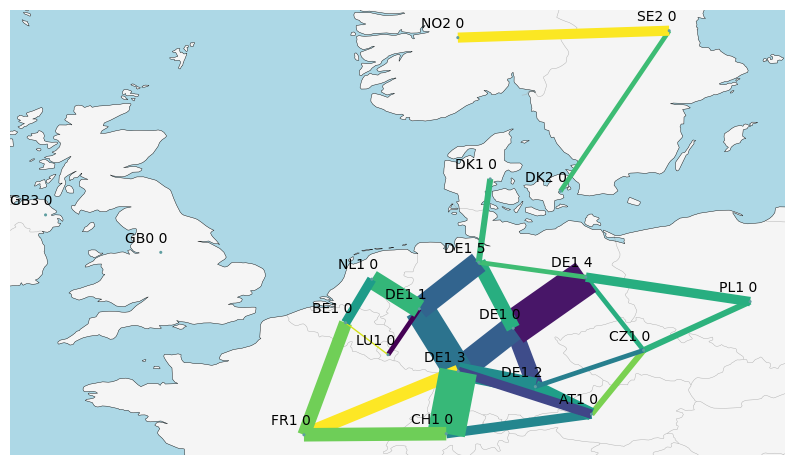

In [13]:
loading = (n.lines_t.p0.abs().mean().sort_index()/(n.lines.s_nom_opt*n.lines.s_max_pu).sort_index()).fillna(0.)

fig, ax = plt.subplots(
    figsize=(10,10),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

n.plot(
    ax=ax,
    branch_components=["Line"],
    line_widths=n.lines.s_nom_opt/1e3, #GW
    line_colors=loading,
    line_cmap=plt.cm.viridis,
    color_geomap=True,
    bus_sizes=0.003
)

bus = n.buses
region = []
for index, row in bus.iterrows():
    x = row['x']
    y = row['y']
    if "H2" in index:
        pass
    else:
        region.append(index)
        ax.annotate(
        index,
        xy=(x, y),
        xytext=(5, 5),  # Adjust the position of the annotation
        textcoords="offset points",
        ha='right', va='bottom'
    )

plt.show


## Installed Capacity Map Plot

In [14]:
#color list for installed cap
tech_list = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
tech_list.remove('load')
color_cap = []

for i in range(len(tech_list)):
    for j in range(len(n.carriers.index)):
        if tech_list[i] == n.carriers.index[j]:
            color_cap.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

cap = n.generators[n.generators['carrier']!='load'].groupby(['bus', 'carrier']).p_nom_opt.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3847545614.py:9: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_cap.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


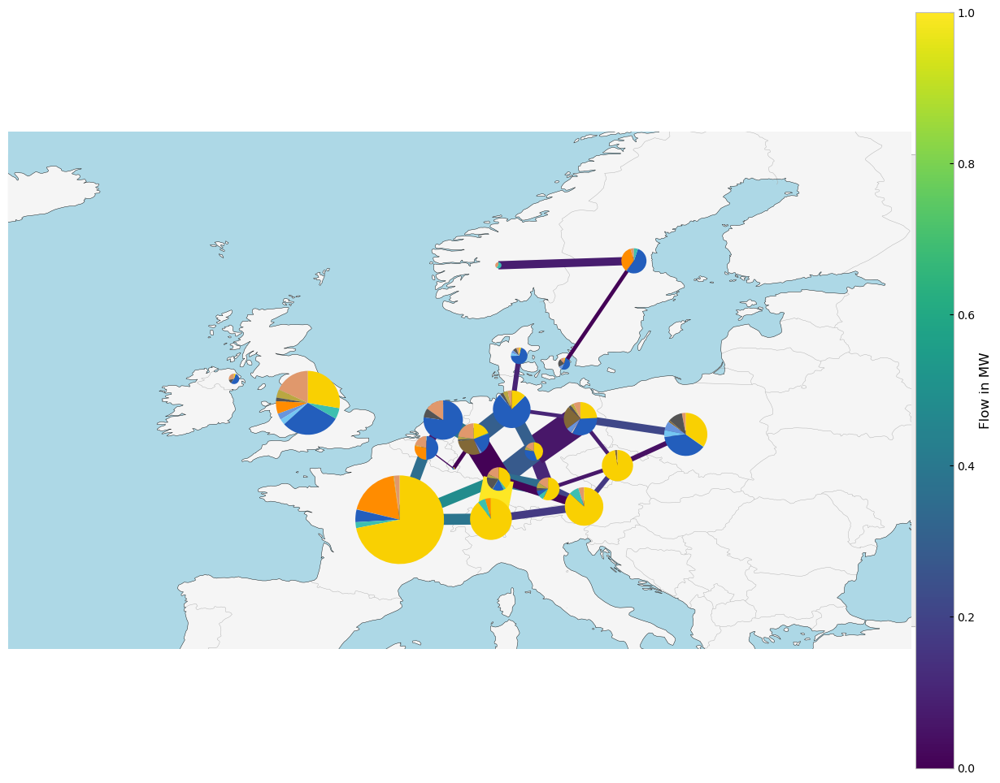

In [15]:
fig, ax = plt.subplots(
    figsize=(15,15),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

collection = n.plot(
    bus_sizes=cap / 5e4,
    bus_colors = color_cap,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
        
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Generation Map Plot

In [16]:
#color list for energy generated 
tech_list_gen_table = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
colors_gen_table = []

for i in range(len(tech_list_gen_table)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen_table[i] == n.carriers.index[j]:
            colors_gen_table.append(n.carriers.color[j])
            break  # break the inner loop once a match is found 

#Adjust Load shedding's unit to MW from kW
#for column in n.generators_t.p.columns:
#    if column.endswith('load') and not column.endswith('H2 load'):
#        n.generators_t.p[column]/=1e3
        

gen = n.generators.assign(g=n.generators_t.p.mean()).groupby(["bus", "carrier"]).g.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\971004373.py:8: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen_table.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


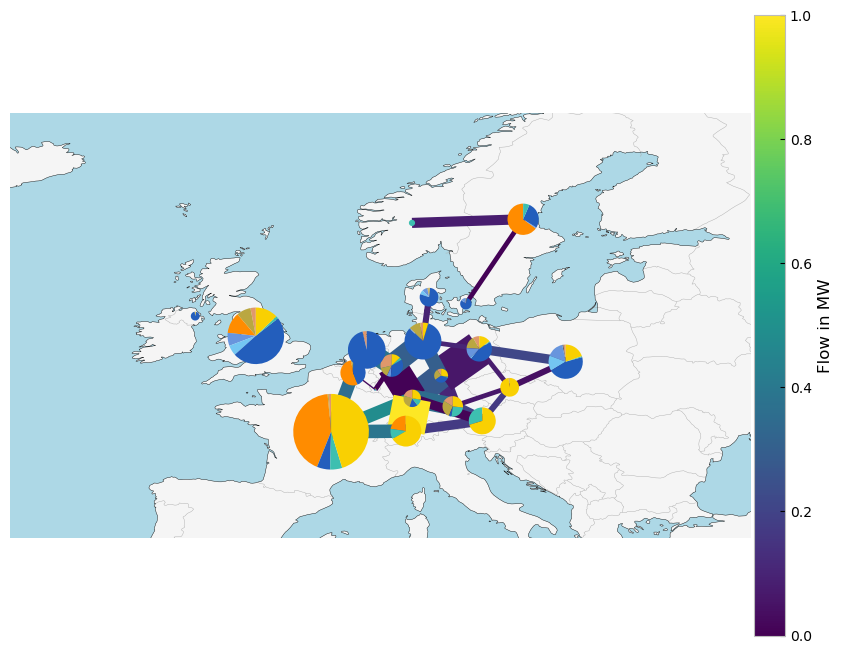

In [17]:
carriers = n.generators.carrier.unique()

plt.figure(figsize =(10,10))

collection = n.plot(
    bus_sizes=gen / 1e4,
    bus_colors = colors_gen_table,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Installed Capacity

<Figure size 640x480 with 0 Axes>

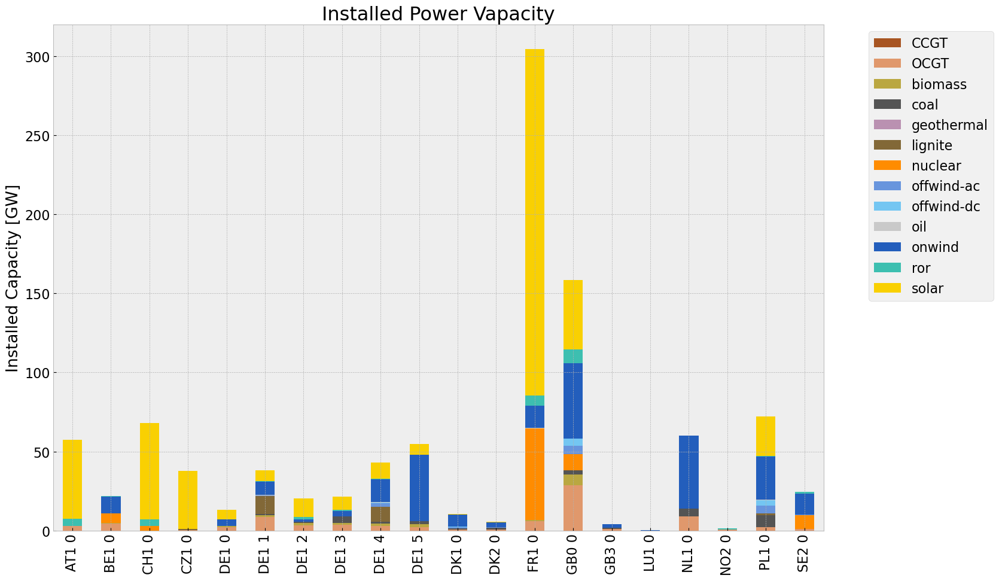

In [18]:
def inst_cap_table(n,colors):

    capacities = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Vapacity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_installed_cap.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    plt.show()

    

    return capacities

# consolidated istalled cap without load_shedding

#capacities_base = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_base.fillna(0, inplace=True)
#gen = (capacities_base.unstack()/1000).drop(columns=['load'],inplace=False)

capacities_base = inst_cap_table(n, color_cap)

<Figure size 640x480 with 0 Axes>

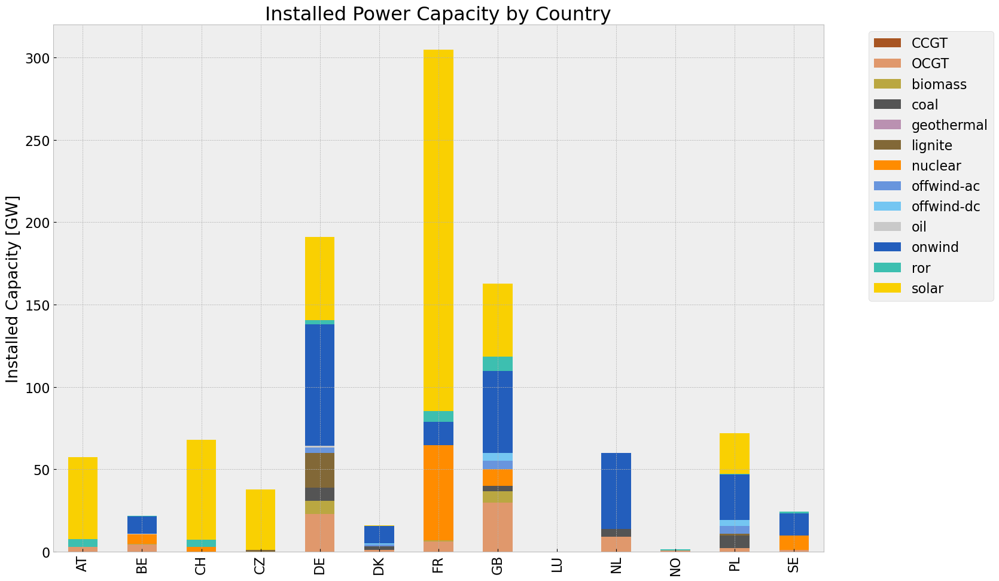

In [19]:
#aggregate installed capacities by country
def inst_cap_table_country(n,colors):
    
    model = n
    capacities = model.generators
    capacities['country'] = capacities['bus'].str[:2]
    capacities = capacities.groupby(['country', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Capacity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_installed_cap_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()
    
     

    return gen

cap_base_country= inst_cap_table_country(n, color_cap)

## Generation

<Figure size 640x480 with 0 Axes>

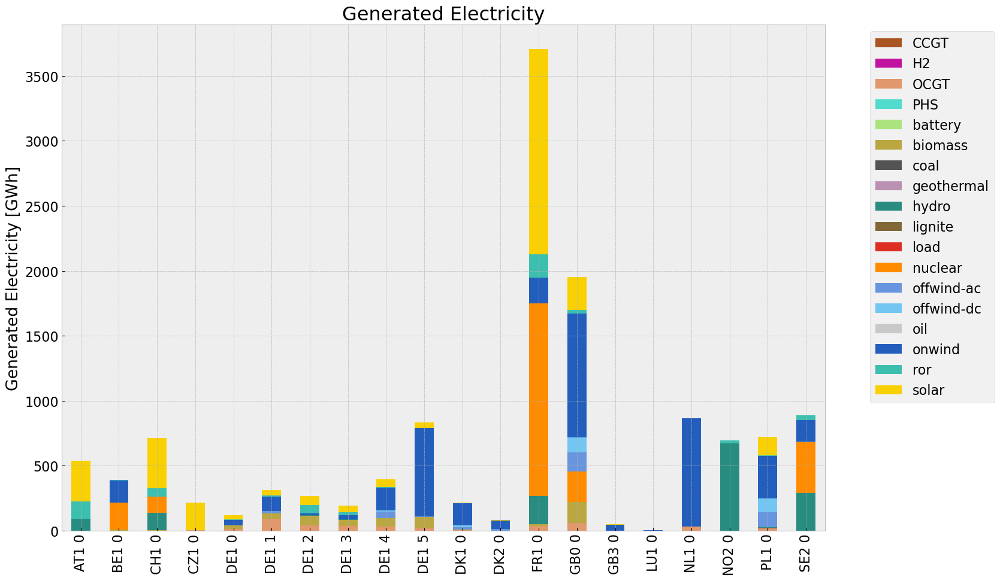

In [20]:
def gen_power_table(n):

    carrier_gen = list(n.generators.carrier.unique())
    carrier_sto = list(n.storage_units.carrier.unique())
    carrier = carrier_gen + carrier_sto

    gen_df = n.generators[["carrier","bus","p_nom_opt"]]
    sto_df = n.storage_units[["carrier","bus","p_nom_opt"]]
    tot_df = pd.concat([gen_df, sto_df])
    tot_series = pd.Series(index = tot_df.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    gen_sto = n.storage_units_t.p.sum()
    gen_gen = n.generators_t.p.sum()
    gen = pd.concat([gen_sto, gen_gen])
    gen = gen.clip(lower=0)

    for r in region:
            for tech in carrier:
                key = f"{r} {tech}"
                if key in gen.index:
                    try:
                        tot_series.loc[r, tech] = gen[key]
                    #print(generations.loc[r, tech])
                    except KeyError:
                        print('error')
    #tot_series.fillna(0, inplace=True)

    tot_df = (tot_series.unstack()/1000)
    tot_df.fillna(0,inplace = True)

    #define color dict for tech
    color_dict = {}

    for index, row in n.carriers.iterrows():
        key = index
        value = row['color']
        color_dict[key] = value

    #color list
    colors = [color_dict[cat] for cat in tot_df.columns]

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    tot_df.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_gen_elec.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()

    return tot_df

gen_base = gen_power_table(n)

<Figure size 640x480 with 0 Axes>

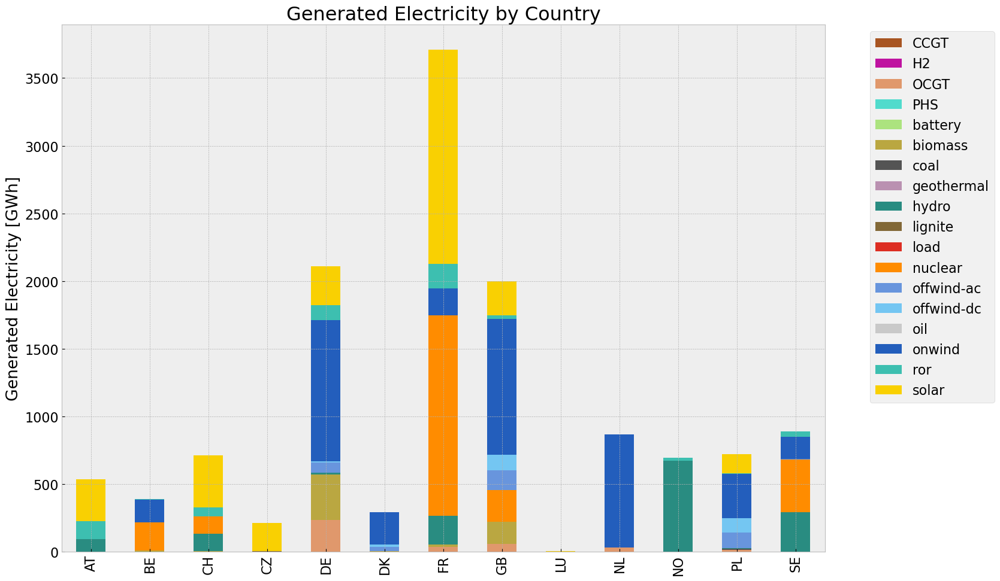

In [21]:
def gen_power_table_country(n):

    carrier_gen = list(n.generators.carrier.unique())
    carrier_sto = list(n.storage_units.carrier.unique())
    carrier = carrier_gen + carrier_sto

    gen_df = n.generators[["carrier","bus","p_nom_opt"]]
    sto_df = n.storage_units[["carrier","bus","p_nom_opt"]]
    tot_df = pd.concat([gen_df, sto_df])
    tot_series = pd.Series(index = tot_df.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    gen_sto = n.storage_units_t.p.sum()
    gen_gen = n.generators_t.p.sum()
    gen = pd.concat([gen_sto, gen_gen])
    gen = gen.clip(lower=0)

    for r in region:
            for tech in carrier:
                key = f"{r} {tech}"
                if key in gen.index:
                    try:
                        tot_series.loc[r, tech] = gen[key]
                    #print(generations.loc[r, tech])
                    except KeyError:
                        print('error')
    #tot_series.fillna(0, inplace=True)

    tot_df = (tot_series.unstack()/1000)
    tot_df.fillna(0,inplace = True)


    
    tot_df['country'] = tot_df.index.str[:2]
    tot_df = tot_df.groupby(['country']).sum()   
    #generations['load']/=1e3

    #define color dict for tech
    color_dict = {}

    for index, row in n.carriers.iterrows():
        key = index
        value = row['color']
        color_dict[key] = value

    #color list
    colors = [color_dict[cat] for cat in tot_df.columns]


    plt.figure()
    plt.rcParams.update({'font.size': 16})

    tot_df.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_gen_elec_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    plt.show()
    return tot_df

gen_base_country = gen_power_table_country(n)

## Snapshot

In [22]:
sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()

#links = n.links_t.p0.groupby(n.links.carrier, axis =1).sum().drop(['DC','H2 electrolysis'], axis=1, inplace =False).head()
tech_list_gen = pd.concat([tech_list_gen, sto], axis=1).columns.tolist()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\318663498.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\318663498.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()


In [23]:
colors_gen = []

for i in range(len(tech_list_gen)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen[i] == n.carriers.index[j]:
            colors_gen.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\4040974225.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen.append(n.carriers.color[j])


In [24]:
def gen_curve(n, start, end, colors,ctr):

    plt.rcParams.update({'font.size': 16})

    #import export 
    lines_ctr_bus0 = n.lines[n.lines['bus0'].str.startswith(ctr) & ~n.lines['bus1'].str.startswith(ctr)].index
    lines_ctr_bus1 = n.lines[n.lines['bus1'].str.startswith(ctr) & ~n.lines['bus0'].str.startswith(ctr)].index
    links_ctr_bus0 = n.links[n.links['bus0'].str.startswith(ctr) & ~n.links['bus1'].str.startswith(ctr)].index
    links_ctr_bus1 = n.links[n.links['bus1'].str.startswith(ctr) & ~n.links['bus0'].str.startswith(ctr)].index


    df_lines_ctr_bus0 = n.lines_t.p0[lines_ctr_bus0]
    df_lines_ctr_bus1 = n.lines_t.p1[lines_ctr_bus1]
    df_links_ctr_bus0 = n.links_t.p0[links_ctr_bus0]
    df_links_ctr_bus1 = n.links_t.p1[links_ctr_bus1]


    import_export = pd.concat([df_lines_ctr_bus0, df_lines_ctr_bus1, df_links_ctr_bus0, df_links_ctr_bus1], axis=1).sum(axis=1)*-1 #MW

    columns_gen = [col for col in  n.generators_t.p.columns if col.startswith(ctr)]
    p_country = n.generators_t.p[columns_gen]

    p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
    

    #add import color
    colors.append('#133337') #for Import

    #p_by_carrier['load'] /= 1e3

    #links fuel cell
    #links = n.links_t.p1.groupby(n.links.carrier, axis=1).sum().div(1e3)
    #links = links.drop(columns='DC', inplace=False)
    #links['H2 fuel cell']*=-1
       
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        col_sto = [col for col in  n.storage_units_t.p.columns if col.startswith(ctr)]
        sto_ctr = n.storage_units_t.p[col_sto]
        sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier['Import/Export'] = import_export 
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='168H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    col_load = [col for col in  n.loads_t.p_set.columns if col.startswith(ctr)]
    loads_ctr = n.loads_t.p_set[col_load]
    loads = loads_ctr.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")
    ax.set_ylim(-50,150)
    # Save plot to the current working directory
    fig.tight_layout()
    filename = f"{n.name}_gen_{start}_to_{end}.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    
    

In [25]:
#e_balance = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC",:].droplevel(2)
#e_balance.to_excel('energybalance.xlsx', index=True) 


In [26]:
#tes = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :].droplevel(2)
#tes.to_csv('energybalance.csv', index=True)

In [27]:
#n.loads_t.p_set.sum(axis=1).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].div(1e3).plot(ax=ax, c='k',grid=True)


In [28]:
#p_by_carrier.where(p_by_carrier>0).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].sum(axis=1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3768633647.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3768633647.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Users\Jere

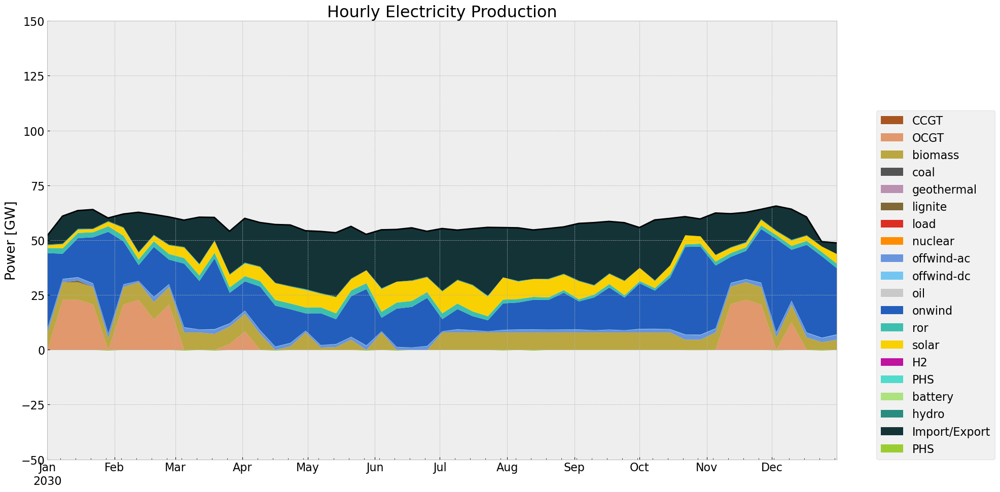

In [29]:
# winter
gen_curve(n, '2030-01-01', '2030-12-31', colors_gen,'DE')

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3768633647.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3768633647.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Users\Jere

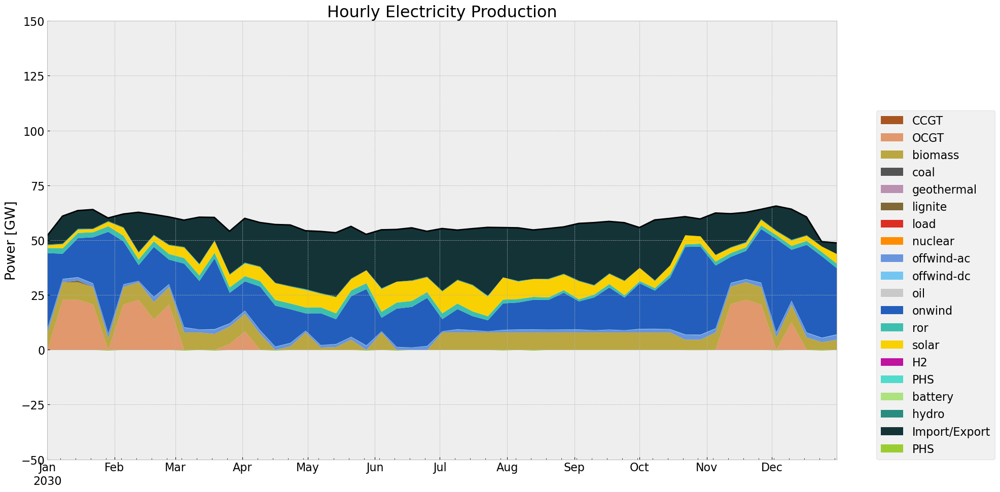

In [30]:
#summer
gen_curve(n, '2030-01-01', '2030-12-31', colors_gen,'DE')

In [31]:
def gen_curve_tot(n, start, end, colors):

    plt.rcParams.update({'font.size': 16})

    p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
    
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='168H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    loads = n.loads_t.p_set.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    ax.set_ylim(-50,370)
    fig.tight_layout()

    # Adjust the spacing around the plot (add extra space at the top)
    fig.subplots_adjust(top=0.95, right=0.85, left = 0.05)
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")

    filename = f"{n.name}_gen_{start}_to_{end}_total.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    
    plt.savefig(output_path)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\2732365766.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\2732365766.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\2732365766.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\2732365766.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='16

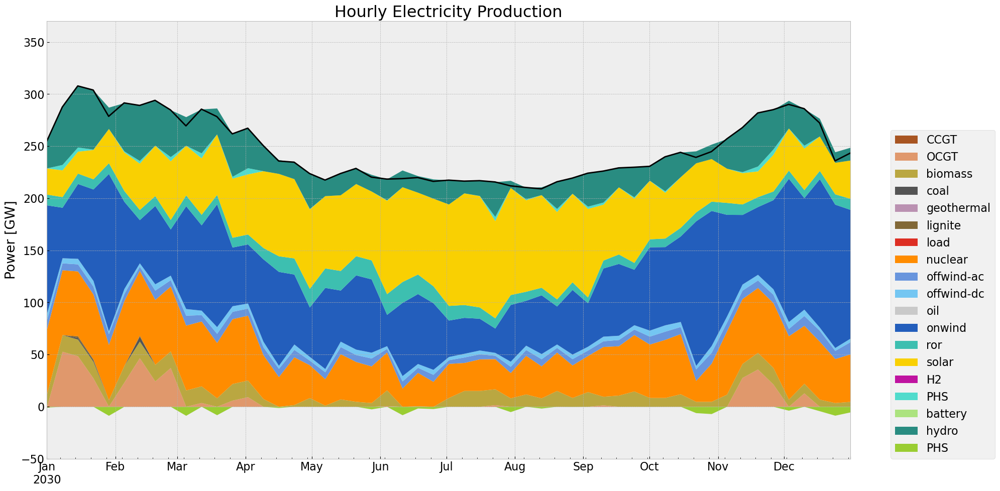

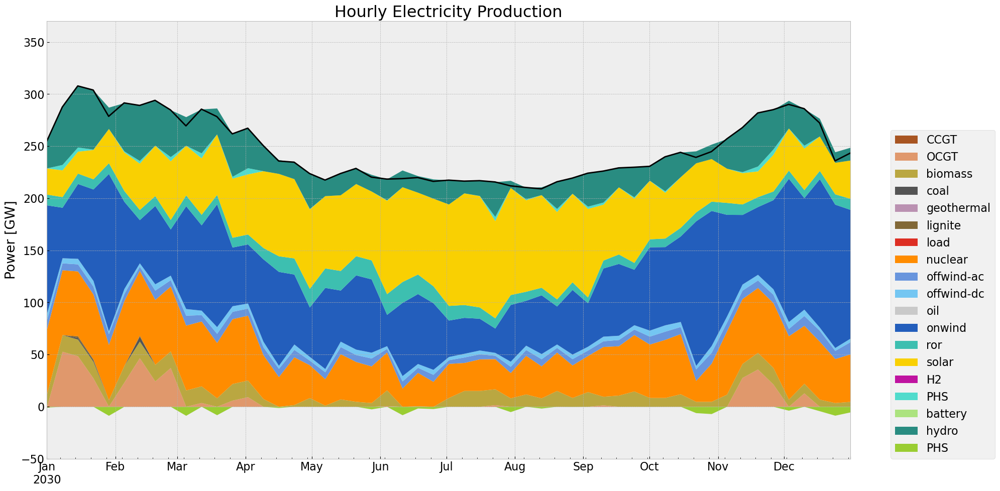

In [32]:
#generation curve all countries
#winter
gen_curve_tot(n, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n, '2030-01-01', '2030-12-31', colors_gen)

## Storage

In [33]:
def inst_store_table(n):
    
    plt.rcParams.update({'font.size': 16})
    storage = n.storage_units
    storage['country'] = storage['bus'].str[:2]

    (storage.groupby(['country','carrier']).p_nom_opt.sum().unstack()/1000).plot.bar(figsize=(17,10),
                                stacked=True,
                                color=["#bf13a0","#51dbcc","#ace37f","#298c81"],
                                grid=True,
                                xlabel="",
                                ylabel="Installed capacity [GW]",
                                title=f"Installed Power Capacity of Storage Systems By Country",
                                #ylim=[0,20]
    )
    store = storage.groupby(['country','carrier']).p_nom_opt.sum()/1000 #GW
    store.fillna(0, inplace=True)

    plt.tight_layout()

    filename = f"{n.name}_installed_storage.png" if hasattr(n, 'name') else "installed_storage.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    return store

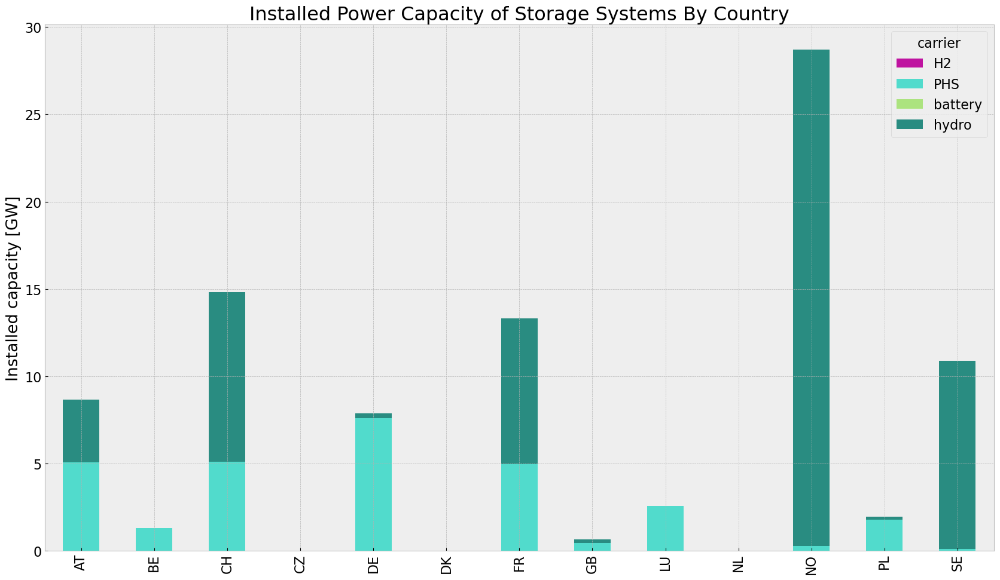

In [34]:
store_base = inst_store_table(n)

In [35]:
def state_of_charge_plot(n, start_date, end_date):
    
    soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)

    soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    time = pd.date_range(start= start_date , end= end_date, freq='168H')

    soc.loc[time].plot(ax=ax,
        grid=True,
        ylabel="State of charge [GWh]",
        xlabel="Time",
        title=f"State of charge of Storage Systems",
        linewidth=1.5,
    )
    plt.tight_layout()
    filename = f"{n.name}_soc.png" if hasattr(n, 'name') else "soc.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)



plt.show(n)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\4184885543.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\4184885543.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\4184885543.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='168H')


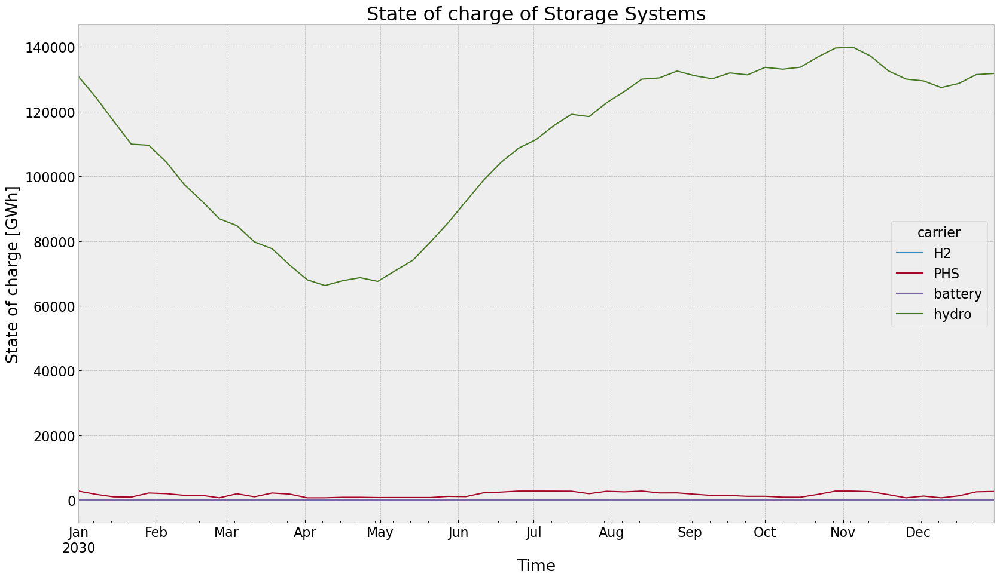

In [36]:
state_of_charge_plot(n, '2030-01-01', '2030-12-31')

## Electricity Price

In [37]:
def price_dur_curve_plot(n):

    #buses without store
    columns_to_keep =[]

    for i in n.buses_t.marginal_price.columns.tolist():
        if not i.endswith('H2'):
            columns_to_keep.append(i)
    
    price_dur_curve = pd.DataFrame()
    for region in columns_to_keep:
        price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    price_dur_curve.plot(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Time steps",
                    title=f"Duration curves of the marginal price",
                    linewidth=3,
)
    plt.tight_layout()
    filename = f"{n.name}_pd_curve.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
plt.show()

In [38]:
#columns_to_keep =[]

#for i in n.buses_t.marginal_price.columns.tolist():
    #if not i.endswith('H2'):
        #columns_to_keep.append(i)

#buses without store
#columns_to_keep =[]

#price_dur_curve = pd.DataFrame()
#for region in columns_to_keep:
    #price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)


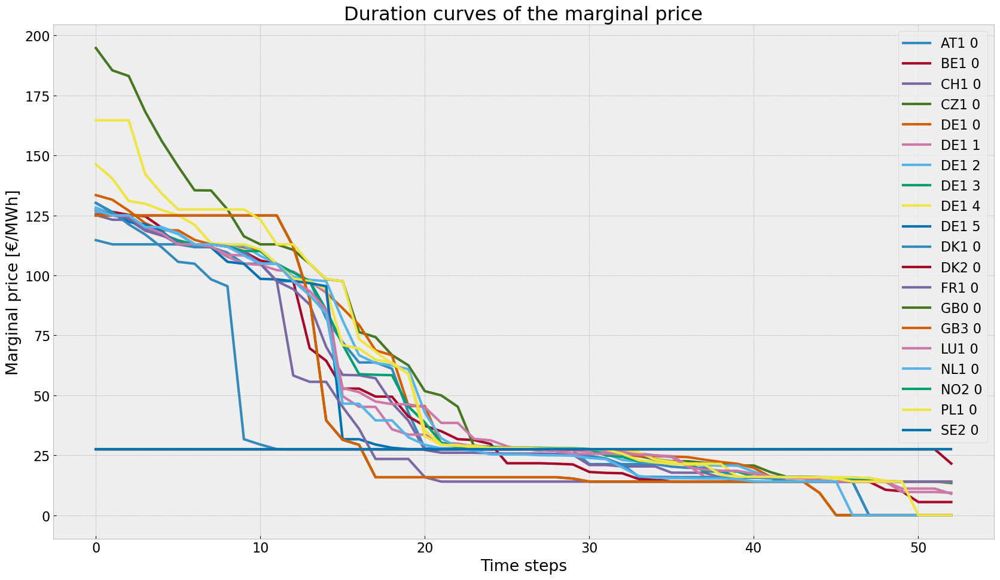

In [39]:
price_dur_curve_plot(n)

In [40]:
#demand weighted average electricity price
def price_regions_table(n):

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))
    
    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    
    price_df.plot.bar(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Region",
                    title=f"Demand-Weighted Average Marginal Price",
                    linewidth=3,
    )
    fig.tight_layout()                
    filename = f"{n.name}_average_eprice.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)                                    
    


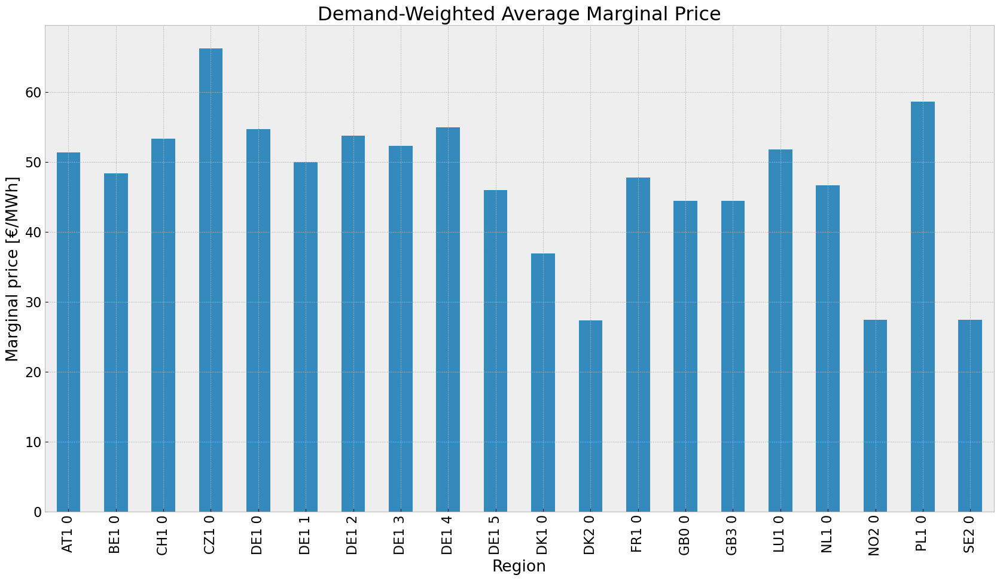

In [41]:
price_regions_table(n)

In [42]:
def price_regions(n):
    # Assuming 'n.buses_t.marginal_price' returns a DataFrame or similar structure with 'mean()' method

    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    #hprice = mean_p.filter(like='H2')
    #eprice = mean_p.drop(hprice.index)

    # Setup figure and subplots with 1 row and 2 columns
    fig, ax = plt.subplots(subplot_kw={"projection": ccrs.PlateCarree()}, figsize=(8, 8))

    # Plot for eprice
    hb= plt.hexbin(
        n.buses.x,
        n.buses.y,
        gridsize=20,
        C=price_df,
        cmap=plt.cm.jet,
        zorder=3,
    )

    n.plot(ax=ax, line_widths=pd.Series(0.5, n.lines.index), bus_sizes=0)  # Plot network on the second subplot

    ax.set_title("Demand-Weighted Average Marginal Price")
    
    cb = fig.colorbar(hb, ax=ax, location='bottom')
    cb.set_label("Mean Electricity Marginal Price (EUR/MWh)")

    fig.tight_layout()
    filename = f"{n.name}_price_map.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


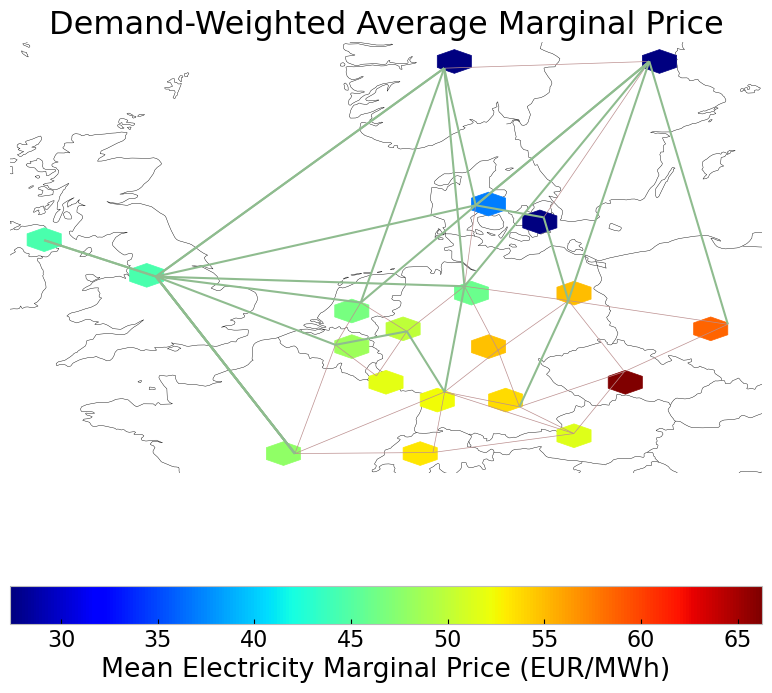

In [43]:
price_regions(n)

## Emission

In [44]:
def em_table(n):
    carrier = n.generators.carrier.unique()
    df_tot_generation = n.generators_t.p.sum()

    generations = pd.Series(index = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    for r in region:
        for tech in carrier:
            key = f"{r} {tech}"
            if key in df_tot_generation.index:
                try:
                    generations.loc[r, tech] = df_tot_generation[key]
                    #print(generations.loc[r, tech])
                except KeyError:
                    print('error')
    generations.fillna(0, inplace=True)

    generations = (generations.unstack())#MWh

    #mean efficiency of each carrier
    eff = n.generators.groupby('carrier').efficiency.mean()

    e = generations.sum()
    emission = []

    for index in e.index:
        for index_c in n.carriers.index:
            for index_eff in eff.index:
                if index == index_c == index_eff:
                    em = n.carriers.loc[index_c,"co2_emissions"]
                    emission.append(em)

    df = e.to_frame()
    df.rename(columns={0: 'Generation in MWh'}, inplace=True)
    df['efficiency'] = eff
    df['emissions in Tonnes CO2/MWh'] = emission
    df['emissions in Tonnes CO2']= df['Generation in MWh']/df['efficiency']*df['emissions in Tonnes CO2/MWh']
    df['emissions in Tonnes CO2'].sum() 
    return df

em_base =em_table(n)
em_base

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,3.802787e+05,0.451621,0.1980,166722.109286
biomass,5.322671e+05,0.468000,0.0000,0.000000
coal,7.782127e+03,0.329908,0.3361,7928.187466
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,3.352508e+03,0.337285,0.4069,4044.462271
load,0.000000e+00,1.000000,0.0000,0.000000
nuclear,2.445132e+06,0.326600,0.0000,0.000000
offwind-ac,3.712800e+05,1.000000,0.0000,0.000000


# Biggest Dispatchable Generators Cut Scenario



In [45]:
def extract_carriers(n, carriers, country):
    """
    Find the biggest dispatchable generator based on generated electricity in the chosen country
    
    Parameters:
    - n: pypsa network
    - carriers: List of dispatchable carrier names to match.
    - country: selected country
    
    Returns:
    - biggest dispatchable generator in the selected country
    """
    gen = n.generators_t.p
    sto = n.storage_units_t.p
    combined = pd.concat([gen,sto], axis = 1)
    column_names = combined.columns
    relevant_gen = [col for col in column_names if country in col and any(carrier in col for carrier in carriers)]
    combined_dispatchable = combined[relevant_gen]
    #print(combined[relevant_gen].sum())
    dispatch_cut = combined_dispatchable.sum().idxmax()

    return dispatch_cut

def max_generation_period(n, num_days, carriers,country):
    """
    Iterates through the DataFrame and finds the start date with the maximum generation sum for specified carriers over a given number of days.
    
    Parameters:
    - df: DataFrame containing the data.
    - num_days: The total number of days over which to sum the generation.
    - carriers: List of carrier names to be summed (e.g., ['CCGT', 'OCGT', 'biomass']).

    Returns:
    - Start date with the highest generation and the corresponding sum.
    """
    #combine storage production with generators
    df = n.generators_t.p
    sto = n.storage_units_t.p
    df = pd.concat([df,sto], axis = 1)
    
    # Determine the timestep in days based on the DataFrame's index
    timestep = (df.index[1] - df.index[0]).total_seconds() / 86400  # Convert seconds to days
    num_rows = round(num_days / timestep)  # Calculate number of rows needed, round to nearest whole number
    
    # Extract column names matching the specified carriers
    relevant_columns = extract_carriers(n, carriers, country)
    print(relevant_columns)
    
    max_generation = 0
    start_date_with_max_generation = None

    # Iterate over each row in the DataFrame
    for start_idx in range(len(df)):
        #print(start_idx)
        # Ensure we do not exceed the DataFrame's length
        if start_idx + num_rows <= len(df):
            # Sum the generation for specified carriers over the period
            current_sum = df.iloc[start_idx:start_idx + num_rows][relevant_columns].sum().sum()
            #print(df.index[start_idx],current_sum)
            # Check if the current sum is the highest found so far
            if current_sum > max_generation:
                max_generation = current_sum
                start_date_with_max_generation = df.index[start_idx]

    return start_date_with_max_generation

def allow_inv(n1,n, country, gen):
    #delete line expansion global constraint
    if 'lv_limit' in n1.global_constraints.index:
        n1.global_constraints = n1.global_constraints.drop('lv_limit')

    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, row in n1.generators.iterrows():
        if row['p_nom_extendable'] == True and country in row['bus'] and index != gen:  
            n1.generators.at[index, 'p_nom_min'] = n.generators.at[index, 'p_nom_opt']
            n1.generators.at[index, 'p_nom_extendable'] = True
        else:
            n1.generators.at[index, 'p_nom'] = n.generators.at[index, 'p_nom_opt']
            n1.generators.at[index, 'p_nom_extendable'] = False

    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, row in n1.storage_units.iterrows():
        if row['p_nom_extendable'] == True and country in row['bus'] and index != gen:
            n1.storage_units.at[index, 'p_nom_min'] = n.storage_units.at[index, 'p_nom_opt'] 
            n1.storage_units.at[index, 'p_nom_extendable'] = True
        else:
            n1.storage_units.at[index, 'p_nom'] = n.storage_units.at[index, 'p_nom_opt']
            n1.storage_units.at[index, 'p_nom_extendable'] = False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, row in n1.lines.iterrows():
        if row['carrier'] == 'AC' and (country in row['bus0'] or country in row['bus1']):
            n1.lines.at[index, 's_nom_min'] = n.lines.at[index, 's_nom_opt']
            n1.lines.at[index, 's_nom_extendable'] = True 
        else:
            n1.lines.at[index, 's_nom'] = n.lines.at[index, 's_nom_opt']
            n1.lines.at[index, 's_nom_extendable'] = False 
    
    #set the optimal capacity of links from the base scenario as the new minimum capacity 
    for index, row in n1.links.iterrows():
        if row['carrier'] == 'DC' and (country in row['bus0'] or country in row['bus1']):
            n1.links.at[index, 'p_nom_min'] = n.links.at[index, 'p_nom_opt']
            n1.links.at[index, 'p_nom_extendable'] = True 
        else:
            n1.links.at[index, 'p_nom'] = n.links.at[index, 'p_nom_opt']
            n1.links.at[index, 'p_nom_extendable'] = False
            
def no_inv(n2,n):
    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, value in n2.generators.p_nom_extendable.items():
        if value:  
            n2.generators.at[index, 'p_nom'] = n.generators.at[index, 'p_nom_opt']
            #n2.generators.at[index, 'p_nom_max'] = n.generators.at[index, 'p_nom_opt']
            n2.generators.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, value in n2.storage_units.p_nom_extendable.items():
        if value:  
            n2.storage_units.at[index, 'p_nom'] = n.storage_units.at[index, 'p_nom_opt']
            #n2.storage_units.at[index, 'p_nom_max'] = n.storage_units.at[index, 'p_nom_opt']
            n2.storage_units.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of stores from the base scenario as the new minimum capacity 
    for index, value in n2.stores.e_nom_extendable.items():
        if value:  
            n2.stores.at[index, 'e_nom'] = n.stores.at[index, 'e_nom_opt']
            #n2.stores.at[index, 'e_nom_max'] = n.stores.at[index, 'e_nom_opt']
            n2.stores.at[index, 'e_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.lines.s_nom_extendable.items():
        if value:  
            n2.lines.at[index, 's_nom'] = n.lines.at[index, 's_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.lines.at[index, 's_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.links.p_nom_extendable.items():
        if value:  
            n2.links.at[index, 'p_nom'] = n.links.at[index, 'p_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.links.at[index, 'p_nom_extendable'] =False

In [46]:
#p_max_pu of offwind generators across all regions are subtracted by 10% from 01.06.2013 to 31.12.13
#cut_start=pd.to_datetime('2013-02-01 00:00:00')
duration = 180 #days
#cut_end = pd.to_datetime('2013-12-31 21:00:00')
reductionto = 0.25


def dispatchscenario(n, carriers_dispatchable, duration, reductionto):
    #copy network
    n_new=n.copy()

    cut_start = max_generation_period(n, duration, carriers_dispatchable,country)
    print(cut_start)
    cut_end = cut_start + pd.Timedelta(days= duration)

    #identify dispatchable generator with the highest electricity generated
    gen_cut = extract_carriers(n, carriers_dispatchable, country)
    #print(gen_cut)
    
    #implement dispatch cut scenario
    if gen_cut in n_new.generators_t.p.columns:
        n_new.generators_t.p_max_pu[gen_cut] = n.generators_t.p[gen_cut]/n.generators.at[gen_cut,'p_nom_opt']

        for index,row in n_new.generators_t.p_max_pu[gen_cut].items():
            if index >= cut_start and index <= cut_end:
                n_new.generators_t.p_max_pu.at[index, gen_cut] *= reductionto
    else:
        n_new.storage_units_t.p_max_pu[gen_cut] = n.storage_units_t.p[gen_cut]/n.storage_units.at[gen_cut,'p_nom_opt']

        for index,row in n_new.storage_units_t.p_max_pu[gen_cut].items():
            if index >= cut_start and index <= cut_end:
                n_new.storage_units_t.p_max_pu.at[index, gen_cut] *= reductionto

    return n_new

carriers_dispatchable = ['biomass','coal', 'CCGT', 'OCGT', 'lignite', 'hydro','nuclear']
n1 = dispatchscenario(n, carriers_dispatchable, duration, reductionto)
n1.name = f'inv_{contingency}'          

DE1 1 OCGT
2013-01-01 00:00:00


In [47]:
gen_cut = extract_carriers(n, carriers_dispatchable, country)

## 1. Model: perfect foresight with allowed additional investment

In [48]:
country = 'DE'

### Allow investment

In [49]:

        
allow_inv(n1,n, country, gen_cut)

In [50]:
n1.optimize(solver_name= "gurobi")
#filename = f'inv_{contingency}.nc'
#n1 = import_nc_file(directory, filename)
n1.name = f'inv_{contingency}'

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 69.76it/s]
INFO:linopy.io: Writing time: 0.94s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kukly2_4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kukly2_4.lp


Reading time = 0.22 seconds


INFO:gurobipy:Reading time = 0.22 seconds


obj: 59361 rows, 27676 columns, 103192 nonzeros


INFO:gurobipy:obj: 59361 rows, 27676 columns, 103192 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59361 rows, 27676 columns and 103192 nonzeros


INFO:gurobipy:Optimize a model with 59361 rows, 27676 columns and 103192 nonzeros


Model fingerprint: 0x10d0c077


INFO:gurobipy:Model fingerprint: 0x10d0c077


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [2e-02, 3e+02]


INFO:gurobipy:  Matrix range     [2e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 1e+10]


INFO:gurobipy:  Bounds range     [1e+00, 1e+10]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 50298 rows and 12349 columns


INFO:gurobipy:Presolve removed 50298 rows and 12349 columns


Presolve time: 0.21s


INFO:gurobipy:Presolve time: 0.21s


Presolved: 9063 rows, 15327 columns, 37951 nonzeros


INFO:gurobipy:Presolved: 9063 rows, 15327 columns, 37951 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.03s


INFO:gurobipy:Ordering time: 0.03s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 39


INFO:gurobipy: Dense cols : 39


 AA' NZ     : 6.498e+04


INFO:gurobipy: AA' NZ     : 6.498e+04


 Factor NZ  : 3.375e+05 (roughly 13 MB of memory)


INFO:gurobipy: Factor NZ  : 3.375e+05 (roughly 13 MB of memory)


 Factor Ops : 4.232e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.232e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   7.31745774e+16 -1.52635838e+16  2.07e+09 2.56e+05  8.40e+13     0s


INFO:gurobipy:   0   7.31745774e+16 -1.52635838e+16  2.07e+09 2.56e+05  8.40e+13     0s


   1   4.94117047e+16 -3.66624836e+15  1.40e+09 7.14e+04  5.06e+13     0s


INFO:gurobipy:   1   4.94117047e+16 -3.66624836e+15  1.40e+09 7.14e+04  5.06e+13     0s


   2   1.16293934e+16 -1.43498418e+15  2.83e+08 2.09e+04  1.10e+13     0s


INFO:gurobipy:   2   1.16293934e+16 -1.43498418e+15  2.83e+08 2.09e+04  1.10e+13     0s


   3   3.41315515e+15 -2.48864158e+14  4.52e+07 1.76e+03  1.77e+12     0s


INFO:gurobipy:   3   3.41315515e+15 -2.48864158e+14  4.52e+07 1.76e+03  1.77e+12     0s


   4   1.04255697e+15 -1.40859357e+14  7.26e+06 2.39e+02  2.99e+11     0s


INFO:gurobipy:   4   1.04255697e+15 -1.40859357e+14  7.26e+06 2.39e+02  2.99e+11     0s


   5   1.58733737e+14 -8.62732855e+13  7.46e+05 4.53e-01  3.35e+10     0s


INFO:gurobipy:   5   1.58733737e+14 -8.62732855e+13  7.46e+05 4.53e-01  3.35e+10     0s


   6   1.00189148e+13 -4.15993598e+13  2.81e+04 1.56e-02  2.46e+09     0s


INFO:gurobipy:   6   1.00189148e+13 -4.15993598e+13  2.81e+04 1.56e-02  2.46e+09     0s


   7   1.84753826e+12 -1.06531979e+13  3.95e+03 1.62e-03  4.65e+08     0s


INFO:gurobipy:   7   1.84753826e+12 -1.06531979e+13  3.95e+03 1.62e-03  4.65e+08     0s


   8   6.87129478e+11 -2.24090023e+12  1.05e+03 2.48e-04  1.02e+08     1s


INFO:gurobipy:   8   6.87129478e+11 -2.24090023e+12  1.05e+03 2.48e-04  1.02e+08     1s


   9   3.37280111e+11 -1.34668594e+12  3.60e+02 1.46e-04  5.50e+07     1s


INFO:gurobipy:   9   3.37280111e+11 -1.34668594e+12  3.60e+02 1.46e-04  5.50e+07     1s


  10   2.20700890e+11 -6.43669245e+11  1.96e+02 6.57e-05  2.78e+07     1s


INFO:gurobipy:  10   2.20700890e+11 -6.43669245e+11  1.96e+02 6.57e-05  2.78e+07     1s


  11   1.14299601e+11 -2.15655188e+11  6.62e+01 2.27e-05  1.04e+07     1s


INFO:gurobipy:  11   1.14299601e+11 -2.15655188e+11  6.62e+01 2.27e-05  1.04e+07     1s


  12   7.06881813e+10 -9.80445571e+10  3.17e+01 1.15e-05  5.28e+06     1s


INFO:gurobipy:  12   7.06881813e+10 -9.80445571e+10  3.17e+01 1.15e-05  5.28e+06     1s


  13   4.25535885e+10 -4.42314841e+10  1.23e+01 5.75e-06  2.70e+06     1s


INFO:gurobipy:  13   4.25535885e+10 -4.42314841e+10  1.23e+01 5.75e-06  2.70e+06     1s


  14   3.13475385e+10 -1.41008020e+10  6.40e+00 2.70e-06  1.41e+06     1s


INFO:gurobipy:  14   3.13475385e+10 -1.41008020e+10  6.40e+00 2.70e-06  1.41e+06     1s


  15   2.56904423e+10  7.23834026e+08  3.81e+00 1.31e-06  7.74e+05     1s


INFO:gurobipy:  15   2.56904423e+10  7.23834026e+08  3.81e+00 1.31e-06  7.74e+05     1s


  16   2.31603583e+10  5.79376775e+09  2.68e+00 8.84e-07  5.38e+05     1s


INFO:gurobipy:  16   2.31603583e+10  5.79376775e+09  2.68e+00 8.84e-07  5.38e+05     1s


  17   2.12360567e+10  1.11420630e+10  1.81e+00 4.42e-07  3.13e+05     1s


INFO:gurobipy:  17   2.12360567e+10  1.11420630e+10  1.81e+00 4.42e-07  3.13e+05     1s


  18   1.99988988e+10  1.35226068e+10  1.27e+00 2.49e-07  2.00e+05     1s


INFO:gurobipy:  18   1.99988988e+10  1.35226068e+10  1.27e+00 2.49e-07  2.00e+05     1s


  19   1.94713899e+10  1.51808035e+10  1.05e+00 1.18e-07  1.33e+05     1s


INFO:gurobipy:  19   1.94713899e+10  1.51808035e+10  1.05e+00 1.18e-07  1.33e+05     1s


  20   1.84806475e+10  1.57760306e+10  6.32e-01 7.64e-08  8.37e+04     1s


INFO:gurobipy:  20   1.84806475e+10  1.57760306e+10  6.32e-01 7.64e-08  8.37e+04     1s


  21   1.77762869e+10  1.60960242e+10  3.42e-01 5.44e-08  5.20e+04     1s


INFO:gurobipy:  21   1.77762869e+10  1.60960242e+10  3.42e-01 5.44e-08  5.20e+04     1s


  22   1.75069421e+10  1.63547421e+10  2.32e-01 3.72e-08  3.56e+04     1s


INFO:gurobipy:  22   1.75069421e+10  1.63547421e+10  2.32e-01 3.72e-08  3.56e+04     1s


  23   1.73780564e+10  1.65411396e+10  1.82e-01 2.44e-08  2.59e+04     1s


INFO:gurobipy:  23   1.73780564e+10  1.65411396e+10  1.82e-01 2.44e-08  2.59e+04     1s


  24   1.72498502e+10  1.66606854e+10  1.30e-01 1.63e-08  1.82e+04     1s


INFO:gurobipy:  24   1.72498502e+10  1.66606854e+10  1.30e-01 1.63e-08  1.82e+04     1s


  25   1.71166237e+10  1.67741355e+10  7.63e-02 8.78e-09  1.06e+04     1s


INFO:gurobipy:  25   1.71166237e+10  1.67741355e+10  7.63e-02 8.78e-09  1.06e+04     1s


  26   1.70126500e+10  1.68247464e+10  3.55e-02 5.46e-09  5.81e+03     1s


INFO:gurobipy:  26   1.70126500e+10  1.68247464e+10  3.55e-02 5.46e-09  5.81e+03     1s


  27   1.70033018e+10  1.68439459e+10  3.20e-02 4.23e-09  4.93e+03     1s


INFO:gurobipy:  27   1.70033018e+10  1.68439459e+10  3.20e-02 4.23e-09  4.93e+03     1s


  28   1.69680678e+10  1.68686530e+10  1.91e-02 2.70e-09  3.08e+03     1s


INFO:gurobipy:  28   1.69680678e+10  1.68686530e+10  1.91e-02 2.70e-09  3.08e+03     1s


  29   1.69454768e+10  1.68890721e+10  1.10e-02 1.48e-09  1.74e+03     1s


INFO:gurobipy:  29   1.69454768e+10  1.68890721e+10  1.10e-02 1.48e-09  1.74e+03     1s


  30   1.69387246e+10  1.68960146e+10  8.49e-03 1.07e-09  1.32e+03     1s


INFO:gurobipy:  30   1.69387246e+10  1.68960146e+10  8.49e-03 1.07e-09  1.32e+03     1s


  31   1.69334557e+10  1.69026091e+10  6.58e-03 6.81e-10  9.54e+02     1s


INFO:gurobipy:  31   1.69334557e+10  1.69026091e+10  6.58e-03 6.81e-10  9.54e+02     1s


  32   1.69301835e+10  1.69070667e+10  5.40e-03 4.19e-10  7.15e+02     1s


INFO:gurobipy:  32   1.69301835e+10  1.69070667e+10  5.40e-03 4.19e-10  7.15e+02     1s


  33   1.69283680e+10  1.69098026e+10  4.75e-03 2.59e-10  5.74e+02     1s


INFO:gurobipy:  33   1.69283680e+10  1.69098026e+10  4.75e-03 2.59e-10  5.74e+02     1s


  34   1.69243206e+10  1.69123583e+10  3.30e-03 1.20e-10  3.70e+02     1s


INFO:gurobipy:  34   1.69243206e+10  1.69123583e+10  3.30e-03 1.20e-10  3.70e+02     1s


  35   1.69220330e+10  1.69137640e+10  2.54e-03 7.96e-11  2.56e+02     1s


INFO:gurobipy:  35   1.69220330e+10  1.69137640e+10  2.54e-03 7.96e-11  2.56e+02     1s


  36   1.69211183e+10  1.69139617e+10  2.24e-03 6.46e-11  2.21e+02     1s


INFO:gurobipy:  36   1.69211183e+10  1.69139617e+10  2.24e-03 6.46e-11  2.21e+02     1s


  37   1.69200033e+10  1.69140962e+10  1.84e-03 6.00e-11  1.83e+02     1s


INFO:gurobipy:  37   1.69200033e+10  1.69140962e+10  1.84e-03 6.00e-11  1.83e+02     1s


  38   1.69197679e+10  1.69142645e+10  1.76e-03 7.50e-11  1.70e+02     1s


INFO:gurobipy:  38   1.69197679e+10  1.69142645e+10  1.76e-03 7.50e-11  1.70e+02     1s


  39   1.69196444e+10  1.69142907e+10  1.72e-03 5.55e-11  1.66e+02     1s


INFO:gurobipy:  39   1.69196444e+10  1.69142907e+10  1.72e-03 5.55e-11  1.66e+02     1s


  40   1.69191676e+10  1.69143114e+10  1.56e-03 7.07e-11  1.50e+02     1s


INFO:gurobipy:  40   1.69191676e+10  1.69143114e+10  1.56e-03 7.07e-11  1.50e+02     1s


  41   1.69185464e+10  1.69143940e+10  1.35e-03 5.82e-11  1.28e+02     2s


INFO:gurobipy:  41   1.69185464e+10  1.69143940e+10  1.35e-03 5.82e-11  1.28e+02     2s


  42   1.69177965e+10  1.69144134e+10  1.09e-03 8.25e-11  1.05e+02     2s


INFO:gurobipy:  42   1.69177965e+10  1.69144134e+10  1.09e-03 8.25e-11  1.05e+02     2s


  43   1.69172934e+10  1.69144947e+10  9.01e-04 8.62e-11  8.66e+01     2s


INFO:gurobipy:  43   1.69172934e+10  1.69144947e+10  9.01e-04 8.62e-11  8.66e+01     2s


  44   1.69164869e+10  1.69146465e+10  6.08e-04 6.68e-11  5.69e+01     2s


INFO:gurobipy:  44   1.69164869e+10  1.69146465e+10  6.08e-04 6.68e-11  5.69e+01     2s


  45   1.69159151e+10  1.69147514e+10  3.91e-04 6.43e-11  3.60e+01     2s


INFO:gurobipy:  45   1.69159151e+10  1.69147514e+10  3.91e-04 6.43e-11  3.60e+01     2s


  46   1.69153292e+10  1.69147943e+10  1.71e-04 5.17e-09  1.65e+01     2s


INFO:gurobipy:  46   1.69153292e+10  1.69147943e+10  1.71e-04 5.17e-09  1.65e+01     2s


  47   1.69148978e+10  1.69148222e+10  1.32e-05 5.03e-09  2.34e+00     2s


INFO:gurobipy:  47   1.69148978e+10  1.69148222e+10  1.32e-05 5.03e-09  2.34e+00     2s


  48   1.69148590e+10  1.69148478e+10  1.22e-05 1.96e-09  3.45e-01     2s


INFO:gurobipy:  48   1.69148590e+10  1.69148478e+10  1.22e-05 1.96e-09  3.45e-01     2s


  49   1.69148533e+10  1.69148517e+10  1.21e-06 5.73e-10  4.70e-02     2s


INFO:gurobipy:  49   1.69148533e+10  1.69148517e+10  1.21e-06 5.73e-10  4.70e-02     2s


  50   1.69148525e+10  1.69148525e+10  1.26e-06 8.74e-11  1.83e-04     2s


INFO:gurobipy:  50   1.69148525e+10  1.69148525e+10  1.26e-06 8.74e-11  1.83e-04     2s


  51   1.69148525e+10  1.69148525e+10  3.03e-08 6.25e-11  1.83e-07     2s


INFO:gurobipy:  51   1.69148525e+10  1.69148525e+10  3.03e-08 6.25e-11  1.83e-07     2s


  52   1.69148525e+10  1.69148525e+10  2.22e-10 1.08e-10  3.72e-10     2s


INFO:gurobipy:  52   1.69148525e+10  1.69148525e+10  2.22e-10 1.08e-10  3.72e-10     2s


INFO:gurobipy:


Barrier solved model in 52 iterations and 2.02 seconds (0.43 work units)


INFO:gurobipy:Barrier solved model in 52 iterations and 2.02 seconds (0.43 work units)


Optimal objective 1.69148525e+10


INFO:gurobipy:Optimal objective 1.69148525e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    3313 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:    3313 DPushes remaining with DInf 0.0000000e+00                 2s


       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:


     182 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:     182 PPushes remaining with PInf 0.0000000e+00                 2s


       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.0043647e-09      2s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.0043647e-09      2s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2054    1.6914853e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:    2054    1.6914853e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:


Solved in 2054 iterations and 2.18 seconds (0.45 work units)


INFO:gurobipy:Solved in 2054 iterations and 2.18 seconds (0.45 work units)


Optimal objective  1.691485252e+10


INFO:gurobipy:Optimal objective  1.691485252e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27676 primals, 59361 duals
Objective: 1.69e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

### Export model for later use

In [51]:
file = f"{n1.name}.nc"
output_path = os.path.join(os.getcwd(), file)
n1.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network inv_dispatchcut.nc has lines, links, carriers, loads, storage_units, generators, buses


<xarray.Dataset> Size: 278kB
Dimensions:                               (snapshots: 53,
                                           investment_periods: 0, lines_i: 27,
                                           lines_t_p0_i: 27, lines_t_p1_i: 27,
                                           lines_t_loss_i: 27, links_i: 28,
                                           links_t_p0_i: 15, links_t_p1_i: 15,
                                           carriers_i: 21, loads_i: 20,
                                           ...
                                           generators_i: 261,
                                           generators_t_p_max_pu_i: 82,
                                           generators_t_p_i: 99, buses_i: 20,
                                           buses_t_p_i: 20,
                                           buses_t_v_ang_i: 18,
                                           buses_t_marginal_price_i: 20)
Coordinates: (12/26)
  * snapshots                             (snapshots) int64 424B 0 1 2 ... 51 52
  * investment_periods                    (investment_periods) int64 0B 
  * lines_i                               (lines_i) object 216B '0' '1' ... '9'
  * lines_t_p0_i                          (lines_t_p0_i) object 216B '0' ... '9'
  * lines_t_p1_i                          (lines_t_p1_i) object 216B '0' ... '9'
  * lines_t_loss_i                        (lines_t_loss_i) object 216B '0' .....
    ...                                    ...
  * generators_t_p_max_pu_i               (generators_t_p_max_pu_i) object 656B ...
  * generators_t_p_i                      (generators_t_p_i) object 792B 'AT1...
  * buses_i                               (buses_i) object 160B 'AT1 0' ... '...
  * buses_t_p_i                           (buses_t_p_i) object 160B 'AT1 0' ....
  * buses_t_v_ang_i                       (buses_t_v_ang_i) object 144B 'AT1 ...
  * buses_t_marginal_price_i              (buses_t_marginal_price_i) object 160B ...
Data variables: (12/100)
    snapshots_snapshot                    (snapshots) datetime64[ns] 424B 201...
    snapshots_objective                   (snapshots) float64 424B 168.0 ... ...
    snapshots_generators                  (snapshots) float64 424B 168.0 ... ...
    snapshots_stores                      (snapshots) float64 424B 168.0 ... ...
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    buses_country                         (buses_i) object 160B 'AT' ... 'SE'
    buses_control                         (buses_i) object 160B 'Slack' ... 'PQ'
    buses_generator                       (buses_i) object 160B 'AT1 0 CCGT' ...
    buses_t_p                             (snapshots, buses_t_p_i) float64 8kB ...
    buses_t_v_ang                         (snapshots, buses_t_v_ang_i) float64 8kB ...
    buses_t_marginal_price                (snapshots, buses_t_marginal_price_i) float64 8kB ...
Attributes:
    network__linearized_uc:      0
    network__multi_invest:       0
    network_name:                inv_dispatchcut
    network_objective:           16914852515.720972
    network_objective_constant:  10389429842.941742
    network_pypsa_version:       0.27.0
    network_srid:                4326
    crs:                         {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"Worl...
    meta:                        {}

In [52]:
tot_cos_inv=n1.objective/1e9 # billion €
system_cost_inv = system_cost(n1) #million€/a
marg_price_region_inv = n1.buses_t.marginal_price.mean()
stat_inv = n1.statistics()

<Figure size 640x480 with 0 Axes>

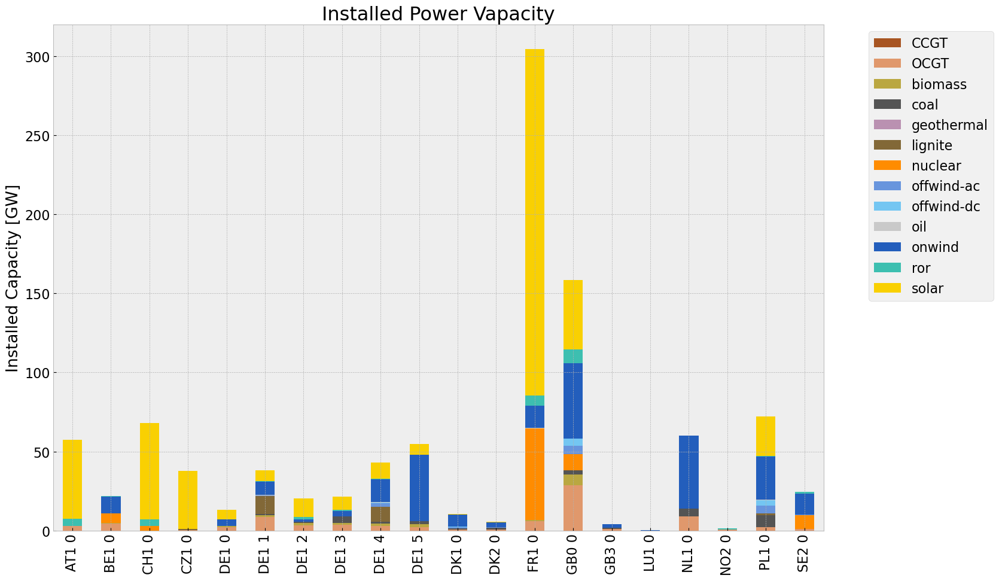

<Figure size 640x480 with 0 Axes>

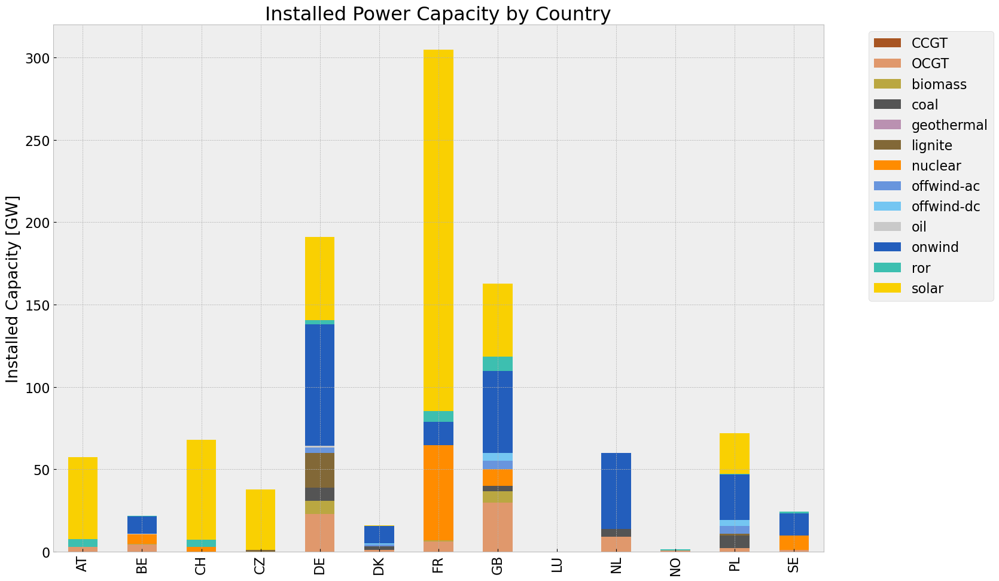

In [53]:
# consolidated istalled cap without load_shedding

#capacities_inv = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_inv.fillna(0, inplace=True)
#gen_1 = (capacities_inv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv = inst_cap_table(n1, color_cap)
cap_inv_country= inst_cap_table_country(n1, color_cap)


### Generation

<Figure size 640x480 with 0 Axes>

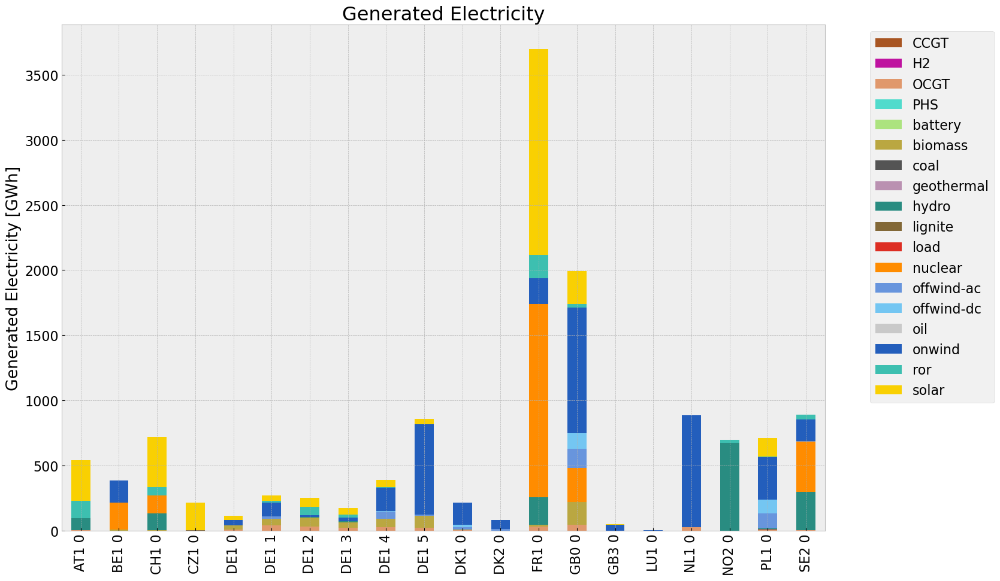

<Figure size 640x480 with 0 Axes>

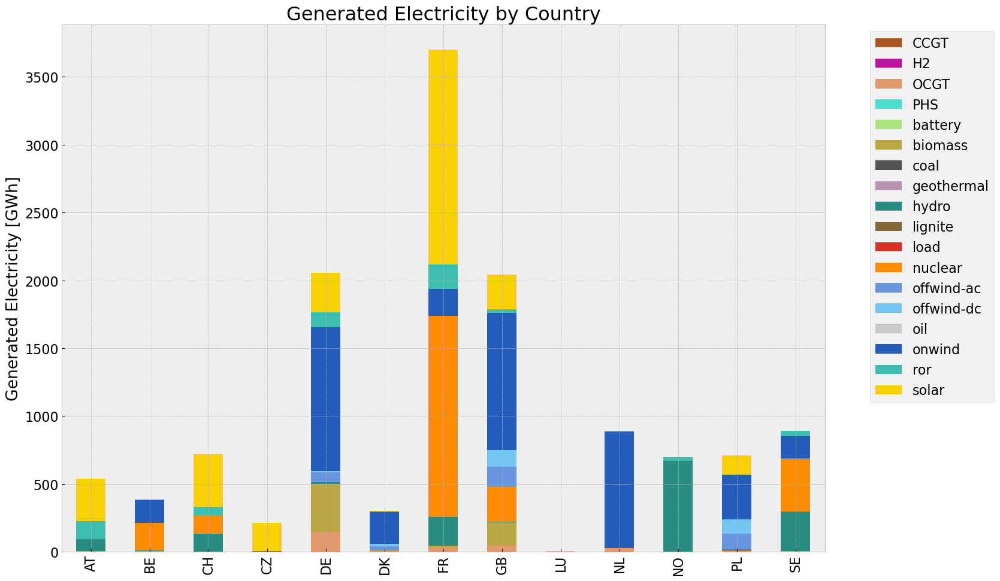

In [54]:
# consolidated generation table
#carrier = n1.generators.carrier.unique()
#df_tot_generation = n1.generators_t.p.sum()

#generations = pd.Series(index = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
           # except KeyError:
               # print('error')
                
#generations.fillna(0, inplace=True)
#gen_inv = generations.unstack()/1000#Gwh


gen_inv = gen_power_table(n1)
gen_inv_country = gen_power_table_country(n1)

### Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3768633647.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3768633647.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Users\Jere

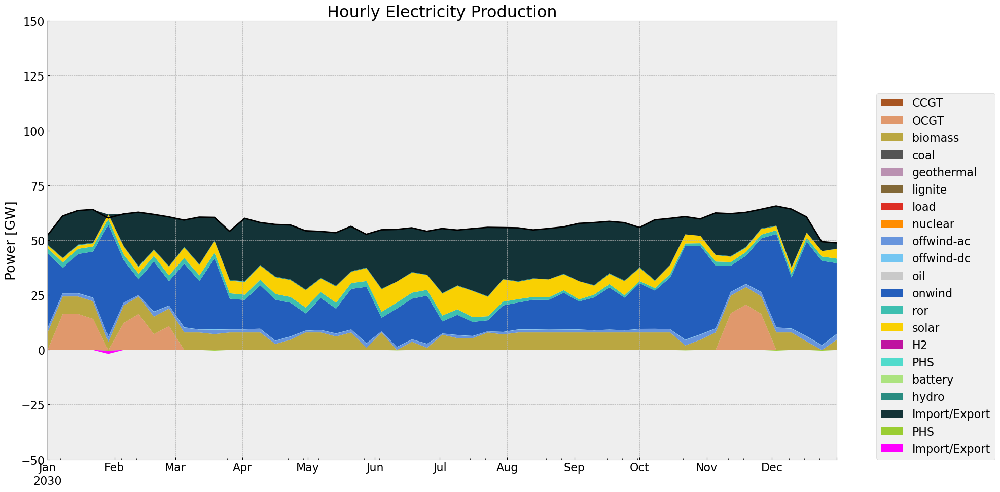

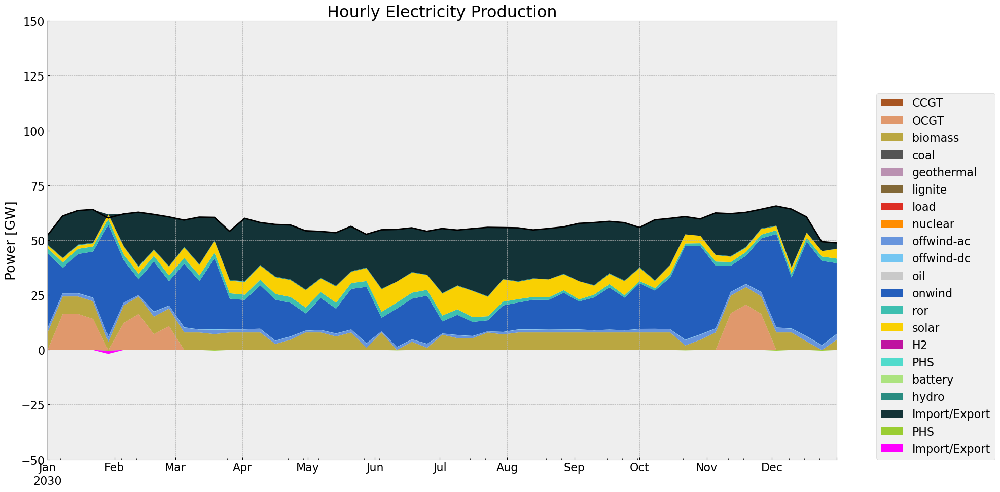

In [55]:
gen_curve(n1, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n1, '2030-01-01', '2030-12-31', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\2732365766.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\2732365766.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\2732365766.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\2732365766.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='16

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pandas\plotting\_matplotlib\core.py:1794: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  ax.set_ylim(None, 0)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\2732365766.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\2732365766.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\2732365766.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum()

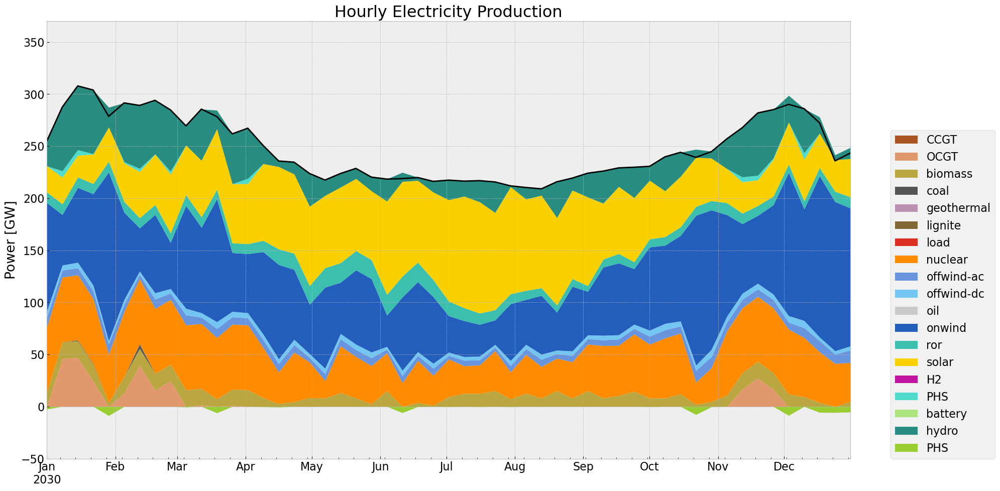

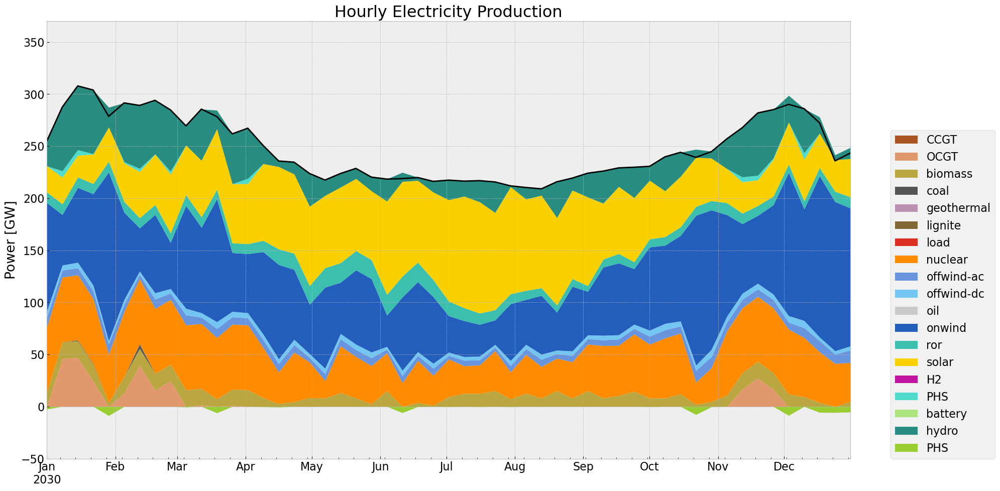

In [56]:
#generation curve all countries
#winter
gen_curve_tot(n1, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n1, '2030-01-01', '2030-12-31', colors_gen)

### Storage

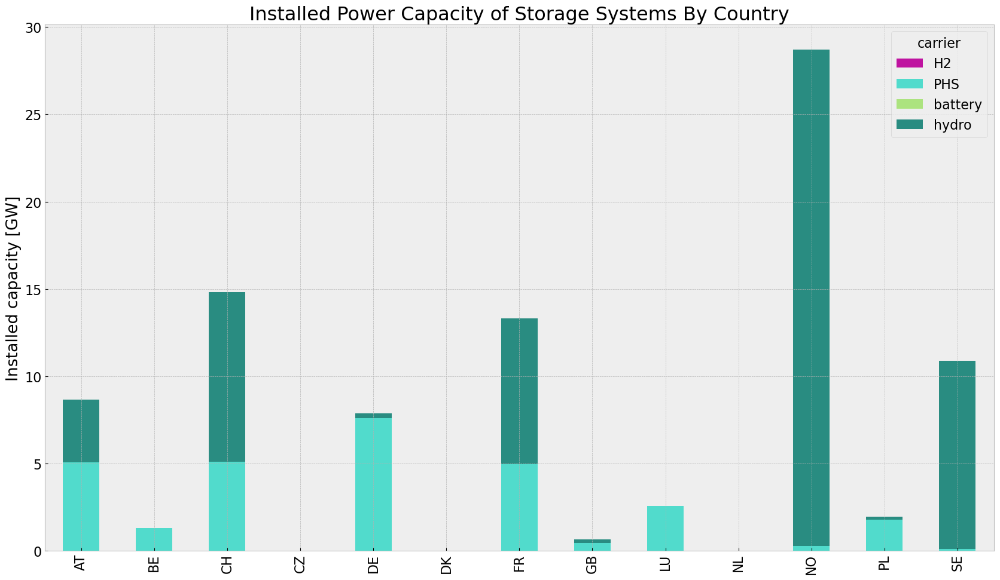

In [57]:
store_inv = inst_store_table(n1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\4184885543.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\4184885543.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\4184885543.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='168H')


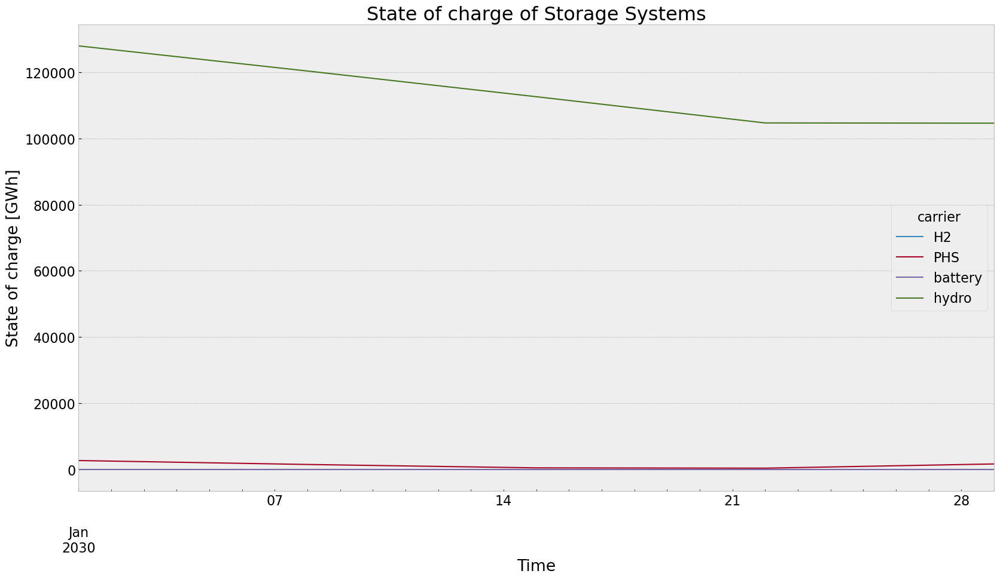

In [58]:
state_of_charge_plot(n1, '2030-01-01 00:00', '2030-02-02 21:00')

### Electricity Price


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


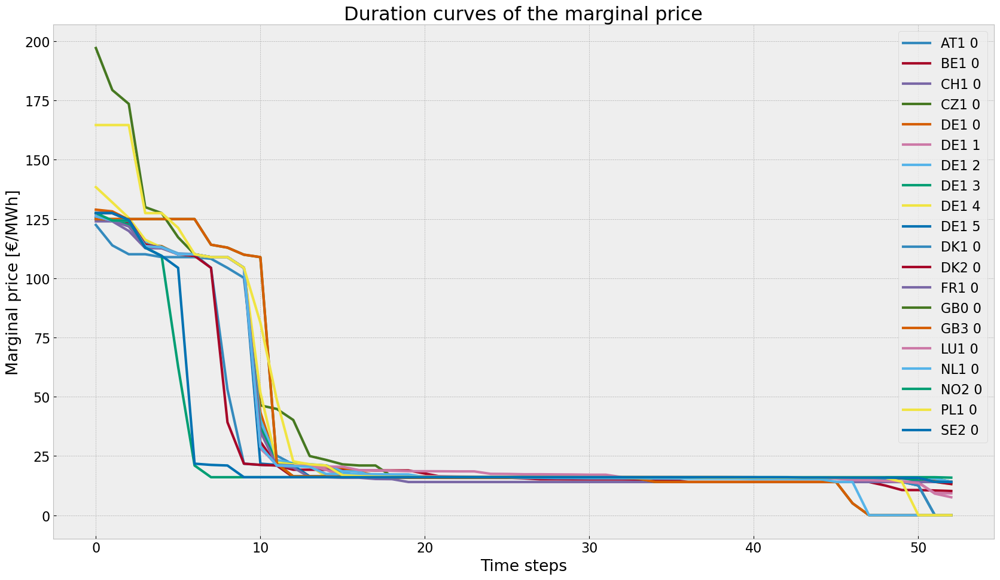

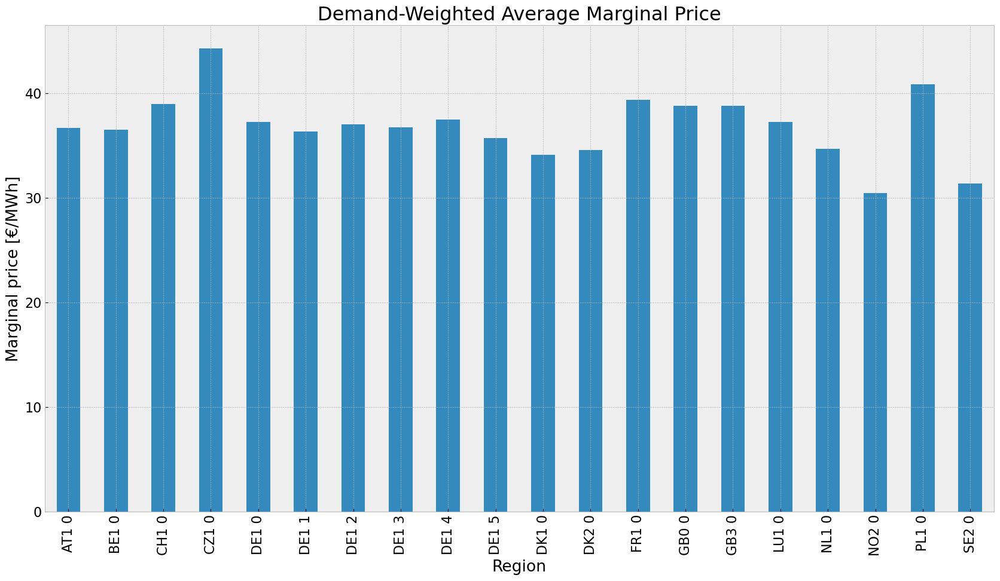

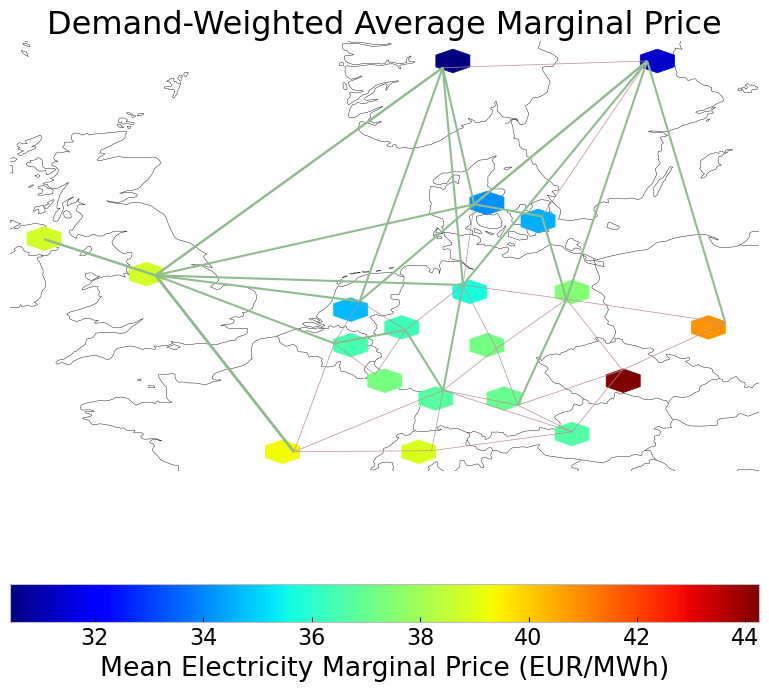

In [59]:
price_dur_curve_plot(n1)
price_regions_table(n1)
price_regions(n1)


### Emission

In [60]:
em_inv =em_table(n1)
em_inv

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,2.723258e+05,0.451621,0.1980,119393.303832
biomass,5.491560e+05,0.468000,0.0000,0.000000
coal,4.252357e+03,0.329908,0.3361,4332.169017
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,2.440104e+03,0.337285,0.4069,2943.738943
load,0.000000e+00,1.000000,0.0000,0.000000
nuclear,2.478836e+06,0.326600,0.0000,0.000000
offwind-ac,3.725141e+05,1.000000,0.0000,0.000000


## Base Rolling Horizon

In [61]:
#BAse RH
n_roll = n.copy()
no_inv(n_roll,n)
n_roll.storage_units['cylic_state_of_charge'] = False
n_roll.storage_units['cylic_state_of_charge_per_period'] = False


horizon = 4
optimize.optimize_with_rolling_horizon(n_roll, horizon=int(horizon), overlap=0, solver_name='gurobi')
#filename = f"base_{contingency}_roll.nc"
#n_roll = import_nc_file(directory, filename)
n_roll.name = f'base_{contingency}_roll'

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1ftwm8fr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1ftwm8fr.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x2a8e9362


INFO:gurobipy:Model fingerprint: 0x2a8e9362


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1123 columns


INFO:gurobipy:Presolve removed 4248 rows and 1123 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 961 columns, 1573 nonzeros


INFO:gurobipy:Presolved: 224 rows, 961 columns, 1573 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9320496e+08   1.010944e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.9320496e+08   1.010944e+06   0.000000e+00      0s


Extra simplex iterations after uncrush: 4


INFO:gurobipy:Extra simplex iterations after uncrush: 4


     327    1.9170658e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     327    1.9170658e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 327 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 327 iterations and 0.05 seconds (0.01 work units)


Optimal objective  1.917065804e+10


INFO:gurobipy:Optimal objective  1.917065804e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.92e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gjihz3b7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gjihz3b7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x128c7830


INFO:gurobipy:Model fingerprint: 0x128c7830


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4248 rows and 1123 columns


INFO:gurobipy:Presolve removed 4248 rows and 1123 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 961 columns, 1573 nonzeros


INFO:gurobipy:Presolved: 224 rows, 961 columns, 1573 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4232792e+08   9.960889e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4232792e+08   9.960889e+05   0.000000e+00      0s


     306    2.2149209e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     306    2.2149209e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 306 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 306 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.214920893e+10


INFO:gurobipy:Optimal objective  2.214920893e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.21e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xt3c8_ln.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xt3c8_ln.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0xad75688f


INFO:gurobipy:Model fingerprint: 0xad75688f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1108 columns


INFO:gurobipy:Presolve removed 4248 rows and 1108 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 976 columns, 1588 nonzeros


INFO:gurobipy:Presolved: 224 rows, 976 columns, 1588 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1237358e+08   1.009312e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.1237358e+08   1.009312e+06   0.000000e+00      0s


     337    2.1379023e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     337    2.1379023e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 337 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 337 iterations and 0.05 seconds (0.01 work units)


Optimal objective  2.137902280e+10


INFO:gurobipy:Optimal objective  2.137902280e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.14e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w_l11vna.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w_l11vna.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0xe7b559d8


INFO:gurobipy:Model fingerprint: 0xe7b559d8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4248 rows and 1110 columns


INFO:gurobipy:Presolve removed 4248 rows and 1110 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 974 columns, 1586 nonzeros


INFO:gurobipy:Presolved: 224 rows, 974 columns, 1586 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.0143271e+07   1.029741e+06   0.000000e+00      0s


INFO:gurobipy:       0    5.0143271e+07   1.029741e+06   0.000000e+00      0s


     341    1.4441892e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     341    1.4441892e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 341 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 341 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.444189229e+10


INFO:gurobipy:Optimal objective  1.444189229e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.44e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f61k_0em.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f61k_0em.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0xf52a16c8


INFO:gurobipy:Model fingerprint: 0xf52a16c8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4248 rows and 1114 columns


INFO:gurobipy:Presolve removed 4248 rows and 1114 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 970 columns, 1582 nonzeros


INFO:gurobipy:Presolved: 224 rows, 970 columns, 1582 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5953365e+07   1.042646e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5953365e+07   1.042646e+06   0.000000e+00      0s


     378    3.4065602e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     378    3.4065602e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 378 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 378 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.406560217e+08


INFO:gurobipy:Optimal objective  3.406560217e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.41e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gv4tgcng.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gv4tgcng.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0xa7701f0b


INFO:gurobipy:Model fingerprint: 0xa7701f0b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4248 rows and 1120 columns


INFO:gurobipy:Presolve removed 4248 rows and 1120 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 964 columns, 1576 nonzeros


INFO:gurobipy:Presolved: 224 rows, 964 columns, 1576 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6016608e+07   1.035588e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.6016608e+07   1.035588e+06   0.000000e+00      0s


     314    1.3165586e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     314    1.3165586e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 314 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 314 iterations and 0.05 seconds (0.01 work units)


Optimal objective  1.316558575e+08


INFO:gurobipy:Optimal objective  1.316558575e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dn3u3g81.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dn3u3g81.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0xb9ceb900


INFO:gurobipy:Model fingerprint: 0xb9ceb900


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1114 columns


INFO:gurobipy:Presolve removed 4248 rows and 1114 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 970 columns, 1582 nonzeros


INFO:gurobipy:Presolved: 224 rows, 970 columns, 1582 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6044006e+07   1.032866e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.6044006e+07   1.032866e+06   0.000000e+00      0s


     350    1.4744221e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     350    1.4744221e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 350 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 350 iterations and 0.05 seconds (0.01 work units)


Optimal objective  1.474422140e+08


INFO:gurobipy:Optimal objective  1.474422140e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.47e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oan0coo1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oan0coo1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x4513e615


INFO:gurobipy:Model fingerprint: 0x4513e615


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4248 rows and 1115 columns


INFO:gurobipy:Presolve removed 4248 rows and 1115 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 969 columns, 1581 nonzeros


INFO:gurobipy:Presolved: 224 rows, 969 columns, 1581 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1595451e+07   1.029643e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.1595451e+07   1.029643e+06   0.000000e+00      0s


     329    3.1834043e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     329    3.1834043e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 329 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 329 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.183404274e+08


INFO:gurobipy:Optimal objective  3.183404274e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.18e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7lr5iip1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7lr5iip1.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x371c8e3f


INFO:gurobipy:Model fingerprint: 0x371c8e3f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1113 columns


INFO:gurobipy:Presolve removed 4248 rows and 1113 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 971 columns, 1583 nonzeros


INFO:gurobipy:Presolved: 224 rows, 971 columns, 1583 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1615286e+07   1.026767e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.1615286e+07   1.026767e+06   0.000000e+00      0s


     392    3.8620363e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     392    3.8620363e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 392 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 392 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.862036320e+08


INFO:gurobipy:Optimal objective  3.862036320e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.86e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hi3vrbb5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hi3vrbb5.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0xd0a831ba


INFO:gurobipy:Model fingerprint: 0xd0a831ba


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1116 columns


INFO:gurobipy:Presolve removed 4248 rows and 1116 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 968 columns, 1580 nonzeros


INFO:gurobipy:Presolved: 224 rows, 968 columns, 1580 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6013515e+07   1.020785e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.6013515e+07   1.020785e+06   0.000000e+00      0s


     387    5.9520926e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     387    5.9520926e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 387 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 387 iterations and 0.04 seconds (0.01 work units)


Optimal objective  5.952092565e+08


INFO:gurobipy:Optimal objective  5.952092565e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 5.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iymtdnqm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iymtdnqm.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x9935a8a0


INFO:gurobipy:Model fingerprint: 0x9935a8a0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1112 columns


INFO:gurobipy:Presolve removed 4248 rows and 1112 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 972 columns, 1584 nonzeros


INFO:gurobipy:Presolved: 224 rows, 972 columns, 1584 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1288144e+05   1.009929e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.1288144e+05   1.009929e+06   0.000000e+00      0s


     371    3.7020635e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     371    3.7020635e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 371 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 371 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.702063494e+08


INFO:gurobipy:Optimal objective  3.702063494e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.70e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1kzvijsc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1kzvijsc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0xaa8f7d5f


INFO:gurobipy:Model fingerprint: 0xaa8f7d5f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1110 columns


INFO:gurobipy:Presolve removed 4248 rows and 1110 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 974 columns, 1586 nonzeros


INFO:gurobipy:Presolved: 224 rows, 974 columns, 1586 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2054966e+07   9.852851e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2054966e+07   9.852851e+05   0.000000e+00      0s


     390    3.4097911e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     390    3.4097911e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 390 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 390 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.409791140e+09


INFO:gurobipy:Optimal objective  3.409791140e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.41e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f125xjj2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f125xjj2.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7328 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7328 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7328 nonzeros


Model fingerprint: 0x4dcb2790


INFO:gurobipy:Model fingerprint: 0x4dcb2790


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1129 columns


INFO:gurobipy:Presolve removed 4248 rows and 1129 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 224 rows, 955 columns, 1567 nonzeros


INFO:gurobipy:Presolved: 224 rows, 955 columns, 1567 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.4233708e+05   1.013131e+06   0.000000e+00      0s


INFO:gurobipy:       0    8.4233708e+05   1.013131e+06   0.000000e+00      0s


     358    6.2039731e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     358    6.2039731e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 358 iterations and 0.06 seconds (0.01 work units)


INFO:gurobipy:Solved in 358 iterations and 0.06 seconds (0.01 work units)


Optimal objective  6.203973073e+08


INFO:gurobipy:Optimal objective  6.203973073e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 6.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0wwehrpl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0wwehrpl.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 1118 rows, 521 columns, 1702 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1702 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1702 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1702 nonzeros


Model fingerprint: 0xa6cd24a7


INFO:gurobipy:Model fingerprint: 0xa6cd24a7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1087 rows and 348 columns


INFO:gurobipy:Presolve removed 1087 rows and 348 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 31 rows, 173 columns, 261 nonzeros


INFO:gurobipy:Presolved: 31 rows, 173 columns, 261 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6087164e+04   1.529662e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6087164e+04   1.529662e+05   0.000000e+00      0s


      27    9.9654766e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      27    9.9654766e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 27 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 27 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.965476552e+06


INFO:gurobipy:Optimal objective  9.965476552e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 9.97e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


In [62]:
file = f"{country}_{buses}_{le}_base_roll_solved_168h.nc"
output_path = os.path.join(dir, file)
n_roll.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network DE_20_1.0_base_roll_solved_168h.nc has lines, links, carriers, loads, global_constraints, storage_units, generators, buses


<xarray.Dataset> Size: 278kB
Dimensions:                                         (snapshots: 53,
                                                     investment_periods: 0,
                                                     lines_i: 27,
                                                     lines_t_p0_i: 27,
                                                     lines_t_p1_i: 27,
                                                     lines_t_loss_i: 27,
                                                     ...
                                                     generators_t_p_max_pu_i: 81,
                                                     generators_t_p_i: 106,
                                                     buses_i: 20,
                                                     buses_t_p_i: 20,
                                                     buses_t_v_ang_i: 18,
                                                     buses_t_marginal_price_i: 20)
Coordinates: (12/28)
  * snapshots                                       (snapshots) int64 424B 0 ...
  * investment_periods                              (investment_periods) int64 0B ...
  * lines_i                                         (lines_i) object 216B '0'...
  * lines_t_p0_i                                    (lines_t_p0_i) object 216B ...
  * lines_t_p1_i                                    (lines_t_p1_i) object 216B ...
  * lines_t_loss_i                                  (lines_t_loss_i) object 216B ...
    ...                                              ...
  * generators_t_p_max_pu_i                         (generators_t_p_max_pu_i) object 648B ...
  * generators_t_p_i                                (generators_t_p_i) object 848B ...
  * buses_i                                         (buses_i) object 160B 'AT...
  * buses_t_p_i                                     (buses_t_p_i) object 160B ...
  * buses_t_v_ang_i                                 (buses_t_v_ang_i) object 144B ...
  * buses_t_marginal_price_i                        (buses_t_marginal_price_i) object 160B ...
Data variables: (12/102)
    snapshots_snapshot                              (snapshots) datetime64[ns] 424B ...
    snapshots_objective                             (snapshots) float64 424B ...
    snapshots_generators                            (snapshots) float64 424B ...
    snapshots_stores                                (snapshots) float64 424B ...
    investment_periods_objective                    (investment_periods) float64 0B ...
    investment_periods_years                        (investment_periods) float64 0B ...
    ...                                              ...
    buses_country                                   (buses_i) object 160B 'AT...
    buses_control                                   (buses_i) object 160B 'Sl...
    buses_generator                                 (buses_i) object 160B 'AT...
    buses_t_p                                       (snapshots, buses_t_p_i) float64 8kB ...
    buses_t_v_ang                                   (snapshots, buses_t_v_ang_i) float64 8kB ...
    buses_t_marginal_price                          (snapshots, buses_t_marginal_price_i) float64 8kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            base_dispatchcut_roll
    network_objective:       9965476.55201545
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [63]:
tot_cos_base_roll=n_roll.objective/1e9 #billion €
system_cost_base_roll = system_cost(n_roll) #million €/a
marg_price_region_base_roll = n_roll.buses_t.marginal_price.mean()
stat_base_roll = n_roll.statistics()

<Figure size 640x480 with 0 Axes>

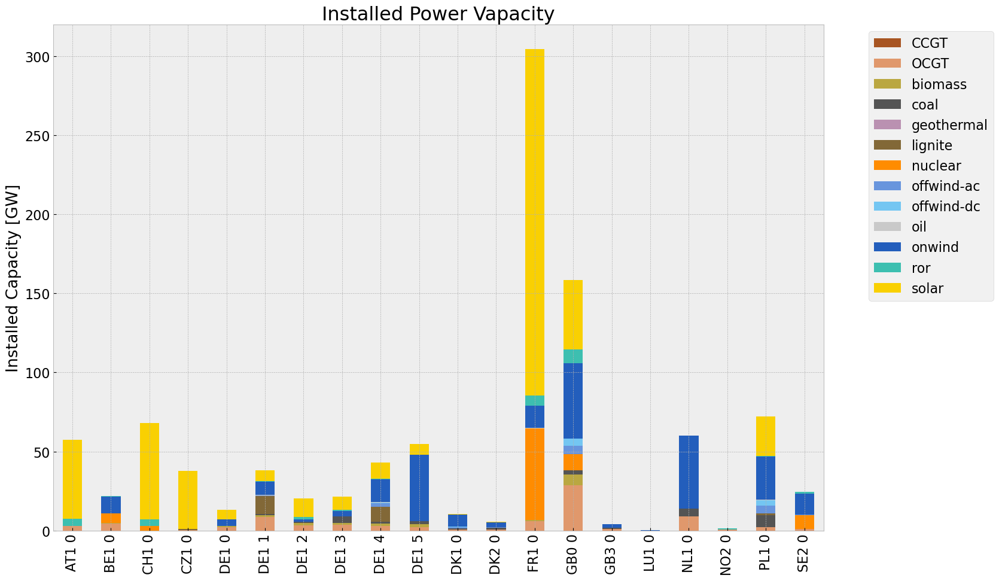

<Figure size 640x480 with 0 Axes>

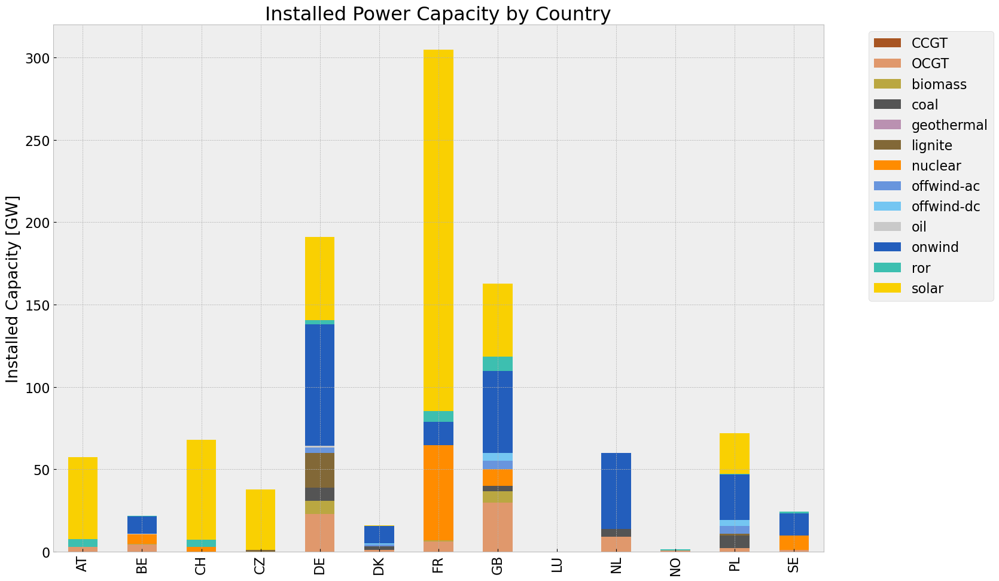

<Figure size 640x480 with 0 Axes>

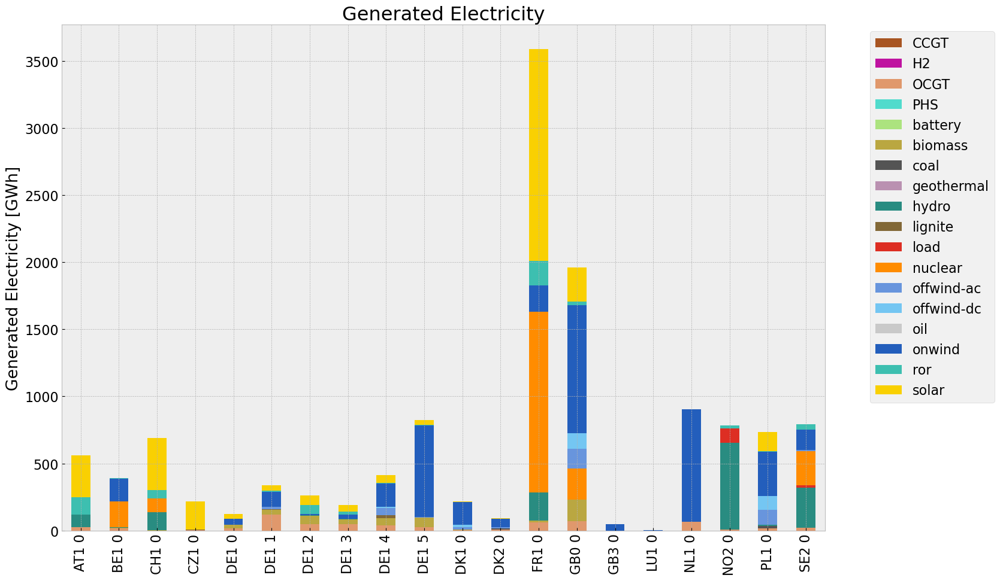

<Figure size 640x480 with 0 Axes>

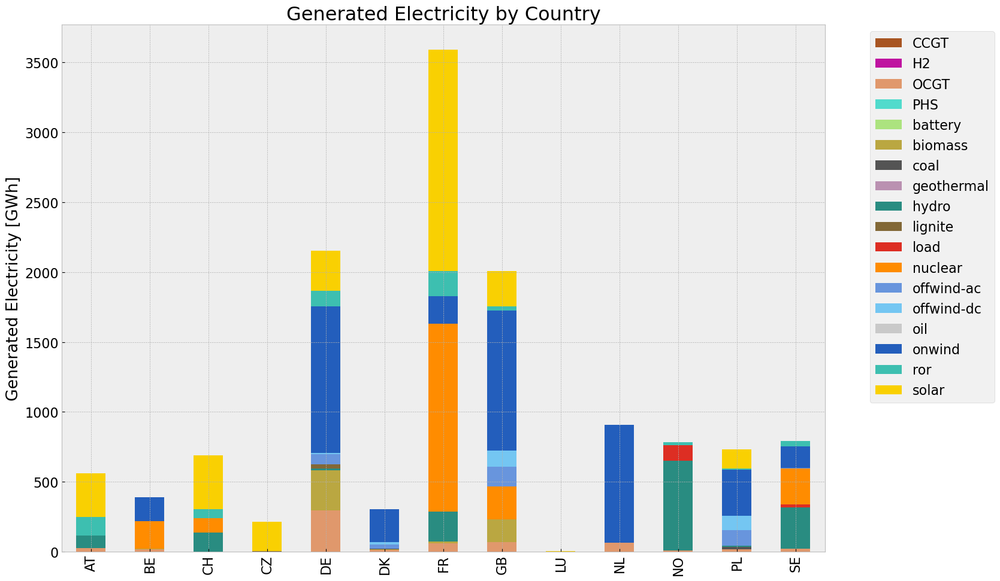

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3768633647.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3768633647.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Users\Jere

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,5.974587e+05,0.451621,0.1980,261938.380893
biomass,4.733575e+05,0.468000,0.0000,0.000000
coal,2.692287e+04,0.329908,0.3361,27428.180300
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,3.468601e+04,0.337285,0.4069,41845.167298
load,1.274518e+05,1.000000,0.0000,0.000000
nuclear,2.135659e+06,0.326600,0.0000,0.000000
offwind-ac,3.696111e+05,1.000000,0.0000,0.000000


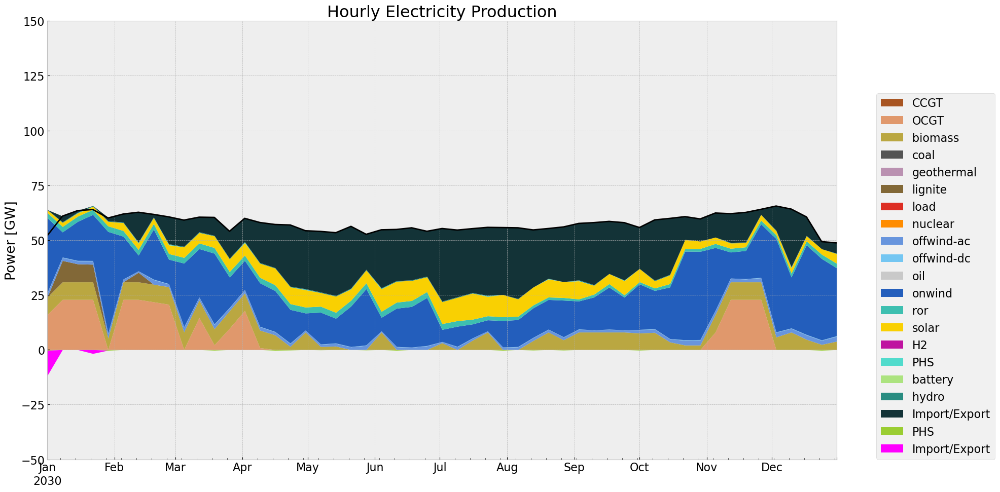

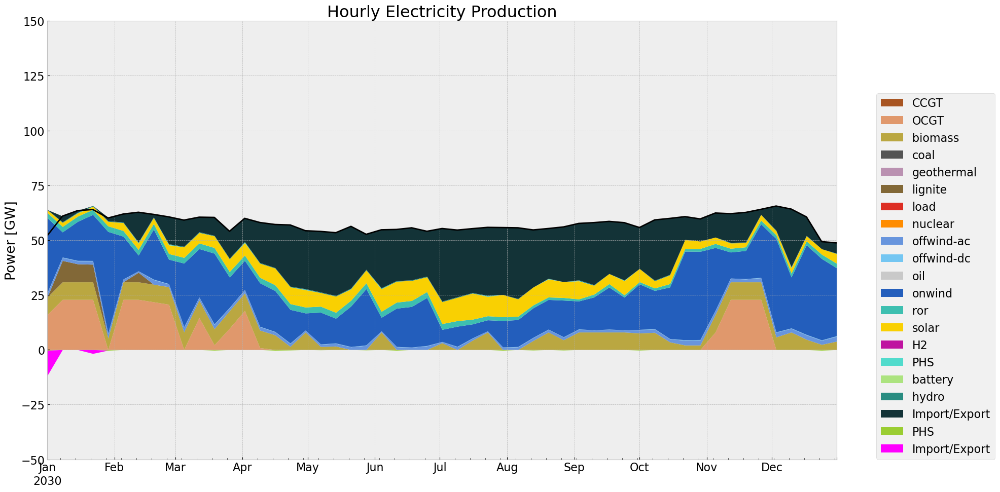

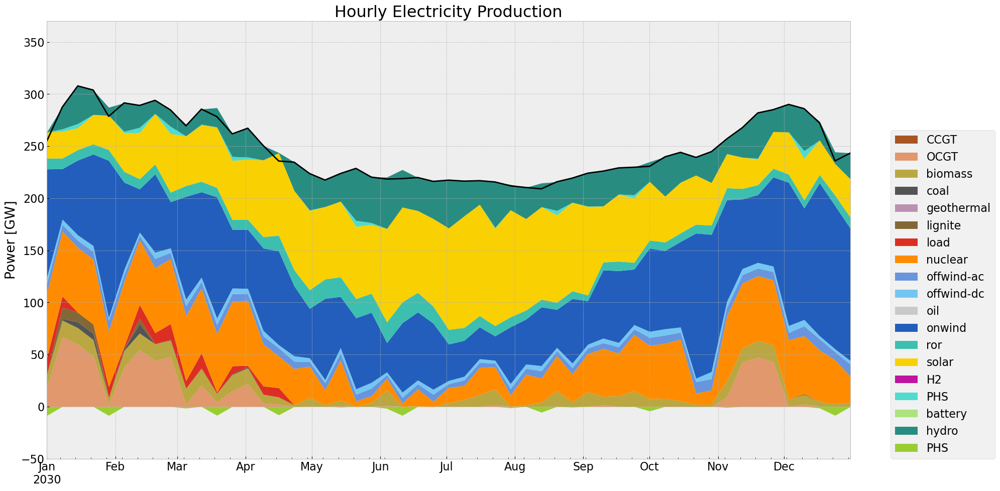

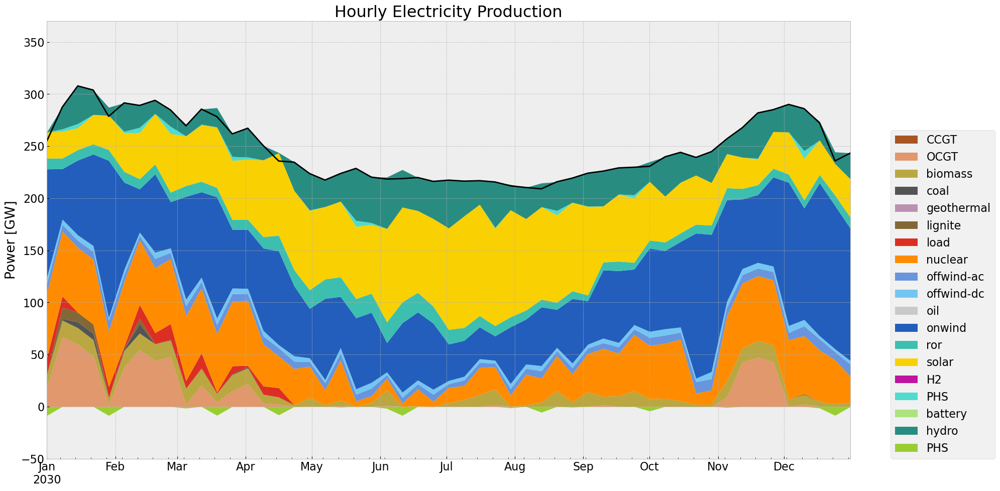

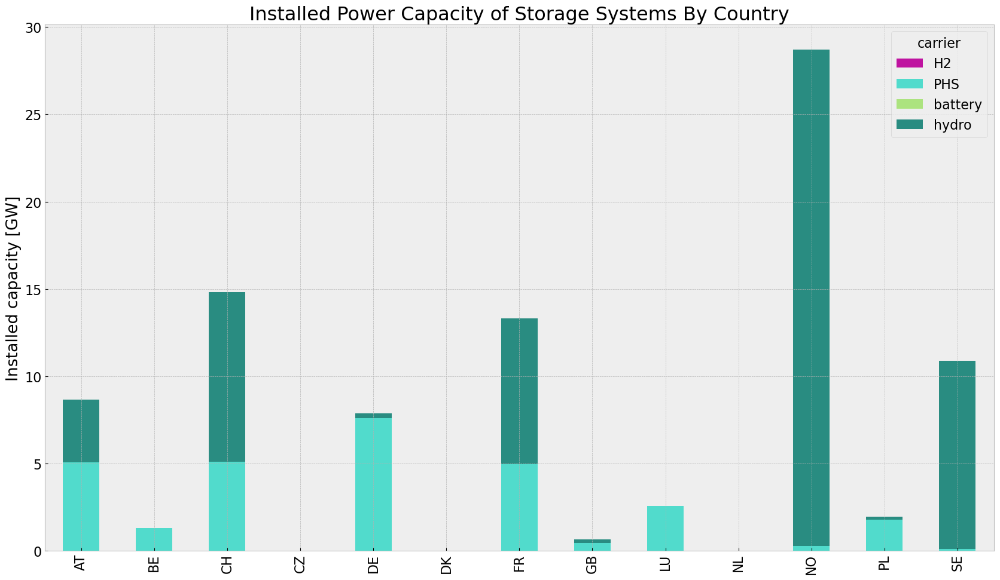

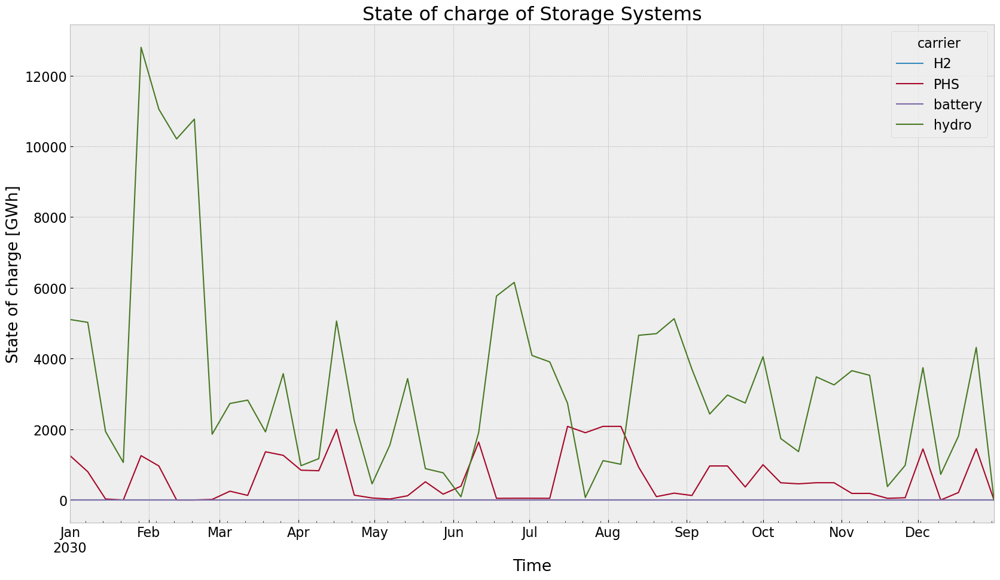

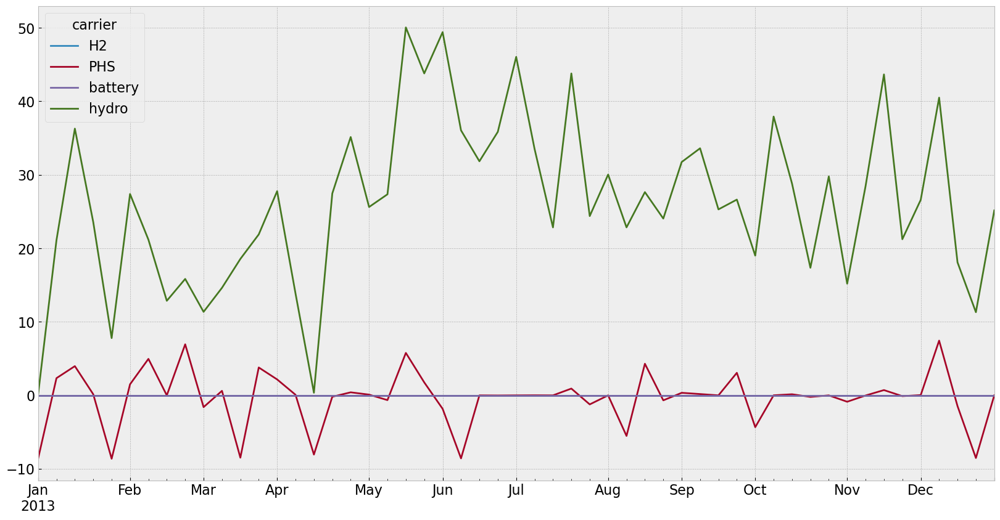

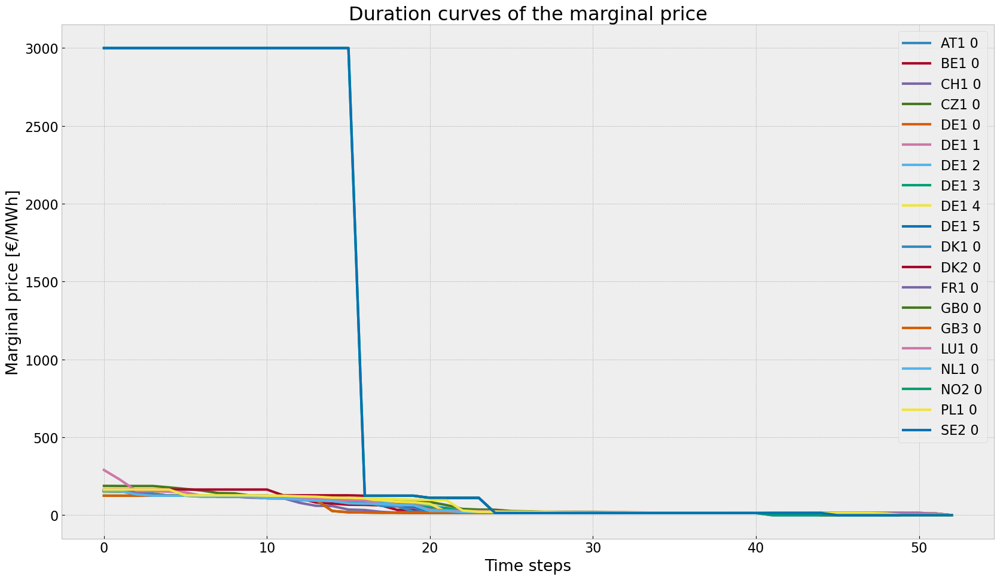

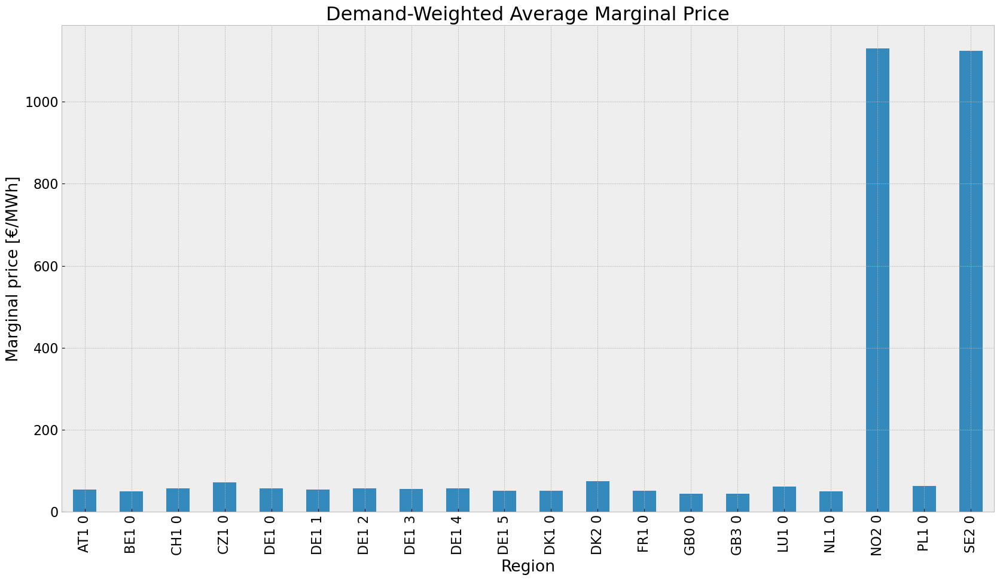

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


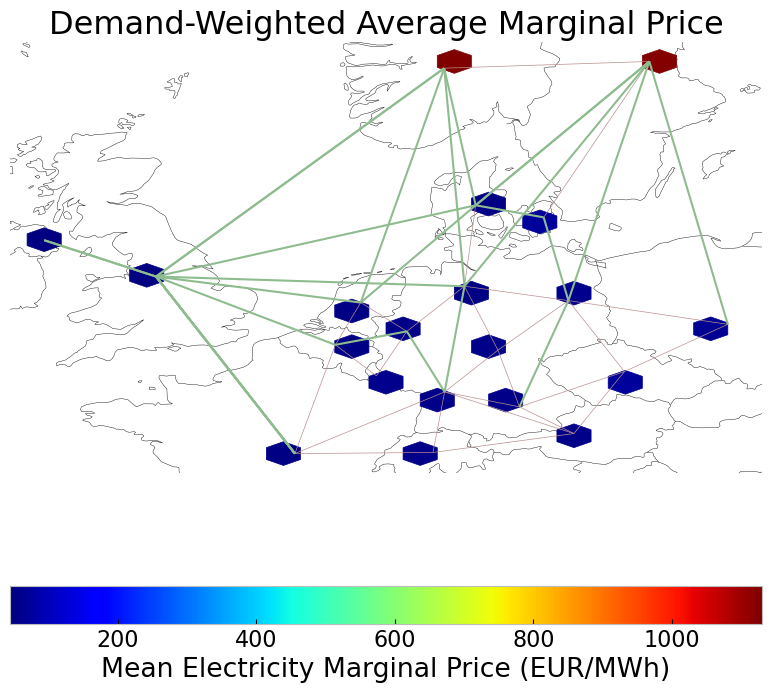

In [64]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_base_roll = inst_cap_table(n_roll, color_cap)
cap_base_roll_country = inst_cap_table_country(n_roll, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_base_roll  = gen_power_table(n_roll)
gen_base_roll_country = gen_power_table_country(n_roll)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n_roll, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n_roll, '2030-01-01', '2030-12-31', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n_roll, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n_roll, '2030-01-01', '2030-12-31', colors_gen)

#installed storage unit & stores
store_base_roll = inst_store_table(n_roll)

#State of Charge Storage unit
state_of_charge_plot(n_roll, '2030-01-01 00:00', '2030-12-31 21:00')
n_roll.storage_units_t.p.groupby(n_roll.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n_roll)

#avg electricity price
price_regions_table(n_roll)
price_regions(n_roll)

#Emission
em_base_roll =em_table(n_roll)
em_base_roll

## 2. Noinv

In [65]:
n2 = dispatchscenario(n, carriers_dispatchable, duration, reductionto)

DE1 1 OCGT
2013-01-01 00:00:00


### No Investment

In [66]:

no_inv(n2,n)


In [67]:
n2.optimize(solver_name ='gurobi')
#filename = f"noinv_{contingency}.nc"
#n2 = import_nc_file(directory, filename)
n2.name = f'noinv_{contingency}'    

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 60.34it/s]
INFO:linopy.io: Writing time: 0.73s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6333a734.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6333a734.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0xc19f334c


INFO:gurobipy:Model fingerprint: 0xc19f334c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56286 rows and 14831 columns


INFO:gurobipy:Presolve removed 56286 rows and 14831 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 2968 rows, 12782 columns, 20891 nonzeros


INFO:gurobipy:Presolved: 2968 rows, 12782 columns, 20891 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.480e+03


INFO:gurobipy: AA' NZ     : 8.480e+03


 Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


 Factor Ops : 5.722e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.722e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.47185261e+13 -2.95551479e+13  4.21e+05 1.46e-11  6.50e+09     0s


INFO:gurobipy:   0   1.47185261e+13 -2.95551479e+13  4.21e+05 1.46e-11  6.50e+09     0s


   1   1.64830963e+12 -7.51161957e+12  4.04e+04 8.73e-11  7.58e+08     0s


INFO:gurobipy:   1   1.64830963e+12 -7.51161957e+12  4.04e+04 8.73e-11  7.58e+08     0s


   2   2.83102424e+11 -2.15432785e+12  3.44e+03 2.46e-09  1.20e+08     0s


INFO:gurobipy:   2   2.83102424e+11 -2.15432785e+12  3.44e+03 2.46e-09  1.20e+08     0s


   3   8.31631091e+10 -3.30839664e+11  2.77e+02 6.11e-10  1.71e+07     0s


INFO:gurobipy:   3   8.31631091e+10 -3.30839664e+11  2.77e+02 6.11e-10  1.71e+07     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.44 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.44 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Extra simplex iterations after uncrush: 2


INFO:gurobipy:Extra simplex iterations after uncrush: 2


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4888    1.4664836e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    4888    1.4664836e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 4888 iterations and 0.53 seconds (0.15 work units)


INFO:gurobipy:Solved in 4888 iterations and 0.53 seconds (0.15 work units)


Optimal objective  1.466483644e+10


INFO:gurobipy:Optimal objective  1.466483644e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 1.47e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Export model for later use

In [68]:
file = f"{n2.name}.nc"
output_path = os.path.join(os.getcwd(), file)
n2.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network noinv_dispatchcut.nc has lines, links, carriers, loads, global_constraints, storage_units, generators, buses


<xarray.Dataset> Size: 272kB
Dimensions:                               (snapshots: 53,
                                           investment_periods: 0, lines_i: 27,
                                           lines_t_p0_i: 27, lines_t_p1_i: 27,
                                           lines_t_loss_i: 27, links_i: 28,
                                           links_t_p0_i: 12, links_t_p1_i: 12,
                                           carriers_i: 21, loads_i: 20,
                                           ...
                                           generators_i: 261,
                                           generators_t_p_max_pu_i: 82,
                                           generators_t_p_i: 98, buses_i: 20,
                                           buses_t_p_i: 20,
                                           buses_t_v_ang_i: 18,
                                           buses_t_marginal_price_i: 20)
Coordinates: (12/27)
  * snapshots                             (snapshots) int64 424B 0 1 2 ... 51 52
  * investment_periods                    (investment_periods) int64 0B 
  * lines_i                               (lines_i) object 216B '0' '1' ... '9'
  * lines_t_p0_i                          (lines_t_p0_i) object 216B '0' ... '9'
  * lines_t_p1_i                          (lines_t_p1_i) object 216B '0' ... '9'
  * lines_t_loss_i                        (lines_t_loss_i) object 216B '0' .....
    ...                                    ...
  * generators_t_p_max_pu_i               (generators_t_p_max_pu_i) object 656B ...
  * generators_t_p_i                      (generators_t_p_i) object 784B 'AT1...
  * buses_i                               (buses_i) object 160B 'AT1 0' ... '...
  * buses_t_p_i                           (buses_t_p_i) object 160B 'AT1 0' ....
  * buses_t_v_ang_i                       (buses_t_v_ang_i) object 144B 'AT1 ...
  * buses_t_marginal_price_i              (buses_t_marginal_price_i) object 160B ...
Data variables: (12/98)
    snapshots_snapshot                    (snapshots) datetime64[ns] 424B 201...
    snapshots_objective                   (snapshots) float64 424B 168.0 ... ...
    snapshots_generators                  (snapshots) float64 424B 168.0 ... ...
    snapshots_stores                      (snapshots) float64 424B 168.0 ... ...
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    buses_country                         (buses_i) object 160B 'AT' ... 'SE'
    buses_control                         (buses_i) object 160B 'Slack' ... 'PQ'
    buses_generator                       (buses_i) object 160B 'AT1 0 CCGT' ...
    buses_t_p                             (snapshots, buses_t_p_i) float64 8kB ...
    buses_t_v_ang                         (snapshots, buses_t_v_ang_i) float64 8kB ...
    buses_t_marginal_price                (snapshots, buses_t_marginal_price_i) float64 8kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            noinv_dispatchcut
    network_objective:       14664836444.437641
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [69]:
tot_cos_noinv=n2.objective/1e9 #billion €
system_cost_noinv = system_cost(n2) #million €/a
marg_price_region_noinv = n2.buses_t.marginal_price.mean()
stat_noinv = n2.statistics()

### Installed Capacity

Since expansion is not allowed in this scenario, the installed capacity will equal to that of the base scenario.

<Figure size 640x480 with 0 Axes>

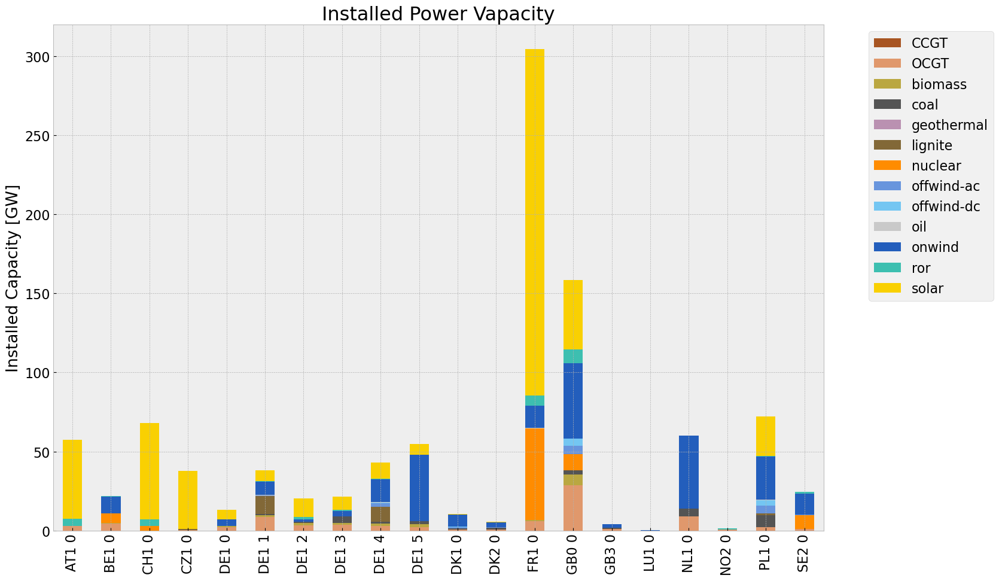

<Figure size 640x480 with 0 Axes>

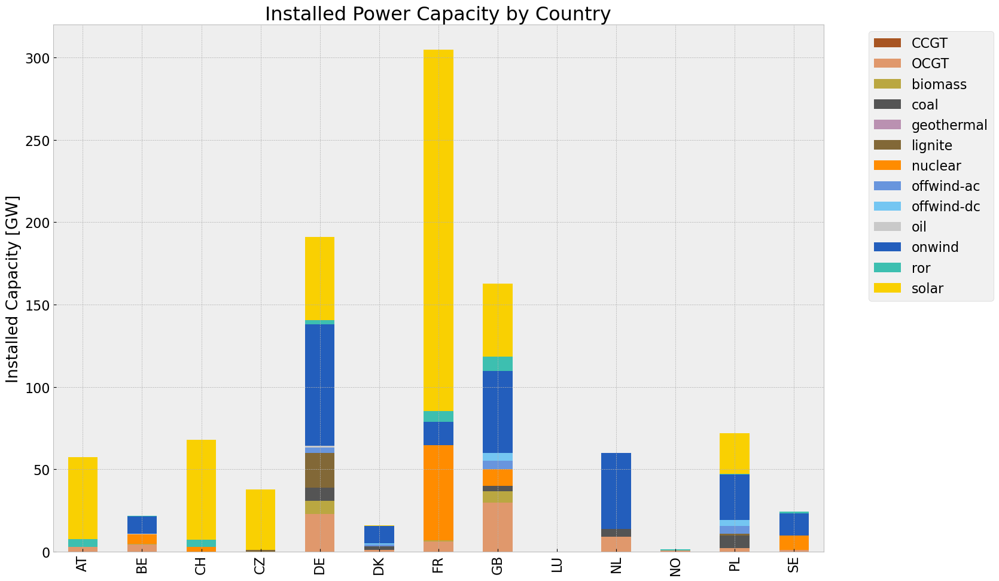

In [70]:
# consolidated istalled cap without load_shedding

#capacities_noinv = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv.fillna(0, inplace=True)
#gen = (capacities_noinv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv = inst_cap_table(n2, color_cap)
cap_noinv_country= inst_cap_table_country(n2, color_cap)



### Generation

<Figure size 640x480 with 0 Axes>

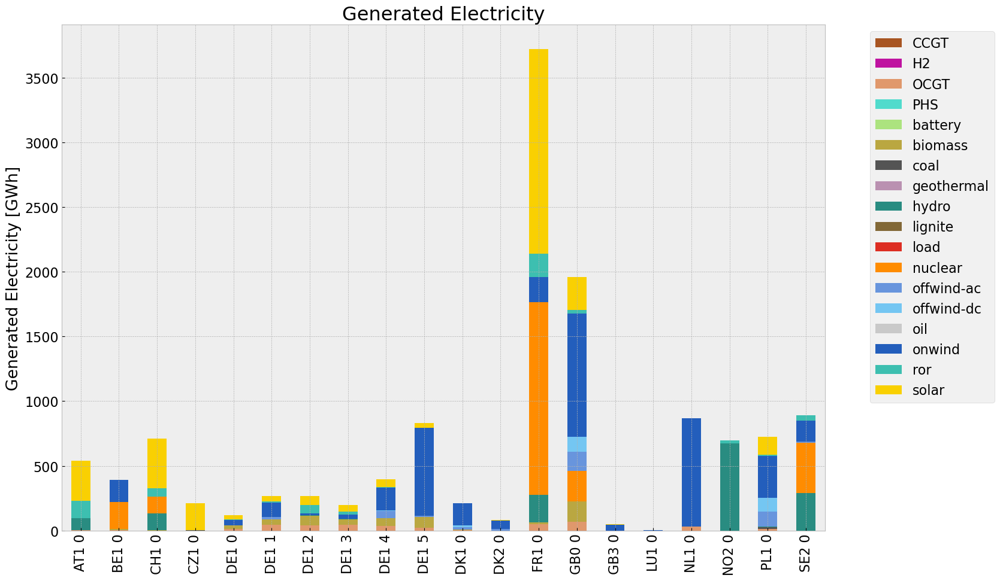

<Figure size 640x480 with 0 Axes>

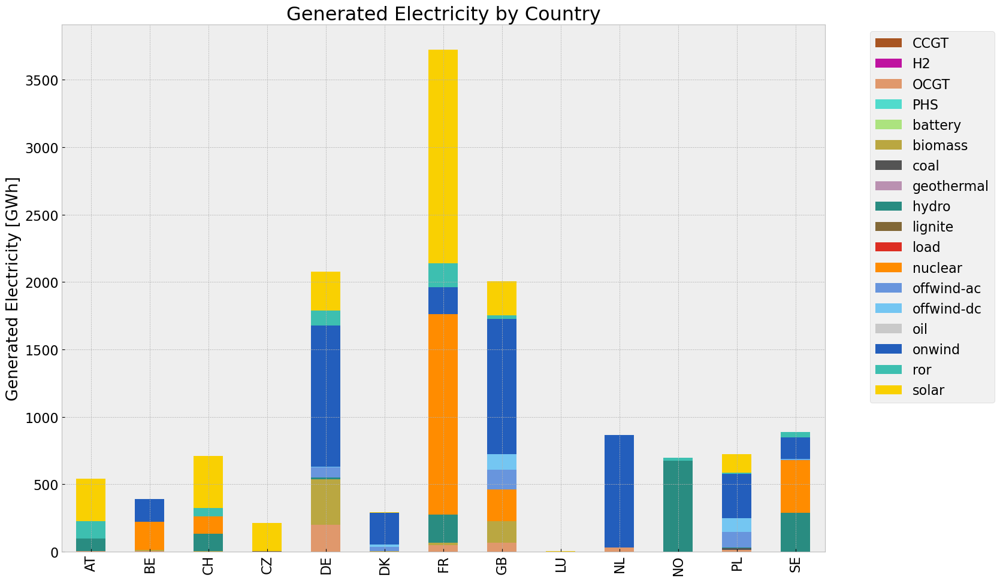

In [71]:
# consolidated generation table
#carrier = n2.generators.carrier.unique()
#df_tot_generation = n2.generators_t.p.sum()

#generations = pd.Series(index = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
                #generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')

#generations.fillna(0, inplace=True)
#gen_noinv = generations.unstack()/1000#GWh

gen_noinv= gen_power_table(n2)
gen_noinv_country = gen_power_table_country(n2)


### Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\2267199707.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\2267199707.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #M

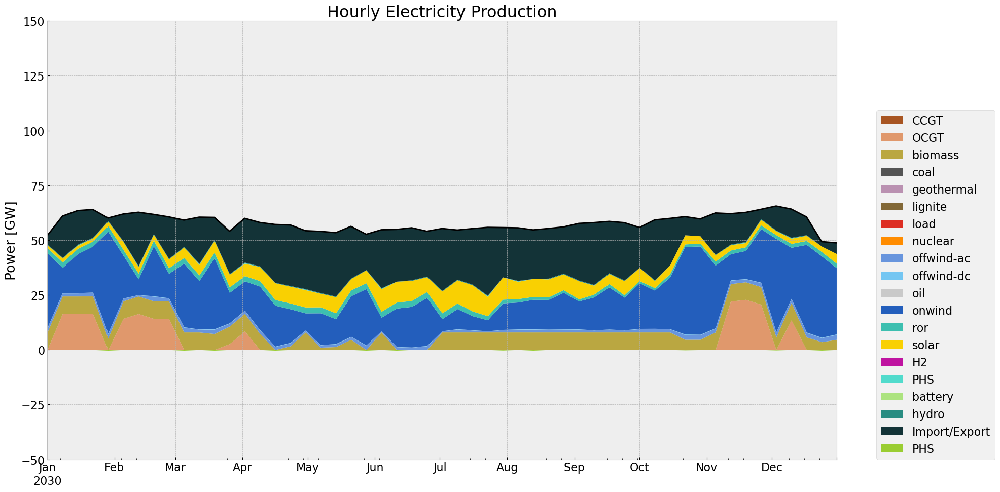

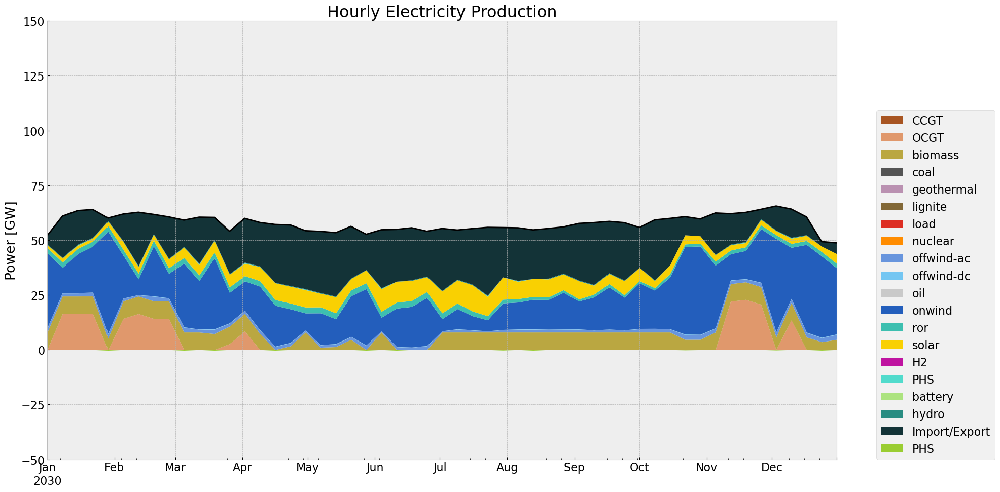

In [72]:
p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n2, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n2, '2030-01-01', '2030-12-31', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\2732365766.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\2732365766.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\2732365766.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\2732365766.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='16

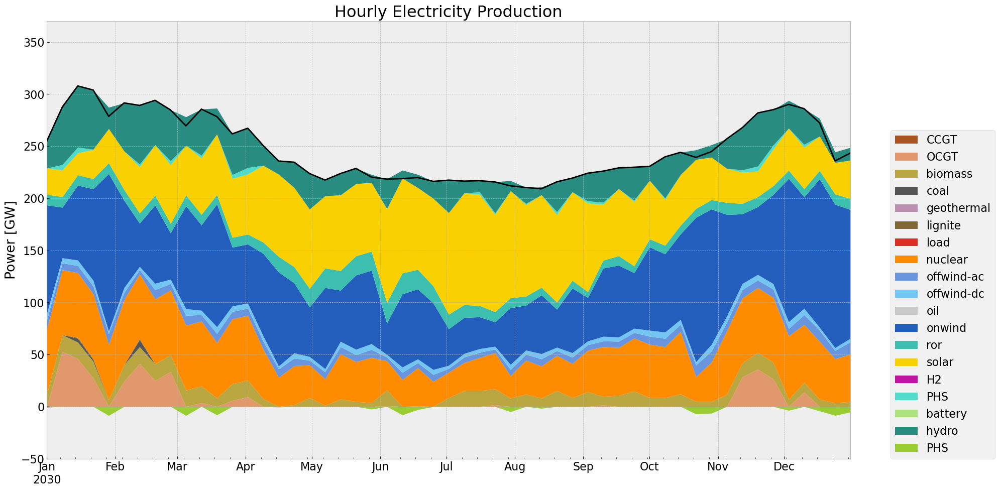

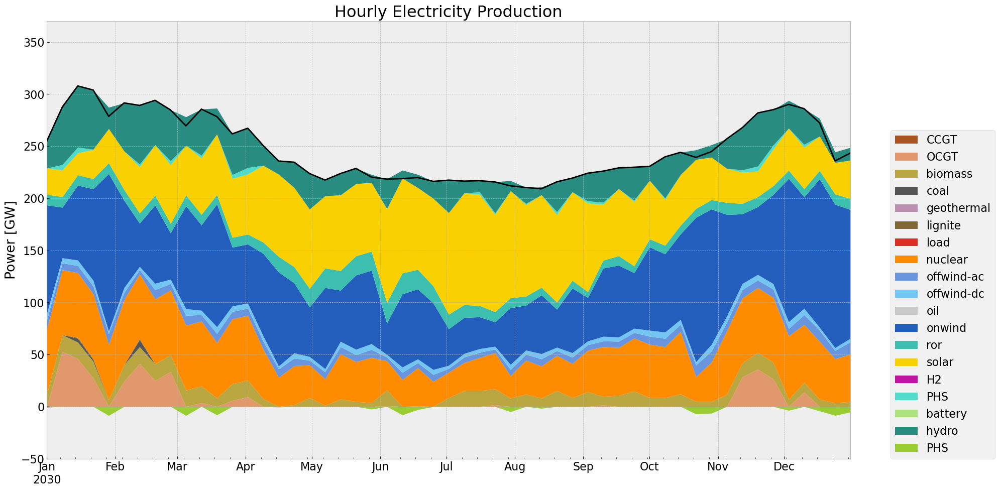

In [73]:
#generation curve all countries
#winter
gen_curve_tot(n2, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n2, '2030-01-01', '2030-12-31', colors_gen)

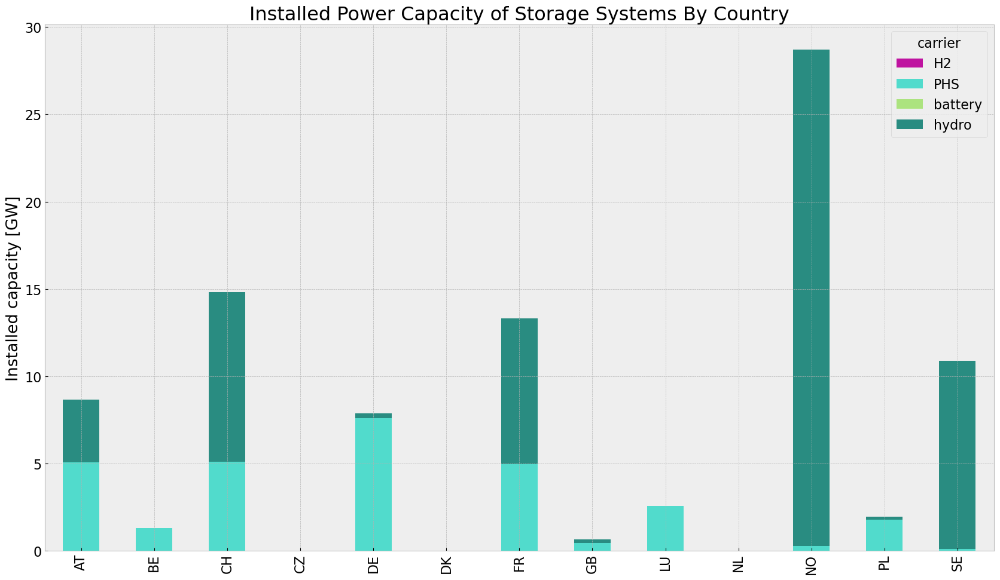

In [74]:
#storage unit capacities
store_noinv = inst_store_table(n2)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\4184885543.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\4184885543.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\4184885543.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3064997258.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  n2.storage_units_t.p.groupby(n.storage_units.carrier, axis

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,3.769301e+05,0.451621,0.1980,165254.019249
biomass,5.322671e+05,0.468000,0.0000,0.000000
coal,1.183294e+04,0.329908,0.3361,12055.029104
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,2.650281e+03,0.337285,0.4069,3197.296502
load,0.000000e+00,1.000000,0.0000,0.000000
nuclear,2.445132e+06,0.326600,0.0000,0.000000
offwind-ac,3.712800e+05,1.000000,0.0000,0.000000


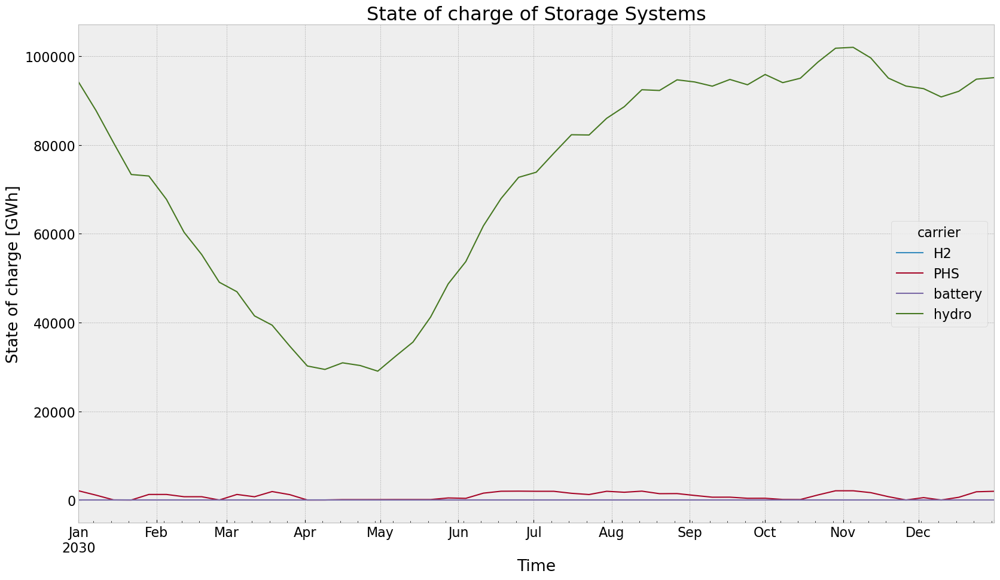

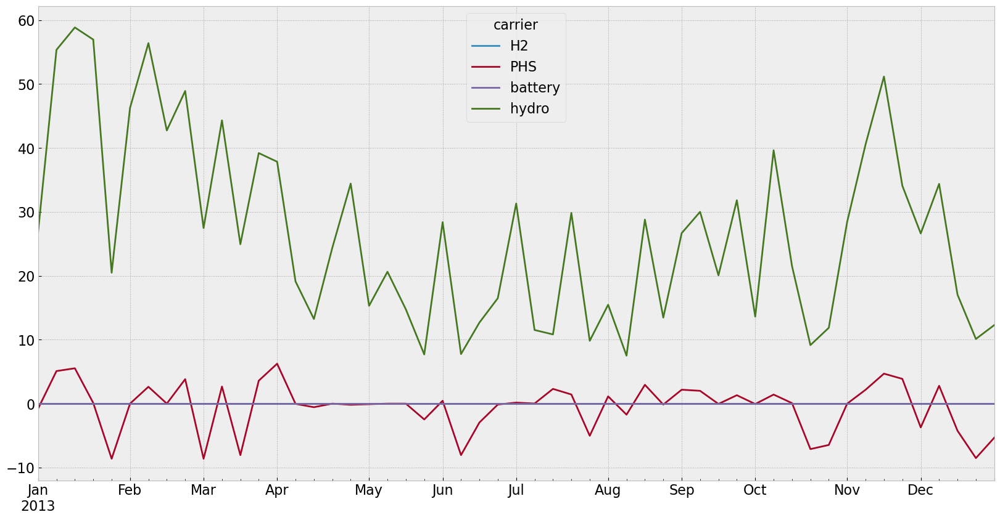

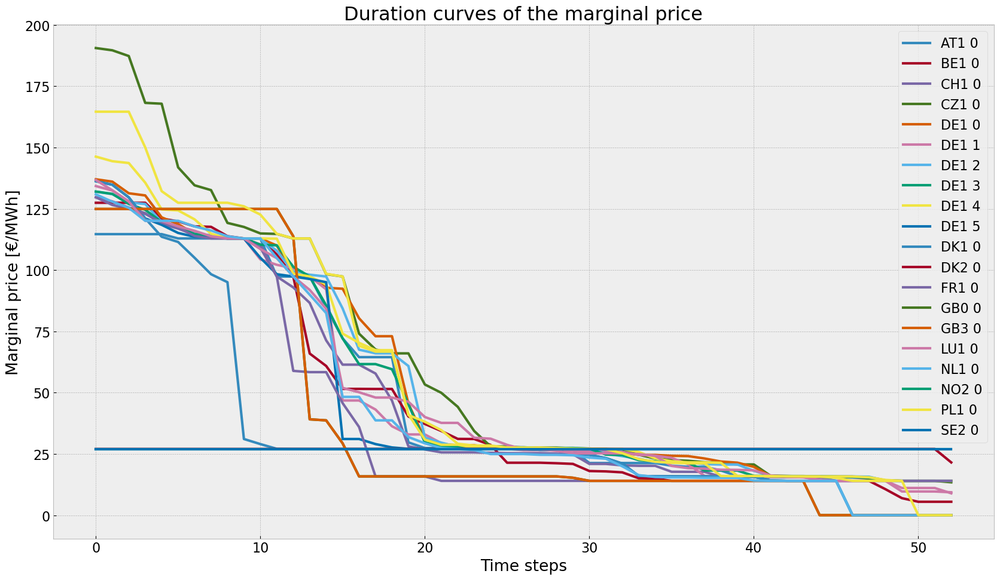

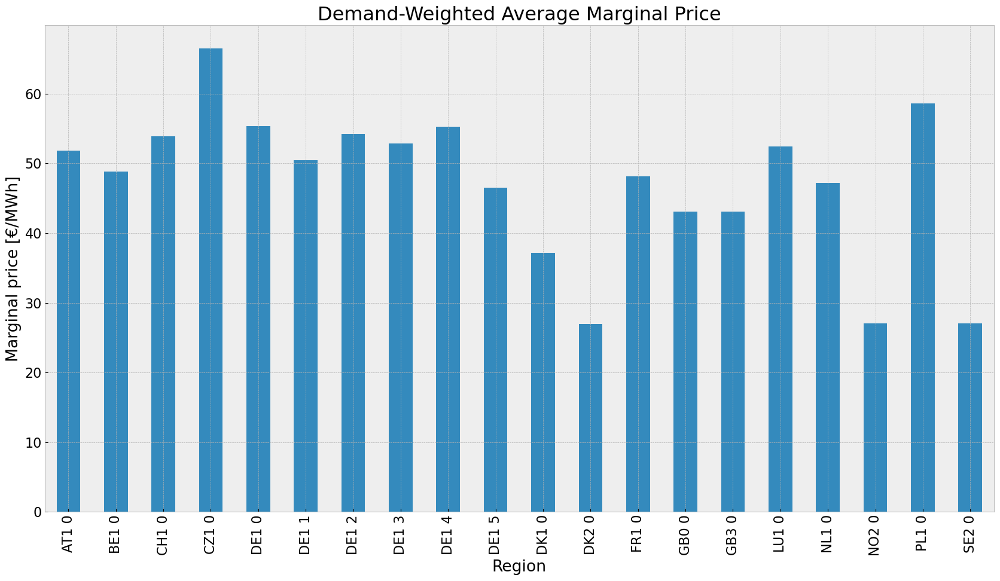

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


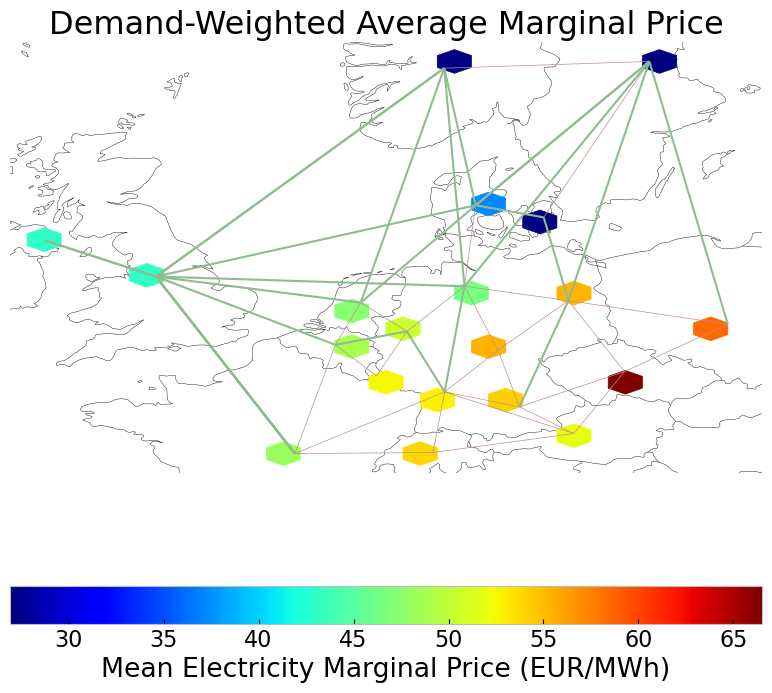

In [75]:
#state of charge
state_of_charge_plot(n2, '2030-01-01 00:00', '2030-12-31 21:00')
n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))
#price
price_dur_curve_plot(n2)
price_regions_table(n2)
price_regions(n2)
#emission
em_noinv =em_table(n2)
em_noinv

## 3. Scenario: rolling horizon foresight with no additional investment

In [76]:
n3 = n2.copy()
no_inv(n3,n2)
n3.storage_units['cyclic_state_of_charge'] = False
n3.storage_units['cyclic_state_of_charge_per_period'] = False


optimize.optimize_with_rolling_horizon(n3, horizon=horizon, overlap=0, solver_name='gurobi')
#filename = f"noinv_roll_{contingency}.nc"
#n3 = import_nc_file(directory, filename)
n3.name = f'noinv_roll_{contingency}'

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-no41jg6g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-no41jg6g.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x5693b861


INFO:gurobipy:Model fingerprint: 0x5693b861


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1148 columns


INFO:gurobipy:Presolve removed 4248 rows and 1148 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 936 columns, 1523 nonzeros


INFO:gurobipy:Presolved: 224 rows, 936 columns, 1523 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9320496e+08   9.022944e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9320496e+08   9.022944e+05   0.000000e+00      0s


     286    1.9357488e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     286    1.9357488e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 286 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 286 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.935748799e+10


INFO:gurobipy:Optimal objective  1.935748799e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.94e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-us05h4be.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-us05h4be.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x6ffa9d36


INFO:gurobipy:Model fingerprint: 0x6ffa9d36


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4249 rows and 1159 columns


INFO:gurobipy:Presolve removed 4249 rows and 1159 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 223 rows, 925 columns, 1506 nonzeros


INFO:gurobipy:Presolved: 223 rows, 925 columns, 1506 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0872479e+09   8.398908e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0872479e+09   8.398908e+05   0.000000e+00      0s


     289    2.2244320e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     289    2.2244320e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 289 iterations and 0.06 seconds (0.01 work units)


INFO:gurobipy:Solved in 289 iterations and 0.06 seconds (0.01 work units)


Optimal objective  2.224431956e+10


INFO:gurobipy:Optimal objective  2.224431956e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.22e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-shjgxy65.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-shjgxy65.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xa2afcd3d


INFO:gurobipy:Model fingerprint: 0xa2afcd3d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4249 rows and 1149 columns


INFO:gurobipy:Presolve removed 4249 rows and 1149 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 935 columns, 1516 nonzeros


INFO:gurobipy:Presolved: 223 rows, 935 columns, 1516 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2209564e+09   8.905329e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2209564e+09   8.905329e+05   0.000000e+00      0s


     307    2.1592942e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     307    2.1592942e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 307 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 307 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.159294215e+10


INFO:gurobipy:Optimal objective  2.159294215e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.16e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_v_nst3k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_v_nst3k.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xaae3ea12


INFO:gurobipy:Model fingerprint: 0xaae3ea12


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4255 rows and 1161 columns


INFO:gurobipy:Presolve removed 4255 rows and 1161 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 217 rows, 923 columns, 1493 nonzeros


INFO:gurobipy:Presolved: 217 rows, 923 columns, 1493 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1998435e+09   9.109727e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1998435e+09   9.109727e+05   0.000000e+00      0s


     284    1.5208895e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     284    1.5208895e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 284 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 284 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.520889511e+10


INFO:gurobipy:Optimal objective  1.520889511e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.52e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1gwe8sxz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1gwe8sxz.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x8d47eaaf


INFO:gurobipy:Model fingerprint: 0x8d47eaaf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4255 rows and 1165 columns


INFO:gurobipy:Presolve removed 4255 rows and 1165 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 217 rows, 919 columns, 1489 nonzeros


INFO:gurobipy:Presolved: 217 rows, 919 columns, 1489 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.4918123e+08   9.162677e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.4918123e+08   9.162677e+05   0.000000e+00      0s


     313    2.3448261e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     313    2.3448261e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 313 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 313 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.344826056e+09


INFO:gurobipy:Optimal objective  2.344826056e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.34e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-brq233yi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-brq233yi.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x500a1c97


INFO:gurobipy:Model fingerprint: 0x500a1c97


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4266 rows and 1187 columns


INFO:gurobipy:Presolve removed 4266 rows and 1187 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 206 rows, 897 columns, 1448 nonzeros


INFO:gurobipy:Presolved: 206 rows, 897 columns, 1448 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6058794e+07   9.034834e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6058794e+07   9.034834e+05   0.000000e+00      0s


     282    1.7053473e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     282    1.7053473e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 282 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 282 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.705347252e+08


INFO:gurobipy:Optimal objective  1.705347252e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.71e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fb6etqhv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fb6etqhv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xb10633af


INFO:gurobipy:Model fingerprint: 0xb10633af


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4254 rows and 1154 columns


INFO:gurobipy:Presolve removed 4254 rows and 1154 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 218 rows, 930 columns, 1506 nonzeros


INFO:gurobipy:Presolved: 218 rows, 930 columns, 1506 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6054383e+07   9.322489e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6054383e+07   9.322489e+05   0.000000e+00      0s


     307    1.4642492e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     307    1.4642492e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 307 iterations and 0.06 seconds (0.01 work units)


INFO:gurobipy:Solved in 307 iterations and 0.06 seconds (0.01 work units)


Optimal objective  1.464249211e+08


INFO:gurobipy:Optimal objective  1.464249211e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.46e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f2usz9vw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f2usz9vw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x38083561


INFO:gurobipy:Model fingerprint: 0x38083561


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4248 rows and 1142 columns


INFO:gurobipy:Presolve removed 4248 rows and 1142 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 942 columns, 1529 nonzeros


INFO:gurobipy:Presolved: 224 rows, 942 columns, 1529 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1595451e+07   8.983986e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1595451e+07   8.983986e+05   0.000000e+00      0s


     332    3.2459409e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     332    3.2459409e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 332 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 332 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.245940877e+08


INFO:gurobipy:Optimal objective  3.245940877e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6a4eio3_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6a4eio3_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xcf3dbd7b


INFO:gurobipy:Model fingerprint: 0xcf3dbd7b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1141 columns


INFO:gurobipy:Presolve removed 4248 rows and 1141 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 943 columns, 1530 nonzeros


INFO:gurobipy:Presolved: 224 rows, 943 columns, 1530 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1615286e+07   8.982206e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1615286e+07   8.982206e+05   0.000000e+00      0s


     379    3.8622026e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     379    3.8622026e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 379 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 379 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.862202647e+08


INFO:gurobipy:Optimal objective  3.862202647e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.86e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4mh3e_bc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4mh3e_bc.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xde699d85


INFO:gurobipy:Model fingerprint: 0xde699d85


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1146 columns


INFO:gurobipy:Presolve removed 4248 rows and 1146 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 938 columns, 1525 nonzeros


INFO:gurobipy:Presolved: 224 rows, 938 columns, 1525 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6013515e+07   9.006435e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6013515e+07   9.006435e+05   0.000000e+00      0s


     291    7.1007910e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     291    7.1007910e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 291 iterations and 0.06 seconds (0.01 work units)


INFO:gurobipy:Solved in 291 iterations and 0.06 seconds (0.01 work units)


Optimal objective  7.100791041e+08


INFO:gurobipy:Optimal objective  7.100791041e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 7.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zmp3mb4s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zmp3mb4s.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x1b46c9de


INFO:gurobipy:Model fingerprint: 0x1b46c9de


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1140 columns


INFO:gurobipy:Presolve removed 4248 rows and 1140 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 944 columns, 1531 nonzeros


INFO:gurobipy:Presolved: 224 rows, 944 columns, 1531 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1288144e+05   8.969974e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1288144e+05   8.969974e+05   0.000000e+00      0s


     332    5.0520030e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     332    5.0520030e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 332 iterations and 0.06 seconds (0.01 work units)


INFO:gurobipy:Solved in 332 iterations and 0.06 seconds (0.01 work units)


Optimal objective  5.052003006e+08


INFO:gurobipy:Optimal objective  5.052003006e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 5.05e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jyivzugb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jyivzugb.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xdbf849db


INFO:gurobipy:Model fingerprint: 0xdbf849db


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1134 columns


INFO:gurobipy:Presolve removed 4248 rows and 1134 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 950 columns, 1537 nonzeros


INFO:gurobipy:Presolved: 224 rows, 950 columns, 1537 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2054966e+07   8.642865e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2054966e+07   8.642865e+05   0.000000e+00      0s


     335    3.4265061e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     335    3.4265061e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 335 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 335 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.426506150e+09


INFO:gurobipy:Optimal objective  3.426506150e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.43e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-90960p7s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-90960p7s.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xeed377e9


INFO:gurobipy:Model fingerprint: 0xeed377e9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1158 columns


INFO:gurobipy:Presolve removed 4248 rows and 1158 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 926 columns, 1513 nonzeros


INFO:gurobipy:Presolved: 224 rows, 926 columns, 1513 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.4233708e+05   8.867421e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.4233708e+05   8.867421e+05   0.000000e+00      0s


     265    9.0958848e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     265    9.0958848e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 265 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 265 iterations and 0.05 seconds (0.00 work units)


Optimal objective  9.095884786e+08


INFO:gurobipy:Optimal objective  9.095884786e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 9.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e69nphcv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e69nphcv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 1118 rows, 521 columns, 1767 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1767 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


Model fingerprint: 0x00325c3d


INFO:gurobipy:Model fingerprint: 0x00325c3d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1072 rows and 315 columns


INFO:gurobipy:Presolve removed 1072 rows and 315 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 46 rows, 206 columns, 324 nonzeros


INFO:gurobipy:Presolved: 46 rows, 206 columns, 324 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2592674e+04   8.611146e+04   0.000000e+00      0s


INFO:gurobipy:       0    3.2592674e+04   8.611146e+04   0.000000e+00      0s


      41    9.9654766e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      41    9.9654766e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 41 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 41 iterations and 0.04 seconds (0.00 work units)


Optimal objective  9.965476552e+06


INFO:gurobipy:Optimal objective  9.965476552e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 9.97e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Export Model for later use

In [77]:
filename = f"{n3.name}.nc"
output_path = os.path.join(os.getcwd(), filename)
n3.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network noinv_roll_dispatchcut.nc has lines, links, carriers, loads, global_constraints, storage_units, generators, buses


<xarray.Dataset> Size: 278kB
Dimensions:                                          (snapshots: 53,
                                                      investment_periods: 0,
                                                      lines_i: 27,
                                                      lines_t_p0_i: 27,
                                                      lines_t_p1_i: 27,
                                                      lines_t_loss_i: 27,
                                                      ...
                                                      generators_t_p_max_pu_i: 82,
                                                      generators_t_p_i: 106,
                                                      buses_i: 20,
                                                      buses_t_p_i: 20,
                                                      buses_t_v_ang_i: 18,
                                                      buses_t_marginal_price_i: 20)
Coordinates: (12/28)
  * snapshots                                        (snapshots) int64 424B 0...
  * investment_periods                               (investment_periods) int64 0B ...
  * lines_i                                          (lines_i) object 216B '0...
  * lines_t_p0_i                                     (lines_t_p0_i) object 216B ...
  * lines_t_p1_i                                     (lines_t_p1_i) object 216B ...
  * lines_t_loss_i                                   (lines_t_loss_i) object 216B ...
    ...                                               ...
  * generators_t_p_max_pu_i                          (generators_t_p_max_pu_i) object 656B ...
  * generators_t_p_i                                 (generators_t_p_i) object 848B ...
  * buses_i                                          (buses_i) object 160B 'A...
  * buses_t_p_i                                      (buses_t_p_i) object 160B ...
  * buses_t_v_ang_i                                  (buses_t_v_ang_i) object 144B ...
  * buses_t_marginal_price_i                         (buses_t_marginal_price_i) object 160B ...
Data variables: (12/99)
    snapshots_snapshot                               (snapshots) datetime64[ns] 424B ...
    snapshots_objective                              (snapshots) float64 424B ...
    snapshots_generators                             (snapshots) float64 424B ...
    snapshots_stores                                 (snapshots) float64 424B ...
    investment_periods_objective                     (investment_periods) float64 0B ...
    investment_periods_years                         (investment_periods) float64 0B ...
    ...                                               ...
    buses_country                                    (buses_i) object 160B 'A...
    buses_control                                    (buses_i) object 160B 'S...
    buses_generator                                  (buses_i) object 160B 'A...
    buses_t_p                                        (snapshots, buses_t_p_i) float64 8kB ...
    buses_t_v_ang                                    (snapshots, buses_t_v_ang_i) float64 8kB ...
    buses_t_marginal_price                           (snapshots, buses_t_marginal_price_i) float64 8kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            noinv_roll_dispatchcut
    network_objective:       9965476.55201545
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [78]:
tot_cos_noinv_roll=n3.objective/1e9 #billion €
system_cost_noinv_roll = system_cost(n3) #million €/a
marg_price_region_noinv_roll = n3.buses_t.marginal_price.mean()
stat_noinv_roll = n3.statistics()

<Figure size 640x480 with 0 Axes>

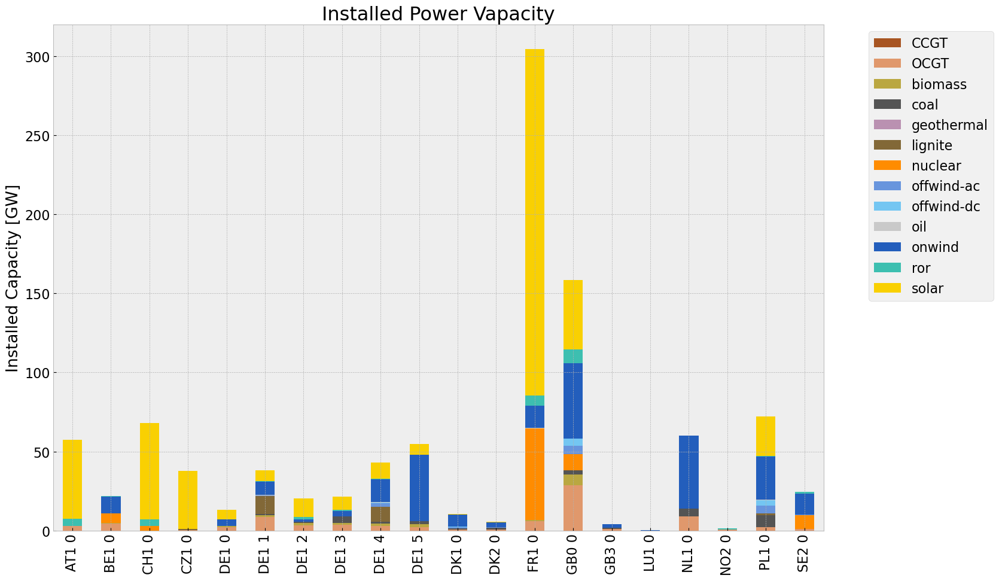

<Figure size 640x480 with 0 Axes>

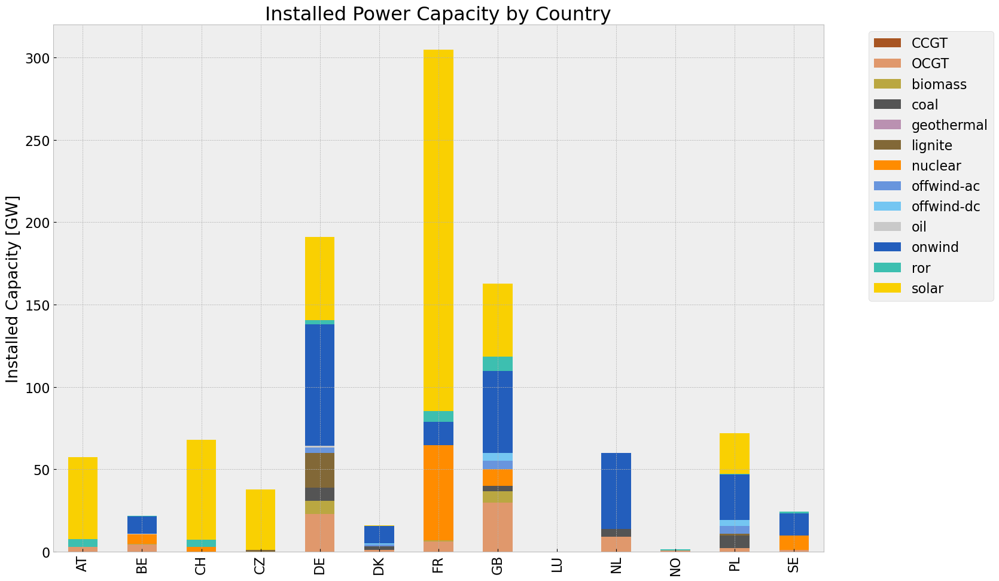

<Figure size 640x480 with 0 Axes>

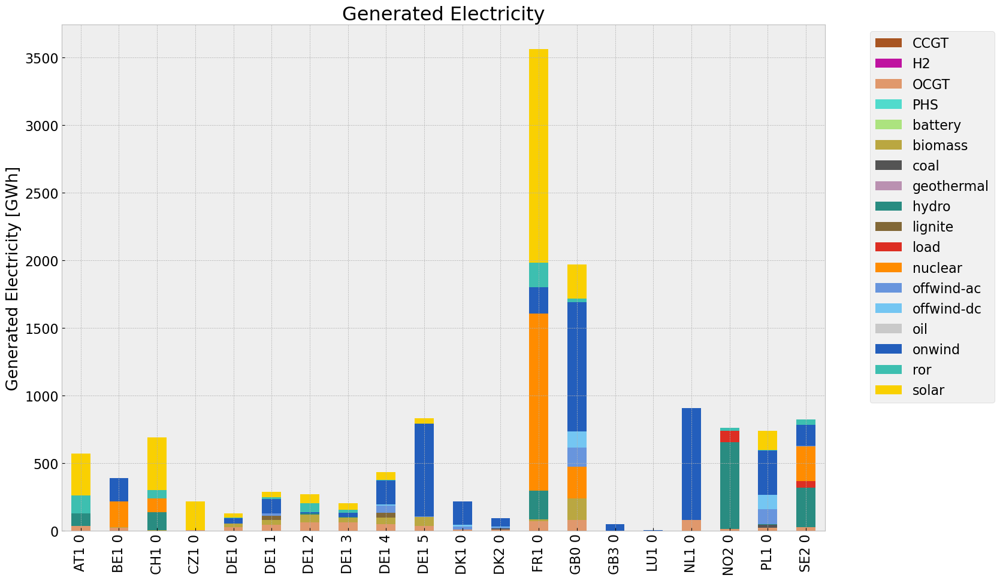

<Figure size 640x480 with 0 Axes>

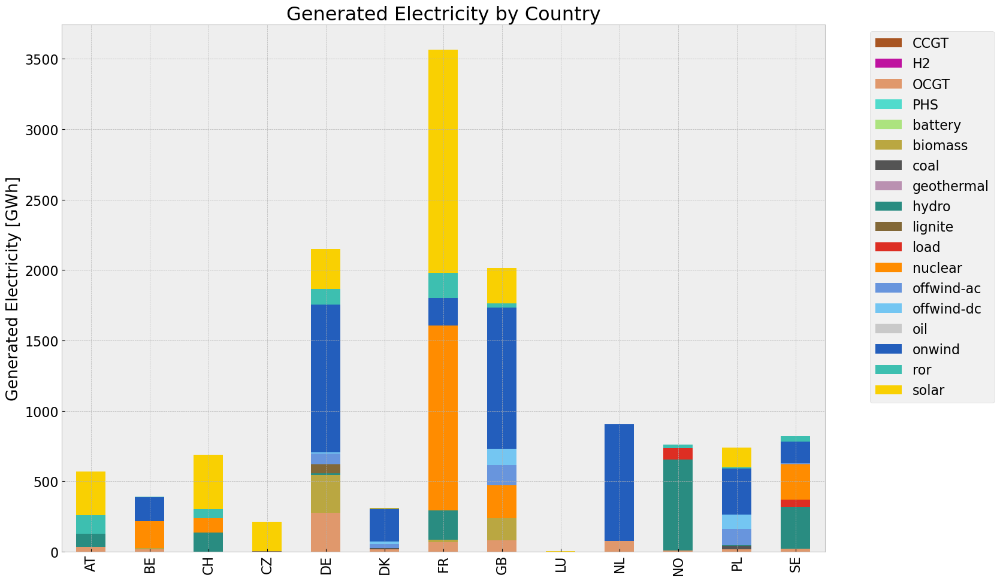

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3768633647.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3768633647.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Users\Jere

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,6.316606e+05,0.451621,0.1980,276933.197391
biomass,4.539441e+05,0.468000,0.0000,0.000000
coal,2.893727e+04,0.329908,0.3361,29480.388917
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,6.660391e+04,0.337285,0.4069,80350.897012
load,1.321912e+05,1.000000,0.0000,0.000000
nuclear,2.092576e+06,0.326600,0.0000,0.000000
offwind-ac,3.700154e+05,1.000000,0.0000,0.000000


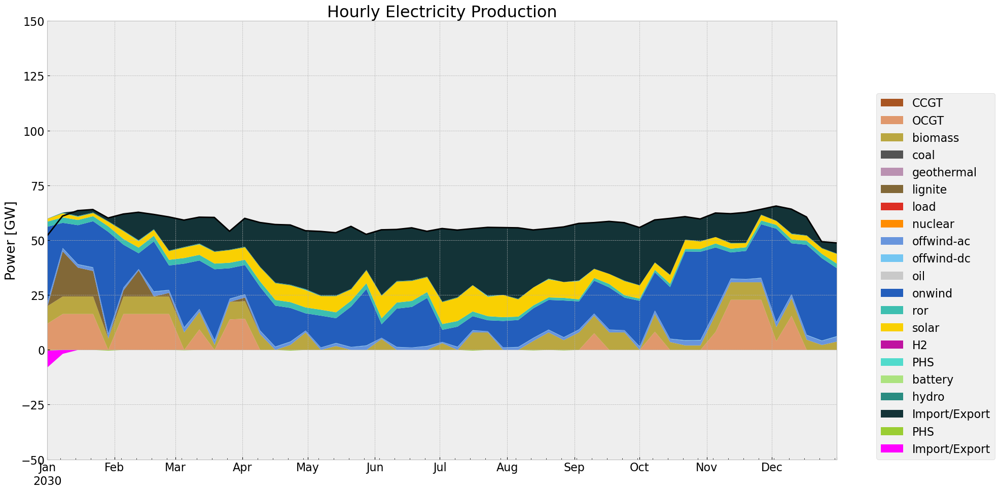

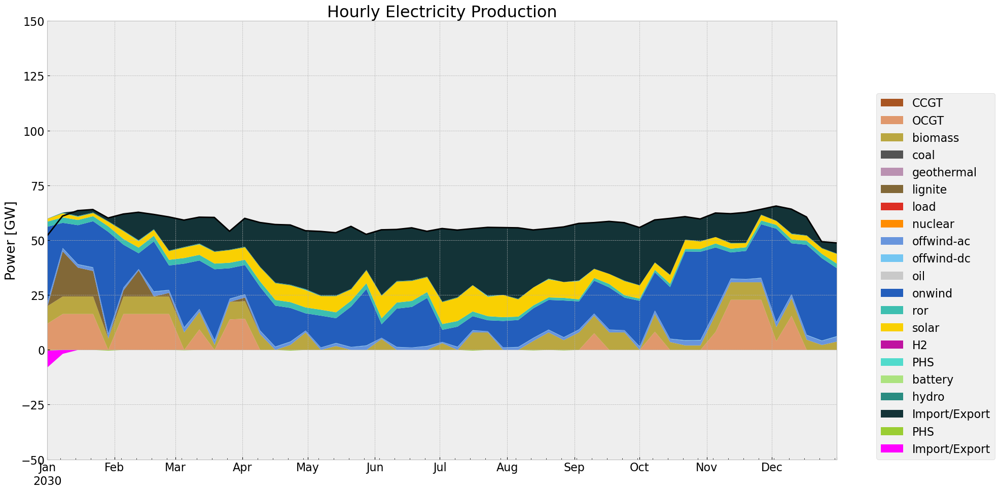

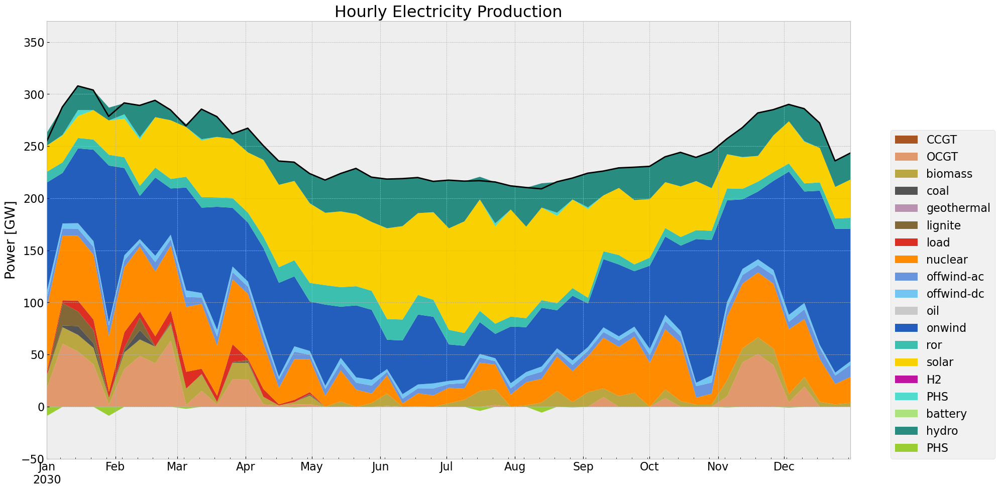

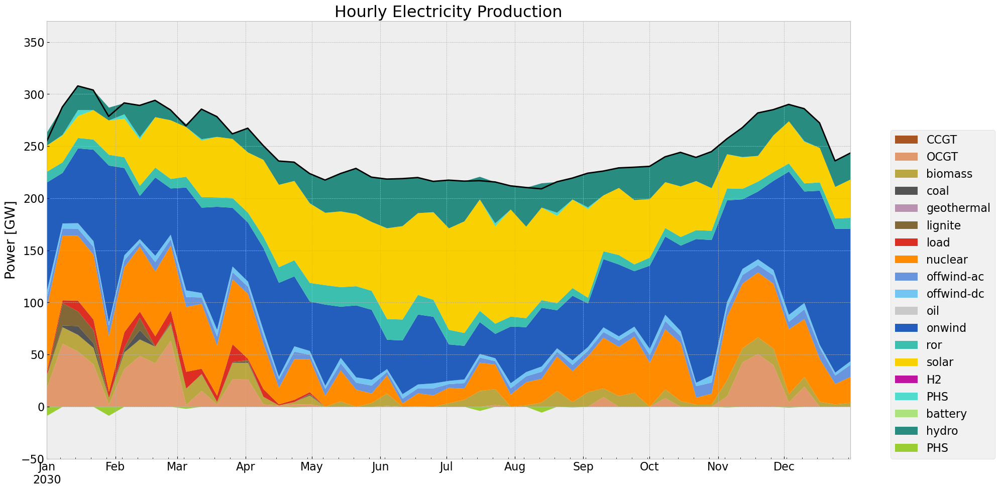

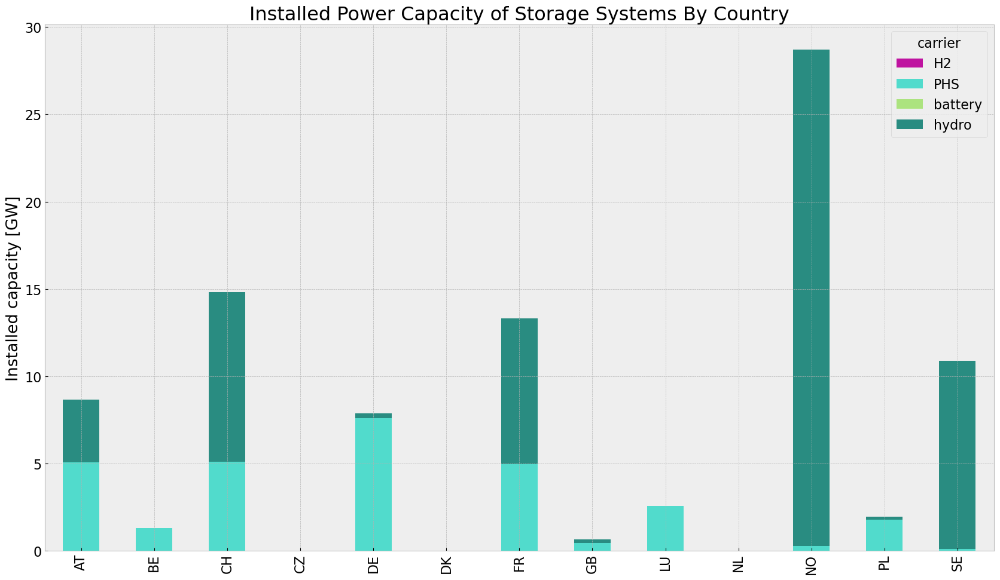

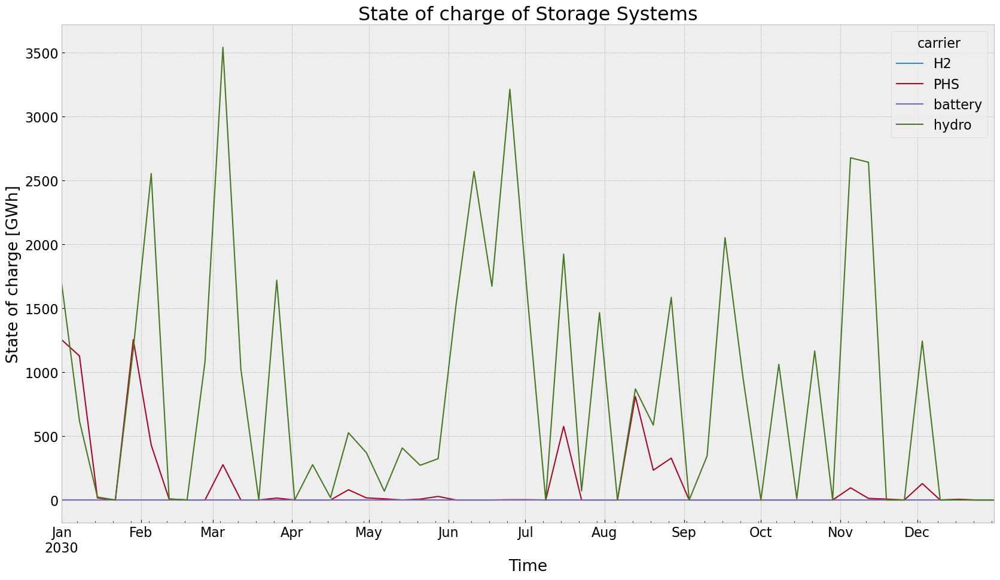

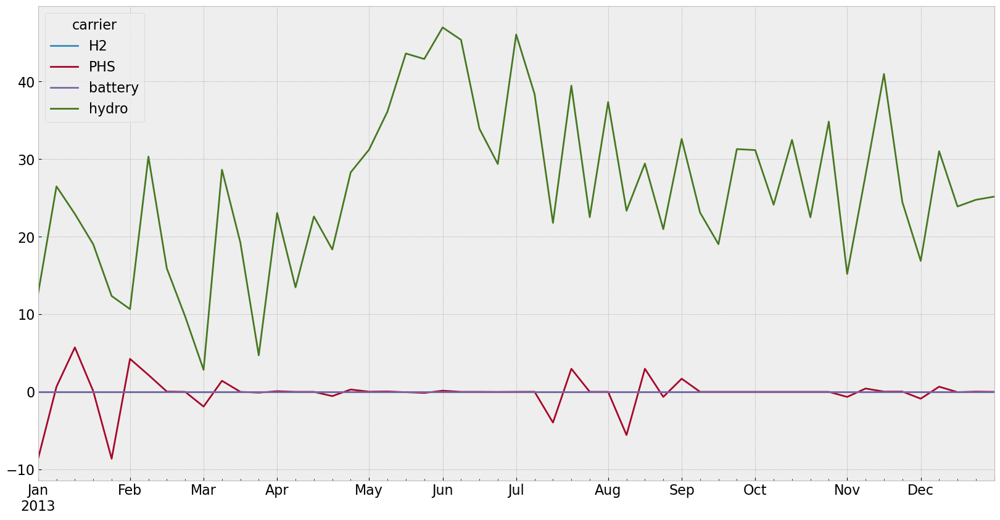

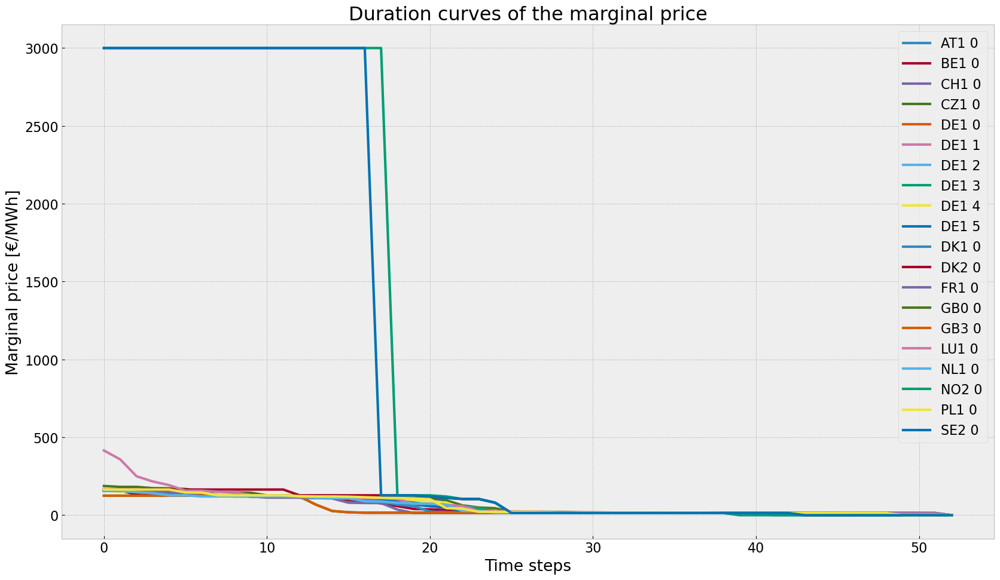

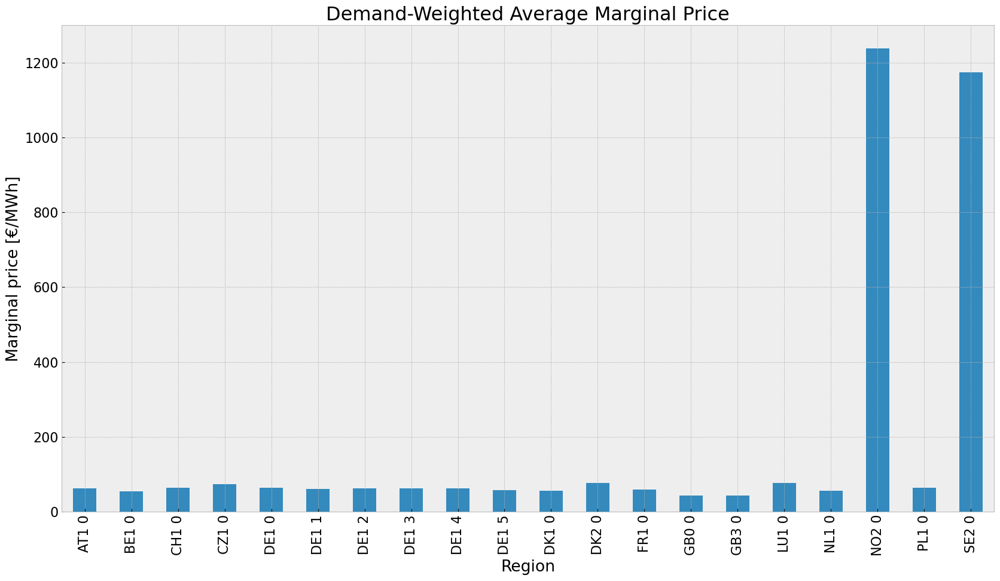

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


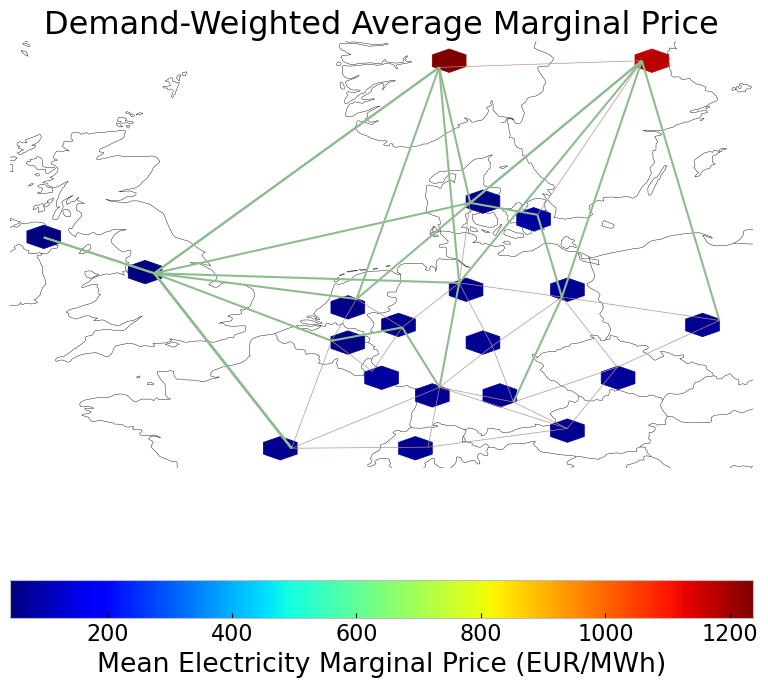

In [79]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv_roll = inst_cap_table(n3, color_cap)
cap_noinv_roll_country = inst_cap_table_country(n3, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_noinv_roll  = gen_power_table(n3)
gen_noinv_roll_country = gen_power_table_country(n3)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n3, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n3, '2030-01-01', '2030-12-31', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n3, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n3, '2030-01-01', '2030-12-31', colors_gen)

#installed storage unit & stores
store_noinv_roll = inst_store_table(n3)

#State of Charge Storage unit
state_of_charge_plot(n3, '2030-01-01 00:00', '2030-12-31 21:00')
n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n3)

#avg electricity price
price_regions_table(n3)
price_regions(n3)

#Emission
em_noinv_roll =em_table(n3)
em_noinv_roll

## 4. Allowed Investment scenario solved with Rolling Horizon

In [80]:
n4 = n1.copy()

no_inv(n4,n1)

n4.storage_units['cyclic_state_of_charge'] = False
n4.storage_units['cyclic_state_of_charge_per_period'] = False


optimize.optimize_with_rolling_horizon(n4, horizon=horizon, overlap=0, solver_name='gurobi')
#filename = f"inv_roll_{contingency}.nc"
#n4 = import_nc_file(directory, filename)
n4.name = f'inv_roll_{contingency}'

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5hmlnj5t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5hmlnj5t.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x8cf05f2a


INFO:gurobipy:Model fingerprint: 0x8cf05f2a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1129 columns


INFO:gurobipy:Presolve removed 4248 rows and 1129 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 955 columns, 1554 nonzeros


INFO:gurobipy:Presolved: 224 rows, 955 columns, 1554 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4868816e+08   9.785941e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4868816e+08   9.785941e+05   0.000000e+00      0s


     307    6.2826217e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     307    6.2826217e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 307 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 307 iterations and 0.04 seconds (0.01 work units)


Optimal objective  6.282621670e+09


INFO:gurobipy:Optimal objective  6.282621670e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 6.28e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hxgsc_7d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hxgsc_7d.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x332ef525


INFO:gurobipy:Model fingerprint: 0x332ef525


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4248 rows and 1133 columns


INFO:gurobipy:Presolve removed 4248 rows and 1133 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 224 rows, 951 columns, 1550 nonzeros


INFO:gurobipy:Presolved: 224 rows, 951 columns, 1550 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9781384e+08   9.613382e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9781384e+08   9.613382e+05   0.000000e+00      0s


     301    6.5875467e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     301    6.5875467e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 301 iterations and 0.09 seconds (0.01 work units)


INFO:gurobipy:Solved in 301 iterations and 0.09 seconds (0.01 work units)


Optimal objective  6.587546739e+09


INFO:gurobipy:Optimal objective  6.587546739e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 6.59e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x6ndf1vr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x6ndf1vr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x8dc218ea


INFO:gurobipy:Model fingerprint: 0x8dc218ea


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1125 columns


INFO:gurobipy:Presolve removed 4248 rows and 1125 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 959 columns, 1558 nonzeros


INFO:gurobipy:Presolved: 224 rows, 959 columns, 1558 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4963045e+08   9.647444e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4963045e+08   9.647444e+05   0.000000e+00      0s


     303    5.9685109e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     303    5.9685109e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 303 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 303 iterations and 0.04 seconds (0.01 work units)


Optimal objective  5.968510916e+09


INFO:gurobipy:Optimal objective  5.968510916e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 5.97e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q2h_xql7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q2h_xql7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x6b033017


INFO:gurobipy:Model fingerprint: 0x6b033017


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4255 rows and 1144 columns


INFO:gurobipy:Presolve removed 4255 rows and 1144 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 217 rows, 940 columns, 1521 nonzeros


INFO:gurobipy:Presolved: 217 rows, 940 columns, 1521 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6157176e+08   9.896786e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6157176e+08   9.896786e+05   0.000000e+00      0s


     348    3.5102184e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     348    3.5102184e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 348 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 348 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.510218439e+09


INFO:gurobipy:Optimal objective  3.510218439e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.51e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h75b98xy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h75b98xy.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x06188c87


INFO:gurobipy:Model fingerprint: 0x06188c87


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4254 rows and 1138 columns


INFO:gurobipy:Presolve removed 4254 rows and 1138 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 218 rows, 946 columns, 1534 nonzeros


INFO:gurobipy:Presolved: 218 rows, 946 columns, 1534 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8814581e+05   9.970523e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8814581e+05   9.970523e+05   0.000000e+00      0s


     308    3.2518025e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     308    3.2518025e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 308 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 308 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.251802546e+08


INFO:gurobipy:Optimal objective  3.251802546e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jupdrgmf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jupdrgmf.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xdf90493e


INFO:gurobipy:Model fingerprint: 0xdf90493e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4265 rows and 1163 columns


INFO:gurobipy:Presolve removed 4265 rows and 1163 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 207 rows, 921 columns, 1489 nonzeros


INFO:gurobipy:Presolved: 207 rows, 921 columns, 1489 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5919427e+07   9.842516e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5919427e+07   9.842516e+05   0.000000e+00      0s


     256    1.0531532e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    1.0531532e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 256 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.053153168e+08


INFO:gurobipy:Optimal objective  1.053153168e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.05e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_4p6yurj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_4p6yurj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xc3650a2f


INFO:gurobipy:Model fingerprint: 0xc3650a2f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4252 rows and 1129 columns


INFO:gurobipy:Presolve removed 4252 rows and 1129 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 220 rows, 955 columns, 1550 nonzeros


INFO:gurobipy:Presolved: 220 rows, 955 columns, 1550 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5930285e+07   1.001318e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5930285e+07   1.001318e+06   0.000000e+00      0s


     332    1.0514577e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     332    1.0514577e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 332 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 332 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.051457727e+08


INFO:gurobipy:Optimal objective  1.051457727e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.05e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x1ouo_ux.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x1ouo_ux.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xaab7c098


INFO:gurobipy:Model fingerprint: 0xaab7c098


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4248 rows and 1127 columns


INFO:gurobipy:Presolve removed 4248 rows and 1127 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 957 columns, 1556 nonzeros


INFO:gurobipy:Presolved: 224 rows, 957 columns, 1556 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1468230e+07   9.786245e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1468230e+07   9.786245e+05   0.000000e+00      0s


     360    2.8091013e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     360    2.8091013e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 360 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 360 iterations and 0.05 seconds (0.01 work units)


Optimal objective  2.809101264e+08


INFO:gurobipy:Optimal objective  2.809101264e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.81e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ob1c_was.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ob1c_was.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x0ca83428


INFO:gurobipy:Model fingerprint: 0x0ca83428


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1126 columns


INFO:gurobipy:Presolve removed 4248 rows and 1126 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 958 columns, 1557 nonzeros


INFO:gurobipy:Presolved: 224 rows, 958 columns, 1557 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5778847e+07   9.801015e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5778847e+07   9.801015e+05   0.000000e+00      0s


     370    3.7508824e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     370    3.7508824e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 370 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 370 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.750882375e+08


INFO:gurobipy:Optimal objective  3.750882375e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_8mht06r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_8mht06r.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x83f2a4b0


INFO:gurobipy:Model fingerprint: 0x83f2a4b0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1129 columns


INFO:gurobipy:Presolve removed 4248 rows and 1129 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 955 columns, 1554 nonzeros


INFO:gurobipy:Presolved: 224 rows, 955 columns, 1554 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5091435e+05   9.781255e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5091435e+05   9.781255e+05   0.000000e+00      0s


     329    6.6455020e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     329    6.6455020e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 329 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 329 iterations and 0.05 seconds (0.01 work units)


Optimal objective  6.645502048e+08


INFO:gurobipy:Optimal objective  6.645502048e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 6.65e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qpz2vduv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qpz2vduv.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xdbfeac7e


INFO:gurobipy:Model fingerprint: 0xdbfeac7e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1125 columns


INFO:gurobipy:Presolve removed 4248 rows and 1125 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 959 columns, 1558 nonzeros


INFO:gurobipy:Presolved: 224 rows, 959 columns, 1558 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7588351e+05   9.740380e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7588351e+05   9.740380e+05   0.000000e+00      0s


     322    3.8274481e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     322    3.8274481e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 322 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 322 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.827448104e+08


INFO:gurobipy:Optimal objective  3.827448104e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.83e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ghdouqk2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ghdouqk2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x7af24b81


INFO:gurobipy:Model fingerprint: 0x7af24b81


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1117 columns


INFO:gurobipy:Presolve removed 4248 rows and 1117 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 967 columns, 1566 nonzeros


INFO:gurobipy:Presolved: 224 rows, 967 columns, 1566 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1936560e+07   9.437162e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1936560e+07   9.437162e+05   0.000000e+00      0s


     396    3.3591434e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     396    3.3591434e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 396 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 396 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.359143376e+09


INFO:gurobipy:Optimal objective  3.359143376e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.36e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mq8ja4_e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mq8ja4_e.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xae37c4c2


INFO:gurobipy:Model fingerprint: 0xae37c4c2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1139 columns


INFO:gurobipy:Presolve removed 4248 rows and 1139 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 945 columns, 1544 nonzeros


INFO:gurobipy:Presolved: 224 rows, 945 columns, 1544 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.4386979e+05   9.662879e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.4386979e+05   9.662879e+05   0.000000e+00      0s


     277    7.6012592e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     277    7.6012592e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 277 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 277 iterations and 0.04 seconds (0.01 work units)


Optimal objective  7.601259190e+08


INFO:gurobipy:Optimal objective  7.601259190e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 7.60e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.11s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7h4a6tqq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7h4a6tqq.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 1118 rows, 521 columns, 1767 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1767 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


Model fingerprint: 0xb9ac8526


INFO:gurobipy:Model fingerprint: 0xb9ac8526


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1072 rows and 308 columns


INFO:gurobipy:Presolve removed 1072 rows and 308 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 46 rows, 213 columns, 334 nonzeros


INFO:gurobipy:Presolved: 46 rows, 213 columns, 334 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7016614e+04   9.325301e+04   0.000000e+00      0s


INFO:gurobipy:       0    2.7016614e+04   9.325301e+04   0.000000e+00      0s


      46    7.6950154e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      46    7.6950154e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 46 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 46 iterations and 0.04 seconds (0.00 work units)


Optimal objective  7.695015415e+06


INFO:gurobipy:Optimal objective  7.695015415e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 7.70e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Export Model for later use

In [81]:
filename = f"{n4.name}.nc"
output_path = os.path.join(os.getcwd(), filename)
n4.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network inv_roll_dispatchcut.nc has lines, links, carriers, loads, storage_units, generators, buses


<xarray.Dataset> Size: 283kB
Dimensions:                                          (snapshots: 53,
                                                      investment_periods: 0,
                                                      lines_i: 27,
                                                      lines_t_p0_i: 27,
                                                      lines_t_p1_i: 27,
                                                      lines_t_loss_i: 27,
                                                      ...
                                                      generators_t_p_max_pu_i: 82,
                                                      generators_t_p_i: 111,
                                                      buses_i: 20,
                                                      buses_t_p_i: 20,
                                                      buses_t_v_ang_i: 18,
                                                      buses_t_marginal_price_i: 20)
Coordinates: (12/27)
  * snapshots                                        (snapshots) int64 424B 0...
  * investment_periods                               (investment_periods) int64 0B ...
  * lines_i                                          (lines_i) object 216B '0...
  * lines_t_p0_i                                     (lines_t_p0_i) object 216B ...
  * lines_t_p1_i                                     (lines_t_p1_i) object 216B ...
  * lines_t_loss_i                                   (lines_t_loss_i) object 216B ...
    ...                                               ...
  * generators_t_p_max_pu_i                          (generators_t_p_max_pu_i) object 656B ...
  * generators_t_p_i                                 (generators_t_p_i) object 888B ...
  * buses_i                                          (buses_i) object 160B 'A...
  * buses_t_p_i                                      (buses_t_p_i) object 160B ...
  * buses_t_v_ang_i                                  (buses_t_v_ang_i) object 144B ...
  * buses_t_marginal_price_i                         (buses_t_marginal_price_i) object 160B ...
Data variables: (12/97)
    snapshots_snapshot                               (snapshots) datetime64[ns] 424B ...
    snapshots_objective                              (snapshots) float64 424B ...
    snapshots_generators                             (snapshots) float64 424B ...
    snapshots_stores                                 (snapshots) float64 424B ...
    investment_periods_objective                     (investment_periods) float64 0B ...
    investment_periods_years                         (investment_periods) float64 0B ...
    ...                                               ...
    buses_country                                    (buses_i) object 160B 'A...
    buses_control                                    (buses_i) object 160B 'S...
    buses_generator                                  (buses_i) object 160B 'A...
    buses_t_p                                        (snapshots, buses_t_p_i) float64 8kB ...
    buses_t_v_ang                                    (snapshots, buses_t_v_ang_i) float64 8kB ...
    buses_t_marginal_price                           (snapshots, buses_t_marginal_price_i) float64 8kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            inv_roll_dispatchcut
    network_objective:       7695015.4151609205
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [82]:
tot_cos_inv_roll= n4.objective/1e9 #billion €
system_cost_inv_roll = system_cost(n4) #million €/a
marg_price_region_inv_roll = n4.buses_t.marginal_price.mean()
stat_inv_roll = n4.statistics()

<Figure size 640x480 with 0 Axes>

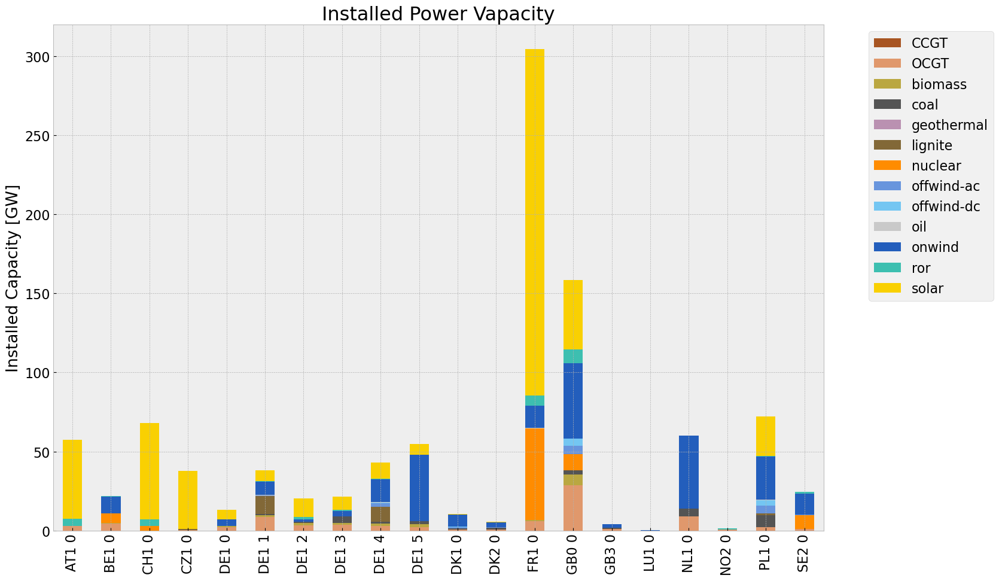

<Figure size 640x480 with 0 Axes>

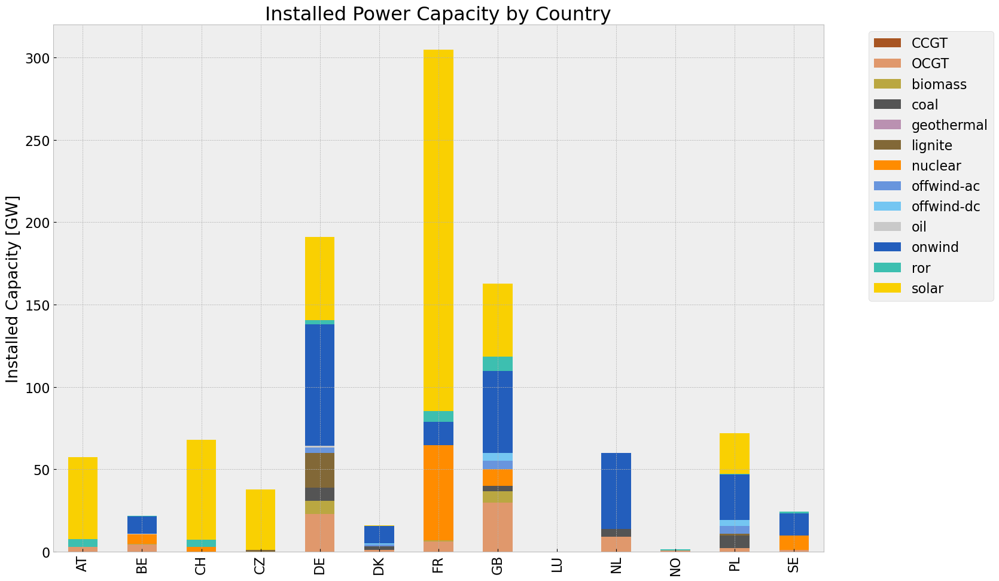

<Figure size 640x480 with 0 Axes>

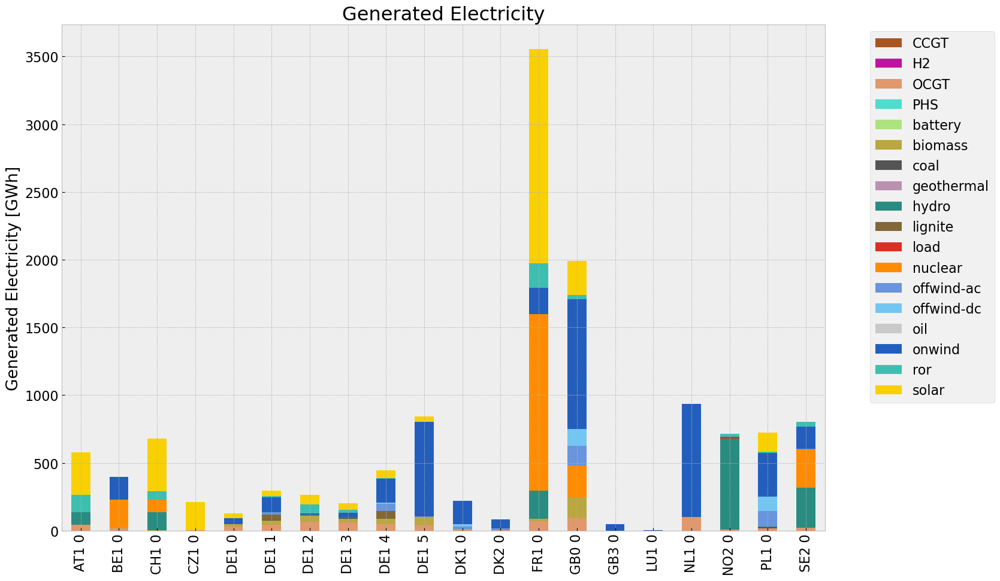

<Figure size 640x480 with 0 Axes>

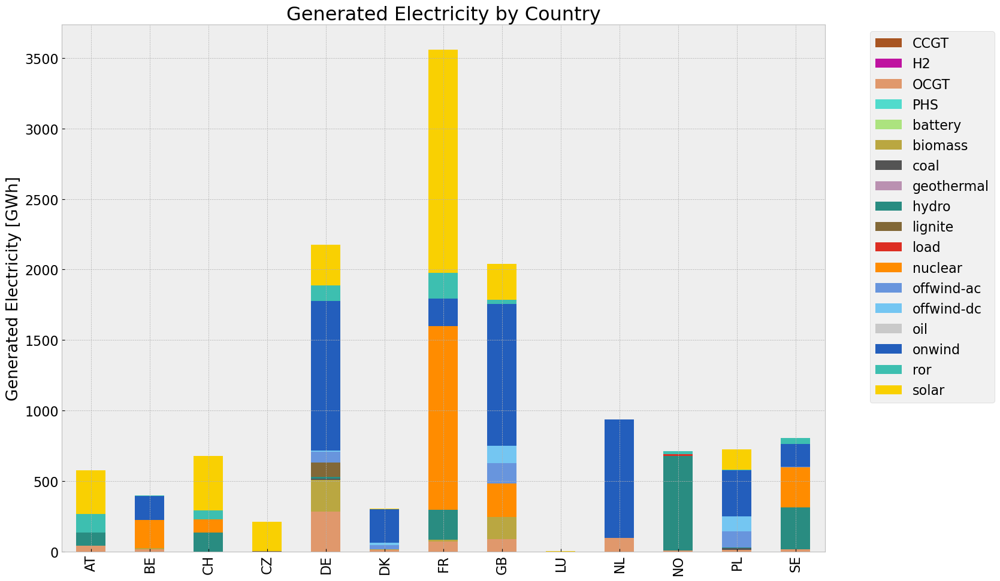

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3768633647.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3768633647.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3768633647.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3768633647.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Users\Jere

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,6.665762e+05,0.451621,0.1980,292240.927897
biomass,4.042349e+05,0.468000,0.0000,0.000000
coal,1.992196e+04,0.329908,0.3361,20295.874296
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,1.032772e+05,0.337285,0.4069,124593.510617
load,1.333537e+04,1.000000,0.0000,0.000000
nuclear,2.117938e+06,0.326600,0.0000,0.000000
offwind-ac,3.716167e+05,1.000000,0.0000,0.000000


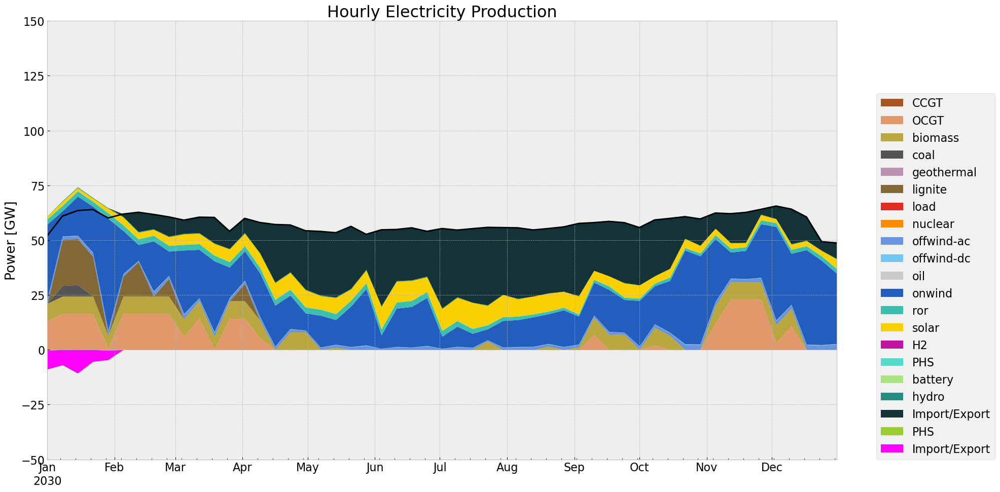

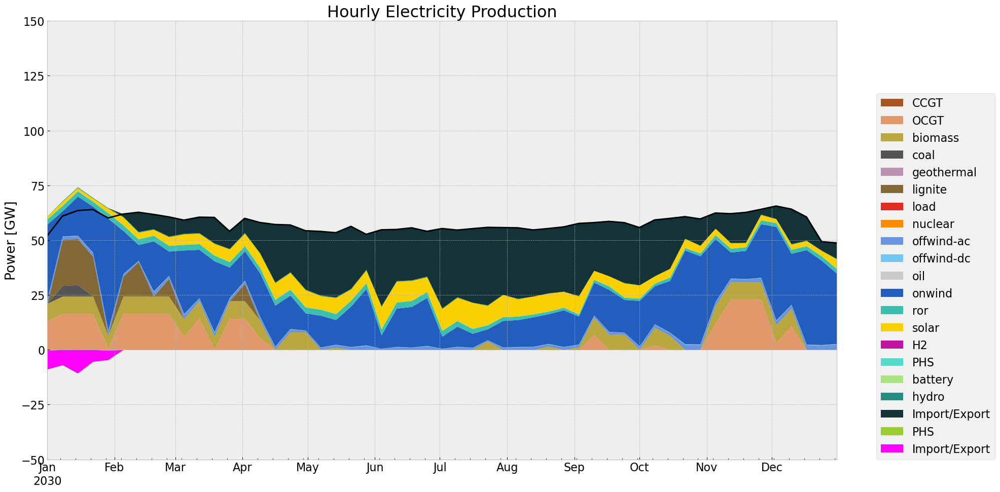

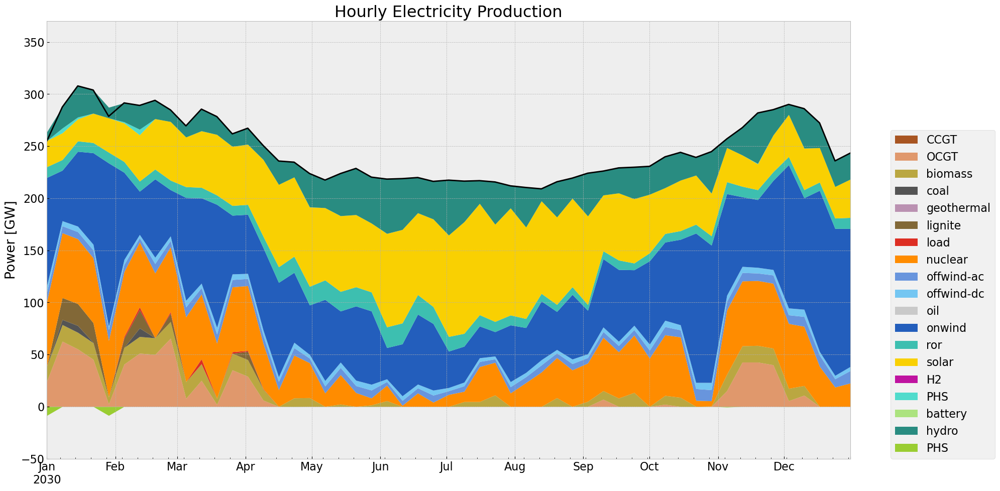

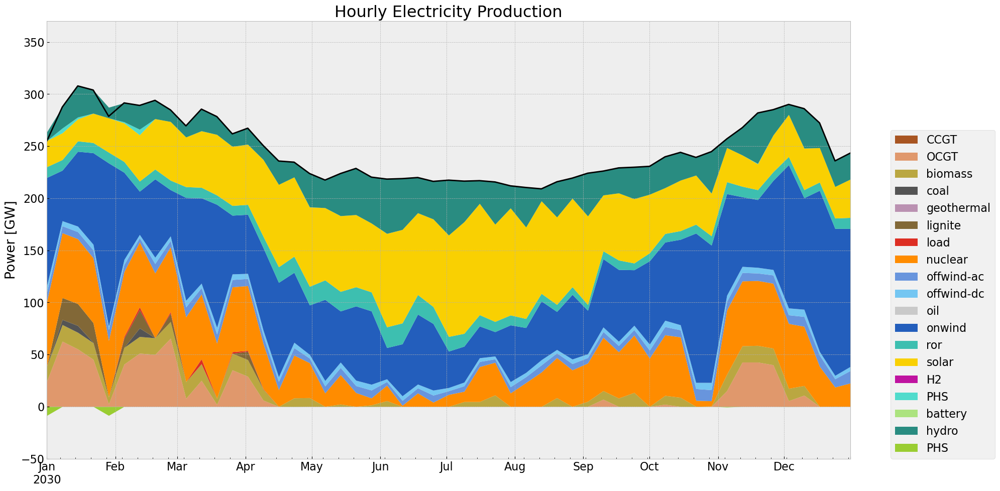

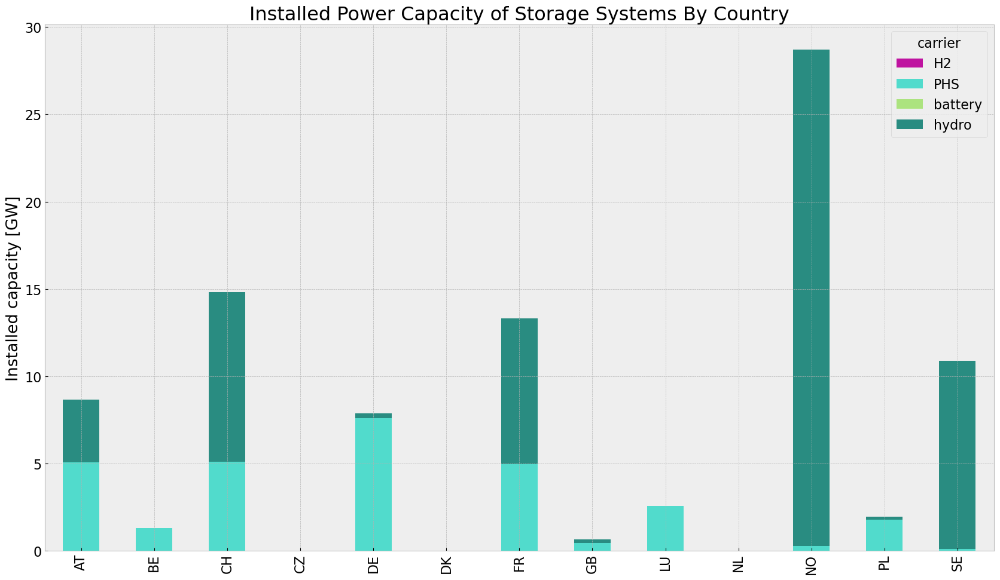

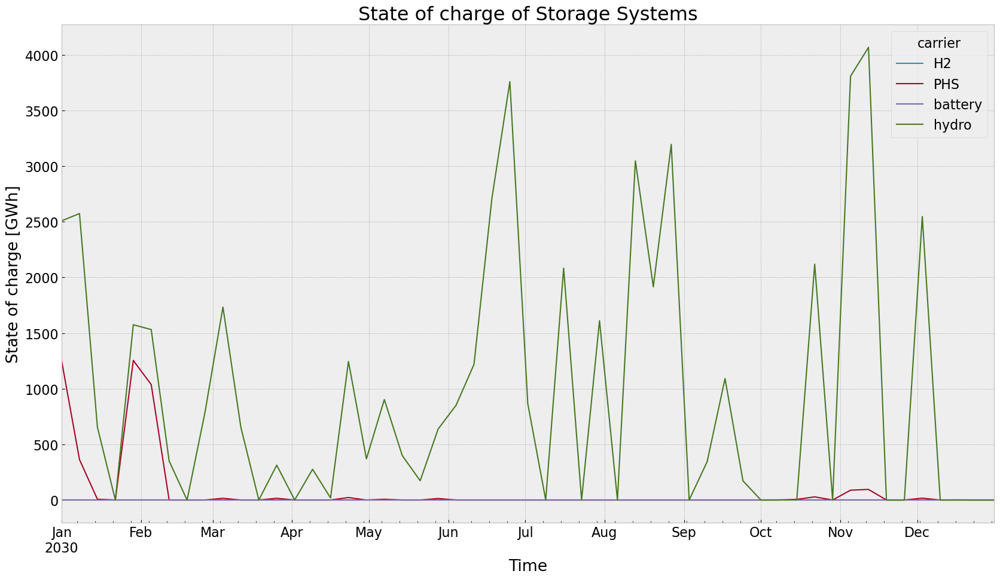

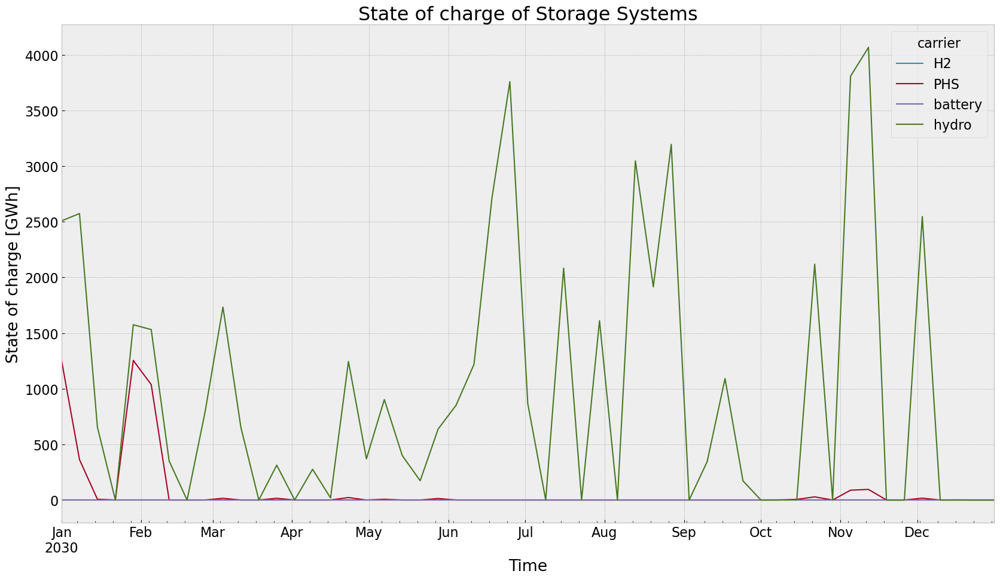

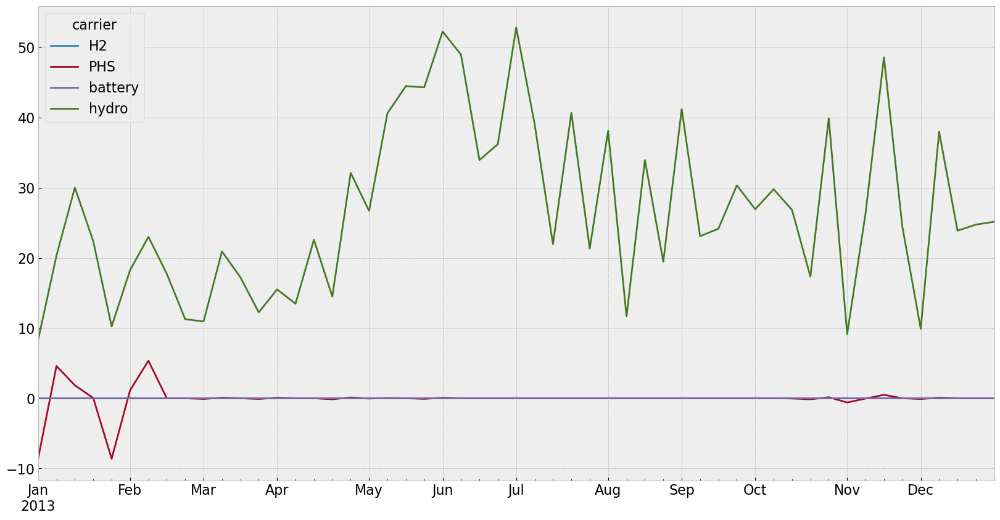

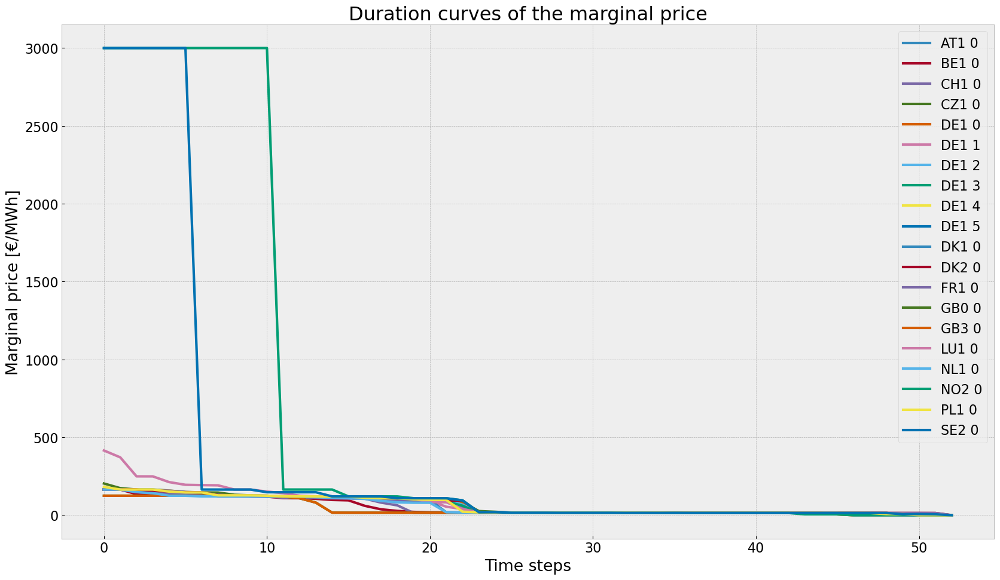

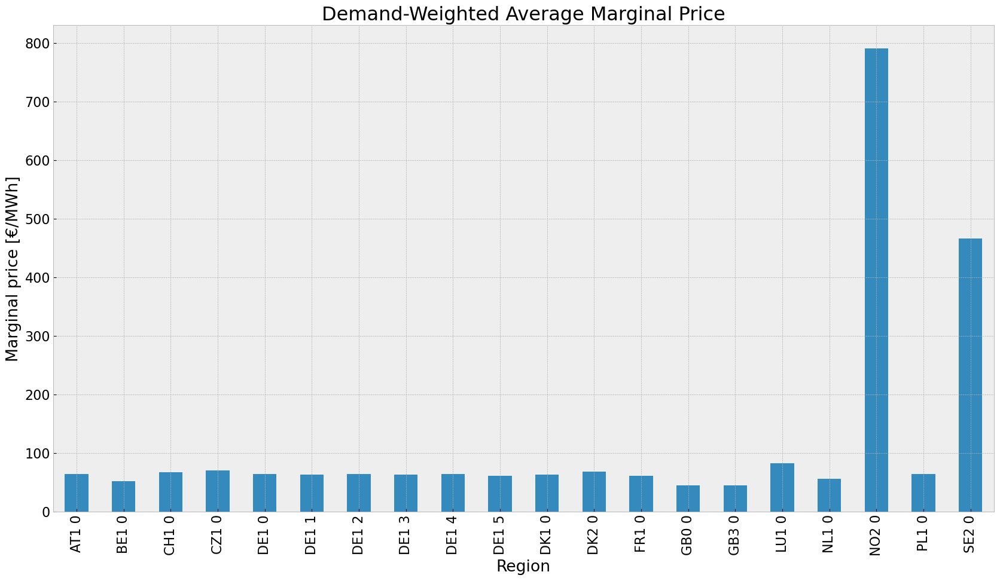

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


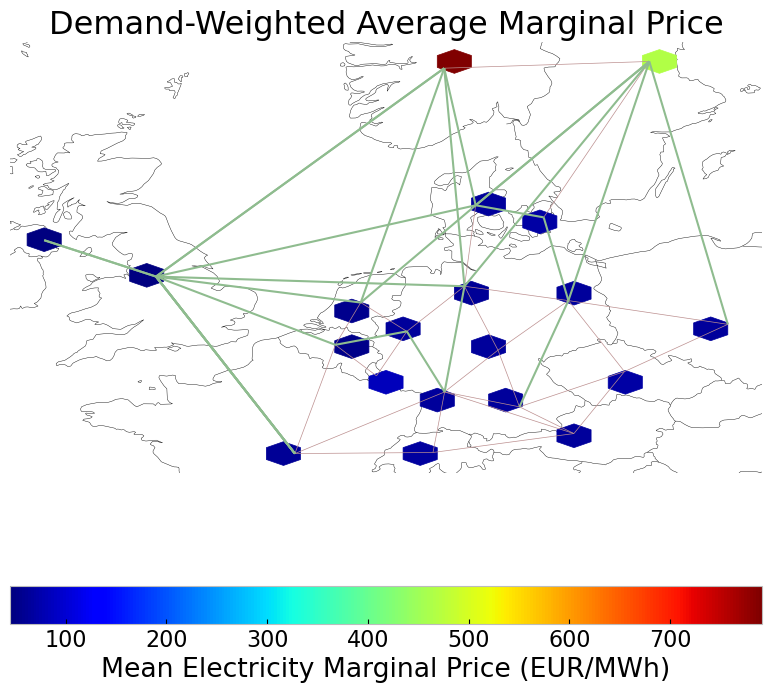

In [83]:

#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv_roll = inst_cap_table(n4, color_cap)
cap_inv_roll_country = inst_cap_table_country(n4, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_inv_roll  = gen_power_table(n4)
gen_inv_roll_country = gen_power_table_country(n4)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n4, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n4, '2030-01-01', '2030-12-31', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n4, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n4, '2030-01-01', '2030-12-31', colors_gen)

#installed storage unit & stores
store_inv_roll = inst_store_table(n4)

#State of Charge Storage unit
state_of_charge_plot(n4, '2030-01-01 00:00', '2030-12-31 21:00')
state_of_charge_plot(n4, '2030-01-01 00:00', '2030-12-31 21:00')
n4.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n4)

#avg electricity price
price_regions_table(n4)
price_regions(n4)

#Emission
em_inv_roll =em_table(n4)
em_inv_roll

In [84]:
#e_balance = n3.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :]
#e_balance.head()
#e_balance.to_csv('energy_balance_DE_offwind.csv', sep=',', index=True, header=True, encoding='utf-8')

# Scenario Analysis

## Installed Capacity

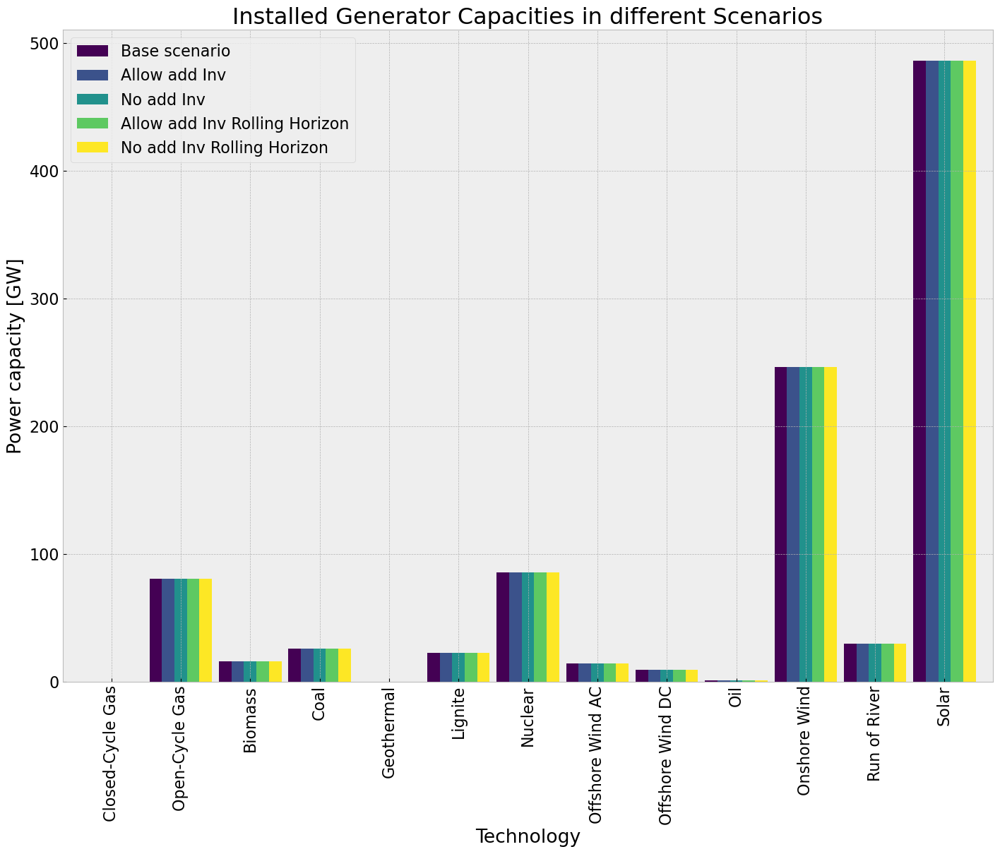

In [85]:
comp_inst_cap = pd.DataFrame(index=capacities_base.unstack().drop(columns=['load'],inplace=False).columns)

comp_inst_cap["Base scenario"] = capacities_base.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv"] = capacities_inv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv"] = capacities_noinv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv Rolling Horizon"] = capacities_inv_roll.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv Rolling Horizon"] = capacities_noinv_roll.groupby("carrier").sum().div(1e3).drop(index="load")

comp_inst_cap.rename(index = {"coal": "Coal"}, inplace=True)
comp_inst_cap.rename(index = {"OCGT": "Open-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"CCGT": "Closed-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"ror": "Run of River"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-ac": "Offshore Wind AC"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-dc": "Offshore Wind DC"}, inplace=True)
comp_inst_cap.rename(index = {"onwind": "Onshore Wind"}, inplace=True)
comp_inst_cap.rename(index = {"solar": "Solar"}, inplace=True)
comp_inst_cap.rename(index = {"oil": "Oil"}, inplace=True)
comp_inst_cap.rename(index = {"geothermal": "Geothermal"}, inplace=True)
comp_inst_cap.rename(index = {"nuclear": "Nuclear"}, inplace=True)
comp_inst_cap.rename(index = {"biomass": "Biomass"}, inplace=True)
comp_inst_cap.rename(index = {"lignite": "Lignite"}, inplace=True)

comp_inst_cap.fillna(0, inplace=True)

comp_inst_cap.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_cap.columns))),
                        grid=True,
                        xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Generator Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.show()

In [103]:
pd.concat([n.generators_t.p[gen_cut]/n.generators.at[gen_cut,'p_nom_opt'],n1.generators_t.p_max_pu[gen_cut]],axis=1)

,DE1 1 OCGT,DE1 1 OCGT
snapshot,,
2013-01-01,0.000000,0.000000
2013-01-08,1.000000,0.250000
2013-01-15,1.000000,0.250000
2013-01-22,1.000000,0.250000
2013-01-29,0.000000,0.000000
2013-02-05,1.000000,0.250000
2013-02-12,1.000000,0.250000
2013-02-19,1.000000,0.250000
2013-02-26,1.000000,0.250000


In [101]:
n1.generators_t.p_max_pu

Generator,AT1 0 onwind,AT1 0 ror,AT1 0 solar,BE1 0 offwind-ac,BE1 0 offwind-dc,BE1 0 onwind,BE1 0 ror,BE1 0 solar,CH1 0 onwind,CH1 0 ror,CH1 0 solar,CZ1 0 onwind,CZ1 0 solar,DE1 0 onwind,DE1 0 ror,DE1 0 solar,DE1 1 offwind-ac,DE1 1 offwind-dc,DE1 1 onwind,DE1 1 ror,DE1 1 solar,DE1 2 onwind,DE1 2 ror,DE1 2 solar,DE1 3 onwind,DE1 3 ror,DE1 3 solar,DE1 4 offwind-ac,DE1 4 offwind-dc,DE1 4 onwind,DE1 4 ror,DE1 4 solar,DE1 5 offwind-ac,DE1 5 offwind-dc,DE1 5 onwind,DE1 5 ror,DE1 5 solar,DK1 0 offwind-ac,DK1 0 offwind-dc,DK1 0 onwind,DK1 0 solar,DK2 0 offwind-ac,DK2 0 offwind-dc,DK2 0 onwind,DK2 0 solar,FR1 0 offwind-ac,FR1 0 offwind-dc,FR1 0 onwind,FR1 0 ror,FR1 0 solar,GB0 0 offwind-ac,GB0 0 offwind-dc,GB0 0 onwind,GB0 0 ror,GB0 0 solar,GB3 0 offwind-ac,GB3 0 offwind-dc,GB3 0 onwind,GB3 0 solar,LU1 0 onwind,LU1 0 ror,LU1 0 solar,NL1 0 offwind-ac,NL1 0 offwind-dc,NL1 0 onwind,NL1 0 solar,NO2 0 offwind-ac,NO2 0 offwind-dc,NO2 0 onwind,NO2 0 ror,NO2 0 solar,PL1 0 offwind-ac,PL1 0 offwind-dc,PL1 0 onwind,PL1 0 ror,PL1 0 solar,SE2 0 offwind-ac,SE2 0 offwind-dc,SE2 0 onwind,SE2 0 ror,SE2 0 solar,DE1 1 OCGT
snapshot,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2013-01-01,0.188845,0.332055,0.047853,0.547496,0.589613,0.251753,0.950524,0.021256,0.028347,0.171825,0.050973,0.415784,0.040487,0.404203,0.907471,0.023324,0.665847,0.721610,0.336688,0.907471,0.015624,0.332230,0.907471,0.034931,0.225771,0.672185,0.030990,0.601077,0.630098,0.468359,0.907471,0.025076,0.677787,0.740133,0.514968,0.907471,0.015761,0.662100,0.685201,0.525079,0.023563,0.599473,0.651463,0.538434,0.024727,0.321891,0.383362,0.157394,0.422131,0.067530,0.655582,0.707672,0.485210,0.168130,0.029711,0.746646,0.786325,0.445263,0.016280,0.183312,0.907471,0.030944,0.607744,0.704078,0.407764,0.023232,0.361138,0.566563,0.176490,0.359247,0.000000,0.611725,0.627353,0.487997,0.521796,0.032047,0.478464,0.623831,0.205710,0.666053,0.011872,0.000000
2013-01-08,0.044414,0.389920,0.046131,0.441070,0.474301,0.154282,0.951596,0.046854,0.000000,0.157803,0.054744,0.139978,0.032418,0.111843,0.954379,0.043547,0.282758,0.399692,0.108970,0.954379,0.043145,0.072737,0.954379,0.034112,0.055294,0.699606,0.041158,0.521534,0.711288,0.190316,0.954379,0.032966,0.330099,0.432946,0.168239,0.954379,0.030136,0.479943,0.497464,0.259405,0.016576,0.517586,0.512165,0.362345,0.019960,0.373702,0.423456,0.142879,0.369535,0.065971,0.361358,0.404029,0.213089,0.160430,0.043943,0.504537,0.587347,0.257326,0.035423,0.057633,0.954379,0.039226,0.365274,0.411283,0.196422,0.046661,0.208645,0.367770,0.065781,0.341479,0.015135,0.575721,0.682246,0.277005,0.560203,0.025508,0.427189,0.645914,0.214264,0.635841,0.010235,0.250000
2013-01-15,0.049447,0.345382,0.037068,0.449952,0.518090,0.225393,0.957924,0.024076,0.029437,0.139789,0.044462,0.102578,0.021046,0.123933,0.915359,0.029568,0.493329,0.546893,0.238953,0.915359,0.019809,0.080530,0.915359,0.028155,0.118391,0.667304,0.032350,0.435783,0.650002,0.141984,0.915359,0.032153,0.490953,0.565713,0.303249,0.915359,0.025330,0.486279,0.538274,0.352125,0.016241,0.526713,0.552407,0.415897,0.034893,0.504641,0.526012,0.239765,0.433454,0.057762,0.528949,0.579165,0.407843,0.140140,0.027725,0.749023,0.795947,0.440490,0.017359,0.191814,0.915359,0.033701,0.511194,0.560786,0.373723,0.025565,0.265959,0.497440,0.099528,0.312192,0.015854,0.422125,0.577540,0.149132,0.547682,0.018070,0.420531,0.582058,0.183550,0.600286,0.011575,0.250000
2013-01-22,0.033074,0.330202,0.047893,0.543154,0.576161,0.343769,0.916455,0.038897,0.035571,0.127331,0.057345,0.073778,0.024738,0.141189,0.886542,0.020182,0.530028,0.646385,0.280749,0.886542,0.020095,0.065225,0.886542,0.027340,0.108557,0.643719,0.036505,0.485238,0.629437,0.165752,0.886542,0.035601,0.584348,0.652144,0.362437,0.886542,0.025171,0.576702,0.600096,0.469477,0.015217,0.618452,0.679587,0.517505,0.027361,0.523296,0.627947,0.296367,0.460839,0.080524,0.614860,0.650452,0.541579,0.122984,0.037811,0.719943,0.796563,0.552659,0.020705,0.14799

### Analysis of extendable Generators

Extendable Generators: OCGT, Offshore Wind AC and DC, Onshore Wind, Solar

{'AC': '#70af1d', 'DC': '#8a1caf', 'oil': '#c9c9c9', 'CCGT': '#a85522', 'solar': '#f9d002', 'geothermal': '#ba91b1', 'coal': '#545454', 'offwind-ac': '#6895dd', 'onwind': '#235ebc', 'OCGT': '#e0986c', 'nuclear': '#ff8c00', 'lignite': '#826837', 'offwind-dc': '#74c6f2', 'biomass': '#baa741', 'hydro': '#298c81', 'PHS': '#51dbcc', 'ror': '#3dbfb0', '': '', 'battery': '#ace37f', 'H2': '#bf13a0', 'load': '#dd2e23'}


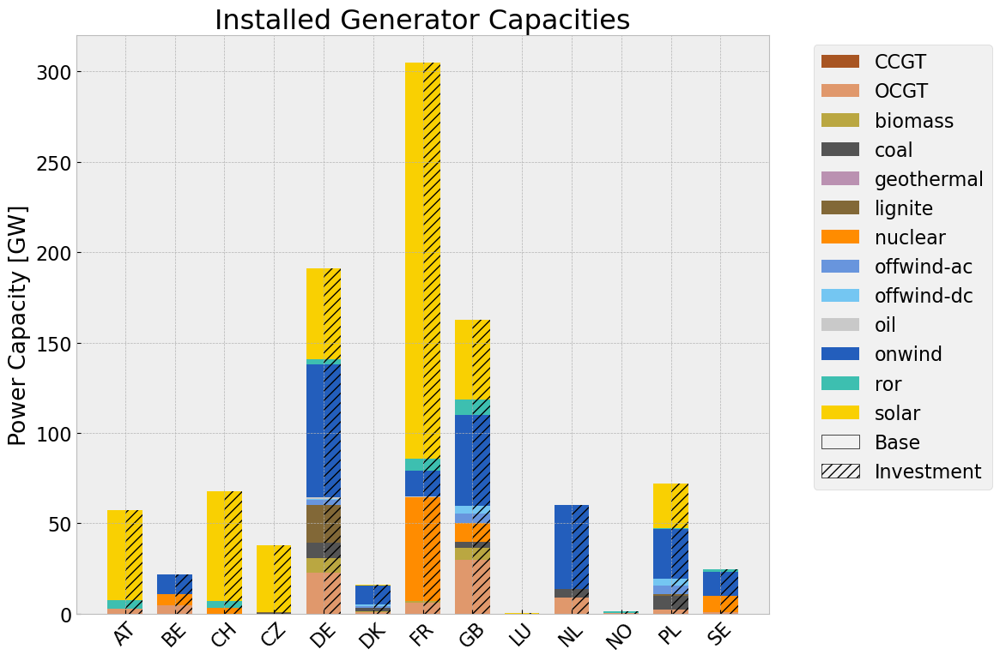

In [86]:
from matplotlib.patches import Patch

color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}
print(color_map)

base = cap_base_country
base.fillna(0, inplace=True)
inv = cap_inv_country
inv.fillna(0, inplace=True)

# Color mapping for generator types
color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(base.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, base, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, inv, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Generator Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_cap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)


plt.show()

## Power Generation

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\2988850123.py:34: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  comp_gen_electr.fillna(0, inplace=True)


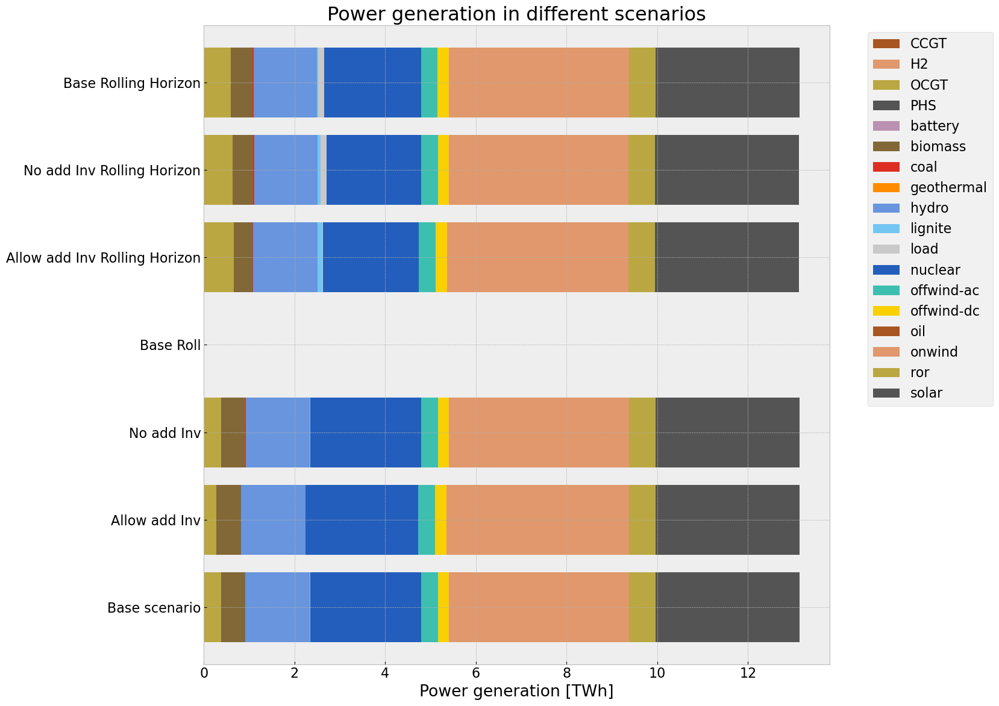

In [87]:
comp_gen_electr = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Roll","Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = gen_base.columns.tolist())

comp_gen_electr.loc["Base scenario"] = gen_base.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv"] = gen_inv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv"] = gen_noinv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Base Rolling Horizon"] = gen_base_roll.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv Rolling Horizon"] = gen_inv_roll.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv Rolling Horizon"] = gen_noinv_roll.sum().div(1e3) # TWh/a



#comp_gen_electr.rename(columns = {"coal": "Coal"}, inplace=True)
#comp_gen_electr.rename(columns = {"gas": "Gas"}, inplace=True)
#comp_gen_electr.rename(columns = {"hydro": "Hydro"}, inplace=True)
#comp_gen_electr.rename(columns = {"offwind": "Offshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"onwind": "Onshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"solar": "Solar"}, inplace=True)
#comp_gen_electr.rename(columns = {"oil": "Oil"}, inplace=True)
#comp_gen_electr.rename(columns = {"geothermal": "Geothermal"}, inplace=True)
#comp_gen_electr.rename(columns = {"nuclear": "Nuclear"}, inplace=True)

#define color dict for tech
color_dict = {}

for index, row in n.carriers.iterrows():
    key = index
    value = row['color']
    color_dict[key] = value

#color list
colors = [color_dict[cat] for cat in gen_base.columns]

comp_gen_electr.fillna(0, inplace=True)
comp_gen_electr.plot.barh(figsize=(17,12),
                        color=colors_gen_table,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Power generation [TWh]",
                        title=f"Power generation in different scenarios",
                        #xlim=[0,200],
                        width=0.8
)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_generation.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Installed Storage Capacities

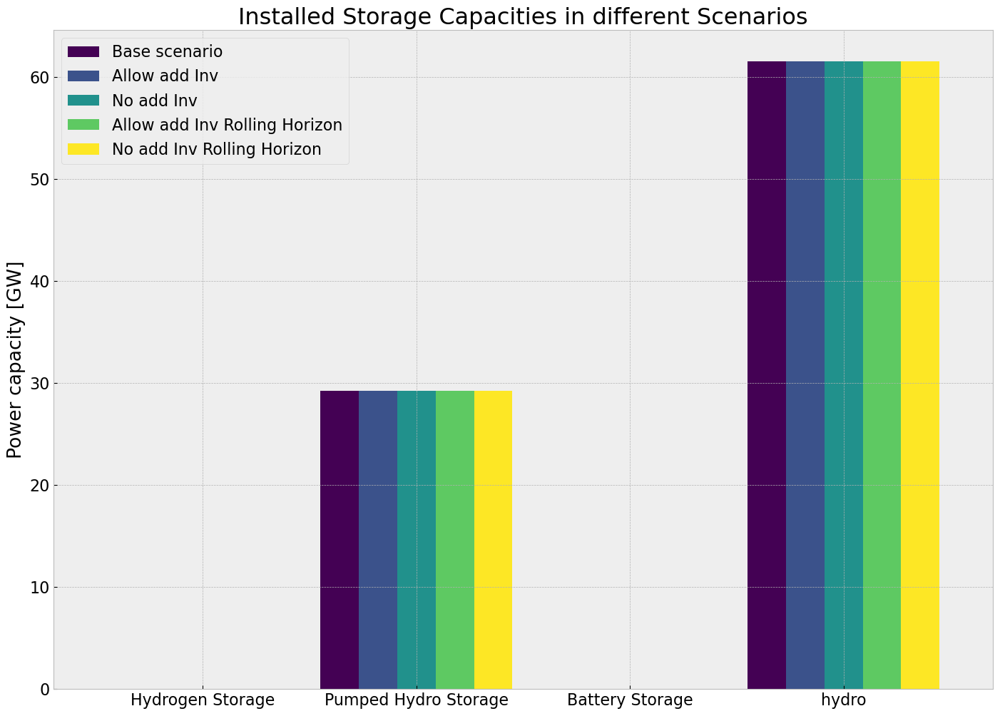

In [88]:
comp_inst_store = pd.DataFrame(index=store_base.unstack().columns)
comp_inst_store.index.name = ''

comp_inst_store["Base scenario"] = store_base.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv.groupby("carrier").sum()
comp_inst_store["No add Inv"] = store_noinv.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["Allow add Inv Rolling Horizon"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["No add Inv Rolling Horizon"] = store_noinv_roll.groupby("carrier").sum()

comp_inst_store.rename(index = {"battery": "Battery Storage"}, inplace=True)
comp_inst_store.rename(index = {"H2": "Hydrogen Storage"}, inplace=True)
comp_inst_store.rename(index = {"Hydro": "Reservoir & Dam"}, inplace=True)
comp_inst_store.rename(index = {"PHS": "Pumped Hydro Storage"}, inplace=True)


comp_inst_store.fillna(0, inplace=True)

comp_inst_store.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_store.columns))),
                        grid=True,
                        #xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Storage Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.xticks(rotation=360, ha='center')
fig.tight_layout()
# Save plot to the current working directory
filename = "analysis_installed_cap.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

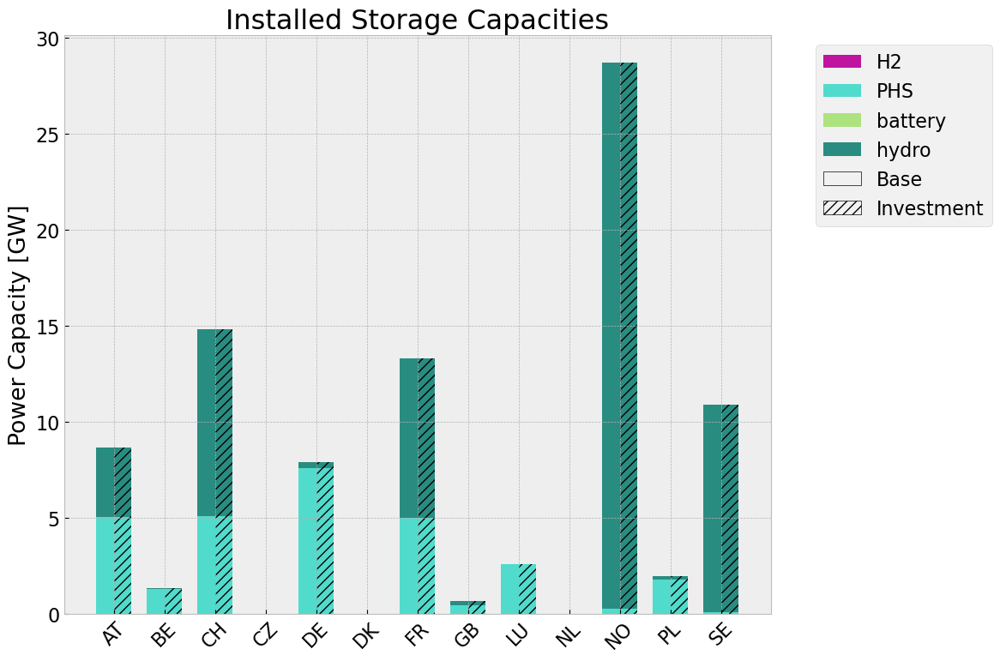

In [89]:
store_base_df = store_base.unstack()
store_inv_df = store_inv.unstack()

store_base_df.fillna(0, inplace=True)
store_inv_df.fillna(0, inplace=True)

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(store_base_df.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, store_base_df, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, store_inv_df, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Storage Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_storagecap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()


## System Cost

In [90]:
tech_comp = system_cost_base.index.tolist()
comp_system_cost = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Rolling Horizon", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_cost.loc["Base scenario"] = system_cost_base # Million €/a
comp_system_cost.loc["Allow add Inv"] = system_cost_inv # Million €/a
#if tot_cost_0_PV > 0: 
#    comp_system_cost.loc["0% PV potential"] = system_cost_0_PV # Million €/a
#else: comp_system_cost.loc["0% PV potential"] = 0.0
#if tot_cost_20_PV > 0: 
#    comp_system_cost.loc["20% PV potential"] = system_cost_20_PV # Million €/a
#else: comp_system_cost.loc["20% PV potential"] = 0.0
comp_system_cost.loc["No add Inv"] = system_cost_noinv # Million €/a
comp_system_cost.loc["Base Rolling Horizon"] = system_cost_base_roll # Million €/a
comp_system_cost.loc["Allow add Inv Rolling Horizon"] = system_cost_inv_roll
comp_system_cost.loc["No add Inv Rolling Horizon"] = system_cost_noinv_roll # Million €/a

#if 'AC' in system_cost_base:
#   comp_system_cost.AC = comp_system_cost.AC-system_cost_base.AC # expenditure for already existing transmission lines

#comp_system_cost[comp_system_cost<0] = 0 # since we subtact the AC cost (for the 0% or 20%) 
comp_system_cost.drop('-', axis=1, inplace=True)
#comp_system_cost.iloc[0,0] = system_cost_base.AC


#comp_system_cost = comp_system_cost   #Million eur0/

#comp_system_cost.rename(columns = {"battery storage": "Battery storage"}, inplace=True)
#comp_system_cost.rename(columns = {"hydrogen storage underground": "Hydrogen storage underground"}, inplace=True)

comp_system_cost.fillna(0, inplace=True)
comp_system_cost = comp_system_cost.div(1e3) # Billion €

#move load shedding to the last col
# Specify the column name to move
column_to_move = 'Load shedding'

# Create a new list of column names without the column to move
new_columns = [col for col in comp_system_cost.columns if col != column_to_move]

# Append the column to move to the end
new_columns.append(column_to_move)

# Reorder the columns
comp_system_cost = comp_system_cost[new_columns]


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3411115089.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3411115089.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


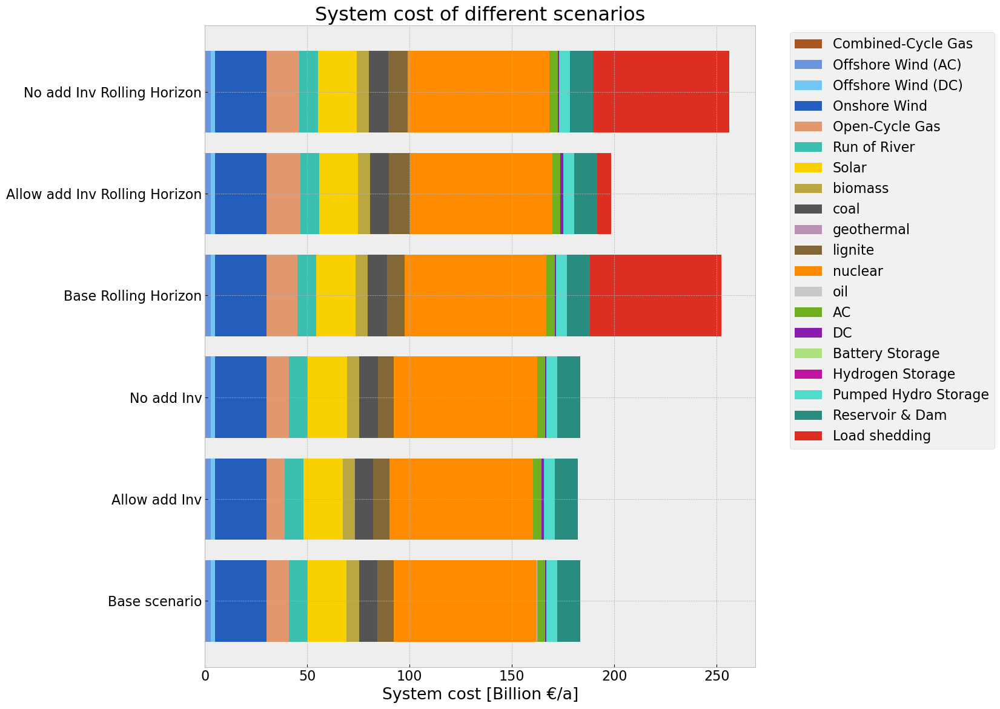

In [91]:
colors_comp = []

for i in range(len(comp_system_cost.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_cost.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="System cost [Billion €/a]",
                        title=f"System cost of different scenarios",
                        #xlim=[0,100],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_system_cost.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Curtailment

In [92]:
comp_curtailment = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Rolling Horizon","Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = stat_base.loc["Generator"].index)

comp_curtailment.loc["Base scenario"] = stat_base.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv"] = stat_inv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv"] = stat_noinv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Base Rolling Horizon"] = stat_base_roll.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv Rolling Horizon"] = stat_inv_roll.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv Rolling Horizon"] = stat_noinv_roll.loc["Generator"].Curtailment.div(1e6) # TWh

comp_curtailment.fillna(0, inplace=True)

In [93]:
color_curtailment=[]

for i in range(len(comp_curtailment.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
            color_curtailment.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found 

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3109801822.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3109801822.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_curtailment.append(n.carriers.color[j])


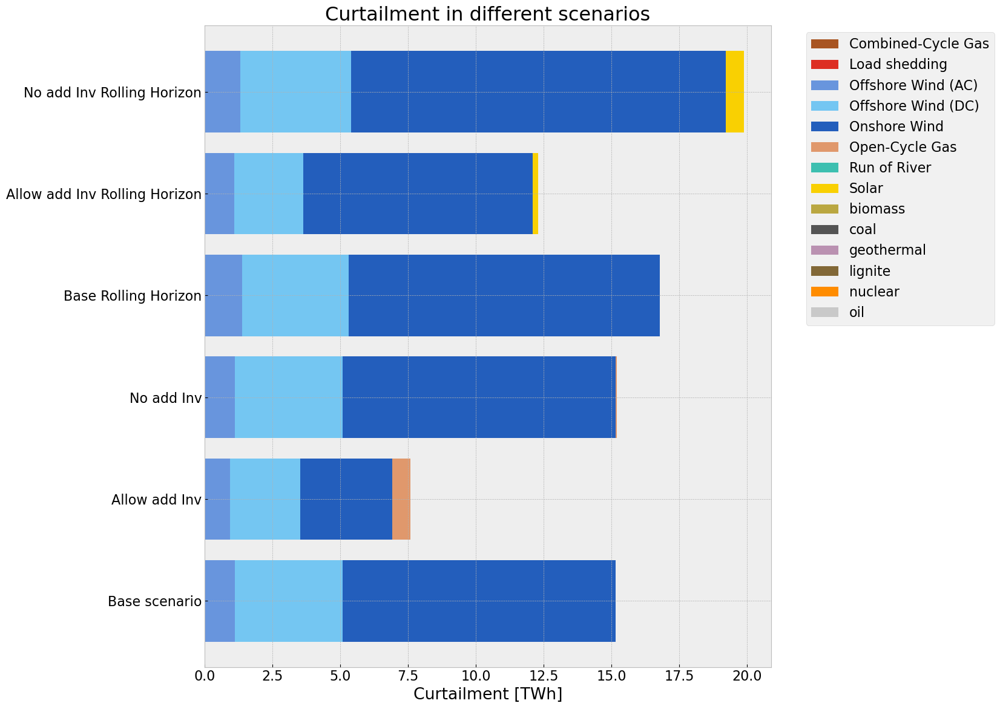

In [94]:
comp_curtailment.plot.barh(figsize=(17,12),
                        color=color_curtailment,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Curtailment [TWh]",
                        title=f"Curtailment in different scenarios",
                        #xlim=[0,120],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_curtailment.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

## Emission

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_940\3480178836.py:21: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


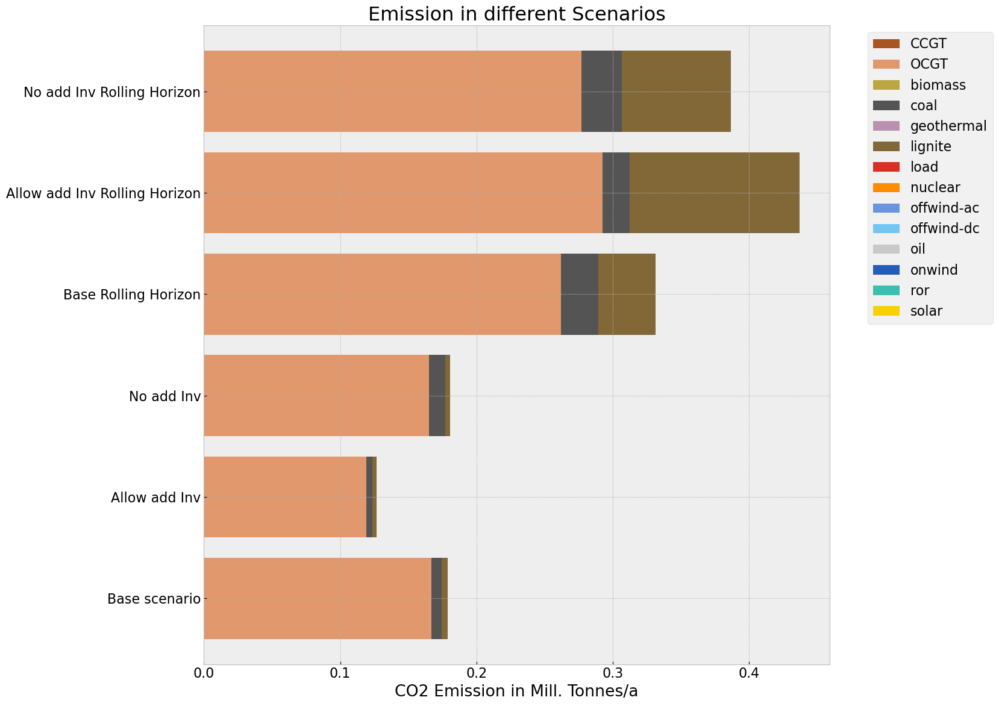

In [95]:
tech_comp = em_base.index.tolist()
comp_system_em = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Rolling Horizon","Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_em.loc["Base scenario"] = em_base['emissions in Tonnes CO2']/1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv"] = em_inv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Base Rolling Horizon"] = em_base_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv"] = em_noinv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv Rolling Horizon"] = em_inv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv Rolling Horizon"] = em_noinv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a

comp_system_em.fillna(0, inplace=True)

colors_comp = []

for i in range(len(comp_system_em.columns)):
    for j in range(len(n.carriers.index)):
        if comp_system_em.columns[i] == n.carriers.index[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_em.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="CO2 Emission in Mill. Tonnes/a",
                        title=f"Emission in different Scenarios",
                        #xlim=[0,100],
                        width=0.8
)
#global_constraint
#plt.axvline(x=n.global_constraints.loc['CO2Limit','constant']/1e6, color='r', linestyle='-', linewidth=2, label='CO2 cap')
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_emission.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

## Transmission Lines

In [96]:
models = [n, n1, n2, n4]

In [97]:
model_trans = [n,n1]
for m in model_trans:
    #create empty df
    trans_df = {
        'Country' : cap_base_country.index,
        'AC': np.zeros(len(cap_base_country.index)),
        'DC': np.zeros(len(cap_base_country.index))
    }

    trans_df = pd.DataFrame(trans_df)
    trans_df.set_index('Country', inplace=True)
    
    #AC
    ac_df = m.lines
    ac_df['country'] = ac_df['bus0'].str[:2]
    ac_df = ac_df.groupby(['country', 'carrier']).s_nom_opt.sum()
    ac_df.fillna(0, inplace=True)
    ac_df = ac_df.unstack().div(1e3) #GVA
            
    #DC
    dc_df = m.links
    dc_df['country'] = dc_df['bus0'].str[:2]
    dc_df = dc_df.groupby(['country', 'carrier']).p_nom_opt.sum()
    dc_df.fillna(0, inplace=True)
    dc_df = dc_df.unstack().div(1e3) #GW

    #fill empty df with AC Cap
    for index, row in trans_df.iterrows():
        if index in ac_df.index:
            try:
                trans_df.loc[index, 'AC'] = ac_df.loc[index, 'AC']
            except KeyError: 
                trans_df.loc[index, 'AC'] = 0

    #fill empty df with DC Cap
    for index, row in trans_df.iterrows():
        if index in dc_df.index:
            try:
                trans_df.loc[index, 'DC'] = dc_df.loc[index, 'DC']
            except KeyError: 
                trans_df.loc[index, 'DC'] = 0


    #trans_df = pd.concat([ac_df, dc_df], axis=1)
    #trans_df.fillna(0, inplace=True)
    globals()[f'trans_{m.name}'] = trans_df

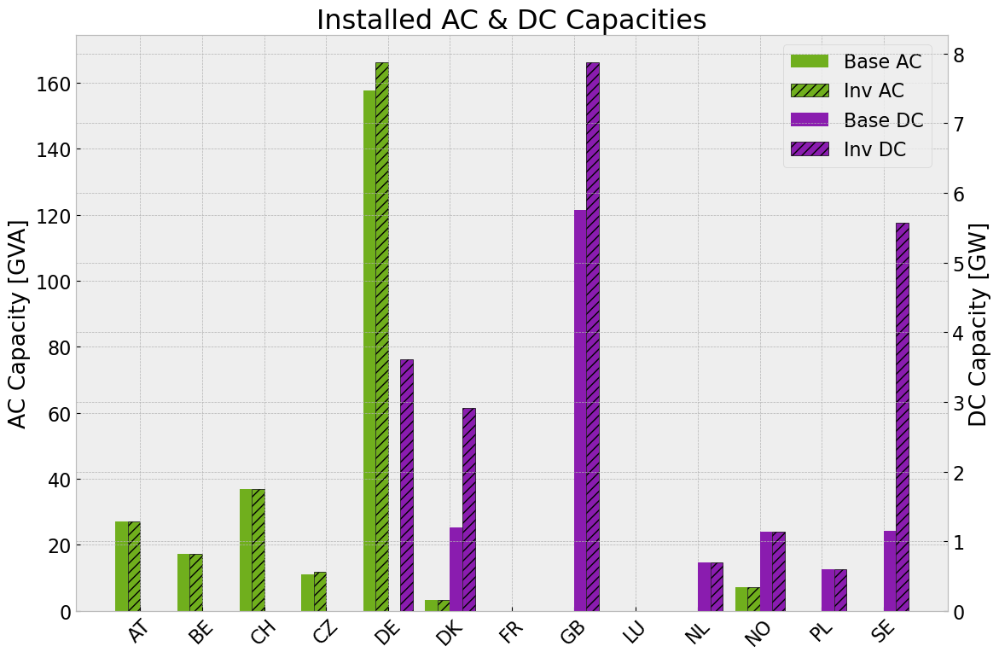

In [98]:
# Setting up bar plot parameters
bar_width = 0.2
indices = np.arange(len(trans_base_dispatchcut.index))
base_ac_indices = indices - bar_width * 1.5  # Shift slightly to the left
inv_ac_indices = indices - bar_width * 0.5  # Shift slightly to the right
base_dc_indices = indices + bar_width * 0.5
inv_dc_indices = indices + bar_width * 1.5

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Create secondary axis
ax2 = ax.twinx()

# Plot the base DataFrame (no hatching)
ax.bar(base_ac_indices, trans_base_dispatchcut.AC, bar_width, color = n.carriers.loc['AC','color'], label='Base AC')
ax2.bar(base_dc_indices, trans_base_dispatchcut.DC, bar_width, color = n.carriers.loc['DC','color'], label='Base DC')

# Plot the inv DataFrame (with hatching)
ax.bar(inv_ac_indices, trans_inv_dispatchcut.AC, bar_width, label='Inv AC', edgecolor = 'black', color = n.carriers.loc['AC','color'], hatch='///')
ax2.bar(inv_dc_indices, trans_inv_dispatchcut.DC, bar_width, label='Inv DC', edgecolor = 'black', color = n.carriers.loc['DC','color'], hatch='///')


# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + ax2.get_legend_handles_labels()[0]

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(0.8, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed AC & DC Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(trans_base_dispatchcut.index, rotation=45)
ax.set_ylabel('AC Capacity [GVA]')
ax2.set_ylabel('DC Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_trans_cap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

In [99]:
for index, row in n.links.iterrows():
    pnomoptn = n.links.at[index,'p_nom_opt']
    pnomoptn1 = n1.links.at[index,'p_nom_opt']
    bus0 = row['bus0']
    bus1 = row['bus1']
    if 'DE' in bus0 or 'DE' in bus1:
        print(f'{bus0},{bus1}: {index}, p_nom_opt: {pnomoptn}, {pnomoptn1}')

DE1 1,BE1 0: 14801, p_nom_opt: 0.0, 0.0
DK2 0,DE1 4: 14824, p_nom_opt: 600.0, 2315.82579023228
SE2 0,DE1 5: 5601, p_nom_opt: 600.0, 600.0
DE1 5,NO2 0: 14848, p_nom_opt: 0.0, 3610.659073364
DE1 4,DE1 2: T10, p_nom_opt: 0.0, 0.0
SE2 0,DE1 4: T16, p_nom_opt: 0.0, 4422.853625286545
DE1 5,DE1 3: T18, p_nom_opt: 0.0, 0.0
DE1 1,DE1 3: T20, p_nom_opt: 0.0, 0.0
GB0 0,DE1 5: T22, p_nom_opt: 0.0, 2118.1555064842023


# Sensitivity Analysis

In [381]:
sens_reductionto = [0.5, reductionto,0]

sens_duration = [
    int(duration-(0.5*duration)),
    duration,
    int(duration+(0.5*duration)) 
]

#### Create and Solve Models

In [382]:
def sanitize_variable_name(name):
    """
    Sanitize a string to be used as a valid Python variable name.

    Args:
    name (str): The name to sanitize.

    Returns:
    str: A sanitized name.
    """
    # Replace periods and hyphens with underscores
    return name.replace('.', '_').replace('-', '_')

In [383]:
# Assuming sens_reductionto and sens_duration are defined and iterable

for red in sens_reductionto:
    for dur in sens_duration:
        name = f'n_{red}_{dur}'

        # Skip iteration if both conditions are met
        if red == reductionto and dur == duration:
            continue

        # Sanitize the names to be valid Python variable names
        red_sanitized = sanitize_variable_name(str(red))
        dur_sanitized = sanitize_variable_name(str(dur))

        # Variable names for models
        inv_model_name = f'n_{red_sanitized}_{dur_sanitized}_inv'
        inv_roll_model_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll'
        noinv_model_name = f'n_{red_sanitized}_{dur_sanitized}_noinv'
        noinv_roll_model_name = f'n_{red_sanitized}_{dur_sanitized}_noinv_roll'

        # Create inv model with perfect foresight
        globals()[inv_model_name] = dispatchscenario(n, cut_start, dur, red)
        allow_inv(globals()[inv_model_name], n, country)
        globals()[inv_model_name].name = inv_model_name
        print(globals()[inv_model_name].name)

        # Solve and export
        filename = f'{globals()[inv_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[inv_model_name] = import_nc_file(directory, filename)
        else:
            globals()[inv_model_name].optimize(solver_name="gurobi")
            print(f'{globals()[inv_model_name].name}.nc does not exist in current wd')
            globals()[inv_model_name].export_to_netcdf(output_path)
        

        # Create inv model rolling horizon
        globals()[inv_roll_model_name] = globals()[inv_model_name].copy()
        no_inv(globals()[inv_roll_model_name], globals()[inv_model_name])
        globals()[inv_roll_model_name].storage_units['cyclic_state_of_charge'] = False
        globals()[inv_roll_model_name].storage_units['cyclic_state_of_charge_per_period'] = False
        globals()[inv_roll_model_name].name = inv_roll_model_name
        print(globals()[inv_roll_model_name].name)

        # Solve with rolling horizon and export model
        filename = f'{globals()[inv_roll_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[inv_roll_model_name] = import_nc_file(directory, filename)
        else:
            optimize.optimize_with_rolling_horizon(globals()[inv_roll_model_name], horizon=horizon, overlap=0, solver_name='gurobi')
            print(f'{globals()[inv_roll_model_name].name}.nc does not exist in current wd')
            globals()[inv_roll_model_name].export_to_netcdf(output_path)

        # Create noinv model perfect foresight
        globals()[noinv_model_name] = dispatchscenario(n, cut_start, dur, red)
        no_inv(globals()[noinv_model_name], n)
        globals()[noinv_model_name].name = noinv_model_name
        print(globals()[noinv_model_name].name)

        # Solve and export
        filename = f'{globals()[noinv_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[noinv_model_name] = import_nc_file(directory, filename)
        else:
            globals()[noinv_model_name].optimize(solver_name="gurobi")
            print(f'{globals()[noinv_model_name].name}.nc does not exist in current wd')
            globals()[noinv_model_name].export_to_netcdf(output_path)

        # Create noinv model rolling horizon
        globals()[noinv_roll_model_name] = globals()[noinv_model_name].copy()
        globals()[noinv_roll_model_name].storage_units['cyclic_state_of_charge'] = False
        globals()[noinv_roll_model_name].storage_units['cyclic_state_of_charge_per_period'] = False
        globals()[noinv_roll_model_name].name = noinv_roll_model_name
        print(globals()[noinv_roll_model_name].name)

        # Solve with rolling horizon and export model
        filename = f'{globals()[noinv_roll_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[noinv_roll_model_name] = import_nc_file(directory, filename)
        else:
            optimize.optimize_with_rolling_horizon(globals()[noinv_roll_model_name], horizon=horizon, overlap=0, solver_name='gurobi')
            print(f'{globals()[noinv_roll_model_name].name}.nc does not exist in current wd')
            globals()[noinv_roll_model_name].export_to_netcdf(output_path)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14540\1143308934.py:33: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.5' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  n_new.generators_t.p_max_pu.at[index, gen_cut] = reductionto
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


n_0_5_90_inv


Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 95.23it/s]
INFO:linopy.io: Writing time: 0.92s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lhujw7b6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lhujw7b6.lp


Reading time = 0.20 seconds


INFO:gurobipy:Reading time = 0.20 seconds


obj: 59556 rows, 27795 columns, 114131 nonzeros


INFO:gurobipy:obj: 59556 rows, 27795 columns, 114131 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59556 rows, 27795 columns and 114131 nonzeros


INFO:gurobipy:Optimize a model with 59556 rows, 27795 columns and 114131 nonzeros


Model fingerprint: 0xca3d40be


INFO:gurobipy:Model fingerprint: 0xca3d40be


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 3e+02]


INFO:gurobipy:  Matrix range     [1e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 38424 rows and 7176 columns


INFO:gurobipy:Presolve removed 38424 rows and 7176 columns


Presolve time: 0.09s


INFO:gurobipy:Presolve time: 0.09s


Presolved: 21132 rows, 20619 columns, 69226 nonzeros


INFO:gurobipy:Presolved: 21132 rows, 20619 columns, 69226 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.09s


INFO:gurobipy:Ordering time: 0.09s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 95


INFO:gurobipy: Dense cols : 95


 AA' NZ     : 1.806e+05


INFO:gurobipy: AA' NZ     : 1.806e+05


 Factor NZ  : 8.833e+05 (roughly 24 MB of memory)


INFO:gurobipy: Factor NZ  : 8.833e+05 (roughly 24 MB of memory)


 Factor Ops : 1.602e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.602e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.62974581e+12 -1.32749837e+14  6.76e+05 2.46e+05  3.63e+10     0s


INFO:gurobipy:   0   5.62974581e+12 -1.32749837e+14  6.76e+05 2.46e+05  3.63e+10     0s


   1   5.14528644e+12 -6.05268449e+13  4.34e+05 6.79e+04  1.60e+10     0s


INFO:gurobipy:   1   5.14528644e+12 -6.05268449e+13  4.34e+05 6.79e+04  1.60e+10     0s


   2   3.15287320e+12 -3.85340015e+13  1.06e+05 1.85e+04  4.58e+09     0s


INFO:gurobipy:   2   3.15287320e+12 -3.85340015e+13  1.06e+05 1.85e+04  4.58e+09     0s


   3   2.42365303e+12 -1.38977559e+13  1.31e+04 1.40e+03  6.81e+08     0s


INFO:gurobipy:   3   2.42365303e+12 -1.38977559e+13  1.31e+04 1.40e+03  6.81e+08     0s


   4   1.25361565e+12 -3.72546156e+12  9.08e+02 2.56e+02  1.31e+08     1s


INFO:gurobipy:   4   1.25361565e+12 -3.72546156e+12  9.08e+02 2.56e+02  1.31e+08     1s


   5   7.03722220e+11 -1.68313101e+12  3.30e+02 1.19e+02  5.81e+07     1s


INFO:gurobipy:   5   7.03722220e+11 -1.68313101e+12  3.30e+02 1.19e+02  5.81e+07     1s


   6   3.94247687e+11 -7.88228281e+11  1.14e+02 5.28e+01  2.75e+07     1s


INFO:gurobipy:   6   3.94247687e+11 -7.88228281e+11  1.14e+02 5.28e+01  2.75e+07     1s


   7   2.53426941e+11 -2.51433251e+11  5.54e+01 1.76e+01  1.15e+07     1s


INFO:gurobipy:   7   2.53426941e+11 -2.51433251e+11  5.54e+01 1.76e+01  1.15e+07     1s


   8   1.57613642e+11 -1.11138100e+11  2.57e+01 8.88e+00  6.03e+06     1s


INFO:gurobipy:   8   1.57613642e+11 -1.11138100e+11  2.57e+01 8.88e+00  6.03e+06     1s


   9   1.30016027e+11 -4.35588958e+10  1.84e+01 5.11e+00  3.88e+06     1s


INFO:gurobipy:   9   1.30016027e+11 -4.35588958e+10  1.84e+01 5.11e+00  3.88e+06     1s


  10   1.09828379e+11 -1.43610623e+10  1.36e+01 3.44e+00  2.77e+06     1s


INFO:gurobipy:  10   1.09828379e+11 -1.43610623e+10  1.36e+01 3.44e+00  2.77e+06     1s


  11   8.21911588e+10  7.90325801e+09  7.27e+00 2.16e+00  1.65e+06     1s


INFO:gurobipy:  11   8.21911588e+10  7.90325801e+09  7.27e+00 2.16e+00  1.65e+06     1s


  12   6.55159151e+10  2.81449235e+10  3.64e+00 1.03e+00  8.29e+05     1s


INFO:gurobipy:  12   6.55159151e+10  2.81449235e+10  3.64e+00 1.03e+00  8.29e+05     1s


  13   5.98963366e+10  3.70761468e+10  2.43e+00 5.61e-01  5.06e+05     1s


INFO:gurobipy:  13   5.98963366e+10  3.70761468e+10  2.43e+00 5.61e-01  5.06e+05     1s


  14   5.89650055e+10  3.73634892e+10  2.24e+00 5.46e-01  4.79e+05     1s


INFO:gurobipy:  14   5.89650055e+10  3.73634892e+10  2.24e+00 5.46e-01  4.79e+05     1s


  15   5.78193277e+10  4.04263348e+10  2.00e+00 3.81e-01  3.86e+05     1s


INFO:gurobipy:  15   5.78193277e+10  4.04263348e+10  2.00e+00 3.81e-01  3.86e+05     1s


  16   5.43499554e+10  4.21943976e+10  1.30e+00 2.85e-01  2.69e+05     1s


INFO:gurobipy:  16   5.43499554e+10  4.21943976e+10  1.30e+00 2.85e-01  2.69e+05     1s


  17   5.18317502e+10  4.46382053e+10  7.74e-01 1.55e-01  1.59e+05     1s


INFO:gurobipy:  17   5.18317502e+10  4.46382053e+10  7.74e-01 1.55e-01  1.59e+05     1s


  18   5.04449181e+10  4.56403364e+10  5.06e-01 1.05e-01  1.06e+05     1s


INFO:gurobipy:  18   5.04449181e+10  4.56403364e+10  5.06e-01 1.05e-01  1.06e+05     1s


  19   4.97230971e+10  4.62685785e+10  3.61e-01 7.38e-02  7.65e+04     1s


INFO:gurobipy:  19   4.97230971e+10  4.62685785e+10  3.61e-01 7.38e-02  7.65e+04     1s


  20   4.94669999e+10  4.64787777e+10  3.09e-01 6.40e-02  6.62e+04     1s


INFO:gurobipy:  20   4.94669999e+10  4.64787777e+10  3.09e-01 6.40e-02  6.62e+04     1s


  21   4.88430188e+10  4.69435436e+10  1.84e-01 4.20e-02  4.21e+04     1s


INFO:gurobipy:  21   4.88430188e+10  4.69435436e+10  1.84e-01 4.20e-02  4.21e+04     1s


  22   4.85718106e+10  4.74543366e+10  1.32e-01 1.77e-02  2.47e+04     1s


INFO:gurobipy:  22   4.85718106e+10  4.74543366e+10  1.32e-01 1.77e-02  2.47e+04     1s


  23   4.81666246e+10  4.77300276e+10  5.49e-02 4.68e-03  9.66e+03     1s


INFO:gurobipy:  23   4.81666246e+10  4.77300276e+10  5.49e-02 4.68e-03  9.66e+03     1s


  24   4.79946035e+10  4.77863283e+10  2.40e-02 2.41e-03  4.61e+03     1s


INFO:gurobipy:  24   4.79946035e+10  4.77863283e+10  2.40e-02 2.41e-03  4.61e+03     1s


  25   4.79269535e+10  4.78143490e+10  1.23e-02 1.27e-03  2.49e+03     1s


INFO:gurobipy:  25   4.79269535e+10  4.78143490e+10  1.23e-02 1.27e-03  2.49e+03     1s


  26   4.78951891e+10  4.78331747e+10  6.93e-03 5.93e-04  1.37e+03     1s


INFO:gurobipy:  26   4.78951891e+10  4.78331747e+10  6.93e-03 5.93e-04  1.37e+03     1s


  27   4.78763791e+10  4.78412663e+10  3.85e-03 3.23e-04  7.77e+02     1s


INFO:gurobipy:  27   4.78763791e+10  4.78412663e+10  3.85e-03 3.23e-04  7.77e+02     1s


  28   4.78649149e+10  4.78468965e+10  1.98e-03 1.39e-04  3.99e+02     1s


INFO:gurobipy:  28   4.78649149e+10  4.78468965e+10  1.98e-03 1.39e-04  3.99e+02     1s


  29   4.78539453e+10  4.78498430e+10  3.20e-04 4.84e-05  9.08e+01     1s


INFO:gurobipy:  29   4.78539453e+10  4.78498430e+10  3.20e-04 4.84e-05  9.08e+01     1s


  30   4.78525136e+10  4.78509828e+10  1.23e-04 1.56e-05  3.39e+01     1s


INFO:gurobipy:  30   4.78525136e+10  4.78509828e+10  1.23e-04 1.56e-05  3.39e+01     1s


  31   4.78519508e+10  4.78513330e+10  4.55e-05 6.25e-06  1.37e+01     1s


INFO:gurobipy:  31   4.78519508e+10  4.78513330e+10  4.55e-05 6.25e-06  1.37e+01     1s


  32   4.78516863e+10  4.78514785e+10  1.09e-05 2.58e-06  4.60e+00     1s


INFO:gurobipy:  32   4.78516863e+10  4.78514785e+10  1.09e-05 2.58e-06  4.60e+00     1s


  33   4.78516212e+10  4.78515746e+10  3.84e-06 3.27e-07  1.03e+00     1s


INFO:gurobipy:  33   4.78516212e+10  4.78515746e+10  3.84e-06 3.27e-07  1.03e+00     1s


  34   4.78516026e+10  4.78515848e+10  3.15e-06 1.21e-07  3.94e-01     1s


INFO:gurobipy:  34   4.78516026e+10  4.78515848e+10  3.15e-06 1.21e-07  3.94e-01     1s


  35   4.78515940e+10  4.78515864e+10  6.46e-07 9.06e-08  1.70e-01     2s


INFO:gurobipy:  35   4.78515940e+10  4.78515864e+10  6.46e-07 9.06e-08  1.70e-01     2s


  36   4.78515938e+10  4.78515905e+10  5.76e-07 1.51e-08  7.13e-02     2s


INFO:gurobipy:  36   4.78515938e+10  4.78515905e+10  5.76e-07 1.51e-08  7.13e-02     2s


  37   4.78515915e+10  4.78515914e+10  4.29e-06 6.23e-10  2.92e-03     2s


INFO:gurobipy:  37   4.78515915e+10  4.78515914e+10  4.29e-06 6.23e-10  2.92e-03     2s


  38   4.78515914e+10  4.78515914e+10  1.25e-06 1.15e-10  6.30e-05     2s


INFO:gurobipy:  38   4.78515914e+10  4.78515914e+10  1.25e-06 1.15e-10  6.30e-05     2s


  39   4.78515914e+10  4.78515914e+10  2.20e-08 2.20e-10  6.30e-08     2s


INFO:gurobipy:  39   4.78515914e+10  4.78515914e+10  2.20e-08 2.20e-10  6.30e-08     2s


  40   4.78515914e+10  4.78515914e+10  2.22e-10 8.28e-11  6.45e-11     2s


INFO:gurobipy:  40   4.78515914e+10  4.78515914e+10  2.22e-10 8.28e-11  6.45e-11     2s


INFO:gurobipy:


Barrier solved model in 40 iterations and 1.86 seconds (0.74 work units)


INFO:gurobipy:Barrier solved model in 40 iterations and 1.86 seconds (0.74 work units)


Optimal objective 4.78515914e+10


INFO:gurobipy:Optimal objective 4.78515914e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


   10881 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:   10881 DPushes remaining with DInf 0.0000000e+00                 2s


       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:


     151 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:     151 PPushes remaining with PInf 0.0000000e+00                 2s


       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 7.7884962e-10      2s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 7.7884962e-10      2s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    6149    4.7851591e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:    6149    4.7851591e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:


Solved in 6149 iterations and 2.06 seconds (0.83 work units)


INFO:gurobipy:Solved in 6149 iterations and 2.06 seconds (0.83 work units)


Optimal objective  4.785159144e+10


INFO:gurobipy:Optimal objective  4.785159144e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27795 primals, 59556 duals
Objective: 4.79e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_5_90_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_90_inv.nc has links, buses, storage_units, carriers, lines, loads, generators
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


n_0_5_90_inv_roll


Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4a8syyb_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4a8syyb_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xde11b268


INFO:gurobipy:Model fingerprint: 0xde11b268


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 168 rows, 708 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1600698e+08   6.593258e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1600698e+08   6.593258e+05   0.000000e+00      0s


     253    4.1913620e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     253    4.1913620e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 253 iterations and 0.09 seconds (0.00 work units)


INFO:gurobipy:Solved in 253 iterations and 0.09 seconds (0.00 work units)


Optimal objective  4.191362046e+09


INFO:gurobipy:Optimal objective  4.191362046e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.19e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b7e_h72e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b7e_h72e.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7c72aa75


INFO:gurobipy:Model fingerprint: 0x7c72aa75


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 872 columns


INFO:gurobipy:Presolve removed 3187 rows and 872 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 691 columns, 1124 nonzeros


INFO:gurobipy:Presolved: 167 rows, 691 columns, 1124 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7517864e+08   6.284836e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7517864e+08   6.284836e+05   0.000000e+00      0s


     236    4.5179229e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    4.5179229e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.517922890e+09


INFO:gurobipy:Optimal objective  4.517922890e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.52e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g4ydi15j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g4ydi15j.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe9fd6246


INFO:gurobipy:Model fingerprint: 0xe9fd6246


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 874 columns


INFO:gurobipy:Presolve removed 3187 rows and 874 columns


Presolve time: 0.12s


INFO:gurobipy:Presolve time: 0.12s


Presolved: 167 rows, 689 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 167 rows, 689 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0162701e+09   6.404422e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0162701e+09   6.404422e+05   0.000000e+00      0s


     228    7.3920979e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    7.3920979e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.14 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.14 seconds (0.00 work units)


Optimal objective  7.392097941e+09


INFO:gurobipy:Optimal objective  7.392097941e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_ya0dq65.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_ya0dq65.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc6da53f0


INFO:gurobipy:Model fingerprint: 0xc6da53f0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 863 columns


INFO:gurobipy:Presolve removed 3187 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 700 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 167 rows, 700 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.2533082e+08   6.385484e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.2533082e+08   6.385484e+05   0.000000e+00      0s


     231    6.0380731e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    6.0380731e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.04 seconds (0.00 work units)


Optimal objective  6.038073127e+09


INFO:gurobipy:Optimal objective  6.038073127e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nzdlmff_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nzdlmff_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd19263ec


INFO:gurobipy:Model fingerprint: 0xd19263ec


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3190 rows and 869 columns


INFO:gurobipy:Presolve removed 3190 rows and 869 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 164 rows, 694 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 164 rows, 694 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9471352e+08   6.680138e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9471352e+08   6.680138e+05   0.000000e+00      0s


     216    3.6018387e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    3.6018387e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.07 seconds (0.00 work units)


Optimal objective  3.601838721e+09


INFO:gurobipy:Optimal objective  3.601838721e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.60e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_ex6quab.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_ex6quab.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb17bd04d


INFO:gurobipy:Model fingerprint: 0xb17bd04d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3196 rows and 865 columns


INFO:gurobipy:Presolve removed 3196 rows and 865 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 158 rows, 698 columns, 1121 nonzeros


INFO:gurobipy:Presolved: 158 rows, 698 columns, 1121 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.5711095e+04   6.585963e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.5711095e+04   6.585963e+05   0.000000e+00      0s


     258    2.2932351e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    2.2932351e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.293235114e+08


INFO:gurobipy:Optimal objective  2.293235114e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fb3mi92w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fb3mi92w.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x89a1bd20


INFO:gurobipy:Model fingerprint: 0x89a1bd20


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 866 columns


INFO:gurobipy:Presolve removed 3192 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 697 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 162 rows, 697 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6100181e+05   6.670160e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6100181e+05   6.670160e+05   0.000000e+00      0s


     242    1.1462394e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     242    1.1462394e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 242 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 242 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.146239353e+08


INFO:gurobipy:Optimal objective  1.146239353e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wecazk8f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wecazk8f.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x59c464ea


INFO:gurobipy:Model fingerprint: 0x59c464ea


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3203 rows and 881 columns


INFO:gurobipy:Presolve removed 3203 rows and 881 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 151 rows, 682 columns, 1094 nonzeros


INFO:gurobipy:Presolved: 151 rows, 682 columns, 1094 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5815964e+07   8.250800e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5815964e+07   8.250800e+05   0.000000e+00      0s


     185    5.9031785e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     185    5.9031785e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 185 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 185 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.903178490e+07


INFO:gurobipy:Optimal objective  5.903178490e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.90e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s1vkhcef.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s1vkhcef.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x98c3a1bf


INFO:gurobipy:Model fingerprint: 0x98c3a1bf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3193 rows and 857 columns


INFO:gurobipy:Presolve removed 3193 rows and 857 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 161 rows, 706 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 161 rows, 706 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.8454338e+04   6.752531e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.8454338e+04   6.752531e+05   0.000000e+00      0s


     244    3.8644494e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    3.8644494e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.864449406e+07


INFO:gurobipy:Optimal objective  3.864449406e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.86e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0_4hce3n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0_4hce3n.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc5552229


INFO:gurobipy:Model fingerprint: 0xc5552229


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 855 columns


INFO:gurobipy:Presolve removed 3188 rows and 855 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 708 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 166 rows, 708 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0505688e+05   8.256583e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0505688e+05   8.256583e+05   0.000000e+00      0s


     246    2.2320581e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    2.2320581e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 246 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.232058127e+08


INFO:gurobipy:Optimal objective  2.232058127e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5_z2fsl7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5_z2fsl7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb11713a5


INFO:gurobipy:Model fingerprint: 0xb11713a5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 713 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.3986204e+04   6.570060e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.3986204e+04   6.570060e+05   0.000000e+00      0s


     223    1.0256772e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    1.0256772e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.025677164e+08


INFO:gurobipy:Optimal objective  1.025677164e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-osepzl2x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-osepzl2x.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x511af41b


INFO:gurobipy:Model fingerprint: 0x511af41b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 711 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.3134277e+04   6.551322e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.3134277e+04   6.551322e+05   0.000000e+00      0s


     262    3.1251089e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     262    3.1251089e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 262 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 262 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.125108914e+08


INFO:gurobipy:Optimal objective  3.125108914e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k8_z2wv9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k8_z2wv9.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb07c0c76


INFO:gurobipy:Model fingerprint: 0xb07c0c76


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3187 rows and 854 columns


INFO:gurobipy:Presolve removed 3187 rows and 854 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 167 rows, 709 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 167 rows, 709 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3024624e+05   8.091378e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3024624e+05   8.091378e+05   0.000000e+00      0s


     256    4.8699777e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    4.8699777e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.05 seconds (0.00 work units)


Optimal objective  4.869977660e+08


INFO:gurobipy:Optimal objective  4.869977660e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dbpali9t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dbpali9t.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x10c2d52d


INFO:gurobipy:Model fingerprint: 0x10c2d52d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 168 rows, 719 columns, 1159 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1159 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0656100e+05   6.521793e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0656100e+05   6.521793e+05   0.000000e+00      0s


     227    4.0599634e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    4.0599634e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.05 seconds (0.00 work units)


Optimal objective  4.059963382e+08


INFO:gurobipy:Optimal objective  4.059963382e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_pypgezk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_pypgezk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4d48e5f5


INFO:gurobipy:Model fingerprint: 0x4d48e5f5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 705 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5108500e+05   6.469739e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5108500e+05   6.469739e+05   0.000000e+00      0s


     247    1.5651627e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     247    1.5651627e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 247 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 247 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.565162706e+08


INFO:gurobipy:Optimal objective  1.565162706e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.57e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pjd056gb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pjd056gb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x053e53a4


INFO:gurobipy:Model fingerprint: 0x053e53a4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 716 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6144404e+07   6.308284e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6144404e+07   6.308284e+05   0.000000e+00      0s


     245    3.0799926e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    3.0799926e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.05 seconds (0.00 work units)


Optimal objective  3.079992560e+09


INFO:gurobipy:Optimal objective  3.079992560e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.08e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9rol2wuf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9rol2wuf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x257aeeda


INFO:gurobipy:Model fingerprint: 0x257aeeda


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 860 columns


INFO:gurobipy:Presolve removed 3186 rows and 860 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 703 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 168 rows, 703 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9931287e+05   6.399612e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9931287e+05   6.399612e+05   0.000000e+00      0s


     251    4.5902708e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     251    4.5902708e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 251 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 251 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.590270765e+08


INFO:gurobipy:Optimal objective  4.590270765e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ioad3q6t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ioad3q6t.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0xc25a6473


INFO:gurobipy:Model fingerprint: 0xc25a6473


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 582 columns


INFO:gurobipy:Presolve removed 2124 rows and 582 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 460 columns, 745 nonzeros


INFO:gurobipy:Presolved: 112 rows, 460 columns, 745 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0567729e+05   1.333466e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0567729e+05   1.333466e+05   0.000000e+00      0s


     137    4.3102738e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     137    4.3102738e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 137 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 137 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.310273781e+07


INFO:gurobipy:Optimal objective  4.310273781e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 4.31e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_90_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_90_inv_roll.nc has links, buses, storage_units, carriers, lines, loads, generators
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14540\1143308934.py:33: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.5' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  n_new.generators_t.p_max_pu.at[index, gen_cut] = reductionto


n_0_5_90_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 57.85it/s]
INFO:linopy.io: Writing time: 0.76s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-27au1ci0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-27au1ci0.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0x7cf45872


INFO:gurobipy:Model fingerprint: 0x7cf45872


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56286 rows and 14789 columns


INFO:gurobipy:Presolve removed 56286 rows and 14789 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 2968 rows, 12824 columns, 20933 nonzeros


INFO:gurobipy:Presolved: 2968 rows, 12824 columns, 20933 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.480e+03


INFO:gurobipy: AA' NZ     : 8.480e+03


 Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


 Factor Ops : 5.722e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.722e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.47197154e+13 -2.95965507e+13  4.21e+05 1.46e-11  6.49e+09     0s


INFO:gurobipy:   0   1.47197154e+13 -2.95965507e+13  4.21e+05 1.46e-11  6.49e+09     0s


   1   1.63996259e+12 -7.55251625e+12  4.03e+04 8.73e-11  7.57e+08     0s


INFO:gurobipy:   1   1.63996259e+12 -7.55251625e+12  4.03e+04 8.73e-11  7.57e+08     0s


   2   2.78619007e+11 -2.17524090e+12  3.40e+03 2.58e-09  1.20e+08     0s


INFO:gurobipy:   2   2.78619007e+11 -2.17524090e+12  3.40e+03 2.58e-09  1.20e+08     0s


   3   8.23131012e+10 -3.22775044e+11  2.59e+02 5.38e-10  1.66e+07     0s


INFO:gurobipy:   3   8.23131012e+10 -3.22775044e+11  2.59e+02 5.38e-10  1.66e+07     0s


   4   3.99547193e+10 -7.20783499e+10  2.06e+01 1.38e-10  4.40e+06     0s


INFO:gurobipy:   4   3.99547193e+10 -7.20783499e+10  2.06e+01 1.38e-10  4.40e+06     0s


   5   3.26168550e+10 -3.51826600e+10  1.20e+01 7.64e-11  2.65e+06     0s


INFO:gurobipy:   5   3.26168550e+10 -3.51826600e+10  1.20e+01 7.64e-11  2.65e+06     0s


   6   2.61618174e+10 -6.38062604e+09  6.25e+00 5.82e-11  1.27e+06     0s


INFO:gurobipy:   6   2.61618174e+10 -6.38062604e+09  6.25e+00 5.82e-11  1.27e+06     0s


   7   2.08529231e+10  3.22742876e+09  2.87e+00 5.82e-11  6.88e+05     0s


INFO:gurobipy:   7   2.08529231e+10  3.22742876e+09  2.87e+00 5.82e-11  6.88e+05     0s


   8   1.79299581e+10  8.60909567e+09  1.37e+00 5.82e-11  3.64e+05     0s


INFO:gurobipy:   8   1.79299581e+10  8.60909567e+09  1.37e+00 5.82e-11  3.64e+05     0s


   9   1.65077080e+10  1.24007995e+10  7.43e-01 5.82e-11  1.60e+05     0s


INFO:gurobipy:   9   1.65077080e+10  1.24007995e+10  7.43e-01 5.82e-11  1.60e+05     0s


  10   1.54102265e+10  1.33184268e+10  3.13e-01 5.82e-11  8.16e+04     0s


INFO:gurobipy:  10   1.54102265e+10  1.33184268e+10  3.13e-01 5.82e-11  8.16e+04     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.40 seconds (0.07 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.40 seconds (0.07 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Extra simplex iterations after uncrush: 7


INFO:gurobipy:Extra simplex iterations after uncrush: 7


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4820    1.4548295e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    4820    1.4548295e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 4820 iterations and 0.49 seconds (0.14 work units)


INFO:gurobipy:Solved in 4820 iterations and 0.49 seconds (0.14 work units)


Optimal objective  1.454829526e+10


INFO:gurobipy:Optimal objective  1.454829526e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 1.45e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_90_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_90_noinv.nc has links, buses, storage_units, carriers, lines, loads, generators, global_constraints
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_5_90_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xhudzrak.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xhudzrak.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb584283f


INFO:gurobipy:Model fingerprint: 0xb584283f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 866 columns


INFO:gurobipy:Presolve removed 3186 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9295872e+08   6.465340e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9295872e+08   6.465340e+05   0.000000e+00      0s


     215    1.2656843e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    1.2656843e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.265684288e+10


INFO:gurobipy:Optimal objective  1.265684288e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.27e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1inlas9o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1inlas9o.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xda5e420a


INFO:gurobipy:Model fingerprint: 0xda5e420a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 881 columns


INFO:gurobipy:Presolve removed 3187 rows and 881 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 167 rows, 682 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 167 rows, 682 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7123425e+09   6.176835e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7123425e+09   6.176835e+05   0.000000e+00      0s


     207    1.5430528e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    1.5430528e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.543052762e+10


INFO:gurobipy:Optimal objective  1.543052762e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.54e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lhixqj2y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lhixqj2y.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x623ffcfb


INFO:gurobipy:Model fingerprint: 0x623ffcfb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 878 columns


INFO:gurobipy:Presolve removed 3187 rows and 878 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 685 columns, 1113 nonzeros


INFO:gurobipy:Presolved: 167 rows, 685 columns, 1113 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0524118e+09   6.293674e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.0524118e+09   6.293674e+05   0.000000e+00      0s


     218    1.7360408e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    1.7360408e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.07 seconds (0.00 work units)


Optimal objective  1.736040775e+10


INFO:gurobipy:Optimal objective  1.736040775e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.74e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_aknp05k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_aknp05k.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6164a252


INFO:gurobipy:Model fingerprint: 0x6164a252


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3188 rows and 878 columns


INFO:gurobipy:Presolve removed 3188 rows and 878 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 685 columns, 1107 nonzeros


INFO:gurobipy:Presolved: 166 rows, 685 columns, 1107 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7910567e+09   6.127130e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7910567e+09   6.127130e+05   0.000000e+00      0s


     225    1.7490467e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    1.7490467e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.749046733e+10


INFO:gurobipy:Optimal objective  1.749046733e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.75e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jwjyrfs9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jwjyrfs9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd77fab77


INFO:gurobipy:Model fingerprint: 0xd77fab77


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3190 rows and 873 columns


INFO:gurobipy:Presolve removed 3190 rows and 873 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 690 columns, 1113 nonzeros


INFO:gurobipy:Presolved: 164 rows, 690 columns, 1113 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1997507e+09   6.583941e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1997507e+09   6.583941e+05   0.000000e+00      0s


     201    1.4586930e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    1.4586930e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.458693011e+10


INFO:gurobipy:Optimal objective  1.458693011e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.46e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fa1khh9l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fa1khh9l.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd721b01a


INFO:gurobipy:Model fingerprint: 0xd721b01a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3197 rows and 881 columns


INFO:gurobipy:Presolve removed 3197 rows and 881 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 157 rows, 682 columns, 1093 nonzeros


INFO:gurobipy:Presolved: 157 rows, 682 columns, 1093 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.1778029e+08   6.329451e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.1778029e+08   6.329451e+05   0.000000e+00      0s


     232    2.5891373e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    2.5891373e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.589137259e+09


INFO:gurobipy:Optimal objective  2.589137259e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.59e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y670mdne.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y670mdne.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8431ce6b


INFO:gurobipy:Model fingerprint: 0x8431ce6b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 876 columns


INFO:gurobipy:Presolve removed 3192 rows and 876 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 687 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 162 rows, 687 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5961413e+07   6.554899e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5961413e+07   6.554899e+05   0.000000e+00      0s


     225    1.4899367e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    1.4899367e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.489936680e+08


INFO:gurobipy:Optimal objective  1.489936680e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yt6ahsim.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yt6ahsim.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x52bebf39


INFO:gurobipy:Model fingerprint: 0x52bebf39


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3203 rows and 897 columns


INFO:gurobipy:Presolve removed 3203 rows and 897 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 151 rows, 666 columns, 1068 nonzeros


INFO:gurobipy:Presolved: 151 rows, 666 columns, 1068 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5995768e+07   6.545941e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5995768e+07   6.545941e+05   0.000000e+00      0s


     200    1.3141565e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    1.3141565e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.314156495e+08


INFO:gurobipy:Optimal objective  1.314156495e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.31e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s2_5_n48.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s2_5_n48.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x346b9660


INFO:gurobipy:Model fingerprint: 0x346b9660


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3201 rows and 899 columns


INFO:gurobipy:Presolve removed 3201 rows and 899 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 664 columns, 1063 nonzeros


INFO:gurobipy:Presolved: 153 rows, 664 columns, 1063 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4316125e+05   6.521004e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4316125e+05   6.521004e+05   0.000000e+00      0s


     221    8.7727286e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    8.7727286e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.772728639e+07


INFO:gurobipy:Optimal objective  8.772728639e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.77e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-52bhg8xm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-52bhg8xm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x086aee35


INFO:gurobipy:Model fingerprint: 0x086aee35


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3190 rows and 868 columns


INFO:gurobipy:Presolve removed 3190 rows and 868 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 164 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7201928e+07   6.745485e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.7201928e+07   6.745485e+05   0.000000e+00      0s


     237    2.8993653e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    2.8993653e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.05 seconds (0.00 work units)


Optimal objective  2.899365311e+08


INFO:gurobipy:Optimal objective  2.899365311e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.90e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-re21g0ft.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-re21g0ft.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8f26eb44


INFO:gurobipy:Model fingerprint: 0x8f26eb44


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3189 rows and 866 columns


INFO:gurobipy:Presolve removed 3189 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 697 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 165 rows, 697 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2393837e+05   6.466756e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2393837e+05   6.466756e+05   0.000000e+00      0s


     220    1.2495540e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    1.2495540e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.249554042e+08


INFO:gurobipy:Optimal objective  1.249554042e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r_qnq4pf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r_qnq4pf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0065ea8c


INFO:gurobipy:Model fingerprint: 0x0065ea8c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 862 columns


INFO:gurobipy:Presolve removed 3187 rows and 862 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 701 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 167 rows, 701 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1521487e+07   6.558731e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1521487e+07   6.558731e+05   0.000000e+00      0s


     250    3.9502719e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    3.9502719e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.950271895e+08


INFO:gurobipy:Optimal objective  3.950271895e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3wcuzldy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3wcuzldy.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe1665359


INFO:gurobipy:Model fingerprint: 0xe1665359


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5963473e+07   6.351356e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5963473e+07   6.351356e+05   0.000000e+00      0s


     226    5.9594156e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    5.9594156e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.959415636e+08


INFO:gurobipy:Optimal objective  5.959415636e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.96e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n8005oiv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n8005oiv.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xffb6fd5d


INFO:gurobipy:Model fingerprint: 0xffb6fd5d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0414962e+05   6.427963e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0414962e+05   6.427963e+05   0.000000e+00      0s


     254    4.5831895e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     254    4.5831895e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 254 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 254 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.583189505e+08


INFO:gurobipy:Optimal objective  4.583189505e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w7ska62_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w7ska62_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa69c7fca


INFO:gurobipy:Model fingerprint: 0xa69c7fca


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7789695e+05   6.370316e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7789695e+05   6.370316e+05   0.000000e+00      0s


     233    2.1469232e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    2.1469232e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.146923192e+08


INFO:gurobipy:Optimal objective  2.146923192e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e0iv6ja7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e0iv6ja7.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xee8ee617


INFO:gurobipy:Model fingerprint: 0xee8ee617


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1935842e+07   6.196752e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1935842e+07   6.196752e+05   0.000000e+00      0s


     264    3.3890082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     264    3.3890082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 264 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 264 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.389008193e+09


INFO:gurobipy:Optimal objective  3.389008193e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nhu56sdv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nhu56sdv.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4495b73b


INFO:gurobipy:Model fingerprint: 0x4495b73b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 871 columns


INFO:gurobipy:Presolve removed 3186 rows and 871 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 692 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 168 rows, 692 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.8575916e+05   6.225502e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.8575916e+05   6.225502e+05   0.000000e+00      0s


     227    8.5266934e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    8.5266934e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.04 seconds (0.00 work units)


Optimal objective  8.526693419e+08


INFO:gurobipy:Optimal objective  8.526693419e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.53e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4gtgubi_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4gtgubi_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0xfe0f821c


INFO:gurobipy:Model fingerprint: 0xfe0f821c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 589 columns


INFO:gurobipy:Presolve removed 2124 rows and 589 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 453 columns, 734 nonzeros


INFO:gurobipy:Presolved: 112 rows, 453 columns, 734 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8166505e+05   1.299021e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8166505e+05   1.299021e+05   0.000000e+00      0s


     114    6.2768613e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     114    6.2768613e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 114 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 114 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.276861342e+07


INFO:gurobipy:Optimal objective  6.276861342e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 6.28e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_90_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_90_noinv_roll.nc has links, buses, storage_units, carriers, lines, loads, generators, global_constraints
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14540\1143308934.py:33: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.5' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  n_new.generators_t.p_max_pu.at[index, gen_cut] = reductionto
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


n_0_5_180_inv


Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 97.55it/s]
INFO:linopy.io: Writing time: 0.91s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-do9_1psh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-do9_1psh.lp


Reading time = 0.20 seconds


INFO:gurobipy:Reading time = 0.20 seconds


obj: 59556 rows, 27795 columns, 114131 nonzeros


INFO:gurobipy:obj: 59556 rows, 27795 columns, 114131 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59556 rows, 27795 columns and 114131 nonzeros


INFO:gurobipy:Optimize a model with 59556 rows, 27795 columns and 114131 nonzeros


Model fingerprint: 0x83edae73


INFO:gurobipy:Model fingerprint: 0x83edae73


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 3e+02]


INFO:gurobipy:  Matrix range     [1e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 38424 rows and 7176 columns


INFO:gurobipy:Presolve removed 38424 rows and 7176 columns


Presolve time: 0.16s


INFO:gurobipy:Presolve time: 0.16s


Presolved: 21132 rows, 20619 columns, 69226 nonzeros


INFO:gurobipy:Presolved: 21132 rows, 20619 columns, 69226 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.08s


INFO:gurobipy:Ordering time: 0.08s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 95


INFO:gurobipy: Dense cols : 95


 AA' NZ     : 1.806e+05


INFO:gurobipy: AA' NZ     : 1.806e+05


 Factor NZ  : 8.833e+05 (roughly 24 MB of memory)


INFO:gurobipy: Factor NZ  : 8.833e+05 (roughly 24 MB of memory)


 Factor Ops : 1.602e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.602e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.62873756e+12 -1.32711618e+14  6.76e+05 2.46e+05  3.63e+10     1s


INFO:gurobipy:   0   5.62873756e+12 -1.32711618e+14  6.76e+05 2.46e+05  3.63e+10     1s


   1   5.14442601e+12 -6.04995559e+13  4.34e+05 6.79e+04  1.60e+10     1s


INFO:gurobipy:   1   5.14442601e+12 -6.04995559e+13  4.34e+05 6.79e+04  1.60e+10     1s


   2   3.15183628e+12 -3.85100858e+13  1.06e+05 1.85e+04  4.58e+09     1s


INFO:gurobipy:   2   3.15183628e+12 -3.85100858e+13  1.06e+05 1.85e+04  4.58e+09     1s


   3   2.42171644e+12 -1.38856613e+13  1.31e+04 1.40e+03  6.81e+08     1s


INFO:gurobipy:   3   2.42171644e+12 -1.38856613e+13  1.31e+04 1.40e+03  6.81e+08     1s


   4   1.25208176e+12 -3.72269235e+12  9.03e+02 2.56e+02  1.31e+08     1s


INFO:gurobipy:   4   1.25208176e+12 -3.72269235e+12  9.03e+02 2.56e+02  1.31e+08     1s


   5   7.02996751e+11 -1.68390972e+12  3.29e+02 1.19e+02  5.81e+07     1s


INFO:gurobipy:   5   7.02996751e+11 -1.68390972e+12  3.29e+02 1.19e+02  5.81e+07     1s


   6   3.93780378e+11 -7.88289490e+11  1.13e+02 5.28e+01  2.75e+07     1s


INFO:gurobipy:   6   3.93780378e+11 -7.88289490e+11  1.13e+02 5.28e+01  2.75e+07     1s


   7   2.53240223e+11 -2.51355206e+11  5.50e+01 1.76e+01  1.15e+07     1s


INFO:gurobipy:   7   2.53240223e+11 -2.51355206e+11  5.50e+01 1.76e+01  1.15e+07     1s


   8   1.57434378e+11 -1.11179102e+11  2.55e+01 8.89e+00  6.03e+06     1s


INFO:gurobipy:   8   1.57434378e+11 -1.11179102e+11  2.55e+01 8.89e+00  6.03e+06     1s


   9   1.29749188e+11 -4.34513033e+10  1.82e+01 5.11e+00  3.87e+06     1s


INFO:gurobipy:   9   1.29749188e+11 -4.34513033e+10  1.82e+01 5.11e+00  3.87e+06     1s


  10   1.09728257e+11 -1.42202997e+10  1.34e+01 3.44e+00  2.76e+06     1s


INFO:gurobipy:  10   1.09728257e+11 -1.42202997e+10  1.34e+01 3.44e+00  2.76e+06     1s


  11   8.21878295e+10  7.96658221e+09  7.21e+00 2.16e+00  1.65e+06     1s


INFO:gurobipy:  11   8.21878295e+10  7.96658221e+09  7.21e+00 2.16e+00  1.65e+06     1s


  12   6.55316115e+10  2.82320773e+10  3.62e+00 1.03e+00  8.28e+05     1s


INFO:gurobipy:  12   6.55316115e+10  2.82320773e+10  3.62e+00 1.03e+00  8.28e+05     1s


  13   5.98747675e+10  3.71428009e+10  2.40e+00 5.57e-01  5.04e+05     1s


INFO:gurobipy:  13   5.98747675e+10  3.71428009e+10  2.40e+00 5.57e-01  5.04e+05     1s


  14   5.89777480e+10  3.73934691e+10  2.23e+00 5.44e-01  4.79e+05     2s


INFO:gurobipy:  14   5.89777480e+10  3.73934691e+10  2.23e+00 5.44e-01  4.79e+05     2s


  15   5.77994504e+10  4.04638867e+10  1.98e+00 3.79e-01  3.84e+05     2s


INFO:gurobipy:  15   5.77994504e+10  4.04638867e+10  1.98e+00 3.79e-01  3.84e+05     2s


  16   5.43558333e+10  4.22156950e+10  1.29e+00 2.84e-01  2.69e+05     2s


INFO:gurobipy:  16   5.43558333e+10  4.22156950e+10  1.29e+00 2.84e-01  2.69e+05     2s


  17   5.18495236e+10  4.46433717e+10  7.72e-01 1.55e-01  1.60e+05     2s


INFO:gurobipy:  17   5.18495236e+10  4.46433717e+10  7.72e-01 1.55e-01  1.60e+05     2s


  18   5.04803988e+10  4.56057519e+10  5.10e-01 1.07e-01  1.08e+05     2s


INFO:gurobipy:  18   5.04803988e+10  4.56057519e+10  5.10e-01 1.07e-01  1.08e+05     2s


  19   4.97064380e+10  4.62511927e+10  3.54e-01 7.45e-02  7.65e+04     2s


INFO:gurobipy:  19   4.97064380e+10  4.62511927e+10  3.54e-01 7.45e-02  7.65e+04     2s


  20   4.94606082e+10  4.64371173e+10  3.05e-01 6.58e-02  6.70e+04     2s


INFO:gurobipy:  20   4.94606082e+10  4.64371173e+10  3.05e-01 6.58e-02  6.70e+04     2s


  21   4.88535100e+10  4.69783449e+10  1.84e-01 4.03e-02  4.15e+04     2s


INFO:gurobipy:  21   4.88535100e+10  4.69783449e+10  1.84e-01 4.03e-02  4.15e+04     2s


  22   4.84631448e+10  4.73482767e+10  1.12e-01 2.28e-02  2.47e+04     2s


INFO:gurobipy:  22   4.84631448e+10  4.73482767e+10  1.12e-01 2.28e-02  2.47e+04     2s


  23   4.81716183e+10  4.76856911e+10  5.50e-02 6.69e-03  1.08e+04     2s


INFO:gurobipy:  23   4.81716183e+10  4.76856911e+10  5.50e-02 6.69e-03  1.08e+04     2s


  24   4.79988735e+10  4.77742299e+10  2.43e-02 3.00e-03  4.97e+03     2s


INFO:gurobipy:  24   4.79988735e+10  4.77742299e+10  2.43e-02 3.00e-03  4.97e+03     2s


  25   4.79302832e+10  4.78075687e+10  1.27e-02 1.61e-03  2.72e+03     2s


INFO:gurobipy:  25   4.79302832e+10  4.78075687e+10  1.27e-02 1.61e-03  2.72e+03     2s


  26   4.78948993e+10  4.78302704e+10  6.73e-03 7.40e-04  1.43e+03     2s


INFO:gurobipy:  26   4.78948993e+10  4.78302704e+10  6.73e-03 7.40e-04  1.43e+03     2s


  27   4.78730954e+10  4.78393085e+10  3.22e-03 4.14e-04  7.48e+02     2s


INFO:gurobipy:  27   4.78730954e+10  4.78393085e+10  3.22e-03 4.14e-04  7.48e+02     2s


  28   4.78618474e+10  4.78446353e+10  1.53e-03 2.28e-04  3.81e+02     2s


INFO:gurobipy:  28   4.78618474e+10  4.78446353e+10  1.53e-03 2.28e-04  3.81e+02     2s


  29   4.78549156e+10  4.78497950e+10  4.69e-04 5.00e-05  1.13e+02     2s


INFO:gurobipy:  29   4.78549156e+10  4.78497950e+10  4.69e-04 5.00e-05  1.13e+02     2s


  30   4.78532747e+10  4.78508580e+10  2.34e-04 1.96e-05  5.35e+01     2s


INFO:gurobipy:  30   4.78532747e+10  4.78508580e+10  2.34e-04 1.96e-05  5.35e+01     2s


  31   4.78523801e+10  4.78512255e+10  1.07e-04 9.31e-06  2.55e+01     3s


INFO:gurobipy:  31   4.78523801e+10  4.78512255e+10  1.07e-04 9.31e-06  2.55e+01     3s


  32   4.78518203e+10  4.78514852e+10  3.04e-05 2.25e-06  7.41e+00     3s


INFO:gurobipy:  32   4.78518203e+10  4.78514852e+10  3.04e-05 2.25e-06  7.41e+00     3s


  33   4.78516603e+10  4.78515657e+10  9.82e-06 5.03e-07  2.09e+00     3s


INFO:gurobipy:  33   4.78516603e+10  4.78515657e+10  9.82e-06 5.03e-07  2.09e+00     3s


  34   4.78516039e+10  4.78515815e+10  5.93e-06 1.71e-07  4.96e-01     3s


INFO:gurobipy:  34   4.78516039e+10  4.78515815e+10  5.93e-06 1.71e-07  4.96e-01     3s


  35   4.78515953e+10  4.78515833e+10  1.62e-06 1.39e-07  2.65e-01     3s


INFO:gurobipy:  35   4.78515953e+10  4.78515833e+10  1.62e-06 1.39e-07  2.65e-01     3s


  36   4.78515926e+10  4.78515889e+10  4.53e-07 4.39e-08  8.23e-02     3s


INFO:gurobipy:  36   4.78515926e+10  4.78515889e+10  4.53e-07 4.39e-08  8.23e-02     3s


  37   4.78515916e+10  4.78515906e+10  3.11e-06 1.69e-08  2.35e-02     3s


INFO:gurobipy:  37   4.78515916e+10  4.78515906e+10  3.11e-06 1.69e-08  2.35e-02     3s


  38   4.78515915e+10  4.78515914e+10  1.61e-05 5.28e-10  1.23e-03     3s


INFO:gurobipy:  38   4.78515915e+10  4.78515914e+10  1.61e-05 5.28e-10  1.23e-03     3s


  39   4.78515914e+10  4.78515914e+10  6.60e-07 1.36e-10  9.76e-06     3s


INFO:gurobipy:  39   4.78515914e+10  4.78515914e+10  6.60e-07 1.36e-10  9.76e-06     3s


  40   4.78515914e+10  4.78515914e+10  1.09e-09 7.79e-11  1.65e-08     3s


INFO:gurobipy:  40   4.78515914e+10  4.78515914e+10  1.09e-09 7.79e-11  1.65e-08     3s


  41   4.78515914e+10  4.78515914e+10  2.22e-10 1.59e-10  8.17e-11     3s


INFO:gurobipy:  41   4.78515914e+10  4.78515914e+10  2.22e-10 1.59e-10  8.17e-11     3s


INFO:gurobipy:


Barrier solved model in 41 iterations and 3.28 seconds (0.75 work units)


INFO:gurobipy:Barrier solved model in 41 iterations and 3.28 seconds (0.75 work units)


Optimal objective 4.78515914e+10


INFO:gurobipy:Optimal objective 4.78515914e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


   10881 DPushes remaining with DInf 0.0000000e+00                 3s


INFO:gurobipy:   10881 DPushes remaining with DInf 0.0000000e+00                 3s


       0 DPushes remaining with DInf 0.0000000e+00                 3s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 3s


INFO:gurobipy:


     151 PPushes remaining with PInf 0.0000000e+00                 3s


INFO:gurobipy:     151 PPushes remaining with PInf 0.0000000e+00                 3s


       0 PPushes remaining with PInf 0.0000000e+00                 3s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 3s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 8.9298614e-10      3s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 8.9298614e-10      3s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    6150    4.7851591e+10   0.000000e+00   0.000000e+00      3s


INFO:gurobipy:    6150    4.7851591e+10   0.000000e+00   0.000000e+00      3s


INFO:gurobipy:


Solved in 6150 iterations and 3.49 seconds (0.84 work units)


INFO:gurobipy:Solved in 6150 iterations and 3.49 seconds (0.84 work units)


Optimal objective  4.785159144e+10


INFO:gurobipy:Optimal objective  4.785159144e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27795 primals, 59556 duals
Objective: 4.79e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_5_180_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_180_inv.nc has links, buses, storage_units, carriers, lines, loads, generators
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


n_0_5_180_inv_roll


Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_io254y_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_io254y_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xde11b268


INFO:gurobipy:Model fingerprint: 0xde11b268


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 168 rows, 708 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1600698e+08   6.593258e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1600698e+08   6.593258e+05   0.000000e+00      0s


     253    4.1913620e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     253    4.1913620e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 253 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 253 iterations and 0.05 seconds (0.00 work units)


Optimal objective  4.191362046e+09


INFO:gurobipy:Optimal objective  4.191362046e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.19e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i49n4whc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i49n4whc.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7c72aa75


INFO:gurobipy:Model fingerprint: 0x7c72aa75


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 872 columns


INFO:gurobipy:Presolve removed 3187 rows and 872 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 691 columns, 1124 nonzeros


INFO:gurobipy:Presolved: 167 rows, 691 columns, 1124 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7517864e+08   6.284836e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7517864e+08   6.284836e+05   0.000000e+00      0s


     236    4.5179229e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    4.5179229e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.517922890e+09


INFO:gurobipy:Optimal objective  4.517922890e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.52e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-14v2renk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-14v2renk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe9fd6246


INFO:gurobipy:Model fingerprint: 0xe9fd6246


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 874 columns


INFO:gurobipy:Presolve removed 3187 rows and 874 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 689 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 167 rows, 689 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0162701e+09   6.404422e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0162701e+09   6.404422e+05   0.000000e+00      0s


     228    7.3920979e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    7.3920979e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.04 seconds (0.00 work units)


Optimal objective  7.392097941e+09


INFO:gurobipy:Optimal objective  7.392097941e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7ozar87e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7ozar87e.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc6da53f0


INFO:gurobipy:Model fingerprint: 0xc6da53f0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 863 columns


INFO:gurobipy:Presolve removed 3187 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 700 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 167 rows, 700 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.2533082e+08   6.385484e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.2533082e+08   6.385484e+05   0.000000e+00      0s


     231    6.0380731e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    6.0380731e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.04 seconds (0.00 work units)


Optimal objective  6.038073127e+09


INFO:gurobipy:Optimal objective  6.038073127e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-29p9kdh8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-29p9kdh8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd19263ec


INFO:gurobipy:Model fingerprint: 0xd19263ec


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3190 rows and 869 columns


INFO:gurobipy:Presolve removed 3190 rows and 869 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 694 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 164 rows, 694 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9471352e+08   6.680138e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9471352e+08   6.680138e+05   0.000000e+00      0s


     216    3.6018387e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    3.6018387e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.601838721e+09


INFO:gurobipy:Optimal objective  3.601838721e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.60e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1xkk1erd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1xkk1erd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb17bd04d


INFO:gurobipy:Model fingerprint: 0xb17bd04d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3196 rows and 865 columns


INFO:gurobipy:Presolve removed 3196 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 698 columns, 1121 nonzeros


INFO:gurobipy:Presolved: 158 rows, 698 columns, 1121 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.5711095e+04   6.585963e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.5711095e+04   6.585963e+05   0.000000e+00      0s


     258    2.2932351e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    2.2932351e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.293235114e+08


INFO:gurobipy:Optimal objective  2.293235114e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m9925mvv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m9925mvv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x15c4f92c


INFO:gurobipy:Model fingerprint: 0x15c4f92c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 866 columns


INFO:gurobipy:Presolve removed 3192 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 697 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 162 rows, 697 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6100181e+05   6.670160e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6100181e+05   6.670160e+05   0.000000e+00      0s


     242    1.1462394e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     242    1.1462394e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 242 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 242 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.146239353e+08


INFO:gurobipy:Optimal objective  1.146239353e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7gxstity.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7gxstity.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2db82464


INFO:gurobipy:Model fingerprint: 0x2db82464


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3203 rows and 881 columns


INFO:gurobipy:Presolve removed 3203 rows and 881 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 151 rows, 682 columns, 1094 nonzeros


INFO:gurobipy:Presolved: 151 rows, 682 columns, 1094 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5815964e+07   8.250800e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5815964e+07   8.250800e+05   0.000000e+00      0s


     185    5.9031785e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     185    5.9031785e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 185 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 185 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.903178490e+07


INFO:gurobipy:Optimal objective  5.903178490e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.90e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-daqk_x56.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-daqk_x56.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb7a1fef7


INFO:gurobipy:Model fingerprint: 0xb7a1fef7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3193 rows and 857 columns


INFO:gurobipy:Presolve removed 3193 rows and 857 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 161 rows, 706 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 161 rows, 706 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.8454338e+04   6.752531e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.8454338e+04   6.752531e+05   0.000000e+00      0s


     244    3.8644494e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    3.8644494e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.864449406e+07


INFO:gurobipy:Optimal objective  3.864449406e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.86e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s6q0k_n7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s6q0k_n7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xff56efa9


INFO:gurobipy:Model fingerprint: 0xff56efa9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 855 columns


INFO:gurobipy:Presolve removed 3188 rows and 855 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 708 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 166 rows, 708 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0505688e+05   8.256583e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0505688e+05   8.256583e+05   0.000000e+00      0s


     246    2.2320581e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    2.2320581e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 246 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.232058127e+08


INFO:gurobipy:Optimal objective  2.232058127e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6m8tauot.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6m8tauot.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfbf9ff4d


INFO:gurobipy:Model fingerprint: 0xfbf9ff4d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 713 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.3986204e+04   6.570060e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.3986204e+04   6.570060e+05   0.000000e+00      0s


     223    1.0256772e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    1.0256772e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.025677164e+08


INFO:gurobipy:Optimal objective  1.025677164e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e885w9kt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e885w9kt.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x511af41b


INFO:gurobipy:Model fingerprint: 0x511af41b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 711 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.3134277e+04   6.551322e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.3134277e+04   6.551322e+05   0.000000e+00      0s


     262    3.1251089e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     262    3.1251089e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 262 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 262 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.125108914e+08


INFO:gurobipy:Optimal objective  3.125108914e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u6ck5gh_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u6ck5gh_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb07c0c76


INFO:gurobipy:Model fingerprint: 0xb07c0c76


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3187 rows and 854 columns


INFO:gurobipy:Presolve removed 3187 rows and 854 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 709 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 167 rows, 709 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3024624e+05   8.091378e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3024624e+05   8.091378e+05   0.000000e+00      0s


     256    4.8699777e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    4.8699777e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.869977660e+08


INFO:gurobipy:Optimal objective  4.869977660e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vqxu84d0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vqxu84d0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x10c2d52d


INFO:gurobipy:Model fingerprint: 0x10c2d52d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 719 columns, 1159 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1159 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0656100e+05   6.521793e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0656100e+05   6.521793e+05   0.000000e+00      0s


     227    4.0599634e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    4.0599634e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.059963382e+08


INFO:gurobipy:Optimal objective  4.059963382e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rf8iu3ls.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rf8iu3ls.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4d48e5f5


INFO:gurobipy:Model fingerprint: 0x4d48e5f5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 705 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5108500e+05   6.469739e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5108500e+05   6.469739e+05   0.000000e+00      0s


     247    1.5651627e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     247    1.5651627e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 247 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 247 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.565162706e+08


INFO:gurobipy:Optimal objective  1.565162706e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.57e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-maqohgid.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-maqohgid.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x053e53a4


INFO:gurobipy:Model fingerprint: 0x053e53a4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 716 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6144404e+07   6.308284e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6144404e+07   6.308284e+05   0.000000e+00      0s


     245    3.0799926e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    3.0799926e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.079992560e+09


INFO:gurobipy:Optimal objective  3.079992560e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.08e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kikwb8uj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kikwb8uj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x257aeeda


INFO:gurobipy:Model fingerprint: 0x257aeeda


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 860 columns


INFO:gurobipy:Presolve removed 3186 rows and 860 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 703 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 168 rows, 703 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9931287e+05   6.399612e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9931287e+05   6.399612e+05   0.000000e+00      0s


     251    4.5902708e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     251    4.5902708e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 251 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 251 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.590270765e+08


INFO:gurobipy:Optimal objective  4.590270765e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_2i3vkwi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_2i3vkwi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0xc25a6473


INFO:gurobipy:Model fingerprint: 0xc25a6473


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 582 columns


INFO:gurobipy:Presolve removed 2124 rows and 582 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 460 columns, 745 nonzeros


INFO:gurobipy:Presolved: 112 rows, 460 columns, 745 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0567729e+05   1.333466e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0567729e+05   1.333466e+05   0.000000e+00      0s


     137    4.3102738e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     137    4.3102738e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 137 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 137 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.310273781e+07


INFO:gurobipy:Optimal objective  4.310273781e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 4.31e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_180_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_180_inv_roll.nc has links, buses, storage_units, carriers, lines, loads, generators
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14540\1143308934.py:33: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.5' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  n_new.generators_t.p_max_pu.at[index, gen_cut] = reductionto


n_0_5_180_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 54.47it/s]
INFO:linopy.io: Writing time: 0.79s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wkq_5mxl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wkq_5mxl.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0x6ea8f5bd


INFO:gurobipy:Model fingerprint: 0x6ea8f5bd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56286 rows and 14789 columns


INFO:gurobipy:Presolve removed 56286 rows and 14789 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 2968 rows, 12824 columns, 20933 nonzeros


INFO:gurobipy:Presolved: 2968 rows, 12824 columns, 20933 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.480e+03


INFO:gurobipy: AA' NZ     : 8.480e+03


 Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


 Factor Ops : 5.722e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.722e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.47230280e+13 -2.95872374e+13  4.21e+05 1.46e-11  6.49e+09     0s


INFO:gurobipy:   0   1.47230280e+13 -2.95872374e+13  4.21e+05 1.46e-11  6.49e+09     0s


   1   1.64088292e+12 -7.54573554e+12  4.03e+04 8.73e-11  7.56e+08     0s


INFO:gurobipy:   1   1.64088292e+12 -7.54573554e+12  4.03e+04 8.73e-11  7.56e+08     0s


   2   2.78709765e+11 -2.17322166e+12  3.40e+03 1.85e-09  1.20e+08     0s


INFO:gurobipy:   2   2.78709765e+11 -2.17322166e+12  3.40e+03 1.85e-09  1.20e+08     0s


   3   8.22290137e+10 -3.22767988e+11  2.59e+02 6.98e-10  1.66e+07     0s


INFO:gurobipy:   3   8.22290137e+10 -3.22767988e+11  2.59e+02 6.98e-10  1.66e+07     0s


   4   4.00861019e+10 -7.21087594e+10  2.14e+01 1.75e-10  4.40e+06     0s


INFO:gurobipy:   4   4.00861019e+10 -7.21087594e+10  2.14e+01 1.75e-10  4.40e+06     0s


   5   3.26750570e+10 -3.49360969e+10  1.24e+01 9.82e-11  2.65e+06     0s


INFO:gurobipy:   5   3.26750570e+10 -3.49360969e+10  1.24e+01 9.82e-11  2.65e+06     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.42 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.42 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Extra simplex iterations after uncrush: 7


INFO:gurobipy:Extra simplex iterations after uncrush: 7


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4820    1.4548295e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    4820    1.4548295e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 4820 iterations and 0.50 seconds (0.14 work units)


INFO:gurobipy:Solved in 4820 iterations and 0.50 seconds (0.14 work units)


Optimal objective  1.454829526e+10


INFO:gurobipy:Optimal objective  1.454829526e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 1.45e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_180_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_180_noinv.nc has links, buses, storage_units, carriers, lines, loads, generators, global_constraints
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_5_180_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a30l19cc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a30l19cc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb584283f


INFO:gurobipy:Model fingerprint: 0xb584283f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 866 columns


INFO:gurobipy:Presolve removed 3186 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9295872e+08   6.465340e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9295872e+08   6.465340e+05   0.000000e+00      0s


     215    1.2656843e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    1.2656843e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.265684288e+10


INFO:gurobipy:Optimal objective  1.265684288e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.27e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_hdko4jc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_hdko4jc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xda5e420a


INFO:gurobipy:Model fingerprint: 0xda5e420a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 881 columns


INFO:gurobipy:Presolve removed 3187 rows and 881 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 682 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 167 rows, 682 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7123425e+09   6.176835e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7123425e+09   6.176835e+05   0.000000e+00      0s


     207    1.5430528e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    1.5430528e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.543052762e+10


INFO:gurobipy:Optimal objective  1.543052762e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.54e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-31qtm_7p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-31qtm_7p.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x623ffcfb


INFO:gurobipy:Model fingerprint: 0x623ffcfb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 878 columns


INFO:gurobipy:Presolve removed 3187 rows and 878 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 685 columns, 1113 nonzeros


INFO:gurobipy:Presolved: 167 rows, 685 columns, 1113 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0524118e+09   6.293674e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.0524118e+09   6.293674e+05   0.000000e+00      0s


     218    1.7360408e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    1.7360408e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.736040775e+10


INFO:gurobipy:Optimal objective  1.736040775e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.74e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f4gk99gv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f4gk99gv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6164a252


INFO:gurobipy:Model fingerprint: 0x6164a252


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3188 rows and 878 columns


INFO:gurobipy:Presolve removed 3188 rows and 878 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 685 columns, 1107 nonzeros


INFO:gurobipy:Presolved: 166 rows, 685 columns, 1107 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7910567e+09   6.127130e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7910567e+09   6.127130e+05   0.000000e+00      0s


     225    1.7490467e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    1.7490467e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.749046733e+10


INFO:gurobipy:Optimal objective  1.749046733e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.75e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ffasr0pq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ffasr0pq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd77fab77


INFO:gurobipy:Model fingerprint: 0xd77fab77


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3190 rows and 873 columns


INFO:gurobipy:Presolve removed 3190 rows and 873 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 690 columns, 1113 nonzeros


INFO:gurobipy:Presolved: 164 rows, 690 columns, 1113 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1997507e+09   6.583941e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1997507e+09   6.583941e+05   0.000000e+00      0s


     201    1.4586930e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    1.4586930e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.458693011e+10


INFO:gurobipy:Optimal objective  1.458693011e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.46e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ngc1xau0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ngc1xau0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd721b01a


INFO:gurobipy:Model fingerprint: 0xd721b01a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3197 rows and 881 columns


INFO:gurobipy:Presolve removed 3197 rows and 881 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 157 rows, 682 columns, 1093 nonzeros


INFO:gurobipy:Presolved: 157 rows, 682 columns, 1093 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.1778029e+08   6.329451e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.1778029e+08   6.329451e+05   0.000000e+00      0s


     232    2.5891373e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    2.5891373e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.589137259e+09


INFO:gurobipy:Optimal objective  2.589137259e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.59e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s8_fvqxv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s8_fvqxv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x71c7328d


INFO:gurobipy:Model fingerprint: 0x71c7328d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 876 columns


INFO:gurobipy:Presolve removed 3192 rows and 876 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 687 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 162 rows, 687 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5961413e+07   6.554899e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5961413e+07   6.554899e+05   0.000000e+00      0s


     225    1.4899367e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    1.4899367e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.489936680e+08


INFO:gurobipy:Optimal objective  1.489936680e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8b3u3iry.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8b3u3iry.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa8b82398


INFO:gurobipy:Model fingerprint: 0xa8b82398


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3203 rows and 897 columns


INFO:gurobipy:Presolve removed 3203 rows and 897 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 151 rows, 666 columns, 1068 nonzeros


INFO:gurobipy:Presolved: 151 rows, 666 columns, 1068 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5995768e+07   6.545941e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5995768e+07   6.545941e+05   0.000000e+00      0s


     200    1.3141565e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    1.3141565e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.314156495e+08


INFO:gurobipy:Optimal objective  1.314156495e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.31e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o5oq1gmf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o5oq1gmf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x35d2fc33


INFO:gurobipy:Model fingerprint: 0x35d2fc33


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3201 rows and 899 columns


INFO:gurobipy:Presolve removed 3201 rows and 899 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 664 columns, 1063 nonzeros


INFO:gurobipy:Presolved: 153 rows, 664 columns, 1063 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4316125e+05   6.521004e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4316125e+05   6.521004e+05   0.000000e+00      0s


     221    8.7727286e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    8.7727286e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.772728639e+07


INFO:gurobipy:Optimal objective  8.772728639e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.77e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8k_9t_sf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8k_9t_sf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2a47fcd7


INFO:gurobipy:Model fingerprint: 0x2a47fcd7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3190 rows and 868 columns


INFO:gurobipy:Presolve removed 3190 rows and 868 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 164 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7201928e+07   6.745485e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.7201928e+07   6.745485e+05   0.000000e+00      0s


     237    2.8993653e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    2.8993653e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.899365311e+08


INFO:gurobipy:Optimal objective  2.899365311e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.90e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ype04amb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ype04amb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7d64cb46


INFO:gurobipy:Model fingerprint: 0x7d64cb46


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3189 rows and 866 columns


INFO:gurobipy:Presolve removed 3189 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 697 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 165 rows, 697 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2393837e+05   6.466756e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2393837e+05   6.466756e+05   0.000000e+00      0s


     220    1.2495540e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    1.2495540e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.249554042e+08


INFO:gurobipy:Optimal objective  1.249554042e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e9aqze6y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e9aqze6y.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0065ea8c


INFO:gurobipy:Model fingerprint: 0x0065ea8c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 862 columns


INFO:gurobipy:Presolve removed 3187 rows and 862 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 701 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 167 rows, 701 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1521487e+07   6.558731e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1521487e+07   6.558731e+05   0.000000e+00      0s


     250    3.9502719e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    3.9502719e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.950271895e+08


INFO:gurobipy:Optimal objective  3.950271895e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-asr3ddr2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-asr3ddr2.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe1665359


INFO:gurobipy:Model fingerprint: 0xe1665359


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5963473e+07   6.351356e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5963473e+07   6.351356e+05   0.000000e+00      0s


     226    5.9594156e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    5.9594156e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.959415636e+08


INFO:gurobipy:Optimal objective  5.959415636e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.96e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-afuwnn31.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-afuwnn31.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xffb6fd5d


INFO:gurobipy:Model fingerprint: 0xffb6fd5d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0414962e+05   6.427963e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0414962e+05   6.427963e+05   0.000000e+00      0s


     254    4.5831895e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     254    4.5831895e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 254 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 254 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.583189505e+08


INFO:gurobipy:Optimal objective  4.583189505e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gvopo3cl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gvopo3cl.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa69c7fca


INFO:gurobipy:Model fingerprint: 0xa69c7fca


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7789695e+05   6.370316e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7789695e+05   6.370316e+05   0.000000e+00      0s


     233    2.1469232e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    2.1469232e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.146923192e+08


INFO:gurobipy:Optimal objective  2.146923192e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-285w48p6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-285w48p6.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xee8ee617


INFO:gurobipy:Model fingerprint: 0xee8ee617


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1935842e+07   6.196752e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1935842e+07   6.196752e+05   0.000000e+00      0s


     264    3.3890082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     264    3.3890082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 264 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 264 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.389008193e+09


INFO:gurobipy:Optimal objective  3.389008193e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fzt_7z0f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fzt_7z0f.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4495b73b


INFO:gurobipy:Model fingerprint: 0x4495b73b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 871 columns


INFO:gurobipy:Presolve removed 3186 rows and 871 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 692 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 168 rows, 692 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.8575916e+05   6.225502e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.8575916e+05   6.225502e+05   0.000000e+00      0s


     227    8.5266934e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    8.5266934e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.526693419e+08


INFO:gurobipy:Optimal objective  8.526693419e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.53e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5326zja5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5326zja5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0xfe0f821c


INFO:gurobipy:Model fingerprint: 0xfe0f821c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 589 columns


INFO:gurobipy:Presolve removed 2124 rows and 589 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 112 rows, 453 columns, 734 nonzeros


INFO:gurobipy:Presolved: 112 rows, 453 columns, 734 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8166505e+05   1.299021e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8166505e+05   1.299021e+05   0.000000e+00      0s


     114    6.2768613e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     114    6.2768613e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 114 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 114 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.276861342e+07


INFO:gurobipy:Optimal objective  6.276861342e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 6.28e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_180_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_180_noinv_roll.nc has links, buses, storage_units, carriers, lines, loads, generators, global_constraints
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14540\1143308934.py:33: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.5' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  n_new.generators_t.p_max_pu.at[index, gen_cut] = reductionto
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


n_0_5_270_inv


Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 99.17it/s]
INFO:linopy.io: Writing time: 0.89s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6u6dnub1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6u6dnub1.lp


Reading time = 0.20 seconds


INFO:gurobipy:Reading time = 0.20 seconds


obj: 59556 rows, 27795 columns, 114131 nonzeros


INFO:gurobipy:obj: 59556 rows, 27795 columns, 114131 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59556 rows, 27795 columns and 114131 nonzeros


INFO:gurobipy:Optimize a model with 59556 rows, 27795 columns and 114131 nonzeros


Model fingerprint: 0xb8b38848


INFO:gurobipy:Model fingerprint: 0xb8b38848


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 3e+02]


INFO:gurobipy:  Matrix range     [1e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 38424 rows and 7176 columns


INFO:gurobipy:Presolve removed 38424 rows and 7176 columns


Presolve time: 0.13s


INFO:gurobipy:Presolve time: 0.13s


Presolved: 21132 rows, 20619 columns, 69226 nonzeros


INFO:gurobipy:Presolved: 21132 rows, 20619 columns, 69226 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.15s


INFO:gurobipy:Ordering time: 0.15s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 95


INFO:gurobipy: Dense cols : 95


 AA' NZ     : 1.806e+05


INFO:gurobipy: AA' NZ     : 1.806e+05


 Factor NZ  : 8.833e+05 (roughly 24 MB of memory)


INFO:gurobipy: Factor NZ  : 8.833e+05 (roughly 24 MB of memory)


 Factor Ops : 1.602e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.602e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.62819767e+12 -1.32674158e+14  6.76e+05 2.46e+05  3.63e+10     1s


INFO:gurobipy:   0   5.62819767e+12 -1.32674158e+14  6.76e+05 2.46e+05  3.63e+10     1s


   1   5.14399176e+12 -6.04733827e+13  4.34e+05 6.79e+04  1.60e+10     1s


INFO:gurobipy:   1   5.14399176e+12 -6.04733827e+13  4.34e+05 6.79e+04  1.60e+10     1s


   2   3.15106819e+12 -3.84879199e+13  1.06e+05 1.85e+04  4.58e+09     1s


INFO:gurobipy:   2   3.15106819e+12 -3.84879199e+13  1.06e+05 1.85e+04  4.58e+09     1s


   3   2.41999607e+12 -1.38751480e+13  1.31e+04 1.40e+03  6.81e+08     1s


INFO:gurobipy:   3   2.41999607e+12 -1.38751480e+13  1.31e+04 1.40e+03  6.81e+08     1s


   4   1.25064112e+12 -3.72006364e+12  8.97e+02 2.56e+02  1.30e+08     1s


INFO:gurobipy:   4   1.25064112e+12 -3.72006364e+12  8.97e+02 2.56e+02  1.30e+08     1s


   5   7.02127521e+11 -1.68432955e+12  3.26e+02 1.19e+02  5.80e+07     1s


INFO:gurobipy:   5   7.02127521e+11 -1.68432955e+12  3.26e+02 1.19e+02  5.80e+07     1s


   6   3.93475342e+11 -7.88531609e+11  1.12e+02 5.29e+01  2.75e+07     1s


INFO:gurobipy:   6   3.93475342e+11 -7.88531609e+11  1.12e+02 5.29e+01  2.75e+07     1s


   7   2.53112595e+11 -2.51352915e+11  5.46e+01 1.76e+01  1.15e+07     1s


INFO:gurobipy:   7   2.53112595e+11 -2.51352915e+11  5.46e+01 1.76e+01  1.15e+07     1s


   8   1.57359580e+11 -1.11228317e+11  2.53e+01 8.91e+00  6.03e+06     1s


INFO:gurobipy:   8   1.57359580e+11 -1.11228317e+11  2.53e+01 8.91e+00  6.03e+06     1s


   9   1.29624507e+11 -4.33482379e+10  1.80e+01 5.11e+00  3.87e+06     1s


INFO:gurobipy:   9   1.29624507e+11 -4.33482379e+10  1.80e+01 5.11e+00  3.87e+06     1s


  10   1.09688878e+11 -1.40970451e+10  1.33e+01 3.44e+00  2.76e+06     1s


INFO:gurobipy:  10   1.09688878e+11 -1.40970451e+10  1.33e+01 3.44e+00  2.76e+06     1s


  11   8.22051524e+10  8.03327199e+09  7.17e+00 2.16e+00  1.65e+06     1s


INFO:gurobipy:  11   8.22051524e+10  8.03327199e+09  7.17e+00 2.16e+00  1.65e+06     1s


  12   6.55564798e+10  2.83021102e+10  3.60e+00 1.02e+00  8.27e+05     2s


INFO:gurobipy:  12   6.55564798e+10  2.83021102e+10  3.60e+00 1.02e+00  8.27e+05     2s


  13   5.98670359e+10  3.71990704e+10  2.39e+00 5.55e-01  5.03e+05     2s


INFO:gurobipy:  13   5.98670359e+10  3.71990704e+10  2.39e+00 5.55e-01  5.03e+05     2s


  14   5.89644107e+10  3.74387179e+10  2.21e+00 5.42e-01  4.77e+05     2s


INFO:gurobipy:  14   5.89644107e+10  3.74387179e+10  2.21e+00 5.42e-01  4.77e+05     2s


  15   5.77420088e+10  4.05036212e+10  1.95e+00 3.77e-01  3.82e+05     2s


INFO:gurobipy:  15   5.77420088e+10  4.05036212e+10  1.95e+00 3.77e-01  3.82e+05     2s


  16   5.43591241e+10  4.22053729e+10  1.28e+00 2.85e-01  2.69e+05     2s


INFO:gurobipy:  16   5.43591241e+10  4.22053729e+10  1.28e+00 2.85e-01  2.69e+05     2s


  17   5.18670779e+10  4.46205346e+10  7.71e-01 1.56e-01  1.61e+05     2s


INFO:gurobipy:  17   5.18670779e+10  4.46205346e+10  7.71e-01 1.56e-01  1.61e+05     2s


  18   5.05343020e+10  4.55790435e+10  5.17e-01 1.08e-01  1.10e+05     2s


INFO:gurobipy:  18   5.05343020e+10  4.55790435e+10  5.17e-01 1.08e-01  1.10e+05     2s


  19   4.96582795e+10  4.62517745e+10  3.42e-01 7.46e-02  7.54e+04     2s


INFO:gurobipy:  19   4.96582795e+10  4.62517745e+10  3.42e-01 7.46e-02  7.54e+04     2s


  20   4.94729746e+10  4.64676269e+10  3.05e-01 6.46e-02  6.66e+04     2s


INFO:gurobipy:  20   4.94729746e+10  4.64676269e+10  3.05e-01 6.46e-02  6.66e+04     2s


  21   4.88272980e+10  4.69655164e+10  1.77e-01 4.10e-02  4.12e+04     3s


INFO:gurobipy:  21   4.88272980e+10  4.69655164e+10  1.77e-01 4.10e-02  4.12e+04     3s


  22   4.85038537e+10  4.74951635e+10  1.16e-01 1.58e-02  2.23e+04     3s


INFO:gurobipy:  22   4.85038537e+10  4.74951635e+10  1.16e-01 1.58e-02  2.23e+04     3s


  23   4.81423227e+10  4.77143118e+10  4.99e-02 5.50e-03  9.47e+03     3s


INFO:gurobipy:  23   4.81423227e+10  4.77143118e+10  4.99e-02 5.50e-03  9.47e+03     3s


  24   4.79994351e+10  4.77925396e+10  2.46e-02 2.36e-03  4.58e+03     3s


INFO:gurobipy:  24   4.79994351e+10  4.77925396e+10  2.46e-02 2.36e-03  4.58e+03     3s


  25   4.79551958e+10  4.78073575e+10  1.72e-02 1.72e-03  3.27e+03     3s


INFO:gurobipy:  25   4.79551958e+10  4.78073575e+10  1.72e-02 1.72e-03  3.27e+03     3s


  26   4.78927627e+10  4.78322717e+10  6.73e-03 6.86e-04  1.34e+03     3s


INFO:gurobipy:  26   4.78927627e+10  4.78322717e+10  6.73e-03 6.86e-04  1.34e+03     3s


  27   4.78793867e+10  4.78376880e+10  4.44e-03 4.95e-04  9.23e+02     3s


INFO:gurobipy:  27   4.78793867e+10  4.78376880e+10  4.44e-03 4.95e-04  9.23e+02     3s


  28   4.78643933e+10  4.78451374e+10  1.96e-03 2.09e-04  4.26e+02     3s


INFO:gurobipy:  28   4.78643933e+10  4.78451374e+10  1.96e-03 2.09e-04  4.26e+02     3s


  29   4.78538520e+10  4.78493551e+10  3.23e-04 6.62e-05  9.95e+01     3s


INFO:gurobipy:  29   4.78538520e+10  4.78493551e+10  3.23e-04 6.62e-05  9.95e+01     3s


  30   4.78525968e+10  4.78507056e+10  1.37e-04 2.54e-05  4.19e+01     3s


INFO:gurobipy:  30   4.78525968e+10  4.78507056e+10  1.37e-04 2.54e-05  4.19e+01     3s


  31   4.78521105e+10  4.78511847e+10  6.84e-05 1.15e-05  2.05e+01     3s


INFO:gurobipy:  31   4.78521105e+10  4.78511847e+10  6.84e-05 1.15e-05  2.05e+01     3s


  32   4.78516755e+10  4.78514372e+10  1.13e-05 4.06e-06  5.27e+00     3s


INFO:gurobipy:  32   4.78516755e+10  4.78514372e+10  1.13e-05 4.06e-06  5.27e+00     3s


  33   4.78516136e+10  4.78515584e+10  3.23e-06 7.68e-07  1.22e+00     3s


INFO:gurobipy:  33   4.78516136e+10  4.78515584e+10  3.23e-06 7.68e-07  1.22e+00     3s


  34   4.78515975e+10  4.78515805e+10  5.11e-06 2.33e-07  3.76e-01     4s


INFO:gurobipy:  34   4.78515975e+10  4.78515805e+10  5.11e-06 2.33e-07  3.76e-01     4s


  35   4.78515947e+10  4.78515883e+10  2.70e-06 6.53e-08  1.41e-01     4s


INFO:gurobipy:  35   4.78515947e+10  4.78515883e+10  2.70e-06 6.53e-08  1.41e-01     4s


  36   4.78515921e+10  4.78515909e+10  7.50e-07 8.55e-09  2.54e-02     4s


INFO:gurobipy:  36   4.78515921e+10  4.78515909e+10  7.50e-07 8.55e-09  2.54e-02     4s


  37   4.78515915e+10  4.78515914e+10  1.27e-05 5.64e-10  1.30e-03     4s


INFO:gurobipy:  37   4.78515915e+10  4.78515914e+10  1.27e-05 5.64e-10  1.30e-03     4s


  38   4.78515914e+10  4.78515914e+10  2.11e-06 1.02e-10  1.14e-05     4s


INFO:gurobipy:  38   4.78515914e+10  4.78515914e+10  2.11e-06 1.02e-10  1.14e-05     4s


  39   4.78515914e+10  4.78515914e+10  2.89e-09 8.23e-11  1.33e-08     4s


INFO:gurobipy:  39   4.78515914e+10  4.78515914e+10  2.89e-09 8.23e-11  1.33e-08     4s


  40   4.78515914e+10  4.78515914e+10  2.44e-10 1.11e-10  1.92e-11     4s


INFO:gurobipy:  40   4.78515914e+10  4.78515914e+10  2.44e-10 1.11e-10  1.92e-11     4s


INFO:gurobipy:


Barrier solved model in 40 iterations and 3.88 seconds (0.73 work units)


INFO:gurobipy:Barrier solved model in 40 iterations and 3.88 seconds (0.73 work units)


Optimal objective 4.78515914e+10


INFO:gurobipy:Optimal objective 4.78515914e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


   10881 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:   10881 DPushes remaining with DInf 0.0000000e+00                 4s


       0 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:


     151 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:     151 PPushes remaining with PInf 0.0000000e+00                 4s


       0 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 7.2057353e-10      4s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 7.2057353e-10      4s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    6147    4.7851591e+10   0.000000e+00   0.000000e+00      4s


INFO:gurobipy:    6147    4.7851591e+10   0.000000e+00   0.000000e+00      4s


INFO:gurobipy:


Solved in 6147 iterations and 4.19 seconds (0.82 work units)


INFO:gurobipy:Solved in 6147 iterations and 4.19 seconds (0.82 work units)


Optimal objective  4.785159144e+10


INFO:gurobipy:Optimal objective  4.785159144e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27795 primals, 59556 duals
Objective: 4.79e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_5_270_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_270_inv.nc has links, buses, storage_units, carriers, lines, loads, generators
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


n_0_5_270_inv_roll


Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ge21zc47.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ge21zc47.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xde11b268


INFO:gurobipy:Model fingerprint: 0xde11b268


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 708 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1600698e+08   6.593258e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1600698e+08   6.593258e+05   0.000000e+00      0s


     253    4.1913620e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     253    4.1913620e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 253 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 253 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.191362046e+09


INFO:gurobipy:Optimal objective  4.191362046e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.19e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wv8hkbf4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wv8hkbf4.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7c72aa75


INFO:gurobipy:Model fingerprint: 0x7c72aa75


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 872 columns


INFO:gurobipy:Presolve removed 3187 rows and 872 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 691 columns, 1124 nonzeros


INFO:gurobipy:Presolved: 167 rows, 691 columns, 1124 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7517864e+08   6.284836e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7517864e+08   6.284836e+05   0.000000e+00      0s


     236    4.5179229e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    4.5179229e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.517922890e+09


INFO:gurobipy:Optimal objective  4.517922890e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.52e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-krpsijfl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-krpsijfl.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe9fd6246


INFO:gurobipy:Model fingerprint: 0xe9fd6246


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 874 columns


INFO:gurobipy:Presolve removed 3187 rows and 874 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 689 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 167 rows, 689 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0162701e+09   6.404422e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0162701e+09   6.404422e+05   0.000000e+00      0s


     228    7.3920979e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    7.3920979e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.392097941e+09


INFO:gurobipy:Optimal objective  7.392097941e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j0dnbxoz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j0dnbxoz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc6da53f0


INFO:gurobipy:Model fingerprint: 0xc6da53f0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 863 columns


INFO:gurobipy:Presolve removed 3187 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 700 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 167 rows, 700 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.2533082e+08   6.385484e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.2533082e+08   6.385484e+05   0.000000e+00      0s


     231    6.0380731e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    6.0380731e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.06 seconds (0.00 work units)


Optimal objective  6.038073127e+09


INFO:gurobipy:Optimal objective  6.038073127e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o7rzu94c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o7rzu94c.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd19263ec


INFO:gurobipy:Model fingerprint: 0xd19263ec


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3190 rows and 869 columns


INFO:gurobipy:Presolve removed 3190 rows and 869 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 694 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 164 rows, 694 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9471352e+08   6.680138e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9471352e+08   6.680138e+05   0.000000e+00      0s


     216    3.6018387e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    3.6018387e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.601838721e+09


INFO:gurobipy:Optimal objective  3.601838721e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.60e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-21is_kbb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-21is_kbb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb17bd04d


INFO:gurobipy:Model fingerprint: 0xb17bd04d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3196 rows and 865 columns


INFO:gurobipy:Presolve removed 3196 rows and 865 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 158 rows, 698 columns, 1121 nonzeros


INFO:gurobipy:Presolved: 158 rows, 698 columns, 1121 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.5711095e+04   6.585963e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.5711095e+04   6.585963e+05   0.000000e+00      0s


     258    2.2932351e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    2.2932351e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.293235114e+08


INFO:gurobipy:Optimal objective  2.293235114e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jly72gv4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jly72gv4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x15c4f92c


INFO:gurobipy:Model fingerprint: 0x15c4f92c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 866 columns


INFO:gurobipy:Presolve removed 3192 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 697 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 162 rows, 697 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6100181e+05   6.670160e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6100181e+05   6.670160e+05   0.000000e+00      0s


     242    1.1462394e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     242    1.1462394e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 242 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 242 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.146239353e+08


INFO:gurobipy:Optimal objective  1.146239353e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kqau35s1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kqau35s1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2db82464


INFO:gurobipy:Model fingerprint: 0x2db82464


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3203 rows and 881 columns


INFO:gurobipy:Presolve removed 3203 rows and 881 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 151 rows, 682 columns, 1094 nonzeros


INFO:gurobipy:Presolved: 151 rows, 682 columns, 1094 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5815964e+07   8.250800e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5815964e+07   8.250800e+05   0.000000e+00      0s


     185    5.9031785e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     185    5.9031785e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 185 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 185 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.903178490e+07


INFO:gurobipy:Optimal objective  5.903178490e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.90e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lta1gnyv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lta1gnyv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb7a1fef7


INFO:gurobipy:Model fingerprint: 0xb7a1fef7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3193 rows and 857 columns


INFO:gurobipy:Presolve removed 3193 rows and 857 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 161 rows, 706 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 161 rows, 706 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.8454338e+04   6.752531e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.8454338e+04   6.752531e+05   0.000000e+00      0s


     244    3.8644494e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    3.8644494e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.864449406e+07


INFO:gurobipy:Optimal objective  3.864449406e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.86e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a32z4cke.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a32z4cke.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xff56efa9


INFO:gurobipy:Model fingerprint: 0xff56efa9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 855 columns


INFO:gurobipy:Presolve removed 3188 rows and 855 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 708 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 166 rows, 708 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0505688e+05   8.256583e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0505688e+05   8.256583e+05   0.000000e+00      0s


     246    2.2320581e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    2.2320581e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 246 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.232058127e+08


INFO:gurobipy:Optimal objective  2.232058127e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z8kd7l07.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z8kd7l07.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x05264636


INFO:gurobipy:Model fingerprint: 0x05264636


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 713 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.3986204e+04   6.570060e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.3986204e+04   6.570060e+05   0.000000e+00      0s


     223    1.0256772e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    1.0256772e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.025677164e+08


INFO:gurobipy:Optimal objective  1.025677164e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i95j83hn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i95j83hn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6455878c


INFO:gurobipy:Model fingerprint: 0x6455878c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 711 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.3134277e+04   6.551322e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.3134277e+04   6.551322e+05   0.000000e+00      0s


     262    3.1251089e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     262    3.1251089e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 262 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 262 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.125108914e+08


INFO:gurobipy:Optimal objective  3.125108914e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aeus2q02.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aeus2q02.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbe676f76


INFO:gurobipy:Model fingerprint: 0xbe676f76


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3187 rows and 854 columns


INFO:gurobipy:Presolve removed 3187 rows and 854 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 709 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 167 rows, 709 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3024624e+05   8.091378e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3024624e+05   8.091378e+05   0.000000e+00      0s


     256    4.8699777e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    4.8699777e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.869977660e+08


INFO:gurobipy:Optimal objective  4.869977660e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-co6vg7ih.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-co6vg7ih.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6e8bb8c9


INFO:gurobipy:Model fingerprint: 0x6e8bb8c9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 719 columns, 1159 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1159 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0656100e+05   6.521793e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0656100e+05   6.521793e+05   0.000000e+00      0s


     227    4.0599634e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    4.0599634e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.059963382e+08


INFO:gurobipy:Optimal objective  4.059963382e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5yn0891b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5yn0891b.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x680220f6


INFO:gurobipy:Model fingerprint: 0x680220f6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 705 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5108500e+05   6.469739e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5108500e+05   6.469739e+05   0.000000e+00      0s


     247    1.5651627e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     247    1.5651627e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 247 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 247 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.565162706e+08


INFO:gurobipy:Optimal objective  1.565162706e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.57e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fxg8myej.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fxg8myej.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x053e53a4


INFO:gurobipy:Model fingerprint: 0x053e53a4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 716 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6144404e+07   6.308284e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6144404e+07   6.308284e+05   0.000000e+00      0s


     245    3.0799926e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    3.0799926e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.079992560e+09


INFO:gurobipy:Optimal objective  3.079992560e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.08e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ql81_c7z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ql81_c7z.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x257aeeda


INFO:gurobipy:Model fingerprint: 0x257aeeda


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 860 columns


INFO:gurobipy:Presolve removed 3186 rows and 860 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 703 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 168 rows, 703 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9931287e+05   6.399612e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9931287e+05   6.399612e+05   0.000000e+00      0s


     251    4.5902708e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     251    4.5902708e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 251 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 251 iterations and 0.05 seconds (0.00 work units)


Optimal objective  4.590270765e+08


INFO:gurobipy:Optimal objective  4.590270765e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ocdtxxu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ocdtxxu.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0xc25a6473


INFO:gurobipy:Model fingerprint: 0xc25a6473


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 582 columns


INFO:gurobipy:Presolve removed 2124 rows and 582 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 460 columns, 745 nonzeros


INFO:gurobipy:Presolved: 112 rows, 460 columns, 745 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0567729e+05   1.333466e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0567729e+05   1.333466e+05   0.000000e+00      0s


     137    4.3102738e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     137    4.3102738e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 137 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 137 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.310273781e+07


INFO:gurobipy:Optimal objective  4.310273781e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 4.31e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_270_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_270_inv_roll.nc has links, buses, storage_units, carriers, lines, loads, generators
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14540\1143308934.py:33: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.5' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  n_new.generators_t.p_max_pu.at[index, gen_cut] = reductionto


n_0_5_270_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 61.40it/s]
INFO:linopy.io: Writing time: 0.82s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-smzseu4l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-smzseu4l.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0x7274992f


INFO:gurobipy:Model fingerprint: 0x7274992f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56286 rows and 14789 columns


INFO:gurobipy:Presolve removed 56286 rows and 14789 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 2968 rows, 12824 columns, 20933 nonzeros


INFO:gurobipy:Presolved: 2968 rows, 12824 columns, 20933 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.480e+03


INFO:gurobipy: AA' NZ     : 8.480e+03


 Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


 Factor Ops : 5.722e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.722e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.47262841e+13 -2.95779067e+13  4.21e+05 1.46e-11  6.49e+09     0s


INFO:gurobipy:   0   1.47262841e+13 -2.95779067e+13  4.21e+05 1.46e-11  6.49e+09     0s


   1   1.64177686e+12 -7.53920424e+12  4.03e+04 8.73e-11  7.56e+08     0s


INFO:gurobipy:   1   1.64177686e+12 -7.53920424e+12  4.03e+04 8.73e-11  7.56e+08     0s


   2   2.78831503e+11 -2.17153969e+12  3.40e+03 1.16e-09  1.20e+08     0s


INFO:gurobipy:   2   2.78831503e+11 -2.17153969e+12  3.40e+03 1.16e-09  1.20e+08     0s


   3   8.21485303e+10 -3.22834235e+11  2.59e+02 6.69e-10  1.66e+07     0s


INFO:gurobipy:   3   8.21485303e+10 -3.22834235e+11  2.59e+02 6.69e-10  1.66e+07     0s


   4   4.00999492e+10 -7.21638591e+10  2.14e+01 1.82e-10  4.41e+06     0s


INFO:gurobipy:   4   4.00999492e+10 -7.21638591e+10  2.14e+01 1.82e-10  4.41e+06     0s


   5   3.26882524e+10 -3.50514714e+10  1.24e+01 1.06e-10  2.65e+06     0s


INFO:gurobipy:   5   3.26882524e+10 -3.50514714e+10  1.24e+01 1.06e-10  2.65e+06     0s


   6   2.61929085e+10 -6.35623063e+09  6.50e+00 5.82e-11  1.27e+06     0s


INFO:gurobipy:   6   2.61929085e+10 -6.35623063e+09  6.50e+00 5.82e-11  1.27e+06     0s


   7   2.08716269e+10  3.23673450e+09  2.98e+00 5.82e-11  6.88e+05     0s


INFO:gurobipy:   7   2.08716269e+10  3.23673450e+09  2.98e+00 5.82e-11  6.88e+05     0s


   8   1.79339404e+10  8.60628243e+09  1.42e+00 5.82e-11  3.64e+05     0s


INFO:gurobipy:   8   1.79339404e+10  8.60628243e+09  1.42e+00 5.82e-11  3.64e+05     0s


   9   1.62972905e+10  1.24154992e+10  6.71e-01 5.82e-11  1.51e+05     0s


INFO:gurobipy:   9   1.62972905e+10  1.24154992e+10  6.71e-01 5.82e-11  1.51e+05     0s


  10   1.52715206e+10  1.35567104e+10  2.56e-01 5.82e-11  6.69e+04     0s


INFO:gurobipy:  10   1.52715206e+10  1.35567104e+10  2.56e-01 5.82e-11  6.69e+04     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.36 seconds (0.07 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.36 seconds (0.07 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Extra simplex iterations after uncrush: 7


INFO:gurobipy:Extra simplex iterations after uncrush: 7


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4820    1.4548295e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    4820    1.4548295e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 4820 iterations and 0.47 seconds (0.14 work units)


INFO:gurobipy:Solved in 4820 iterations and 0.47 seconds (0.14 work units)


Optimal objective  1.454829526e+10


INFO:gurobipy:Optimal objective  1.454829526e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 1.45e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_270_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_270_noinv.nc has links, buses, storage_units, carriers, lines, loads, generators, global_constraints
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_5_270_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zjjtawzm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zjjtawzm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb584283f


INFO:gurobipy:Model fingerprint: 0xb584283f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 866 columns


INFO:gurobipy:Presolve removed 3186 rows and 866 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9295872e+08   6.465340e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9295872e+08   6.465340e+05   0.000000e+00      0s


     215    1.2656843e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    1.2656843e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.10 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.10 seconds (0.00 work units)


Optimal objective  1.265684288e+10


INFO:gurobipy:Optimal objective  1.265684288e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.27e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6gjw4p9o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6gjw4p9o.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xda5e420a


INFO:gurobipy:Model fingerprint: 0xda5e420a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 881 columns


INFO:gurobipy:Presolve removed 3187 rows and 881 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 682 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 167 rows, 682 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7123425e+09   6.176835e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7123425e+09   6.176835e+05   0.000000e+00      0s


     207    1.5430528e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    1.5430528e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.543052762e+10


INFO:gurobipy:Optimal objective  1.543052762e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.54e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mu0byzo2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mu0byzo2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x623ffcfb


INFO:gurobipy:Model fingerprint: 0x623ffcfb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 878 columns


INFO:gurobipy:Presolve removed 3187 rows and 878 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 685 columns, 1113 nonzeros


INFO:gurobipy:Presolved: 167 rows, 685 columns, 1113 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0524118e+09   6.293674e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.0524118e+09   6.293674e+05   0.000000e+00      0s


     218    1.7360408e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    1.7360408e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.736040775e+10


INFO:gurobipy:Optimal objective  1.736040775e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.74e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c9se29d_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c9se29d_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6164a252


INFO:gurobipy:Model fingerprint: 0x6164a252


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3188 rows and 878 columns


INFO:gurobipy:Presolve removed 3188 rows and 878 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 685 columns, 1107 nonzeros


INFO:gurobipy:Presolved: 166 rows, 685 columns, 1107 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7910567e+09   6.127130e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7910567e+09   6.127130e+05   0.000000e+00      0s


     225    1.7490467e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    1.7490467e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.749046733e+10


INFO:gurobipy:Optimal objective  1.749046733e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.75e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oweq8izs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oweq8izs.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd77fab77


INFO:gurobipy:Model fingerprint: 0xd77fab77


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3190 rows and 873 columns


INFO:gurobipy:Presolve removed 3190 rows and 873 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 690 columns, 1113 nonzeros


INFO:gurobipy:Presolved: 164 rows, 690 columns, 1113 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1997507e+09   6.583941e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1997507e+09   6.583941e+05   0.000000e+00      0s


     201    1.4586930e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    1.4586930e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.458693011e+10


INFO:gurobipy:Optimal objective  1.458693011e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.46e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sqwfd3k9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sqwfd3k9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd721b01a


INFO:gurobipy:Model fingerprint: 0xd721b01a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3197 rows and 881 columns


INFO:gurobipy:Presolve removed 3197 rows and 881 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 157 rows, 682 columns, 1093 nonzeros


INFO:gurobipy:Presolved: 157 rows, 682 columns, 1093 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.1778029e+08   6.329451e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.1778029e+08   6.329451e+05   0.000000e+00      0s


     232    2.5891373e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    2.5891373e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.05 seconds (0.00 work units)


Optimal objective  2.589137259e+09


INFO:gurobipy:Optimal objective  2.589137259e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.59e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g4195iga.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g4195iga.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x71c7328d


INFO:gurobipy:Model fingerprint: 0x71c7328d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 876 columns


INFO:gurobipy:Presolve removed 3192 rows and 876 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 687 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 162 rows, 687 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5961413e+07   6.554899e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5961413e+07   6.554899e+05   0.000000e+00      0s


     225    1.4899367e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    1.4899367e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.489936680e+08


INFO:gurobipy:Optimal objective  1.489936680e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yfhjz_nl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yfhjz_nl.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa8b82398


INFO:gurobipy:Model fingerprint: 0xa8b82398


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3203 rows and 897 columns


INFO:gurobipy:Presolve removed 3203 rows and 897 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 151 rows, 666 columns, 1068 nonzeros


INFO:gurobipy:Presolved: 151 rows, 666 columns, 1068 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5995768e+07   6.545941e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5995768e+07   6.545941e+05   0.000000e+00      0s


     200    1.3141565e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    1.3141565e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.314156495e+08


INFO:gurobipy:Optimal objective  1.314156495e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.31e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yki27t2f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yki27t2f.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x35d2fc33


INFO:gurobipy:Model fingerprint: 0x35d2fc33


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3201 rows and 899 columns


INFO:gurobipy:Presolve removed 3201 rows and 899 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 664 columns, 1063 nonzeros


INFO:gurobipy:Presolved: 153 rows, 664 columns, 1063 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4316125e+05   6.521004e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4316125e+05   6.521004e+05   0.000000e+00      0s


     221    8.7727286e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    8.7727286e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.04 seconds (0.00 work units)


Optimal objective  8.772728639e+07


INFO:gurobipy:Optimal objective  8.772728639e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.77e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bo02cqey.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bo02cqey.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2a47fcd7


INFO:gurobipy:Model fingerprint: 0x2a47fcd7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3190 rows and 868 columns


INFO:gurobipy:Presolve removed 3190 rows and 868 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 164 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7201928e+07   6.745485e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.7201928e+07   6.745485e+05   0.000000e+00      0s


     237    2.8993653e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    2.8993653e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.899365311e+08


INFO:gurobipy:Optimal objective  2.899365311e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.90e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hem71hak.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hem71hak.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa0db6ea9


INFO:gurobipy:Model fingerprint: 0xa0db6ea9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3189 rows and 866 columns


INFO:gurobipy:Presolve removed 3189 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 697 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 165 rows, 697 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2393837e+05   6.466756e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2393837e+05   6.466756e+05   0.000000e+00      0s


     220    1.2495540e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    1.2495540e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.249554042e+08


INFO:gurobipy:Optimal objective  1.249554042e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3w6dut4u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3w6dut4u.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x529dcd0c


INFO:gurobipy:Model fingerprint: 0x529dcd0c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 862 columns


INFO:gurobipy:Presolve removed 3187 rows and 862 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 701 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 167 rows, 701 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1521487e+07   6.558731e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1521487e+07   6.558731e+05   0.000000e+00      0s


     250    3.9502719e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    3.9502719e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.950271895e+08


INFO:gurobipy:Optimal objective  3.950271895e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2ovcvkmp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2ovcvkmp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb048c63a


INFO:gurobipy:Model fingerprint: 0xb048c63a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5963473e+07   6.351356e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5963473e+07   6.351356e+05   0.000000e+00      0s


     226    5.9594156e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    5.9594156e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.959415636e+08


INFO:gurobipy:Optimal objective  5.959415636e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.96e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fjwopeaz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fjwopeaz.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa5756a1c


INFO:gurobipy:Model fingerprint: 0xa5756a1c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0414962e+05   6.427963e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0414962e+05   6.427963e+05   0.000000e+00      0s


     254    4.5831895e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     254    4.5831895e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 254 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 254 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.583189505e+08


INFO:gurobipy:Optimal objective  4.583189505e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tw2nwaxp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tw2nwaxp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8de66804


INFO:gurobipy:Model fingerprint: 0x8de66804


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7789695e+05   6.370316e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7789695e+05   6.370316e+05   0.000000e+00      0s


     233    2.1469232e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    2.1469232e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.146923192e+08


INFO:gurobipy:Optimal objective  2.146923192e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hrvys98q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hrvys98q.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xee8ee617


INFO:gurobipy:Model fingerprint: 0xee8ee617


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1935842e+07   6.196752e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1935842e+07   6.196752e+05   0.000000e+00      0s


     264    3.3890082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     264    3.3890082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 264 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 264 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.389008193e+09


INFO:gurobipy:Optimal objective  3.389008193e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-73ek_ljz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-73ek_ljz.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4495b73b


INFO:gurobipy:Model fingerprint: 0x4495b73b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 871 columns


INFO:gurobipy:Presolve removed 3186 rows and 871 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 692 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 168 rows, 692 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.8575916e+05   6.225502e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.8575916e+05   6.225502e+05   0.000000e+00      0s


     227    8.5266934e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    8.5266934e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.526693419e+08


INFO:gurobipy:Optimal objective  8.526693419e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.53e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cc1f7t8d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cc1f7t8d.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0xfe0f821c


INFO:gurobipy:Model fingerprint: 0xfe0f821c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 589 columns


INFO:gurobipy:Presolve removed 2124 rows and 589 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 453 columns, 734 nonzeros


INFO:gurobipy:Presolved: 112 rows, 453 columns, 734 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8166505e+05   1.299021e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8166505e+05   1.299021e+05   0.000000e+00      0s


     114    6.2768613e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     114    6.2768613e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 114 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 114 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.276861342e+07


INFO:gurobipy:Optimal objective  6.276861342e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 6.28e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_270_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_270_noinv_roll.nc has links, buses, storage_units, carriers, lines, loads, generators, global_constraints
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14540\1143308934.py:33: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.25' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  n_new.generators_t.p_max_pu.at[index, gen_cut] = reductionto
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


n_0_25_90_inv


Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 93.74it/s]
INFO:linopy.io: Writing time: 0.93s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k7l2hhqn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k7l2hhqn.lp


Reading time = 0.20 seconds


INFO:gurobipy:Reading time = 0.20 seconds


obj: 59556 rows, 27795 columns, 114131 nonzeros


INFO:gurobipy:obj: 59556 rows, 27795 columns, 114131 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59556 rows, 27795 columns and 114131 nonzeros


INFO:gurobipy:Optimize a model with 59556 rows, 27795 columns and 114131 nonzeros


Model fingerprint: 0xd04012f0


INFO:gurobipy:Model fingerprint: 0xd04012f0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 3e+02]


INFO:gurobipy:  Matrix range     [1e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 38424 rows and 7176 columns


INFO:gurobipy:Presolve removed 38424 rows and 7176 columns


Presolve time: 0.12s


INFO:gurobipy:Presolve time: 0.12s


Presolved: 21132 rows, 20619 columns, 69226 nonzeros


INFO:gurobipy:Presolved: 21132 rows, 20619 columns, 69226 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.08s


INFO:gurobipy:Ordering time: 0.08s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 95


INFO:gurobipy: Dense cols : 95


 AA' NZ     : 1.806e+05


INFO:gurobipy: AA' NZ     : 1.806e+05


 Factor NZ  : 8.833e+05 (roughly 24 MB of memory)


INFO:gurobipy: Factor NZ  : 8.833e+05 (roughly 24 MB of memory)


 Factor Ops : 1.602e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.602e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.62948154e+12 -1.32731145e+14  6.76e+05 2.46e+05  3.63e+10     1s


INFO:gurobipy:   0   5.62948154e+12 -1.32731145e+14  6.76e+05 2.46e+05  3.63e+10     1s


   1   5.14507177e+12 -6.05124514e+13  4.34e+05 6.79e+04  1.60e+10     1s


INFO:gurobipy:   1   5.14507177e+12 -6.05124514e+13  4.34e+05 6.79e+04  1.60e+10     1s


   2   3.15238242e+12 -3.85201383e+13  1.06e+05 1.85e+04  4.58e+09     1s


INFO:gurobipy:   2   3.15238242e+12 -3.85201383e+13  1.06e+05 1.85e+04  4.58e+09     1s


   3   2.42284602e+12 -1.38870565e+13  1.31e+04 1.40e+03  6.81e+08     1s


INFO:gurobipy:   3   2.42284602e+12 -1.38870565e+13  1.31e+04 1.40e+03  6.81e+08     1s


   4   1.25424439e+12 -3.72404494e+12  9.20e+02 2.56e+02  1.31e+08     1s


INFO:gurobipy:   4   1.25424439e+12 -3.72404494e+12  9.20e+02 2.56e+02  1.31e+08     1s


   5   7.02625372e+11 -1.68382408e+12  3.33e+02 1.19e+02  5.81e+07     1s


INFO:gurobipy:   5   7.02625372e+11 -1.68382408e+12  3.33e+02 1.19e+02  5.81e+07     1s


   6   3.93586925e+11 -7.88472758e+11  1.15e+02 5.28e+01  2.75e+07     1s


INFO:gurobipy:   6   3.93586925e+11 -7.88472758e+11  1.15e+02 5.28e+01  2.75e+07     1s


   7   2.53073774e+11 -2.51471311e+11  5.59e+01 1.76e+01  1.15e+07     1s


INFO:gurobipy:   7   2.53073774e+11 -2.51471311e+11  5.59e+01 1.76e+01  1.15e+07     1s


   8   1.57594838e+11 -1.11189102e+11  2.59e+01 8.88e+00  6.03e+06     1s


INFO:gurobipy:   8   1.57594838e+11 -1.11189102e+11  2.59e+01 8.88e+00  6.03e+06     1s


   9   1.29974350e+11 -4.35216464e+10  1.86e+01 5.10e+00  3.88e+06     1s


INFO:gurobipy:   9   1.29974350e+11 -4.35216464e+10  1.86e+01 5.10e+00  3.88e+06     1s


  10   1.09835187e+11 -1.41697563e+10  1.37e+01 3.43e+00  2.76e+06     1s


INFO:gurobipy:  10   1.09835187e+11 -1.41697563e+10  1.37e+01 3.43e+00  2.76e+06     1s


  11   8.22264634e+10  8.06801991e+09  7.34e+00 2.15e+00  1.65e+06     2s


INFO:gurobipy:  11   8.22264634e+10  8.06801991e+09  7.34e+00 2.15e+00  1.65e+06     2s


  12   6.55612516e+10  2.82755090e+10  3.69e+00 1.02e+00  8.28e+05     2s


INFO:gurobipy:  12   6.55612516e+10  2.82755090e+10  3.69e+00 1.02e+00  8.28e+05     2s


  13   5.99220439e+10  3.70975879e+10  2.46e+00 5.59e-01  5.06e+05     2s


INFO:gurobipy:  13   5.99220439e+10  3.70975879e+10  2.46e+00 5.59e-01  5.06e+05     2s


  14   5.91987132e+10  3.73182013e+10  2.31e+00 5.47e-01  4.85e+05     2s


INFO:gurobipy:  14   5.91987132e+10  3.73182013e+10  2.31e+00 5.47e-01  4.85e+05     2s


  15   5.81086048e+10  4.04244842e+10  2.08e+00 3.80e-01  3.92e+05     2s


INFO:gurobipy:  15   5.81086048e+10  4.04244842e+10  2.08e+00 3.80e-01  3.92e+05     2s


  16   5.63674407e+10  4.12222666e+10  1.72e+00 3.36e-01  3.36e+05     2s


INFO:gurobipy:  16   5.63674407e+10  4.12222666e+10  1.72e+00 3.36e-01  3.36e+05     2s


  17   5.39785321e+10  4.30945187e+10  1.24e+00 2.43e-01  2.41e+05     2s


INFO:gurobipy:  17   5.39785321e+10  4.30945187e+10  1.24e+00 2.43e-01  2.41e+05     2s


  18   5.23320496e+10  4.47515636e+10  8.94e-01 1.55e-01  1.68e+05     2s


INFO:gurobipy:  18   5.23320496e+10  4.47515636e+10  8.94e-01 1.55e-01  1.68e+05     2s


  19   4.99768488e+10  4.58158044e+10  4.05e-01 9.99e-02  9.22e+04     2s


INFO:gurobipy:  19   4.99768488e+10  4.58158044e+10  4.05e-01 9.99e-02  9.22e+04     2s


  20   4.94487216e+10  4.67981541e+10  3.01e-01 4.99e-02  5.87e+04     2s


INFO:gurobipy:  20   4.94487216e+10  4.67981541e+10  3.01e-01 4.99e-02  5.87e+04     2s


  21   4.87579627e+10  4.71549024e+10  1.65e-01 3.26e-02  3.55e+04     2s


INFO:gurobipy:  21   4.87579627e+10  4.71549024e+10  1.65e-01 3.26e-02  3.55e+04     2s


  22   4.84653293e+10  4.74229399e+10  1.09e-01 1.90e-02  2.31e+04     2s


INFO:gurobipy:  22   4.84653293e+10  4.74229399e+10  1.09e-01 1.90e-02  2.31e+04     2s


  23   4.82084845e+10  4.77178710e+10  6.02e-02 5.33e-03  1.09e+04     2s


INFO:gurobipy:  23   4.82084845e+10  4.77178710e+10  6.02e-02 5.33e-03  1.09e+04     2s


  24   4.79300115e+10  4.77933727e+10  1.15e-02 2.19e-03  3.02e+03     2s


INFO:gurobipy:  24   4.79300115e+10  4.77933727e+10  1.15e-02 2.19e-03  3.02e+03     2s


  25   4.78891389e+10  4.78232812e+10  5.45e-03 1.01e-03  1.46e+03     2s


INFO:gurobipy:  25   4.78891389e+10  4.78232812e+10  5.45e-03 1.01e-03  1.46e+03     2s


  26   4.78761014e+10  4.78306588e+10  3.48e-03 7.38e-04  1.01e+03     2s


INFO:gurobipy:  26   4.78761014e+10  4.78306588e+10  3.48e-03 7.38e-04  1.01e+03     2s


  27   4.78645483e+10  4.78411590e+10  1.76e-03 3.60e-04  5.18e+02     2s


INFO:gurobipy:  27   4.78645483e+10  4.78411590e+10  1.76e-03 3.60e-04  5.18e+02     2s


  28   4.78559718e+10  4.78474751e+10  5.58e-04 1.34e-04  1.88e+02     3s


INFO:gurobipy:  28   4.78559718e+10  4.78474751e+10  5.58e-04 1.34e-04  1.88e+02     3s


  29   4.78522437e+10  4.78504037e+10  7.48e-05 3.52e-05  4.07e+01     3s


INFO:gurobipy:  29   4.78522437e+10  4.78504037e+10  7.48e-05 3.52e-05  4.07e+01     3s


  30   4.78518247e+10  4.78510645e+10  2.35e-05 1.50e-05  1.68e+01     3s


INFO:gurobipy:  30   4.78518247e+10  4.78510645e+10  2.35e-05 1.50e-05  1.68e+01     3s


  31   4.78516847e+10  4.78513729e+10  8.53e-06 5.99e-06  6.90e+00     3s


INFO:gurobipy:  31   4.78516847e+10  4.78513729e+10  8.53e-06 5.99e-06  6.90e+00     3s


  32   4.78516276e+10  4.78515428e+10  3.57e-06 1.22e-06  1.88e+00     3s


INFO:gurobipy:  32   4.78516276e+10  4.78515428e+10  3.57e-06 1.22e-06  1.88e+00     3s


  33   4.78515980e+10  4.78515789e+10  3.92e-06 3.04e-07  4.23e-01     3s


INFO:gurobipy:  33   4.78515980e+10  4.78515789e+10  3.92e-06 3.04e-07  4.23e-01     3s


  34   4.78515927e+10  4.78515863e+10  5.55e-07 1.25e-07  1.42e-01     3s


INFO:gurobipy:  34   4.78515927e+10  4.78515863e+10  5.55e-07 1.25e-07  1.42e-01     3s


  35   4.78515918e+10  4.78515897e+10  2.30e-07 4.18e-08  4.51e-02     3s


INFO:gurobipy:  35   4.78515918e+10  4.78515897e+10  2.30e-07 4.18e-08  4.51e-02     3s


  36   4.78515915e+10  4.78515914e+10  3.40e-06 1.31e-09  1.97e-03     3s


INFO:gurobipy:  36   4.78515915e+10  4.78515914e+10  3.40e-06 1.31e-09  1.97e-03     3s


  37   4.78515914e+10  4.78515914e+10  1.80e-06 9.22e-11  3.19e-05     3s


INFO:gurobipy:  37   4.78515914e+10  4.78515914e+10  1.80e-06 9.22e-11  3.19e-05     3s


  38   4.78515914e+10  4.78515914e+10  1.05e-08 1.53e-10  3.19e-08     3s


INFO:gurobipy:  38   4.78515914e+10  4.78515914e+10  1.05e-08 1.53e-10  3.19e-08     3s


  39   4.78515914e+10  4.78515914e+10  2.44e-10 1.13e-10  6.43e-11     3s


INFO:gurobipy:  39   4.78515914e+10  4.78515914e+10  2.44e-10 1.13e-10  6.43e-11     3s


INFO:gurobipy:


Barrier solved model in 39 iterations and 3.47 seconds (0.73 work units)


INFO:gurobipy:Barrier solved model in 39 iterations and 3.47 seconds (0.73 work units)


Optimal objective 4.78515914e+10


INFO:gurobipy:Optimal objective 4.78515914e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


   10881 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:   10881 DPushes remaining with DInf 0.0000000e+00                 4s


       0 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:


     151 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:     151 PPushes remaining with PInf 0.0000000e+00                 4s


       0 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 9.0785322e-10      4s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 9.0785322e-10      4s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    6151    4.7851591e+10   0.000000e+00   0.000000e+00      4s


INFO:gurobipy:    6151    4.7851591e+10   0.000000e+00   0.000000e+00      4s


INFO:gurobipy:


Solved in 6151 iterations and 3.70 seconds (0.82 work units)


INFO:gurobipy:Solved in 6151 iterations and 3.70 seconds (0.82 work units)


Optimal objective  4.785159144e+10


INFO:gurobipy:Optimal objective  4.785159144e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27795 primals, 59556 duals
Objective: 4.79e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_25_90_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_90_inv.nc has links, buses, storage_units, carriers, lines, loads, generators
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


n_0_25_90_inv_roll


Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sqbxi0t9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sqbxi0t9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xde11b268


INFO:gurobipy:Model fingerprint: 0xde11b268


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 708 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1600698e+08   6.593258e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1600698e+08   6.593258e+05   0.000000e+00      0s


     253    4.1913620e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     253    4.1913620e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 253 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 253 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.191362046e+09


INFO:gurobipy:Optimal objective  4.191362046e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.19e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-92y71ocu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-92y71ocu.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x599c660e


INFO:gurobipy:Model fingerprint: 0x599c660e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 872 columns


INFO:gurobipy:Presolve removed 3187 rows and 872 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 691 columns, 1124 nonzeros


INFO:gurobipy:Presolved: 167 rows, 691 columns, 1124 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7517864e+08   6.284836e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7517864e+08   6.284836e+05   0.000000e+00      0s


     236    4.5179229e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    4.5179229e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.517922890e+09


INFO:gurobipy:Optimal objective  4.517922890e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.52e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fhvtreh2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fhvtreh2.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x04459e9d


INFO:gurobipy:Model fingerprint: 0x04459e9d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 874 columns


INFO:gurobipy:Presolve removed 3187 rows and 874 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 689 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 167 rows, 689 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0162701e+09   6.404422e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0162701e+09   6.404422e+05   0.000000e+00      0s


     216    7.3967323e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    7.3967323e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.04 seconds (0.00 work units)


Optimal objective  7.396732273e+09


INFO:gurobipy:Optimal objective  7.396732273e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.40e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xfmhgdo4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xfmhgdo4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x77481a58


INFO:gurobipy:Model fingerprint: 0x77481a58


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 863 columns


INFO:gurobipy:Presolve removed 3187 rows and 863 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 167 rows, 700 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 167 rows, 700 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.2533082e+08   6.385484e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.2533082e+08   6.385484e+05   0.000000e+00      0s


     231    6.0380731e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    6.0380731e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.07 seconds (0.00 work units)


Optimal objective  6.038073127e+09


INFO:gurobipy:Optimal objective  6.038073127e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-itqmsurb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-itqmsurb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x57f89d6c


INFO:gurobipy:Model fingerprint: 0x57f89d6c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3190 rows and 869 columns


INFO:gurobipy:Presolve removed 3190 rows and 869 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 694 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 164 rows, 694 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9471352e+08   6.680138e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9471352e+08   6.680138e+05   0.000000e+00      0s


     216    3.6018387e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    3.6018387e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.601838721e+09


INFO:gurobipy:Optimal objective  3.601838721e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.60e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8gkbfe4i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8gkbfe4i.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb7745fc9


INFO:gurobipy:Model fingerprint: 0xb7745fc9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3196 rows and 865 columns


INFO:gurobipy:Presolve removed 3196 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 698 columns, 1121 nonzeros


INFO:gurobipy:Presolved: 158 rows, 698 columns, 1121 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.5711095e+04   6.585963e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.5711095e+04   6.585963e+05   0.000000e+00      0s


     258    2.2932351e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    2.2932351e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.293235114e+08


INFO:gurobipy:Optimal objective  2.293235114e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-njl2cmll.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-njl2cmll.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x89a1bd20


INFO:gurobipy:Model fingerprint: 0x89a1bd20


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 866 columns


INFO:gurobipy:Presolve removed 3192 rows and 866 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 162 rows, 697 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 162 rows, 697 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6100181e+05   6.670160e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6100181e+05   6.670160e+05   0.000000e+00      0s


     242    1.1462394e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     242    1.1462394e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 242 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 242 iterations and 0.06 seconds (0.00 work units)


Optimal objective  1.146239353e+08


INFO:gurobipy:Optimal objective  1.146239353e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s8f5_hsx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s8f5_hsx.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x59c464ea


INFO:gurobipy:Model fingerprint: 0x59c464ea


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3203 rows and 881 columns


INFO:gurobipy:Presolve removed 3203 rows and 881 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 151 rows, 682 columns, 1094 nonzeros


INFO:gurobipy:Presolved: 151 rows, 682 columns, 1094 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5815964e+07   8.250800e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5815964e+07   8.250800e+05   0.000000e+00      0s


     185    5.9031785e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     185    5.9031785e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 185 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 185 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.903178490e+07


INFO:gurobipy:Optimal objective  5.903178490e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.90e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-twbgerrq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-twbgerrq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x98c3a1bf


INFO:gurobipy:Model fingerprint: 0x98c3a1bf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3193 rows and 857 columns


INFO:gurobipy:Presolve removed 3193 rows and 857 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 706 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 161 rows, 706 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.8454338e+04   6.752531e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.8454338e+04   6.752531e+05   0.000000e+00      0s


     244    3.8644494e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    3.8644494e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.864449406e+07


INFO:gurobipy:Optimal objective  3.864449406e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.86e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7l935s40.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7l935s40.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc5552229


INFO:gurobipy:Model fingerprint: 0xc5552229


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 855 columns


INFO:gurobipy:Presolve removed 3188 rows and 855 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 708 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 166 rows, 708 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0505688e+05   8.256583e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0505688e+05   8.256583e+05   0.000000e+00      0s


     246    2.2320581e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    2.2320581e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 246 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.232058127e+08


INFO:gurobipy:Optimal objective  2.232058127e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jejyoukc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jejyoukc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb11713a5


INFO:gurobipy:Model fingerprint: 0xb11713a5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 713 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.3986204e+04   6.570060e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.3986204e+04   6.570060e+05   0.000000e+00      0s


     223    1.0256772e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    1.0256772e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.025677164e+08


INFO:gurobipy:Optimal objective  1.025677164e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2d5tshgd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2d5tshgd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x511af41b


INFO:gurobipy:Model fingerprint: 0x511af41b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 711 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.3134277e+04   6.551322e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.3134277e+04   6.551322e+05   0.000000e+00      0s


     262    3.1251089e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     262    3.1251089e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 262 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 262 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.125108914e+08


INFO:gurobipy:Optimal objective  3.125108914e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8eprdxrd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8eprdxrd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb07c0c76


INFO:gurobipy:Model fingerprint: 0xb07c0c76


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3187 rows and 854 columns


INFO:gurobipy:Presolve removed 3187 rows and 854 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 709 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 167 rows, 709 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3024624e+05   8.091378e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3024624e+05   8.091378e+05   0.000000e+00      0s


     256    4.8699777e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    4.8699777e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.869977660e+08


INFO:gurobipy:Optimal objective  4.869977660e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dr_lnhaw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dr_lnhaw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x10c2d52d


INFO:gurobipy:Model fingerprint: 0x10c2d52d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 719 columns, 1159 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1159 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0656100e+05   6.521793e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0656100e+05   6.521793e+05   0.000000e+00      0s


     227    4.0599634e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    4.0599634e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.059963382e+08


INFO:gurobipy:Optimal objective  4.059963382e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dzq_oqdz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dzq_oqdz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4d48e5f5


INFO:gurobipy:Model fingerprint: 0x4d48e5f5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 705 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5108500e+05   6.469739e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5108500e+05   6.469739e+05   0.000000e+00      0s


     247    1.5651627e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     247    1.5651627e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 247 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 247 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.565162706e+08


INFO:gurobipy:Optimal objective  1.565162706e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.57e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z696f2hn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z696f2hn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x053e53a4


INFO:gurobipy:Model fingerprint: 0x053e53a4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 716 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6144404e+07   6.308284e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6144404e+07   6.308284e+05   0.000000e+00      0s


     245    3.0799926e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    3.0799926e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.079992560e+09


INFO:gurobipy:Optimal objective  3.079992560e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.08e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yto_mj4w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yto_mj4w.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x257aeeda


INFO:gurobipy:Model fingerprint: 0x257aeeda


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 860 columns


INFO:gurobipy:Presolve removed 3186 rows and 860 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 703 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 168 rows, 703 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9931287e+05   6.399612e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9931287e+05   6.399612e+05   0.000000e+00      0s


     251    4.5902708e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     251    4.5902708e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 251 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 251 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.590270765e+08


INFO:gurobipy:Optimal objective  4.590270765e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pt9tqixz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pt9tqixz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0xc25a6473


INFO:gurobipy:Model fingerprint: 0xc25a6473


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 582 columns


INFO:gurobipy:Presolve removed 2124 rows and 582 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 112 rows, 460 columns, 745 nonzeros


INFO:gurobipy:Presolved: 112 rows, 460 columns, 745 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0567729e+05   1.333466e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0567729e+05   1.333466e+05   0.000000e+00      0s


     137    4.3102738e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     137    4.3102738e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 137 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 137 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.310273781e+07


INFO:gurobipy:Optimal objective  4.310273781e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 4.31e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_90_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_90_inv_roll.nc has links, buses, storage_units, carriers, lines, loads, generators
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14540\1143308934.py:33: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.25' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  n_new.generators_t.p_max_pu.at[index, gen_cut] = reductionto


n_0_25_90_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 58.33it/s]
INFO:linopy.io: Writing time: 0.76s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ig30fyi_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ig30fyi_.lp


Reading time = 0.18 seconds


INFO:gurobipy:Reading time = 0.18 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0x4cd717f9


INFO:gurobipy:Model fingerprint: 0x4cd717f9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56286 rows and 14789 columns


INFO:gurobipy:Presolve removed 56286 rows and 14789 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 2968 rows, 12824 columns, 20933 nonzeros


INFO:gurobipy:Presolved: 2968 rows, 12824 columns, 20933 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.480e+03


INFO:gurobipy: AA' NZ     : 8.480e+03


 Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


 Factor Ops : 5.722e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.722e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.47213517e+13 -2.95918879e+13  4.21e+05 1.46e-11  6.49e+09     0s


INFO:gurobipy:   0   1.47213517e+13 -2.95918879e+13  4.21e+05 1.46e-11  6.49e+09     0s


   1   1.64049572e+12 -7.54851654e+12  4.03e+04 8.73e-11  7.56e+08     0s


INFO:gurobipy:   1   1.64049572e+12 -7.54851654e+12  4.03e+04 8.73e-11  7.56e+08     0s


   2   2.81609101e+11 -2.17365940e+12  3.48e+03 6.26e-10  1.20e+08     0s


INFO:gurobipy:   2   2.81609101e+11 -2.17365940e+12  3.48e+03 6.26e-10  1.20e+08     0s


   3   8.08118234e+10 -3.66394379e+11  2.41e+02 1.30e-09  1.83e+07     0s


INFO:gurobipy:   3   8.08118234e+10 -3.66394379e+11  2.41e+02 1.30e-09  1.83e+07     0s


   4   4.13172935e+10 -7.19634242e+10  2.15e+01 2.26e-10  4.44e+06     0s


INFO:gurobipy:   4   4.13172935e+10 -7.19634242e+10  2.15e+01 2.26e-10  4.44e+06     0s


   5   3.38360660e+10 -3.29745183e+10  1.28e+01 1.24e-10  2.62e+06     0s


INFO:gurobipy:   5   3.38360660e+10 -3.29745183e+10  1.28e+01 1.24e-10  2.62e+06     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.32 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.32 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Extra simplex iterations after uncrush: 7


INFO:gurobipy:Extra simplex iterations after uncrush: 7


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4820    1.4548295e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    4820    1.4548295e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 4820 iterations and 0.40 seconds (0.14 work units)


INFO:gurobipy:Solved in 4820 iterations and 0.40 seconds (0.14 work units)


Optimal objective  1.454829526e+10


INFO:gurobipy:Optimal objective  1.454829526e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 1.45e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_90_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_90_noinv.nc has links, buses, storage_units, carriers, lines, loads, generators, global_constraints
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_25_90_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u340ljph.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u340ljph.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb584283f


INFO:gurobipy:Model fingerprint: 0xb584283f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 866 columns


INFO:gurobipy:Presolve removed 3186 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9295872e+08   6.465340e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9295872e+08   6.465340e+05   0.000000e+00      0s


     215    1.2656843e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    1.2656843e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.265684288e+10


INFO:gurobipy:Optimal objective  1.265684288e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.27e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-megz2jre.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-megz2jre.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x05e4579f


INFO:gurobipy:Model fingerprint: 0x05e4579f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 881 columns


INFO:gurobipy:Presolve removed 3187 rows and 881 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 682 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 167 rows, 682 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7123425e+09   6.176835e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7123425e+09   6.176835e+05   0.000000e+00      0s


     207    1.5430528e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    1.5430528e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.543052762e+10


INFO:gurobipy:Optimal objective  1.543052762e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.54e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.26s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s68t0mts.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s68t0mts.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x80ddf746


INFO:gurobipy:Model fingerprint: 0x80ddf746


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 878 columns


INFO:gurobipy:Presolve removed 3187 rows and 878 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 685 columns, 1113 nonzeros


INFO:gurobipy:Presolved: 167 rows, 685 columns, 1113 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0524118e+09   6.293674e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.0524118e+09   6.293674e+05   0.000000e+00      0s


     218    1.7362723e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    1.7362723e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.736272317e+10


INFO:gurobipy:Optimal objective  1.736272317e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.74e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ri3gj3ry.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ri3gj3ry.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdc2656f5


INFO:gurobipy:Model fingerprint: 0xdc2656f5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3188 rows and 878 columns


INFO:gurobipy:Presolve removed 3188 rows and 878 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 685 columns, 1107 nonzeros


INFO:gurobipy:Presolved: 166 rows, 685 columns, 1107 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7910567e+09   6.127130e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7910567e+09   6.127130e+05   0.000000e+00      0s


     225    1.7490467e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    1.7490467e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.749046733e+10


INFO:gurobipy:Optimal objective  1.749046733e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.75e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5yjnj222.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5yjnj222.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4b277be1


INFO:gurobipy:Model fingerprint: 0x4b277be1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3190 rows and 873 columns


INFO:gurobipy:Presolve removed 3190 rows and 873 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 690 columns, 1113 nonzeros


INFO:gurobipy:Presolved: 164 rows, 690 columns, 1113 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1997507e+09   6.583941e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1997507e+09   6.583941e+05   0.000000e+00      0s


     201    1.4586930e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    1.4586930e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.458693011e+10


INFO:gurobipy:Optimal objective  1.458693011e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.46e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9mlx_gaf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9mlx_gaf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6729a191


INFO:gurobipy:Model fingerprint: 0x6729a191


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3197 rows and 881 columns


INFO:gurobipy:Presolve removed 3197 rows and 881 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 157 rows, 682 columns, 1093 nonzeros


INFO:gurobipy:Presolved: 157 rows, 682 columns, 1093 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.1778029e+08   6.329451e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.1778029e+08   6.329451e+05   0.000000e+00      0s


     232    2.5891373e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    2.5891373e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.589137259e+09


INFO:gurobipy:Optimal objective  2.589137259e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.59e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f0m20s2c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f0m20s2c.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8431ce6b


INFO:gurobipy:Model fingerprint: 0x8431ce6b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 876 columns


INFO:gurobipy:Presolve removed 3192 rows and 876 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 687 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 162 rows, 687 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5961413e+07   6.554899e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5961413e+07   6.554899e+05   0.000000e+00      0s


     225    1.4899367e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    1.4899367e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.489936680e+08


INFO:gurobipy:Optimal objective  1.489936680e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kbv_8ead.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kbv_8ead.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x52bebf39


INFO:gurobipy:Model fingerprint: 0x52bebf39


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3203 rows and 897 columns


INFO:gurobipy:Presolve removed 3203 rows and 897 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 151 rows, 666 columns, 1068 nonzeros


INFO:gurobipy:Presolved: 151 rows, 666 columns, 1068 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5995768e+07   6.545941e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5995768e+07   6.545941e+05   0.000000e+00      0s


     200    1.3141565e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    1.3141565e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.314156495e+08


INFO:gurobipy:Optimal objective  1.314156495e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.31e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x8gbbjm6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x8gbbjm6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x346b9660


INFO:gurobipy:Model fingerprint: 0x346b9660


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3201 rows and 899 columns


INFO:gurobipy:Presolve removed 3201 rows and 899 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 664 columns, 1063 nonzeros


INFO:gurobipy:Presolved: 153 rows, 664 columns, 1063 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4316125e+05   6.521004e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4316125e+05   6.521004e+05   0.000000e+00      0s


     221    8.7727286e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    8.7727286e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.772728639e+07


INFO:gurobipy:Optimal objective  8.772728639e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.77e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xod5iv4k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xod5iv4k.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x086aee35


INFO:gurobipy:Model fingerprint: 0x086aee35


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3190 rows and 868 columns


INFO:gurobipy:Presolve removed 3190 rows and 868 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 164 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7201928e+07   6.745485e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.7201928e+07   6.745485e+05   0.000000e+00      0s


     237    2.8993653e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    2.8993653e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.899365311e+08


INFO:gurobipy:Optimal objective  2.899365311e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.90e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kgv7s8yj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kgv7s8yj.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8f26eb44


INFO:gurobipy:Model fingerprint: 0x8f26eb44


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3189 rows and 866 columns


INFO:gurobipy:Presolve removed 3189 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 697 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 165 rows, 697 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2393837e+05   6.466756e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2393837e+05   6.466756e+05   0.000000e+00      0s


     220    1.2495540e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    1.2495540e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.249554042e+08


INFO:gurobipy:Optimal objective  1.249554042e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u67uvh3h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u67uvh3h.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0065ea8c


INFO:gurobipy:Model fingerprint: 0x0065ea8c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 862 columns


INFO:gurobipy:Presolve removed 3187 rows and 862 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 167 rows, 701 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 167 rows, 701 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1521487e+07   6.558731e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1521487e+07   6.558731e+05   0.000000e+00      0s


     250    3.9502719e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    3.9502719e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.16 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.16 seconds (0.00 work units)


Optimal objective  3.950271895e+08


INFO:gurobipy:Optimal objective  3.950271895e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c2zqkphe.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c2zqkphe.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe1665359


INFO:gurobipy:Model fingerprint: 0xe1665359


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5963473e+07   6.351356e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5963473e+07   6.351356e+05   0.000000e+00      0s


     226    5.9594156e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    5.9594156e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.959415636e+08


INFO:gurobipy:Optimal objective  5.959415636e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.96e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wcwfxfe5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wcwfxfe5.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xffb6fd5d


INFO:gurobipy:Model fingerprint: 0xffb6fd5d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0414962e+05   6.427963e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0414962e+05   6.427963e+05   0.000000e+00      0s


     254    4.5831895e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     254    4.5831895e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 254 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 254 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.583189505e+08


INFO:gurobipy:Optimal objective  4.583189505e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o8x2aoeg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o8x2aoeg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa69c7fca


INFO:gurobipy:Model fingerprint: 0xa69c7fca


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7789695e+05   6.370316e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7789695e+05   6.370316e+05   0.000000e+00      0s


     233    2.1469232e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    2.1469232e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.146923192e+08


INFO:gurobipy:Optimal objective  2.146923192e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e83e_ufn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e83e_ufn.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xee8ee617


INFO:gurobipy:Model fingerprint: 0xee8ee617


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1935842e+07   6.196752e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1935842e+07   6.196752e+05   0.000000e+00      0s


     264    3.3890082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     264    3.3890082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 264 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 264 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.389008193e+09


INFO:gurobipy:Optimal objective  3.389008193e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ohatwyrg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ohatwyrg.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4495b73b


INFO:gurobipy:Model fingerprint: 0x4495b73b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 871 columns


INFO:gurobipy:Presolve removed 3186 rows and 871 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 692 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 168 rows, 692 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.8575916e+05   6.225502e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.8575916e+05   6.225502e+05   0.000000e+00      0s


     227    8.5266934e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    8.5266934e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.526693419e+08


INFO:gurobipy:Optimal objective  8.526693419e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.53e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zx2navjj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zx2navjj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0xfe0f821c


INFO:gurobipy:Model fingerprint: 0xfe0f821c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 589 columns


INFO:gurobipy:Presolve removed 2124 rows and 589 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 112 rows, 453 columns, 734 nonzeros


INFO:gurobipy:Presolved: 112 rows, 453 columns, 734 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8166505e+05   1.299021e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8166505e+05   1.299021e+05   0.000000e+00      0s


     114    6.2768613e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     114    6.2768613e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 114 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 114 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.276861342e+07


INFO:gurobipy:Optimal objective  6.276861342e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 6.28e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_90_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_90_noinv_roll.nc has links, buses, storage_units, carriers, lines, loads, generators, global_constraints
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14540\1143308934.py:33: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.25' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  n_new.generators_t.p_max_pu.at[index, gen_cut] = reductionto
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


n_0_25_270_inv


Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 96.77it/s]
INFO:linopy.io: Writing time: 0.9s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1cvf4xu6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1cvf4xu6.lp


Reading time = 0.20 seconds


INFO:gurobipy:Reading time = 0.20 seconds


obj: 59556 rows, 27795 columns, 114131 nonzeros


INFO:gurobipy:obj: 59556 rows, 27795 columns, 114131 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59556 rows, 27795 columns and 114131 nonzeros


INFO:gurobipy:Optimize a model with 59556 rows, 27795 columns and 114131 nonzeros


Model fingerprint: 0x75b43b21


INFO:gurobipy:Model fingerprint: 0x75b43b21


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 3e+02]


INFO:gurobipy:  Matrix range     [1e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 38424 rows and 7176 columns


INFO:gurobipy:Presolve removed 38424 rows and 7176 columns


Presolve time: 0.14s


INFO:gurobipy:Presolve time: 0.14s


Presolved: 21132 rows, 20619 columns, 69226 nonzeros


INFO:gurobipy:Presolved: 21132 rows, 20619 columns, 69226 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.14s


INFO:gurobipy:Ordering time: 0.14s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 95


INFO:gurobipy: Dense cols : 95


 AA' NZ     : 1.806e+05


INFO:gurobipy: AA' NZ     : 1.806e+05


 Factor NZ  : 8.833e+05 (roughly 24 MB of memory)


INFO:gurobipy: Factor NZ  : 8.833e+05 (roughly 24 MB of memory)


 Factor Ops : 1.602e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.602e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.62715931e+12 -1.32617631e+14  6.76e+05 2.46e+05  3.63e+10     1s


INFO:gurobipy:   0   5.62715931e+12 -1.32617631e+14  6.76e+05 2.46e+05  3.63e+10     1s


   1   5.14312730e+12 -6.04297020e+13  4.34e+05 6.79e+04  1.60e+10     1s


INFO:gurobipy:   1   5.14312730e+12 -6.04297020e+13  4.34e+05 6.79e+04  1.60e+10     1s


   2   3.14946262e+12 -3.84456175e+13  1.06e+05 1.85e+04  4.57e+09     1s


INFO:gurobipy:   2   3.14946262e+12 -3.84456175e+13  1.06e+05 1.85e+04  4.57e+09     1s


   3   2.41740641e+12 -1.38421043e+13  1.30e+04 1.40e+03  6.80e+08     1s


INFO:gurobipy:   3   2.41740641e+12 -1.38421043e+13  1.30e+04 1.40e+03  6.80e+08     1s


   4   1.24970731e+12 -3.71509626e+12  9.04e+02 2.57e+02  1.30e+08     1s


INFO:gurobipy:   4   1.24970731e+12 -3.71509626e+12  9.04e+02 2.57e+02  1.30e+08     1s


   5   6.99773784e+11 -1.68530782e+12  3.28e+02 1.19e+02  5.80e+07     1s


INFO:gurobipy:   5   6.99773784e+11 -1.68530782e+12  3.28e+02 1.19e+02  5.80e+07     1s


   6   3.92297596e+11 -7.89282257e+11  1.13e+02 5.31e+01  2.75e+07     1s


INFO:gurobipy:   6   3.92297596e+11 -7.89282257e+11  1.13e+02 5.31e+01  2.75e+07     1s


   7   2.52500791e+11 -2.51424201e+11  5.47e+01 1.77e+01  1.14e+07     1s


INFO:gurobipy:   7   2.52500791e+11 -2.51424201e+11  5.47e+01 1.77e+01  1.14e+07     1s


   8   1.57326597e+11 -1.11315266e+11  2.54e+01 8.93e+00  6.03e+06     1s


INFO:gurobipy:   8   1.57326597e+11 -1.11315266e+11  2.54e+01 8.93e+00  6.03e+06     1s


   9   1.29562541e+11 -4.32146368e+10  1.81e+01 5.11e+00  3.86e+06     1s


INFO:gurobipy:   9   1.29562541e+11 -4.32146368e+10  1.81e+01 5.11e+00  3.86e+06     1s


  10   1.09664259e+11 -1.37982369e+10  1.34e+01 3.43e+00  2.75e+06     1s


INFO:gurobipy:  10   1.09664259e+11 -1.37982369e+10  1.34e+01 3.43e+00  2.75e+06     1s


  11   8.22447372e+10  8.29805566e+09  7.22e+00 2.15e+00  1.64e+06     1s


INFO:gurobipy:  11   8.22447372e+10  8.29805566e+09  7.22e+00 2.15e+00  1.64e+06     1s


  12   6.56209868e+10  2.85340302e+10  3.64e+00 1.01e+00  8.23e+05     2s


INFO:gurobipy:  12   6.56209868e+10  2.85340302e+10  3.64e+00 1.01e+00  8.23e+05     2s


  13   5.98762512e+10  3.73064618e+10  2.41e+00 5.48e-01  5.00e+05     2s


INFO:gurobipy:  13   5.98762512e+10  3.73064618e+10  2.41e+00 5.48e-01  5.00e+05     2s


  14   5.91567727e+10  3.75058340e+10  2.26e+00 5.38e-01  4.80e+05     2s


INFO:gurobipy:  14   5.91567727e+10  3.75058340e+10  2.26e+00 5.38e-01  4.80e+05     2s


  15   5.79361382e+10  4.05835131e+10  2.01e+00 3.72e-01  3.85e+05     2s


INFO:gurobipy:  15   5.79361382e+10  4.05835131e+10  2.01e+00 3.72e-01  3.85e+05     2s


  16   5.44525366e+10  4.23997681e+10  1.31e+00 2.73e-01  2.67e+05     2s


INFO:gurobipy:  16   5.44525366e+10  4.23997681e+10  1.31e+00 2.73e-01  2.67e+05     2s


  17   5.19260420e+10  4.48698577e+10  7.94e-01 1.46e-01  1.56e+05     2s


INFO:gurobipy:  17   5.19260420e+10  4.48698577e+10  7.94e-01 1.46e-01  1.56e+05     2s


  18   5.06561728e+10  4.61521786e+10  5.28e-01 8.04e-02  9.97e+04     2s


INFO:gurobipy:  18   5.06561728e+10  4.61521786e+10  5.28e-01 8.04e-02  9.97e+04     2s


  19   5.00263485e+10  4.69185825e+10  4.11e-01 4.16e-02  6.88e+04     2s


INFO:gurobipy:  19   5.00263485e+10  4.69185825e+10  4.11e-01 4.16e-02  6.88e+04     2s


  20   4.88503157e+10  4.73678353e+10  1.81e-01 2.06e-02  3.28e+04     2s


INFO:gurobipy:  20   4.88503157e+10  4.73678353e+10  1.81e-01 2.06e-02  3.28e+04     2s


  21   4.85623560e+10  4.75449006e+10  1.27e-01 1.22e-02  2.25e+04     2s


INFO:gurobipy:  21   4.85623560e+10  4.75449006e+10  1.27e-01 1.22e-02  2.25e+04     2s


  22   4.82501474e+10  4.76906093e+10  6.99e-02 6.03e-03  1.24e+04     2s


INFO:gurobipy:  22   4.82501474e+10  4.76906093e+10  6.99e-02 6.03e-03  1.24e+04     2s


  23   4.80279285e+10  4.77784954e+10  2.92e-02 2.59e-03  5.52e+03     2s


INFO:gurobipy:  23   4.80279285e+10  4.77784954e+10  2.92e-02 2.59e-03  5.52e+03     2s


  24   4.79288039e+10  4.78125360e+10  1.25e-02 1.36e-03  2.57e+03     2s


INFO:gurobipy:  24   4.79288039e+10  4.78125360e+10  1.25e-02 1.36e-03  2.57e+03     2s


  25   4.79055874e+10  4.78328444e+10  8.61e-03 6.21e-04  1.61e+03     3s


INFO:gurobipy:  25   4.79055874e+10  4.78328444e+10  8.61e-03 6.21e-04  1.61e+03     3s


  26   4.78775431e+10  4.78420364e+10  4.00e-03 3.00e-04  7.86e+02     3s


INFO:gurobipy:  26   4.78775431e+10  4.78420364e+10  4.00e-03 3.00e-04  7.86e+02     3s


  27   4.78679420e+10  4.78461554e+10  2.51e-03 1.67e-04  4.82e+02     3s


INFO:gurobipy:  27   4.78679420e+10  4.78461554e+10  2.51e-03 1.67e-04  4.82e+02     3s


  28   4.78554196e+10  4.78488578e+10  5.85e-04 7.86e-05  1.45e+02     3s


INFO:gurobipy:  28   4.78554196e+10  4.78488578e+10  5.85e-04 7.86e-05  1.45e+02     3s


  29   4.78528518e+10  4.78507667e+10  1.78e-04 2.05e-05  4.61e+01     3s


INFO:gurobipy:  29   4.78528518e+10  4.78507667e+10  1.78e-04 2.05e-05  4.61e+01     3s


  30   4.78520005e+10  4.78512775e+10  6.28e-05 7.13e-06  1.60e+01     3s


INFO:gurobipy:  30   4.78520005e+10  4.78512775e+10  6.28e-05 7.13e-06  1.60e+01     3s


  31   4.78517547e+10  4.78513973e+10  2.42e-05 4.31e-06  7.91e+00     3s


INFO:gurobipy:  31   4.78517547e+10  4.78513973e+10  2.42e-05 4.31e-06  7.91e+00     3s


  32   4.78516332e+10  4.78515270e+10  6.82e-06 1.31e-06  2.35e+00     3s


INFO:gurobipy:  32   4.78516332e+10  4.78515270e+10  6.82e-06 1.31e-06  2.35e+00     3s


  33   4.78516051e+10  4.78515818e+10  4.30e-06 1.71e-07  5.16e-01     3s


INFO:gurobipy:  33   4.78516051e+10  4.78515818e+10  4.30e-06 1.71e-07  5.16e-01     3s


  34   4.78515980e+10  4.78515885e+10  2.03e-06 4.95e-08  2.09e-01     3s


INFO:gurobipy:  34   4.78515980e+10  4.78515885e+10  2.03e-06 4.95e-08  2.09e-01     3s


  35   4.78515925e+10  4.78515907e+10  2.84e-07 1.03e-08  3.92e-02     3s


INFO:gurobipy:  35   4.78515925e+10  4.78515907e+10  2.84e-07 1.03e-08  3.92e-02     3s


  36   4.78515915e+10  4.78515913e+10  2.22e-05 1.92e-09  4.65e-03     4s


INFO:gurobipy:  36   4.78515915e+10  4.78515913e+10  2.22e-05 1.92e-09  4.65e-03     4s


  37   4.78515914e+10  4.78515914e+10  3.75e-06 6.67e-11  4.22e-05     4s


INFO:gurobipy:  37   4.78515914e+10  4.78515914e+10  3.75e-06 6.67e-11  4.22e-05     4s


  38   4.78515914e+10  4.78515914e+10  6.83e-08 1.27e-10  4.30e-08     4s


INFO:gurobipy:  38   4.78515914e+10  4.78515914e+10  6.83e-08 1.27e-10  4.30e-08     4s


  39   4.78515914e+10  4.78515914e+10  2.22e-10 1.06e-10  4.95e-11     4s


INFO:gurobipy:  39   4.78515914e+10  4.78515914e+10  2.22e-10 1.06e-10  4.95e-11     4s


INFO:gurobipy:


Barrier solved model in 39 iterations and 3.79 seconds (0.72 work units)


INFO:gurobipy:Barrier solved model in 39 iterations and 3.79 seconds (0.72 work units)


Optimal objective 4.78515914e+10


INFO:gurobipy:Optimal objective 4.78515914e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


   10881 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:   10881 DPushes remaining with DInf 0.0000000e+00                 4s


       0 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:


     152 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:     152 PPushes remaining with PInf 0.0000000e+00                 4s


       0 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 7.2057353e-10      4s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 7.2057353e-10      4s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    6146    4.7851591e+10   0.000000e+00   0.000000e+00      4s


INFO:gurobipy:    6146    4.7851591e+10   0.000000e+00   0.000000e+00      4s


INFO:gurobipy:


Solved in 6146 iterations and 3.97 seconds (0.81 work units)


INFO:gurobipy:Solved in 6146 iterations and 3.97 seconds (0.81 work units)


Optimal objective  4.785159144e+10


INFO:gurobipy:Optimal objective  4.785159144e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27795 primals, 59556 duals
Objective: 4.79e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_25_270_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_270_inv.nc has links, buses, storage_units, carriers, lines, loads, generators
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


n_0_25_270_inv_roll


Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.34s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_rpwd90v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_rpwd90v.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xde11b268


INFO:gurobipy:Model fingerprint: 0xde11b268


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 708 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1600698e+08   6.593258e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1600698e+08   6.593258e+05   0.000000e+00      0s


     253    4.1913620e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     253    4.1913620e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 253 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 253 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.191362046e+09


INFO:gurobipy:Optimal objective  4.191362046e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.19e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_nsgtq3u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_nsgtq3u.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x599c660e


INFO:gurobipy:Model fingerprint: 0x599c660e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 872 columns


INFO:gurobipy:Presolve removed 3187 rows and 872 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 691 columns, 1124 nonzeros


INFO:gurobipy:Presolved: 167 rows, 691 columns, 1124 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7517864e+08   6.284836e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7517864e+08   6.284836e+05   0.000000e+00      0s


     236    4.5179229e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    4.5179229e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.517922890e+09


INFO:gurobipy:Optimal objective  4.517922890e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.52e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v61woq4h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v61woq4h.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x04459e9d


INFO:gurobipy:Model fingerprint: 0x04459e9d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 874 columns


INFO:gurobipy:Presolve removed 3187 rows and 874 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 689 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 167 rows, 689 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0162701e+09   6.404422e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0162701e+09   6.404422e+05   0.000000e+00      0s


     216    7.3967323e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    7.3967323e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.396732273e+09


INFO:gurobipy:Optimal objective  7.396732273e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.40e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9kg9vlai.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9kg9vlai.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x77481a58


INFO:gurobipy:Model fingerprint: 0x77481a58


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 863 columns


INFO:gurobipy:Presolve removed 3187 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 700 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 167 rows, 700 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.2533082e+08   6.385484e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.2533082e+08   6.385484e+05   0.000000e+00      0s


     231    6.0380731e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    6.0380731e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.038073127e+09


INFO:gurobipy:Optimal objective  6.038073127e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ilz1kuo5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ilz1kuo5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x57f89d6c


INFO:gurobipy:Model fingerprint: 0x57f89d6c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3190 rows and 869 columns


INFO:gurobipy:Presolve removed 3190 rows and 869 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 694 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 164 rows, 694 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9471352e+08   6.680138e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9471352e+08   6.680138e+05   0.000000e+00      0s


     216    3.6018387e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    3.6018387e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.601838721e+09


INFO:gurobipy:Optimal objective  3.601838721e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.60e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h3rhs_0f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h3rhs_0f.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb7745fc9


INFO:gurobipy:Model fingerprint: 0xb7745fc9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3196 rows and 865 columns


INFO:gurobipy:Presolve removed 3196 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 698 columns, 1121 nonzeros


INFO:gurobipy:Presolved: 158 rows, 698 columns, 1121 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.5711095e+04   6.585963e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.5711095e+04   6.585963e+05   0.000000e+00      0s


     258    2.2932351e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    2.2932351e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.293235114e+08


INFO:gurobipy:Optimal objective  2.293235114e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sdtc6fjy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sdtc6fjy.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x99487a45


INFO:gurobipy:Model fingerprint: 0x99487a45


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 866 columns


INFO:gurobipy:Presolve removed 3192 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 697 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 162 rows, 697 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6100181e+05   6.670160e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6100181e+05   6.670160e+05   0.000000e+00      0s


     242    1.1462394e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     242    1.1462394e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 242 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 242 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.146239353e+08


INFO:gurobipy:Optimal objective  1.146239353e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o07su1tq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o07su1tq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7e41f648


INFO:gurobipy:Model fingerprint: 0x7e41f648


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3203 rows and 881 columns


INFO:gurobipy:Presolve removed 3203 rows and 881 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 151 rows, 682 columns, 1094 nonzeros


INFO:gurobipy:Presolved: 151 rows, 682 columns, 1094 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5815964e+07   8.250800e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5815964e+07   8.250800e+05   0.000000e+00      0s


     185    5.9031785e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     185    5.9031785e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 185 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 185 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.903178490e+07


INFO:gurobipy:Optimal objective  5.903178490e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.90e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rmns2p3v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rmns2p3v.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0617425a


INFO:gurobipy:Model fingerprint: 0x0617425a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3193 rows and 857 columns


INFO:gurobipy:Presolve removed 3193 rows and 857 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 161 rows, 706 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 161 rows, 706 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.8454338e+04   6.752531e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.8454338e+04   6.752531e+05   0.000000e+00      0s


     244    3.8644494e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    3.8644494e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.864449406e+07


INFO:gurobipy:Optimal objective  3.864449406e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.86e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r0jbcayv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r0jbcayv.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6db498ed


INFO:gurobipy:Model fingerprint: 0x6db498ed


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 855 columns


INFO:gurobipy:Presolve removed 3188 rows and 855 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 708 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 166 rows, 708 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0505688e+05   8.256583e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0505688e+05   8.256583e+05   0.000000e+00      0s


     246    2.2320581e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    2.2320581e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 246 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.232058127e+08


INFO:gurobipy:Optimal objective  2.232058127e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hqn82elp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hqn82elp.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe69456e4


INFO:gurobipy:Model fingerprint: 0xe69456e4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 713 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.3986204e+04   6.570060e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.3986204e+04   6.570060e+05   0.000000e+00      0s


     223    1.0256772e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    1.0256772e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.025677164e+08


INFO:gurobipy:Optimal objective  1.025677164e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6vqsn1fb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6vqsn1fb.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe2c0c615


INFO:gurobipy:Model fingerprint: 0xe2c0c615


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 168 rows, 711 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.3134277e+04   6.551322e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.3134277e+04   6.551322e+05   0.000000e+00      0s


     262    3.1251089e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     262    3.1251089e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 262 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 262 iterations and 0.05 seconds (0.00 work units)


Optimal objective  3.125108914e+08


INFO:gurobipy:Optimal objective  3.125108914e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j1th6jgm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j1th6jgm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb2457791


INFO:gurobipy:Model fingerprint: 0xb2457791


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3187 rows and 854 columns


INFO:gurobipy:Presolve removed 3187 rows and 854 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 709 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 167 rows, 709 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3024624e+05   8.091378e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3024624e+05   8.091378e+05   0.000000e+00      0s


     256    4.8699777e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    4.8699777e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.869977660e+08


INFO:gurobipy:Optimal objective  4.869977660e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oqsuujig.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oqsuujig.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x964e93fe


INFO:gurobipy:Model fingerprint: 0x964e93fe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 719 columns, 1159 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1159 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0656100e+05   6.521793e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0656100e+05   6.521793e+05   0.000000e+00      0s


     227    4.0599634e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    4.0599634e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.059963382e+08


INFO:gurobipy:Optimal objective  4.059963382e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nj58_6s_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nj58_6s_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x019cd148


INFO:gurobipy:Model fingerprint: 0x019cd148


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 705 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5108500e+05   6.469739e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5108500e+05   6.469739e+05   0.000000e+00      0s


     247    1.5651627e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     247    1.5651627e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 247 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 247 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.565162706e+08


INFO:gurobipy:Optimal objective  1.565162706e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.57e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7d0_s2p2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7d0_s2p2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x053e53a4


INFO:gurobipy:Model fingerprint: 0x053e53a4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 716 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6144404e+07   6.308284e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6144404e+07   6.308284e+05   0.000000e+00      0s


     245    3.0799926e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    3.0799926e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.079992560e+09


INFO:gurobipy:Optimal objective  3.079992560e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.08e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pwuxmznp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pwuxmznp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x257aeeda


INFO:gurobipy:Model fingerprint: 0x257aeeda


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 860 columns


INFO:gurobipy:Presolve removed 3186 rows and 860 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 703 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 168 rows, 703 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9931287e+05   6.399612e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9931287e+05   6.399612e+05   0.000000e+00      0s


     251    4.5902708e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     251    4.5902708e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 251 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 251 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.590270765e+08


INFO:gurobipy:Optimal objective  4.590270765e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w0uq28nj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w0uq28nj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0xc25a6473


INFO:gurobipy:Model fingerprint: 0xc25a6473


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 582 columns


INFO:gurobipy:Presolve removed 2124 rows and 582 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 460 columns, 745 nonzeros


INFO:gurobipy:Presolved: 112 rows, 460 columns, 745 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0567729e+05   1.333466e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0567729e+05   1.333466e+05   0.000000e+00      0s


     137    4.3102738e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     137    4.3102738e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 137 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 137 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.310273781e+07


INFO:gurobipy:Optimal objective  4.310273781e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 4.31e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_270_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_270_inv_roll.nc has links, buses, storage_units, carriers, lines, loads, generators
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14540\1143308934.py:33: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.25' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  n_new.generators_t.p_max_pu.at[index, gen_cut] = reductionto


n_0_25_270_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 61.94it/s]
INFO:linopy.io: Writing time: 0.77s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cc1e0qhl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cc1e0qhl.lp


Reading time = 0.21 seconds


INFO:gurobipy:Reading time = 0.21 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0xf05bb051


INFO:gurobipy:Model fingerprint: 0xf05bb051


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56286 rows and 14789 columns


INFO:gurobipy:Presolve removed 56286 rows and 14789 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 2968 rows, 12824 columns, 20933 nonzeros


INFO:gurobipy:Presolved: 2968 rows, 12824 columns, 20933 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.480e+03


INFO:gurobipy: AA' NZ     : 8.480e+03


 Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


 Factor Ops : 5.722e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.722e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.47312046e+13 -2.95639194e+13  4.21e+05 1.46e-11  6.49e+09     0s


INFO:gurobipy:   0   1.47312046e+13 -2.95639194e+13  4.21e+05 1.46e-11  6.49e+09     0s


   1   1.64325467e+12 -7.52656704e+12  4.03e+04 1.16e-10  7.56e+08     0s


INFO:gurobipy:   1   1.64325467e+12 -7.52656704e+12  4.03e+04 1.16e-10  7.56e+08     0s


   2   2.81985509e+11 -2.16625050e+12  3.48e+03 4.07e-10  1.20e+08     0s


INFO:gurobipy:   2   2.81985509e+11 -2.16625050e+12  3.48e+03 4.07e-10  1.20e+08     0s


   3   8.02780583e+10 -3.66589948e+11  2.41e+02 6.98e-10  1.83e+07     0s


INFO:gurobipy:   3   8.02780583e+10 -3.66589948e+11  2.41e+02 6.98e-10  1.83e+07     0s


   4   4.16421760e+10 -7.18802182e+10  2.29e+01 1.31e-10  4.46e+06     0s


INFO:gurobipy:   4   4.16421760e+10 -7.18802182e+10  2.29e+01 1.31e-10  4.46e+06     0s


   5   3.40400740e+10 -3.27696017e+10  1.37e+01 7.09e-11  2.62e+06     0s


INFO:gurobipy:   5   3.40400740e+10 -3.27696017e+10  1.37e+01 7.09e-11  2.62e+06     0s


   6   2.64227170e+10 -3.71880812e+09  6.68e+00 5.82e-11  1.18e+06     0s


INFO:gurobipy:   6   2.64227170e+10 -3.71880812e+09  6.68e+00 5.82e-11  1.18e+06     0s


   7   2.12398579e+10  4.42377758e+09  3.30e+00 5.82e-11  6.57e+05     0s


INFO:gurobipy:   7   2.12398579e+10  4.42377758e+09  3.30e+00 5.82e-11  6.57e+05     0s


   8   1.80951627e+10  9.08337071e+09  1.58e+00 5.82e-11  3.52e+05     0s


INFO:gurobipy:   8   1.80951627e+10  9.08337071e+09  1.58e+00 5.82e-11  3.52e+05     0s


   9   1.60986523e+10  1.26593228e+10  6.08e-01 5.82e-11  1.34e+05     0s


INFO:gurobipy:   9   1.60986523e+10  1.26593228e+10  6.08e-01 5.82e-11  1.34e+05     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.32 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.32 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Extra simplex iterations after uncrush: 7


INFO:gurobipy:Extra simplex iterations after uncrush: 7


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4820    1.4548295e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    4820    1.4548295e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 4820 iterations and 0.45 seconds (0.14 work units)


INFO:gurobipy:Solved in 4820 iterations and 0.45 seconds (0.14 work units)


Optimal objective  1.454829526e+10


INFO:gurobipy:Optimal objective  1.454829526e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 1.45e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_270_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_270_noinv.nc has links, buses, storage_units, carriers, lines, loads, generators, global_constraints
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_25_270_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9pmfa45b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9pmfa45b.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb584283f


INFO:gurobipy:Model fingerprint: 0xb584283f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 866 columns


INFO:gurobipy:Presolve removed 3186 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9295872e+08   6.465340e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9295872e+08   6.465340e+05   0.000000e+00      0s


     215    1.2656843e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    1.2656843e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.265684288e+10


INFO:gurobipy:Optimal objective  1.265684288e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.27e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r9o0q4c0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r9o0q4c0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x05e4579f


INFO:gurobipy:Model fingerprint: 0x05e4579f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 881 columns


INFO:gurobipy:Presolve removed 3187 rows and 881 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 682 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 167 rows, 682 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7123425e+09   6.176835e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7123425e+09   6.176835e+05   0.000000e+00      0s


     207    1.5430528e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    1.5430528e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.543052762e+10


INFO:gurobipy:Optimal objective  1.543052762e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.54e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-58_uk1yx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-58_uk1yx.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x80ddf746


INFO:gurobipy:Model fingerprint: 0x80ddf746


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 878 columns


INFO:gurobipy:Presolve removed 3187 rows and 878 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 685 columns, 1113 nonzeros


INFO:gurobipy:Presolved: 167 rows, 685 columns, 1113 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0524118e+09   6.293674e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.0524118e+09   6.293674e+05   0.000000e+00      0s


     218    1.7362723e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    1.7362723e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.736272317e+10


INFO:gurobipy:Optimal objective  1.736272317e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.74e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2el5bptj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2el5bptj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdc2656f5


INFO:gurobipy:Model fingerprint: 0xdc2656f5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3188 rows and 878 columns


INFO:gurobipy:Presolve removed 3188 rows and 878 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 685 columns, 1107 nonzeros


INFO:gurobipy:Presolved: 166 rows, 685 columns, 1107 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7910567e+09   6.127130e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7910567e+09   6.127130e+05   0.000000e+00      0s


     225    1.7490467e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    1.7490467e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.749046733e+10


INFO:gurobipy:Optimal objective  1.749046733e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.75e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ht7nmgv8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ht7nmgv8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4b277be1


INFO:gurobipy:Model fingerprint: 0x4b277be1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3190 rows and 873 columns


INFO:gurobipy:Presolve removed 3190 rows and 873 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 690 columns, 1113 nonzeros


INFO:gurobipy:Presolved: 164 rows, 690 columns, 1113 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1997507e+09   6.583941e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1997507e+09   6.583941e+05   0.000000e+00      0s


     201    1.4586930e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    1.4586930e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.458693011e+10


INFO:gurobipy:Optimal objective  1.458693011e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.46e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n1jejoeq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n1jejoeq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6729a191


INFO:gurobipy:Model fingerprint: 0x6729a191


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3197 rows and 881 columns


INFO:gurobipy:Presolve removed 3197 rows and 881 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 157 rows, 682 columns, 1093 nonzeros


INFO:gurobipy:Presolved: 157 rows, 682 columns, 1093 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.1778029e+08   6.329451e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.1778029e+08   6.329451e+05   0.000000e+00      0s


     232    2.5891373e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    2.5891373e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.589137259e+09


INFO:gurobipy:Optimal objective  2.589137259e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.59e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-izgevb3a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-izgevb3a.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcd61aad3


INFO:gurobipy:Model fingerprint: 0xcd61aad3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 876 columns


INFO:gurobipy:Presolve removed 3192 rows and 876 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 687 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 162 rows, 687 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5961413e+07   6.554899e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5961413e+07   6.554899e+05   0.000000e+00      0s


     225    1.4899367e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    1.4899367e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.489936680e+08


INFO:gurobipy:Optimal objective  1.489936680e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sijgeroa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sijgeroa.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5e516e74


INFO:gurobipy:Model fingerprint: 0x5e516e74


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3203 rows and 897 columns


INFO:gurobipy:Presolve removed 3203 rows and 897 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 151 rows, 666 columns, 1068 nonzeros


INFO:gurobipy:Presolved: 151 rows, 666 columns, 1068 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5995768e+07   6.545941e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5995768e+07   6.545941e+05   0.000000e+00      0s


     200    1.3141565e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    1.3141565e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.314156495e+08


INFO:gurobipy:Optimal objective  1.314156495e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.31e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bfoxbxkp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bfoxbxkp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc5906665


INFO:gurobipy:Model fingerprint: 0xc5906665


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3201 rows and 899 columns


INFO:gurobipy:Presolve removed 3201 rows and 899 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 664 columns, 1063 nonzeros


INFO:gurobipy:Presolved: 153 rows, 664 columns, 1063 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4316125e+05   6.521004e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4316125e+05   6.521004e+05   0.000000e+00      0s


     221    8.7727286e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    8.7727286e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.772728639e+07


INFO:gurobipy:Optimal objective  8.772728639e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.77e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6pxkjruo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6pxkjruo.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x21fa0b6b


INFO:gurobipy:Model fingerprint: 0x21fa0b6b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3190 rows and 868 columns


INFO:gurobipy:Presolve removed 3190 rows and 868 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 164 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7201928e+07   6.745485e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.7201928e+07   6.745485e+05   0.000000e+00      0s


     237    2.8993653e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    2.8993653e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.899365311e+08


INFO:gurobipy:Optimal objective  2.899365311e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.90e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ahtsx9ep.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ahtsx9ep.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0f6cbcf6


INFO:gurobipy:Model fingerprint: 0x0f6cbcf6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3189 rows and 866 columns


INFO:gurobipy:Presolve removed 3189 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 697 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 165 rows, 697 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2393837e+05   6.466756e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2393837e+05   6.466756e+05   0.000000e+00      0s


     220    1.2495540e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    1.2495540e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.249554042e+08


INFO:gurobipy:Optimal objective  1.249554042e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wjidp045.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wjidp045.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x93f1d245


INFO:gurobipy:Model fingerprint: 0x93f1d245


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 862 columns


INFO:gurobipy:Presolve removed 3187 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 701 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 167 rows, 701 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1521487e+07   6.558731e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1521487e+07   6.558731e+05   0.000000e+00      0s


     250    3.9502719e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    3.9502719e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.950271895e+08


INFO:gurobipy:Optimal objective  3.950271895e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6ledd8j2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6ledd8j2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4b580fb0


INFO:gurobipy:Model fingerprint: 0x4b580fb0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5963473e+07   6.351356e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5963473e+07   6.351356e+05   0.000000e+00      0s


     226    5.9594156e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    5.9594156e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.959415636e+08


INFO:gurobipy:Optimal objective  5.959415636e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.96e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2xrldlel.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2xrldlel.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3538549b


INFO:gurobipy:Model fingerprint: 0x3538549b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0414962e+05   6.427963e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0414962e+05   6.427963e+05   0.000000e+00      0s


     254    4.5831895e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     254    4.5831895e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 254 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 254 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.583189505e+08


INFO:gurobipy:Optimal objective  4.583189505e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mp679gb3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mp679gb3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x731913de


INFO:gurobipy:Model fingerprint: 0x731913de


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7789695e+05   6.370316e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7789695e+05   6.370316e+05   0.000000e+00      0s


     233    2.1469232e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    2.1469232e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.146923192e+08


INFO:gurobipy:Optimal objective  2.146923192e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uk4ntymm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uk4ntymm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xee8ee617


INFO:gurobipy:Model fingerprint: 0xee8ee617


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1935842e+07   6.196752e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1935842e+07   6.196752e+05   0.000000e+00      0s


     264    3.3890082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     264    3.3890082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 264 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 264 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.389008193e+09


INFO:gurobipy:Optimal objective  3.389008193e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wsj4001o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wsj4001o.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4495b73b


INFO:gurobipy:Model fingerprint: 0x4495b73b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 871 columns


INFO:gurobipy:Presolve removed 3186 rows and 871 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 692 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 168 rows, 692 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.8575916e+05   6.225502e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.8575916e+05   6.225502e+05   0.000000e+00      0s


     227    8.5266934e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    8.5266934e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.526693419e+08


INFO:gurobipy:Optimal objective  8.526693419e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.53e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sssryzw_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sssryzw_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0xfe0f821c


INFO:gurobipy:Model fingerprint: 0xfe0f821c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 589 columns


INFO:gurobipy:Presolve removed 2124 rows and 589 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 453 columns, 734 nonzeros


INFO:gurobipy:Presolved: 112 rows, 453 columns, 734 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8166505e+05   1.299021e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8166505e+05   1.299021e+05   0.000000e+00      0s


     114    6.2768613e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     114    6.2768613e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 114 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 114 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.276861342e+07


INFO:gurobipy:Optimal objective  6.276861342e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 6.28e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_270_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_270_noinv_roll.nc has links, buses, storage_units, carriers, lines, loads, generators, global_constraints
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


n_0_90_inv


Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 98.35it/s]
INFO:linopy.io: Writing time: 1.03s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7rpwj_of.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7rpwj_of.lp


Reading time = 0.20 seconds


INFO:gurobipy:Reading time = 0.20 seconds


obj: 59556 rows, 27795 columns, 114131 nonzeros


INFO:gurobipy:obj: 59556 rows, 27795 columns, 114131 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59556 rows, 27795 columns and 114131 nonzeros


INFO:gurobipy:Optimize a model with 59556 rows, 27795 columns and 114131 nonzeros


Model fingerprint: 0x37e99149


INFO:gurobipy:Model fingerprint: 0x37e99149


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 3e+02]


INFO:gurobipy:  Matrix range     [1e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 38424 rows and 7189 columns


INFO:gurobipy:Presolve removed 38424 rows and 7189 columns


Presolve time: 0.11s


INFO:gurobipy:Presolve time: 0.11s


Presolved: 21132 rows, 20606 columns, 69213 nonzeros


INFO:gurobipy:Presolved: 21132 rows, 20606 columns, 69213 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.10s


INFO:gurobipy:Ordering time: 0.10s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 95


INFO:gurobipy: Dense cols : 95


 AA' NZ     : 1.806e+05


INFO:gurobipy: AA' NZ     : 1.806e+05


 Factor NZ  : 8.833e+05 (roughly 24 MB of memory)


INFO:gurobipy: Factor NZ  : 8.833e+05 (roughly 24 MB of memory)


 Factor Ops : 1.602e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.602e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.60376123e+12 -1.32711864e+14  6.76e+05 2.46e+05  3.63e+10     1s


INFO:gurobipy:   0   5.60376123e+12 -1.32711864e+14  6.76e+05 2.46e+05  3.63e+10     1s


   1   5.12879366e+12 -6.05075530e+13  4.34e+05 6.79e+04  1.60e+10     1s


INFO:gurobipy:   1   5.12879366e+12 -6.05075530e+13  4.34e+05 6.79e+04  1.60e+10     1s


   2   3.14752142e+12 -3.85097291e+13  1.06e+05 1.85e+04  4.58e+09     1s


INFO:gurobipy:   2   3.14752142e+12 -3.85097291e+13  1.06e+05 1.85e+04  4.58e+09     1s


   3   2.42218427e+12 -1.38786604e+13  1.31e+04 1.40e+03  6.81e+08     1s


INFO:gurobipy:   3   2.42218427e+12 -1.38786604e+13  1.31e+04 1.40e+03  6.81e+08     1s


   4   1.25383696e+12 -3.72235594e+12  9.25e+02 2.56e+02  1.31e+08     1s


INFO:gurobipy:   4   1.25383696e+12 -3.72235594e+12  9.25e+02 2.56e+02  1.31e+08     1s


   5   7.01979059e+11 -1.68131499e+12  3.35e+02 1.19e+02  5.80e+07     1s


INFO:gurobipy:   5   7.01979059e+11 -1.68131499e+12  3.35e+02 1.19e+02  5.80e+07     1s


   6   3.93468761e+11 -7.87961445e+11  1.16e+02 5.28e+01  2.75e+07     1s


INFO:gurobipy:   6   3.93468761e+11 -7.87961445e+11  1.16e+02 5.28e+01  2.75e+07     1s


   7   2.52827740e+11 -2.51448337e+11  5.62e+01 1.76e+01  1.15e+07     2s


INFO:gurobipy:   7   2.52827740e+11 -2.51448337e+11  5.62e+01 1.76e+01  1.15e+07     2s


   8   1.58071173e+11 -1.11050708e+11  2.63e+01 8.88e+00  6.05e+06     2s


INFO:gurobipy:   8   1.58071173e+11 -1.11050708e+11  2.63e+01 8.88e+00  6.05e+06     2s


   9   1.30670071e+11 -4.33894124e+10  1.89e+01 5.10e+00  3.89e+06     2s


INFO:gurobipy:   9   1.30670071e+11 -4.33894124e+10  1.89e+01 5.10e+00  3.89e+06     2s


  10   1.10096550e+11 -1.28888985e+10  1.39e+01 3.36e+00  2.74e+06     2s


INFO:gurobipy:  10   1.10096550e+11 -1.28888985e+10  1.39e+01 3.36e+00  2.74e+06     2s


  11   8.24669755e+10  1.14210837e+10  7.48e+00 1.96e+00  1.58e+06     2s


INFO:gurobipy:  11   8.24669755e+10  1.14210837e+10  7.48e+00 1.96e+00  1.58e+06     2s


  12   6.50197522e+10  2.64262688e+10  3.61e+00 1.13e+00  8.57e+05     2s


INFO:gurobipy:  12   6.50197522e+10  2.64262688e+10  3.61e+00 1.13e+00  8.57e+05     2s


  13   5.93123223e+10  3.52574192e+10  2.34e+00 6.65e-01  5.34e+05     2s


INFO:gurobipy:  13   5.93123223e+10  3.52574192e+10  2.34e+00 6.65e-01  5.34e+05     2s


  14   5.82555549e+10  3.61278344e+10  2.12e+00 6.17e-01  4.91e+05     2s


INFO:gurobipy:  14   5.82555549e+10  3.61278344e+10  2.12e+00 6.17e-01  4.91e+05     2s


  15   5.75018556e+10  3.96033799e+10  1.97e+00 4.24e-01  3.97e+05     2s


INFO:gurobipy:  15   5.75018556e+10  3.96033799e+10  1.97e+00 4.24e-01  3.97e+05     2s


  16   5.43195020e+10  4.06568305e+10  1.31e+00 3.67e-01  3.03e+05     2s


INFO:gurobipy:  16   5.43195020e+10  4.06568305e+10  1.31e+00 3.67e-01  3.03e+05     2s


  17   5.16164073e+10  4.47422581e+10  7.43e-01 1.56e-01  1.52e+05     2s


INFO:gurobipy:  17   5.16164073e+10  4.47422581e+10  7.43e-01 1.56e-01  1.52e+05     2s


  18   5.03034569e+10  4.52662269e+10  4.82e-01 1.28e-01  1.12e+05     2s


INFO:gurobipy:  18   5.03034569e+10  4.52662269e+10  4.82e-01 1.28e-01  1.12e+05     2s


  19   4.95430181e+10  4.59095413e+10  3.26e-01 9.56e-02  8.05e+04     2s


INFO:gurobipy:  19   4.95430181e+10  4.59095413e+10  3.26e-01 9.56e-02  8.05e+04     2s


  20   4.91961638e+10  4.66622249e+10  2.55e-01 5.79e-02  5.62e+04     2s


INFO:gurobipy:  20   4.91961638e+10  4.66622249e+10  2.55e-01 5.79e-02  5.62e+04     2s


  21   4.87397836e+10  4.68964323e+10  1.64e-01 4.62e-02  4.09e+04     2s


INFO:gurobipy:  21   4.87397836e+10  4.68964323e+10  1.64e-01 4.62e-02  4.09e+04     2s


  22   4.84479896e+10  4.75182057e+10  1.08e-01 1.54e-02  2.06e+04     2s


INFO:gurobipy:  22   4.84479896e+10  4.75182057e+10  1.08e-01 1.54e-02  2.06e+04     2s


  23   4.80859399e+10  4.77483790e+10  3.94e-02 4.13e-03  7.47e+03     2s


INFO:gurobipy:  23   4.80859399e+10  4.77483790e+10  3.94e-02 4.13e-03  7.47e+03     2s


  24   4.79713454e+10  4.78162758e+10  1.95e-02 1.34e-03  3.43e+03     2s


INFO:gurobipy:  24   4.79713454e+10  4.78162758e+10  1.95e-02 1.34e-03  3.43e+03     2s


  25   4.79328032e+10  4.78297905e+10  1.32e-02 7.64e-04  2.28e+03     3s


INFO:gurobipy:  25   4.79328032e+10  4.78297905e+10  1.32e-02 7.64e-04  2.28e+03     3s


  26   4.78907429e+10  4.78412636e+10  6.34e-03 3.20e-04  1.10e+03     3s


INFO:gurobipy:  26   4.78907429e+10  4.78412636e+10  6.34e-03 3.20e-04  1.10e+03     3s


  27   4.78844301e+10  4.78453057e+10  5.26e-03 1.74e-04  8.66e+02     3s


INFO:gurobipy:  27   4.78844301e+10  4.78453057e+10  5.26e-03 1.74e-04  8.66e+02     3s


  28   4.78627362e+10  4.78485829e+10  1.77e-03 7.61e-05  3.13e+02     3s


INFO:gurobipy:  28   4.78627362e+10  4.78485829e+10  1.77e-03 7.61e-05  3.13e+02     3s


  29   4.78542037e+10  4.78507505e+10  4.00e-04 1.97e-05  7.64e+01     3s


INFO:gurobipy:  29   4.78542037e+10  4.78507505e+10  4.00e-04 1.97e-05  7.64e+01     3s


  30   4.78529077e+10  4.78512266e+10  1.94e-04 7.57e-06  3.72e+01     3s


INFO:gurobipy:  30   4.78529077e+10  4.78512266e+10  1.94e-04 7.57e-06  3.72e+01     3s


  31   4.78522508e+10  4.78514359e+10  9.40e-05 2.84e-06  1.80e+01     3s


INFO:gurobipy:  31   4.78522508e+10  4.78514359e+10  9.40e-05 2.84e-06  1.80e+01     3s


  32   4.78518965e+10  4.78515301e+10  4.10e-05 9.91e-07  8.11e+00     3s


INFO:gurobipy:  32   4.78518965e+10  4.78515301e+10  4.10e-05 9.91e-07  8.11e+00     3s


  33   4.78516481e+10  4.78515752e+10  9.41e-06 2.09e-07  1.62e+00     3s


INFO:gurobipy:  33   4.78516481e+10  4.78515752e+10  9.41e-06 2.09e-07  1.62e+00     3s


  34   4.78516075e+10  4.78515842e+10  9.94e-06 8.22e-08  5.15e-01     3s


INFO:gurobipy:  34   4.78516075e+10  4.78515842e+10  9.94e-06 8.22e-08  5.15e-01     3s


  35   4.78515940e+10  4.78515874e+10  1.26e-06 4.40e-08  1.45e-01     3s


INFO:gurobipy:  35   4.78515940e+10  4.78515874e+10  1.26e-06 4.40e-08  1.45e-01     3s


  36   4.78515915e+10  4.78515907e+10  2.19e-07 7.77e-09  1.84e-02     3s


INFO:gurobipy:  36   4.78515915e+10  4.78515907e+10  2.19e-07 7.77e-09  1.84e-02     3s


  37   4.78515914e+10  4.78515914e+10  4.44e-06 6.50e-10  1.48e-03     4s


INFO:gurobipy:  37   4.78515914e+10  4.78515914e+10  4.44e-06 6.50e-10  1.48e-03     4s


  38   4.78515914e+10  4.78515914e+10  1.95e-06 1.16e-10  2.93e-05     4s


INFO:gurobipy:  38   4.78515914e+10  4.78515914e+10  1.95e-06 1.16e-10  2.93e-05     4s


  39   4.78515914e+10  4.78515914e+10  6.72e-09 2.35e-10  2.93e-08     4s


INFO:gurobipy:  39   4.78515914e+10  4.78515914e+10  6.72e-09 2.35e-10  2.93e-08     4s


  40   4.78515914e+10  4.78515914e+10  2.22e-10 8.08e-11  5.12e-11     4s


INFO:gurobipy:  40   4.78515914e+10  4.78515914e+10  2.22e-10 8.08e-11  5.12e-11     4s


INFO:gurobipy:


Barrier solved model in 40 iterations and 3.78 seconds (0.74 work units)


INFO:gurobipy:Barrier solved model in 40 iterations and 3.78 seconds (0.74 work units)


Optimal objective 4.78515914e+10


INFO:gurobipy:Optimal objective 4.78515914e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


   10881 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:   10881 DPushes remaining with DInf 0.0000000e+00                 4s


       0 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:


     151 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:     151 PPushes remaining with PInf 0.0000000e+00                 4s


       0 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 9.0715281e-10      4s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 9.0715281e-10      4s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    6148    4.7851591e+10   0.000000e+00   0.000000e+00      4s


INFO:gurobipy:    6148    4.7851591e+10   0.000000e+00   0.000000e+00      4s


INFO:gurobipy:


Solved in 6148 iterations and 3.98 seconds (0.83 work units)


INFO:gurobipy:Solved in 6148 iterations and 3.98 seconds (0.83 work units)


Optimal objective  4.785159144e+10


INFO:gurobipy:Optimal objective  4.785159144e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27795 primals, 59556 duals
Objective: 4.79e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_90_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_90_inv.nc has links, buses, storage_units, carriers, lines, loads, generators
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


n_0_90_inv_roll


Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dcs66fcj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dcs66fcj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xde11b268


INFO:gurobipy:Model fingerprint: 0xde11b268


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 708 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1600698e+08   6.593258e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1600698e+08   6.593258e+05   0.000000e+00      0s


     253    4.1913620e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     253    4.1913620e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 253 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 253 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.191362046e+09


INFO:gurobipy:Optimal objective  4.191362046e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.19e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r28sb3yc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r28sb3yc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa9f9976d


INFO:gurobipy:Model fingerprint: 0xa9f9976d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 873 columns


INFO:gurobipy:Presolve removed 3187 rows and 873 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 690 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 167 rows, 690 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7517864e+08   6.284836e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7517864e+08   6.284836e+05   0.000000e+00      0s


     236    4.5179229e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    4.5179229e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.517922890e+09


INFO:gurobipy:Optimal objective  4.517922890e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.52e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i60a02ym.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i60a02ym.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe5368e51


INFO:gurobipy:Model fingerprint: 0xe5368e51


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 877 columns


INFO:gurobipy:Presolve removed 3187 rows and 877 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 686 columns, 1119 nonzeros


INFO:gurobipy:Presolved: 167 rows, 686 columns, 1119 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0162701e+09   6.404422e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0162701e+09   6.404422e+05   0.000000e+00      0s


     213    7.4046763e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    7.4046763e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.404676261e+09


INFO:gurobipy:Optimal objective  7.404676261e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.40e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-62kmtnhx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-62kmtnhx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe945ad90


INFO:gurobipy:Model fingerprint: 0xe945ad90


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 866 columns


INFO:gurobipy:Presolve removed 3187 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 697 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 167 rows, 697 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.2533082e+08   6.385484e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.2533082e+08   6.385484e+05   0.000000e+00      0s


     231    6.0380731e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    6.0380731e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.038073127e+09


INFO:gurobipy:Optimal objective  6.038073127e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5kom62kh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5kom62kh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6cf630eb


INFO:gurobipy:Model fingerprint: 0x6cf630eb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3190 rows and 872 columns


INFO:gurobipy:Presolve removed 3190 rows and 872 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 691 columns, 1119 nonzeros


INFO:gurobipy:Presolved: 164 rows, 691 columns, 1119 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9471352e+08   6.680138e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9471352e+08   6.680138e+05   0.000000e+00      0s


     216    3.6018387e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    3.6018387e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.601838721e+09


INFO:gurobipy:Optimal objective  3.601838721e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.60e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tquylsw1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tquylsw1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf21d3b78


INFO:gurobipy:Model fingerprint: 0xf21d3b78


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3196 rows and 868 columns


INFO:gurobipy:Presolve removed 3196 rows and 868 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 695 columns, 1118 nonzeros


INFO:gurobipy:Presolved: 158 rows, 695 columns, 1118 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.5711095e+04   6.585963e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.5711095e+04   6.585963e+05   0.000000e+00      0s


     258    2.2932351e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    2.2932351e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.293235114e+08


INFO:gurobipy:Optimal objective  2.293235114e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1p1gz1so.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1p1gz1so.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x89a1bd20


INFO:gurobipy:Model fingerprint: 0x89a1bd20


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 866 columns


INFO:gurobipy:Presolve removed 3192 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 697 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 162 rows, 697 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6100181e+05   6.670160e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6100181e+05   6.670160e+05   0.000000e+00      0s


     242    1.1462394e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     242    1.1462394e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 242 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 242 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.146239353e+08


INFO:gurobipy:Optimal objective  1.146239353e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kni_0df8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kni_0df8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x59c464ea


INFO:gurobipy:Model fingerprint: 0x59c464ea


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3203 rows and 881 columns


INFO:gurobipy:Presolve removed 3203 rows and 881 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 151 rows, 682 columns, 1094 nonzeros


INFO:gurobipy:Presolved: 151 rows, 682 columns, 1094 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5815964e+07   8.250800e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5815964e+07   8.250800e+05   0.000000e+00      0s


     185    5.9031785e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     185    5.9031785e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 185 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 185 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.903178490e+07


INFO:gurobipy:Optimal objective  5.903178490e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.90e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w7xjgg68.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w7xjgg68.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x98c3a1bf


INFO:gurobipy:Model fingerprint: 0x98c3a1bf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3193 rows and 857 columns


INFO:gurobipy:Presolve removed 3193 rows and 857 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 161 rows, 706 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 161 rows, 706 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.8454338e+04   6.752531e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.8454338e+04   6.752531e+05   0.000000e+00      0s


     244    3.8644494e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    3.8644494e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.864449406e+07


INFO:gurobipy:Optimal objective  3.864449406e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.86e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0tefz_p6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0tefz_p6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc5552229


INFO:gurobipy:Model fingerprint: 0xc5552229


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 855 columns


INFO:gurobipy:Presolve removed 3188 rows and 855 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 708 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 166 rows, 708 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0505688e+05   8.256583e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0505688e+05   8.256583e+05   0.000000e+00      0s


     246    2.2320581e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    2.2320581e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 246 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.232058127e+08


INFO:gurobipy:Optimal objective  2.232058127e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-thxajhow.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-thxajhow.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb11713a5


INFO:gurobipy:Model fingerprint: 0xb11713a5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 713 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.3986204e+04   6.570060e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.3986204e+04   6.570060e+05   0.000000e+00      0s


     223    1.0256772e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    1.0256772e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.025677164e+08


INFO:gurobipy:Optimal objective  1.025677164e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vzsyk2yn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vzsyk2yn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x511af41b


INFO:gurobipy:Model fingerprint: 0x511af41b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 711 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.3134277e+04   6.551322e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.3134277e+04   6.551322e+05   0.000000e+00      0s


     262    3.1251089e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     262    3.1251089e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 262 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 262 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.125108914e+08


INFO:gurobipy:Optimal objective  3.125108914e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uaxvgvmw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uaxvgvmw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb07c0c76


INFO:gurobipy:Model fingerprint: 0xb07c0c76


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3187 rows and 854 columns


INFO:gurobipy:Presolve removed 3187 rows and 854 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 709 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 167 rows, 709 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3024624e+05   8.091378e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3024624e+05   8.091378e+05   0.000000e+00      0s


     256    4.8699777e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    4.8699777e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.869977660e+08


INFO:gurobipy:Optimal objective  4.869977660e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t0rdhlzq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t0rdhlzq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x10c2d52d


INFO:gurobipy:Model fingerprint: 0x10c2d52d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 719 columns, 1159 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1159 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0656100e+05   6.521793e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0656100e+05   6.521793e+05   0.000000e+00      0s


     227    4.0599634e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    4.0599634e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.059963382e+08


INFO:gurobipy:Optimal objective  4.059963382e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4tz9l0in.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4tz9l0in.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4d48e5f5


INFO:gurobipy:Model fingerprint: 0x4d48e5f5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 705 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5108500e+05   6.469739e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5108500e+05   6.469739e+05   0.000000e+00      0s


     247    1.5651627e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     247    1.5651627e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 247 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 247 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.565162706e+08


INFO:gurobipy:Optimal objective  1.565162706e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.57e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eeopf8v4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eeopf8v4.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x053e53a4


INFO:gurobipy:Model fingerprint: 0x053e53a4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 716 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6144404e+07   6.308284e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6144404e+07   6.308284e+05   0.000000e+00      0s


     245    3.0799926e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    3.0799926e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.079992560e+09


INFO:gurobipy:Optimal objective  3.079992560e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.08e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tx5cs4yb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tx5cs4yb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x257aeeda


INFO:gurobipy:Model fingerprint: 0x257aeeda


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 860 columns


INFO:gurobipy:Presolve removed 3186 rows and 860 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 168 rows, 703 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 168 rows, 703 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9931287e+05   6.399612e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9931287e+05   6.399612e+05   0.000000e+00      0s


     251    4.5902708e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     251    4.5902708e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 251 iterations and 0.09 seconds (0.00 work units)


INFO:gurobipy:Solved in 251 iterations and 0.09 seconds (0.00 work units)


Optimal objective  4.590270765e+08


INFO:gurobipy:Optimal objective  4.590270765e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5bsj8rc2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5bsj8rc2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0xc25a6473


INFO:gurobipy:Model fingerprint: 0xc25a6473


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 582 columns


INFO:gurobipy:Presolve removed 2124 rows and 582 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 460 columns, 745 nonzeros


INFO:gurobipy:Presolved: 112 rows, 460 columns, 745 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0567729e+05   1.333466e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0567729e+05   1.333466e+05   0.000000e+00      0s


     137    4.3102738e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     137    4.3102738e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 137 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 137 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.310273781e+07


INFO:gurobipy:Optimal objective  4.310273781e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 4.31e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_90_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_90_inv_roll.nc has links, buses, storage_units, carriers, lines, loads, generators


n_0_90_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 61.94it/s]
INFO:linopy.io: Writing time: 0.76s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mbt10qlp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mbt10qlp.lp


Reading time = 0.18 seconds


INFO:gurobipy:Reading time = 0.18 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0x45db297d


INFO:gurobipy:Model fingerprint: 0x45db297d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56286 rows and 14802 columns


INFO:gurobipy:Presolve removed 56286 rows and 14802 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 2968 rows, 12811 columns, 20920 nonzeros


INFO:gurobipy:Presolved: 2968 rows, 12811 columns, 20920 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.480e+03


INFO:gurobipy: AA' NZ     : 8.480e+03


 Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


 Factor Ops : 5.722e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.722e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.47133658e+13 -2.95882595e+13  4.21e+05 1.46e-11  6.49e+09     0s


INFO:gurobipy:   0   1.47133658e+13 -2.95882595e+13  4.21e+05 1.46e-11  6.49e+09     0s


   1   1.64026103e+12 -7.54419413e+12  4.03e+04 1.16e-10  7.57e+08     0s


INFO:gurobipy:   1   1.64026103e+12 -7.54419413e+12  4.03e+04 1.16e-10  7.57e+08     0s


   2   2.85375399e+11 -2.16974132e+12  3.58e+03 1.22e-09  1.21e+08     0s


INFO:gurobipy:   2   2.85375399e+11 -2.16974132e+12  3.58e+03 1.22e-09  1.21e+08     0s


   3   7.65991609e+10 -3.94617327e+11  1.63e+02 4.07e-10  1.90e+07     0s


INFO:gurobipy:   3   7.65991609e+10 -3.94617327e+11  1.63e+02 4.07e-10  1.90e+07     0s


   4   4.21972665e+10 -7.21826644e+10  2.76e+01 7.09e-11  4.50e+06     0s


INFO:gurobipy:   4   4.21972665e+10 -7.21826644e+10  2.76e+01 7.09e-11  4.50e+06     0s


   5   3.36576260e+10 -3.04678940e+10  1.55e+01 5.82e-11  2.51e+06     0s


INFO:gurobipy:   5   3.36576260e+10 -3.04678940e+10  1.55e+01 5.82e-11  2.51e+06     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.28 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.28 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Extra simplex iterations after uncrush: 7


INFO:gurobipy:Extra simplex iterations after uncrush: 7


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4820    1.4548295e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    4820    1.4548295e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 4820 iterations and 0.34 seconds (0.14 work units)


INFO:gurobipy:Solved in 4820 iterations and 0.34 seconds (0.14 work units)


Optimal objective  1.454829526e+10


INFO:gurobipy:Optimal objective  1.454829526e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 1.45e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_90_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_90_noinv.nc has links, buses, storage_units, carriers, lines, loads, generators, global_constraints
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_90_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tur51zjw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tur51zjw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb584283f


INFO:gurobipy:Model fingerprint: 0xb584283f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 866 columns


INFO:gurobipy:Presolve removed 3186 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9295872e+08   6.465340e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9295872e+08   6.465340e+05   0.000000e+00      0s


     215    1.2656843e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    1.2656843e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.265684288e+10


INFO:gurobipy:Optimal objective  1.265684288e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.27e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r3_7vt81.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r3_7vt81.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa1aa4840


INFO:gurobipy:Model fingerprint: 0xa1aa4840


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 882 columns


INFO:gurobipy:Presolve removed 3187 rows and 882 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 681 columns, 1109 nonzeros


INFO:gurobipy:Presolved: 167 rows, 681 columns, 1109 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7123425e+09   6.176835e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7123425e+09   6.176835e+05   0.000000e+00      0s


     207    1.5430528e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    1.5430528e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.543052762e+10


INFO:gurobipy:Optimal objective  1.543052762e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.54e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l_r50c3v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l_r50c3v.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf5706ac4


INFO:gurobipy:Model fingerprint: 0xf5706ac4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 881 columns


INFO:gurobipy:Presolve removed 3187 rows and 881 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 682 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 167 rows, 682 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0524118e+09   6.293674e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.0524118e+09   6.293674e+05   0.000000e+00      0s


     220    1.7367412e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    1.7367412e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.736741150e+10


INFO:gurobipy:Optimal objective  1.736741150e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.74e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xk3vyra2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xk3vyra2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6126c0c3


INFO:gurobipy:Model fingerprint: 0x6126c0c3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3188 rows and 881 columns


INFO:gurobipy:Presolve removed 3188 rows and 881 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 166 rows, 682 columns, 1104 nonzeros


INFO:gurobipy:Presolved: 166 rows, 682 columns, 1104 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7910567e+09   6.127130e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7910567e+09   6.127130e+05   0.000000e+00      0s


     224    1.7490467e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    1.7490467e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.749046733e+10


INFO:gurobipy:Optimal objective  1.749046733e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.75e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3krxzx8u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3krxzx8u.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3795c21d


INFO:gurobipy:Model fingerprint: 0x3795c21d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3190 rows and 876 columns


INFO:gurobipy:Presolve removed 3190 rows and 876 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 687 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 164 rows, 687 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1997507e+09   6.583941e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1997507e+09   6.583941e+05   0.000000e+00      0s


     201    1.4586930e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    1.4586930e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.458693011e+10


INFO:gurobipy:Optimal objective  1.458693011e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.46e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b8zhmjyj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b8zhmjyj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xaa4aa4ab


INFO:gurobipy:Model fingerprint: 0xaa4aa4ab


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3197 rows and 884 columns


INFO:gurobipy:Presolve removed 3197 rows and 884 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 157 rows, 679 columns, 1090 nonzeros


INFO:gurobipy:Presolved: 157 rows, 679 columns, 1090 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.1778029e+08   6.329451e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.1778029e+08   6.329451e+05   0.000000e+00      0s


     232    2.5891373e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    2.5891373e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.589137259e+09


INFO:gurobipy:Optimal objective  2.589137259e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.59e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cjmwgukk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cjmwgukk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8431ce6b


INFO:gurobipy:Model fingerprint: 0x8431ce6b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 876 columns


INFO:gurobipy:Presolve removed 3192 rows and 876 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 687 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 162 rows, 687 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5961413e+07   6.554899e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5961413e+07   6.554899e+05   0.000000e+00      0s


     225    1.4899367e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    1.4899367e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.489936680e+08


INFO:gurobipy:Optimal objective  1.489936680e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yx9i2v9f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yx9i2v9f.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x52bebf39


INFO:gurobipy:Model fingerprint: 0x52bebf39


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3203 rows and 897 columns


INFO:gurobipy:Presolve removed 3203 rows and 897 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 151 rows, 666 columns, 1068 nonzeros


INFO:gurobipy:Presolved: 151 rows, 666 columns, 1068 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5995768e+07   6.545941e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5995768e+07   6.545941e+05   0.000000e+00      0s


     200    1.3141565e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    1.3141565e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.314156495e+08


INFO:gurobipy:Optimal objective  1.314156495e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.31e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s56u4gsi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s56u4gsi.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x346b9660


INFO:gurobipy:Model fingerprint: 0x346b9660


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3201 rows and 899 columns


INFO:gurobipy:Presolve removed 3201 rows and 899 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 664 columns, 1063 nonzeros


INFO:gurobipy:Presolved: 153 rows, 664 columns, 1063 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4316125e+05   6.521004e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4316125e+05   6.521004e+05   0.000000e+00      0s


     221    8.7727286e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    8.7727286e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.04 seconds (0.00 work units)


Optimal objective  8.772728639e+07


INFO:gurobipy:Optimal objective  8.772728639e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.77e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4fkh7lne.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4fkh7lne.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x086aee35


INFO:gurobipy:Model fingerprint: 0x086aee35


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3190 rows and 868 columns


INFO:gurobipy:Presolve removed 3190 rows and 868 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 164 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7201928e+07   6.745485e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.7201928e+07   6.745485e+05   0.000000e+00      0s


     237    2.8993653e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    2.8993653e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.899365311e+08


INFO:gurobipy:Optimal objective  2.899365311e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.90e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yki61dcm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yki61dcm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8f26eb44


INFO:gurobipy:Model fingerprint: 0x8f26eb44


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3189 rows and 866 columns


INFO:gurobipy:Presolve removed 3189 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 697 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 165 rows, 697 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2393837e+05   6.466756e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2393837e+05   6.466756e+05   0.000000e+00      0s


     220    1.2495540e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    1.2495540e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.249554042e+08


INFO:gurobipy:Optimal objective  1.249554042e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-633fld7z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-633fld7z.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0065ea8c


INFO:gurobipy:Model fingerprint: 0x0065ea8c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 862 columns


INFO:gurobipy:Presolve removed 3187 rows and 862 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 701 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 167 rows, 701 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1521487e+07   6.558731e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1521487e+07   6.558731e+05   0.000000e+00      0s


     250    3.9502719e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    3.9502719e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.950271895e+08


INFO:gurobipy:Optimal objective  3.950271895e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gd5g4131.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gd5g4131.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe1665359


INFO:gurobipy:Model fingerprint: 0xe1665359


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5963473e+07   6.351356e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5963473e+07   6.351356e+05   0.000000e+00      0s


     226    5.9594156e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    5.9594156e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.959415636e+08


INFO:gurobipy:Optimal objective  5.959415636e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.96e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bj8jcrst.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bj8jcrst.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xffb6fd5d


INFO:gurobipy:Model fingerprint: 0xffb6fd5d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0414962e+05   6.427963e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0414962e+05   6.427963e+05   0.000000e+00      0s


     254    4.5831895e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     254    4.5831895e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 254 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 254 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.583189505e+08


INFO:gurobipy:Optimal objective  4.583189505e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yv71inr4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yv71inr4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa69c7fca


INFO:gurobipy:Model fingerprint: 0xa69c7fca


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7789695e+05   6.370316e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7789695e+05   6.370316e+05   0.000000e+00      0s


     233    2.1469232e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    2.1469232e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.146923192e+08


INFO:gurobipy:Optimal objective  2.146923192e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ukzdnvzn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ukzdnvzn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xee8ee617


INFO:gurobipy:Model fingerprint: 0xee8ee617


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1935842e+07   6.196752e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1935842e+07   6.196752e+05   0.000000e+00      0s


     264    3.3890082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     264    3.3890082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 264 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 264 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.389008193e+09


INFO:gurobipy:Optimal objective  3.389008193e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dftv74al.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dftv74al.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4495b73b


INFO:gurobipy:Model fingerprint: 0x4495b73b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 871 columns


INFO:gurobipy:Presolve removed 3186 rows and 871 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 692 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 168 rows, 692 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.8575916e+05   6.225502e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.8575916e+05   6.225502e+05   0.000000e+00      0s


     227    8.5266934e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    8.5266934e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.526693419e+08


INFO:gurobipy:Optimal objective  8.526693419e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.53e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9na289b4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9na289b4.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0xfe0f821c


INFO:gurobipy:Model fingerprint: 0xfe0f821c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 589 columns


INFO:gurobipy:Presolve removed 2124 rows and 589 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 112 rows, 453 columns, 734 nonzeros


INFO:gurobipy:Presolved: 112 rows, 453 columns, 734 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8166505e+05   1.299021e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8166505e+05   1.299021e+05   0.000000e+00      0s


     114    6.2768613e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     114    6.2768613e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 114 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 114 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.276861342e+07


INFO:gurobipy:Optimal objective  6.276861342e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 6.28e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_90_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_90_noinv_roll.nc has links, buses, storage_units, carriers, lines, loads, generators, global_constraints
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


n_0_180_inv


Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 95.99it/s]
INFO:linopy.io: Writing time: 0.92s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a1v5nr1l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a1v5nr1l.lp


Reading time = 0.20 seconds


INFO:gurobipy:Reading time = 0.20 seconds


obj: 59556 rows, 27795 columns, 114131 nonzeros


INFO:gurobipy:obj: 59556 rows, 27795 columns, 114131 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59556 rows, 27795 columns and 114131 nonzeros


INFO:gurobipy:Optimize a model with 59556 rows, 27795 columns and 114131 nonzeros


Model fingerprint: 0xaea410b9


INFO:gurobipy:Model fingerprint: 0xaea410b9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 3e+02]


INFO:gurobipy:  Matrix range     [1e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 38424 rows and 7202 columns


INFO:gurobipy:Presolve removed 38424 rows and 7202 columns


Presolve time: 0.10s


INFO:gurobipy:Presolve time: 0.10s


Presolved: 21132 rows, 20593 columns, 69200 nonzeros


INFO:gurobipy:Presolved: 21132 rows, 20593 columns, 69200 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.12s


INFO:gurobipy:Ordering time: 0.12s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 95


INFO:gurobipy: Dense cols : 95


 AA' NZ     : 1.806e+05


INFO:gurobipy: AA' NZ     : 1.806e+05


 Factor NZ  : 8.833e+05 (roughly 24 MB of memory)


INFO:gurobipy: Factor NZ  : 8.833e+05 (roughly 24 MB of memory)


 Factor Ops : 1.602e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.602e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.57505353e+12 -1.32632829e+14  6.76e+05 2.46e+05  3.63e+10     1s


INFO:gurobipy:   0   5.57505353e+12 -1.32632829e+14  6.76e+05 2.46e+05  3.63e+10     1s


   1   5.10993307e+12 -6.04569448e+13  4.34e+05 6.79e+04  1.60e+10     1s


INFO:gurobipy:   1   5.10993307e+12 -6.04569448e+13  4.34e+05 6.79e+04  1.60e+10     1s


   2   3.14023142e+12 -3.84554692e+13  1.06e+05 1.85e+04  4.57e+09     1s


INFO:gurobipy:   2   3.14023142e+12 -3.84554692e+13  1.06e+05 1.85e+04  4.57e+09     1s


   3   2.41795935e+12 -1.38414648e+13  1.31e+04 1.40e+03  6.80e+08     1s


INFO:gurobipy:   3   2.41795935e+12 -1.38414648e+13  1.31e+04 1.40e+03  6.80e+08     1s


   4   1.25039478e+12 -3.71444637e+12  9.18e+02 2.56e+02  1.31e+08     1s


INFO:gurobipy:   4   1.25039478e+12 -3.71444637e+12  9.18e+02 2.56e+02  1.31e+08     1s


   5   7.00162544e+11 -1.67998646e+12  3.33e+02 1.19e+02  5.80e+07     1s


INFO:gurobipy:   5   7.00162544e+11 -1.67998646e+12  3.33e+02 1.19e+02  5.80e+07     1s


   6   3.92369461e+11 -7.87466991e+11  1.15e+02 5.29e+01  2.75e+07     1s


INFO:gurobipy:   6   3.92369461e+11 -7.87466991e+11  1.15e+02 5.29e+01  2.75e+07     1s


   7   2.52274886e+11 -2.51410135e+11  5.57e+01 1.77e+01  1.15e+07     2s


INFO:gurobipy:   7   2.52274886e+11 -2.51410135e+11  5.57e+01 1.77e+01  1.15e+07     2s


   8   1.57875688e+11 -1.10966656e+11  2.61e+01 8.89e+00  6.04e+06     2s


INFO:gurobipy:   8   1.57875688e+11 -1.10966656e+11  2.61e+01 8.89e+00  6.04e+06     2s


   9   1.30558409e+11 -4.32321359e+10  1.88e+01 5.10e+00  3.89e+06     2s


INFO:gurobipy:   9   1.30558409e+11 -4.32321359e+10  1.88e+01 5.10e+00  3.89e+06     2s


  10   1.10017284e+11 -1.27416240e+10  1.38e+01 3.36e+00  2.74e+06     2s


INFO:gurobipy:  10   1.10017284e+11 -1.27416240e+10  1.38e+01 3.36e+00  2.74e+06     2s


  11   8.24557394e+10  1.15236484e+10  7.43e+00 1.96e+00  1.58e+06     2s


INFO:gurobipy:  11   8.24557394e+10  1.15236484e+10  7.43e+00 1.96e+00  1.58e+06     2s


  12   6.50361648e+10  2.64305151e+10  3.59e+00 1.14e+00  8.58e+05     2s


INFO:gurobipy:  12   6.50361648e+10  2.64305151e+10  3.59e+00 1.14e+00  8.58e+05     2s


  13   5.92988985e+10  3.54873429e+10  2.32e+00 6.54e-01  5.29e+05     2s


INFO:gurobipy:  13   5.92988985e+10  3.54873429e+10  2.32e+00 6.54e-01  5.29e+05     2s


  14   5.82150680e+10  3.62969422e+10  2.10e+00 6.10e-01  4.87e+05     2s


INFO:gurobipy:  14   5.82150680e+10  3.62969422e+10  2.10e+00 6.10e-01  4.87e+05     2s


  15   5.74448917e+10  3.97422782e+10  1.94e+00 4.18e-01  3.93e+05     2s


INFO:gurobipy:  15   5.74448917e+10  3.97422782e+10  1.94e+00 4.18e-01  3.93e+05     2s


  16   5.42172513e+10  4.08810676e+10  1.29e+00 3.56e-01  2.96e+05     2s


INFO:gurobipy:  16   5.42172513e+10  4.08810676e+10  1.29e+00 3.56e-01  2.96e+05     2s


  17   5.16750485e+10  4.47149761e+10  7.51e-01 1.57e-01  1.54e+05     2s


INFO:gurobipy:  17   5.16750485e+10  4.47149761e+10  7.51e-01 1.57e-01  1.54e+05     2s


  18   5.02521841e+10  4.51663755e+10  4.69e-01 1.34e-01  1.13e+05     2s


INFO:gurobipy:  18   5.02521841e+10  4.51663755e+10  4.69e-01 1.34e-01  1.13e+05     2s


  19   4.99407880e+10  4.55049638e+10  4.05e-01 1.17e-01  9.84e+04     2s


INFO:gurobipy:  19   4.99407880e+10  4.55049638e+10  4.05e-01 1.17e-01  9.84e+04     2s


  20   4.95179853e+10  4.62293075e+10  3.23e-01 8.06e-02  7.29e+04     2s


INFO:gurobipy:  20   4.95179853e+10  4.62293075e+10  3.23e-01 8.06e-02  7.29e+04     2s


  21   4.94011545e+10  4.64021947e+10  2.98e-01 7.21e-02  6.65e+04     2s


INFO:gurobipy:  21   4.94011545e+10  4.64021947e+10  2.98e-01 7.21e-02  6.65e+04     2s


  22   4.86704015e+10  4.68747322e+10  1.50e-01 4.84e-02  3.98e+04     3s


INFO:gurobipy:  22   4.86704015e+10  4.68747322e+10  1.50e-01 4.84e-02  3.98e+04     3s


  23   4.83755514e+10  4.75600753e+10  9.27e-02 1.37e-02  1.81e+04     3s


INFO:gurobipy:  23   4.83755514e+10  4.75600753e+10  9.27e-02 1.37e-02  1.81e+04     3s


  24   4.80847485e+10  4.77429727e+10  3.95e-02 4.71e-03  7.57e+03     3s


INFO:gurobipy:  24   4.80847485e+10  4.77429727e+10  3.95e-02 4.71e-03  7.57e+03     3s


  25   4.80406011e+10  4.77650546e+10  3.17e-02 3.76e-03  6.11e+03     3s


INFO:gurobipy:  25   4.80406011e+10  4.77650546e+10  3.17e-02 3.76e-03  6.11e+03     3s


  26   4.79406928e+10  4.78142258e+10  1.46e-02 1.59e-03  2.80e+03     3s


INFO:gurobipy:  26   4.79406928e+10  4.78142258e+10  1.46e-02 1.59e-03  2.80e+03     3s


  27   4.79119724e+10  4.78295196e+10  9.86e-03 8.89e-04  1.83e+03     3s


INFO:gurobipy:  27   4.79119724e+10  4.78295196e+10  9.86e-03 8.89e-04  1.83e+03     3s


  28   4.78883472e+10  4.78403805e+10  5.88e-03 4.25e-04  1.06e+03     3s


INFO:gurobipy:  28   4.78883472e+10  4.78403805e+10  5.88e-03 4.25e-04  1.06e+03     3s


  29   4.78647534e+10  4.78471913e+10  2.03e-03 1.48e-04  3.89e+02     3s


INFO:gurobipy:  29   4.78647534e+10  4.78471913e+10  2.03e-03 1.48e-04  3.89e+02     3s


  30   4.78550857e+10  4.78492961e+10  5.26e-04 7.32e-05  1.28e+02     3s


INFO:gurobipy:  30   4.78550857e+10  4.78492961e+10  5.26e-04 7.32e-05  1.28e+02     3s


  31   4.78531495e+10  4.78502987e+10  2.29e-04 4.04e-05  6.32e+01     3s


INFO:gurobipy:  31   4.78531495e+10  4.78502987e+10  2.29e-04 4.04e-05  6.32e+01     3s


  32   4.78523114e+10  4.78510289e+10  9.90e-05 1.68e-05  2.84e+01     3s


INFO:gurobipy:  32   4.78523114e+10  4.78510289e+10  9.90e-05 1.68e-05  2.84e+01     3s


  33   4.78517762e+10  4.78514403e+10  2.31e-05 3.93e-06  7.44e+00     3s


INFO:gurobipy:  33   4.78517762e+10  4.78514403e+10  2.31e-05 3.93e-06  7.44e+00     3s


  34   4.78516565e+10  4.78515611e+10  7.79e-06 6.89e-07  2.11e+00     3s


INFO:gurobipy:  34   4.78516565e+10  4.78515611e+10  7.79e-06 6.89e-07  2.11e+00     3s


  35   4.78516212e+10  4.78515744e+10  5.66e-06 3.77e-07  1.04e+00     3s


INFO:gurobipy:  35   4.78516212e+10  4.78515744e+10  5.66e-06 3.77e-07  1.04e+00     3s


  36   4.78516039e+10  4.78515843e+10  2.81e-06 1.47e-07  4.35e-01     3s


INFO:gurobipy:  36   4.78516039e+10  4.78515843e+10  2.81e-06 1.47e-07  4.35e-01     3s


  37   4.78515933e+10  4.78515868e+10  2.61e-07 9.35e-08  1.45e-01     4s


INFO:gurobipy:  37   4.78515933e+10  4.78515868e+10  2.61e-07 9.35e-08  1.45e-01     4s


  38   4.78515915e+10  4.78515913e+10  4.23e-07 2.42e-09  3.63e-03     4s


INFO:gurobipy:  38   4.78515915e+10  4.78515913e+10  4.23e-07 2.42e-09  3.63e-03     4s


  39   4.78515914e+10  4.78515914e+10  2.33e-06 1.09e-10  4.63e-05     4s


INFO:gurobipy:  39   4.78515914e+10  4.78515914e+10  2.33e-06 1.09e-10  4.63e-05     4s


  40   4.78515914e+10  4.78515914e+10  1.94e-07 2.15e-10  1.43e-07     4s


INFO:gurobipy:  40   4.78515914e+10  4.78515914e+10  1.94e-07 2.15e-10  1.43e-07     4s


  41   4.78515914e+10  4.78515914e+10  2.22e-10 7.55e-11  7.09e-09     4s


INFO:gurobipy:  41   4.78515914e+10  4.78515914e+10  2.22e-10 7.55e-11  7.09e-09     4s


INFO:gurobipy:


Barrier solved model in 41 iterations and 4.17 seconds (0.74 work units)


INFO:gurobipy:Barrier solved model in 41 iterations and 4.17 seconds (0.74 work units)


Optimal objective 4.78515914e+10


INFO:gurobipy:Optimal objective 4.78515914e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


   10881 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:   10881 DPushes remaining with DInf 0.0000000e+00                 4s


       0 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:


     153 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:     153 PPushes remaining with PInf 0.0000000e+00                 4s


       0 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 7.7816750e-10      4s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 7.7816750e-10      4s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    6155    4.7851591e+10   0.000000e+00   0.000000e+00      4s


INFO:gurobipy:    6155    4.7851591e+10   0.000000e+00   0.000000e+00      4s


INFO:gurobipy:


Solved in 6155 iterations and 4.34 seconds (0.83 work units)


INFO:gurobipy:Solved in 6155 iterations and 4.34 seconds (0.83 work units)


Optimal objective  4.785159144e+10


INFO:gurobipy:Optimal objective  4.785159144e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27795 primals, 59556 duals
Objective: 4.79e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_180_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_180_inv.nc has links, buses, storage_units, carriers, lines, loads, generators
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


n_0_180_inv_roll


Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3_47mypa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3_47mypa.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xde11b268


INFO:gurobipy:Model fingerprint: 0xde11b268


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 708 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1600698e+08   6.593258e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1600698e+08   6.593258e+05   0.000000e+00      0s


     253    4.1913620e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     253    4.1913620e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 253 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 253 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.191362046e+09


INFO:gurobipy:Optimal objective  4.191362046e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.19e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rdesb2w6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rdesb2w6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa9f9976d


INFO:gurobipy:Model fingerprint: 0xa9f9976d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 873 columns


INFO:gurobipy:Presolve removed 3187 rows and 873 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 690 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 167 rows, 690 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7517864e+08   6.284836e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7517864e+08   6.284836e+05   0.000000e+00      0s


     236    4.5179229e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    4.5179229e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.517922890e+09


INFO:gurobipy:Optimal objective  4.517922890e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.52e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zjtz886b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zjtz886b.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe5368e51


INFO:gurobipy:Model fingerprint: 0xe5368e51


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 877 columns


INFO:gurobipy:Presolve removed 3187 rows and 877 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 686 columns, 1119 nonzeros


INFO:gurobipy:Presolved: 167 rows, 686 columns, 1119 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0162701e+09   6.404422e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0162701e+09   6.404422e+05   0.000000e+00      0s


     213    7.4046763e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    7.4046763e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.404676261e+09


INFO:gurobipy:Optimal objective  7.404676261e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.40e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bmw7iib7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bmw7iib7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe945ad90


INFO:gurobipy:Model fingerprint: 0xe945ad90


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 866 columns


INFO:gurobipy:Presolve removed 3187 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 697 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 167 rows, 697 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.2533082e+08   6.385484e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.2533082e+08   6.385484e+05   0.000000e+00      0s


     231    6.0380731e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    6.0380731e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.038073127e+09


INFO:gurobipy:Optimal objective  6.038073127e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v42aaipz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v42aaipz.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6cf630eb


INFO:gurobipy:Model fingerprint: 0x6cf630eb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3190 rows and 872 columns


INFO:gurobipy:Presolve removed 3190 rows and 872 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 691 columns, 1119 nonzeros


INFO:gurobipy:Presolved: 164 rows, 691 columns, 1119 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9471352e+08   6.680138e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9471352e+08   6.680138e+05   0.000000e+00      0s


     216    3.6018387e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    3.6018387e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.601838721e+09


INFO:gurobipy:Optimal objective  3.601838721e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.60e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hy0yv99e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hy0yv99e.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf21d3b78


INFO:gurobipy:Model fingerprint: 0xf21d3b78


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3196 rows and 868 columns


INFO:gurobipy:Presolve removed 3196 rows and 868 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 695 columns, 1118 nonzeros


INFO:gurobipy:Presolved: 158 rows, 695 columns, 1118 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.5711095e+04   6.585963e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.5711095e+04   6.585963e+05   0.000000e+00      0s


     258    2.2932351e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    2.2932351e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.293235114e+08


INFO:gurobipy:Optimal objective  2.293235114e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-526qhwpm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-526qhwpm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5d5d649a


INFO:gurobipy:Model fingerprint: 0x5d5d649a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 869 columns


INFO:gurobipy:Presolve removed 3192 rows and 869 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 694 columns, 1124 nonzeros


INFO:gurobipy:Presolved: 162 rows, 694 columns, 1124 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6100181e+05   6.670160e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6100181e+05   6.670160e+05   0.000000e+00      0s


     242    1.1462394e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     242    1.1462394e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 242 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 242 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.146239353e+08


INFO:gurobipy:Optimal objective  1.146239353e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b67kmf_a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b67kmf_a.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9ea859e9


INFO:gurobipy:Model fingerprint: 0x9ea859e9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3203 rows and 884 columns


INFO:gurobipy:Presolve removed 3203 rows and 884 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 151 rows, 679 columns, 1091 nonzeros


INFO:gurobipy:Presolved: 151 rows, 679 columns, 1091 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5815964e+07   8.250800e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5815964e+07   8.250800e+05   0.000000e+00      0s


     185    5.9031785e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     185    5.9031785e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 185 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 185 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.903178490e+07


INFO:gurobipy:Optimal objective  5.903178490e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.90e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6vekiihp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6vekiihp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x79549105


INFO:gurobipy:Model fingerprint: 0x79549105


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3193 rows and 860 columns


INFO:gurobipy:Presolve removed 3193 rows and 860 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 703 columns, 1132 nonzeros


INFO:gurobipy:Presolved: 161 rows, 703 columns, 1132 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.8454338e+04   6.752531e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.8454338e+04   6.752531e+05   0.000000e+00      0s


     244    3.8644494e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    3.8644494e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.864449406e+07


INFO:gurobipy:Optimal objective  3.864449406e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.86e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mmcmh3py.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mmcmh3py.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1dd8a6b6


INFO:gurobipy:Model fingerprint: 0x1dd8a6b6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 858 columns


INFO:gurobipy:Presolve removed 3188 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 705 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 166 rows, 705 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0505688e+05   8.256583e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0505688e+05   8.256583e+05   0.000000e+00      0s


     245    2.2320581e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    2.2320581e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.232058127e+08


INFO:gurobipy:Optimal objective  2.232058127e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_d_5p5o5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_d_5p5o5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4e2b6ec3


INFO:gurobipy:Model fingerprint: 0x4e2b6ec3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 712 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.3986204e+04   6.570060e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.3986204e+04   6.570060e+05   0.000000e+00      0s


     223    1.0256772e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    1.0256772e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.025677164e+08


INFO:gurobipy:Optimal objective  1.025677164e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mgalk56y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mgalk56y.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x511af41b


INFO:gurobipy:Model fingerprint: 0x511af41b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 711 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.3134277e+04   6.551322e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.3134277e+04   6.551322e+05   0.000000e+00      0s


     262    3.1251089e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     262    3.1251089e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 262 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 262 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.125108914e+08


INFO:gurobipy:Optimal objective  3.125108914e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mmtf0pbj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mmtf0pbj.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb07c0c76


INFO:gurobipy:Model fingerprint: 0xb07c0c76


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3187 rows and 854 columns


INFO:gurobipy:Presolve removed 3187 rows and 854 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 709 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 167 rows, 709 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3024624e+05   8.091378e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3024624e+05   8.091378e+05   0.000000e+00      0s


     256    4.8699777e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    4.8699777e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.869977660e+08


INFO:gurobipy:Optimal objective  4.869977660e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d59abzjl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d59abzjl.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x10c2d52d


INFO:gurobipy:Model fingerprint: 0x10c2d52d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 719 columns, 1159 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1159 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0656100e+05   6.521793e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0656100e+05   6.521793e+05   0.000000e+00      0s


     227    4.0599634e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    4.0599634e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.05 seconds (0.00 work units)


Optimal objective  4.059963382e+08


INFO:gurobipy:Optimal objective  4.059963382e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-63spuq8s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-63spuq8s.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4d48e5f5


INFO:gurobipy:Model fingerprint: 0x4d48e5f5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 705 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5108500e+05   6.469739e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5108500e+05   6.469739e+05   0.000000e+00      0s


     247    1.5651627e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     247    1.5651627e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 247 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 247 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.565162706e+08


INFO:gurobipy:Optimal objective  1.565162706e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.57e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1khsni3a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1khsni3a.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x053e53a4


INFO:gurobipy:Model fingerprint: 0x053e53a4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 716 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6144404e+07   6.308284e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6144404e+07   6.308284e+05   0.000000e+00      0s


     245    3.0799926e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    3.0799926e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.079992560e+09


INFO:gurobipy:Optimal objective  3.079992560e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.08e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-38kadcix.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-38kadcix.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x257aeeda


INFO:gurobipy:Model fingerprint: 0x257aeeda


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 860 columns


INFO:gurobipy:Presolve removed 3186 rows and 860 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 703 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 168 rows, 703 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9931287e+05   6.399612e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9931287e+05   6.399612e+05   0.000000e+00      0s


     251    4.5902708e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     251    4.5902708e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 251 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 251 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.590270765e+08


INFO:gurobipy:Optimal objective  4.590270765e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-da698hog.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-da698hog.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0xc25a6473


INFO:gurobipy:Model fingerprint: 0xc25a6473


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 582 columns


INFO:gurobipy:Presolve removed 2124 rows and 582 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 112 rows, 460 columns, 745 nonzeros


INFO:gurobipy:Presolved: 112 rows, 460 columns, 745 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0567729e+05   1.333466e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0567729e+05   1.333466e+05   0.000000e+00      0s


     137    4.3102738e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     137    4.3102738e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 137 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 137 iterations and 0.05 seconds (0.00 work units)


Optimal objective  4.310273781e+07


INFO:gurobipy:Optimal objective  4.310273781e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 4.31e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_180_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_180_inv_roll.nc has links, buses, storage_units, carriers, lines, loads, generators


n_0_180_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 61.94it/s]
INFO:linopy.io: Writing time: 0.84s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z_ilvel3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z_ilvel3.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0x35f02c95


INFO:gurobipy:Model fingerprint: 0x35f02c95


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56286 rows and 14815 columns


INFO:gurobipy:Presolve removed 56286 rows and 14815 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 2968 rows, 12798 columns, 20907 nonzeros


INFO:gurobipy:Presolved: 2968 rows, 12798 columns, 20907 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.480e+03


INFO:gurobipy: AA' NZ     : 8.480e+03


 Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


 Factor Ops : 5.722e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.722e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.47102496e+13 -2.95706362e+13  4.21e+05 1.46e-11  6.50e+09     0s


INFO:gurobipy:   0   1.47102496e+13 -2.95706362e+13  4.21e+05 1.46e-11  6.50e+09     0s


   1   1.64129455e+12 -7.52811401e+12  4.03e+04 8.73e-11  7.57e+08     0s


INFO:gurobipy:   1   1.64129455e+12 -7.52811401e+12  4.03e+04 8.73e-11  7.57e+08     0s


   2   2.85540808e+11 -2.16141086e+12  3.58e+03 2.33e-10  1.21e+08     0s


INFO:gurobipy:   2   2.85540808e+11 -2.16141086e+12  3.58e+03 2.33e-10  1.21e+08     0s


   3   7.59801937e+10 -3.94265998e+11  1.63e+02 9.17e-10  1.90e+07     0s


INFO:gurobipy:   3   7.59801937e+10 -3.94265998e+11  1.63e+02 9.17e-10  1.90e+07     0s


   4   4.19733117e+10 -7.20134128e+10  2.73e+01 1.75e-10  4.49e+06     0s


INFO:gurobipy:   4   4.19733117e+10 -7.20134128e+10  2.73e+01 1.75e-10  4.49e+06     0s


   5   3.35297869e+10 -2.99477542e+10  1.53e+01 8.73e-11  2.49e+06     0s


INFO:gurobipy:   5   3.35297869e+10 -2.99477542e+10  1.53e+01 8.73e-11  2.49e+06     0s


   6   2.61408633e+10 -3.56319800e+09  7.65e+00 5.82e-11  1.16e+06     0s


INFO:gurobipy:   6   2.61408633e+10 -3.56319800e+09  7.65e+00 5.82e-11  1.16e+06     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.34 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.34 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Extra simplex iterations after uncrush: 4


INFO:gurobipy:Extra simplex iterations after uncrush: 4


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4841    1.4548295e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    4841    1.4548295e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 4841 iterations and 0.46 seconds (0.14 work units)


INFO:gurobipy:Solved in 4841 iterations and 0.46 seconds (0.14 work units)


Optimal objective  1.454829526e+10


INFO:gurobipy:Optimal objective  1.454829526e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 1.45e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_180_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_180_noinv.nc has links, buses, storage_units, carriers, lines, loads, generators, global_constraints
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_180_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tbjja8gd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tbjja8gd.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb584283f


INFO:gurobipy:Model fingerprint: 0xb584283f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 866 columns


INFO:gurobipy:Presolve removed 3186 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9295872e+08   6.465340e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9295872e+08   6.465340e+05   0.000000e+00      0s


     215    1.2656843e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    1.2656843e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.265684288e+10


INFO:gurobipy:Optimal objective  1.265684288e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.27e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xok54o9g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xok54o9g.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa1aa4840


INFO:gurobipy:Model fingerprint: 0xa1aa4840


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 882 columns


INFO:gurobipy:Presolve removed 3187 rows and 882 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 681 columns, 1109 nonzeros


INFO:gurobipy:Presolved: 167 rows, 681 columns, 1109 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7123425e+09   6.176835e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7123425e+09   6.176835e+05   0.000000e+00      0s


     207    1.5430528e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    1.5430528e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.543052762e+10


INFO:gurobipy:Optimal objective  1.543052762e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.54e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-019vzxce.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-019vzxce.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf5706ac4


INFO:gurobipy:Model fingerprint: 0xf5706ac4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 881 columns


INFO:gurobipy:Presolve removed 3187 rows and 881 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 682 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 167 rows, 682 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0524118e+09   6.293674e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.0524118e+09   6.293674e+05   0.000000e+00      0s


     220    1.7367412e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    1.7367412e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.736741150e+10


INFO:gurobipy:Optimal objective  1.736741150e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.74e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nx0vo269.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nx0vo269.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6126c0c3


INFO:gurobipy:Model fingerprint: 0x6126c0c3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3188 rows and 881 columns


INFO:gurobipy:Presolve removed 3188 rows and 881 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 682 columns, 1104 nonzeros


INFO:gurobipy:Presolved: 166 rows, 682 columns, 1104 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7910567e+09   6.127130e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7910567e+09   6.127130e+05   0.000000e+00      0s


     224    1.7490467e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    1.7490467e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.749046733e+10


INFO:gurobipy:Optimal objective  1.749046733e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.75e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f_nvym26.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f_nvym26.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3795c21d


INFO:gurobipy:Model fingerprint: 0x3795c21d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3190 rows and 876 columns


INFO:gurobipy:Presolve removed 3190 rows and 876 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 687 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 164 rows, 687 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1997507e+09   6.583941e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1997507e+09   6.583941e+05   0.000000e+00      0s


     201    1.4586930e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    1.4586930e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.458693011e+10


INFO:gurobipy:Optimal objective  1.458693011e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.46e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f6pkf6h0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f6pkf6h0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xaa4aa4ab


INFO:gurobipy:Model fingerprint: 0xaa4aa4ab


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3197 rows and 884 columns


INFO:gurobipy:Presolve removed 3197 rows and 884 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 157 rows, 679 columns, 1090 nonzeros


INFO:gurobipy:Presolved: 157 rows, 679 columns, 1090 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.1778029e+08   6.329451e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.1778029e+08   6.329451e+05   0.000000e+00      0s


     232    2.5891373e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    2.5891373e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.05 seconds (0.00 work units)


Optimal objective  2.589137259e+09


INFO:gurobipy:Optimal objective  2.589137259e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.59e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k6lph2r3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k6lph2r3.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbb45fa80


INFO:gurobipy:Model fingerprint: 0xbb45fa80


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 879 columns


INFO:gurobipy:Presolve removed 3192 rows and 879 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 684 columns, 1108 nonzeros


INFO:gurobipy:Presolved: 162 rows, 684 columns, 1108 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5961413e+07   6.554899e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5961413e+07   6.554899e+05   0.000000e+00      0s


     225    1.4899367e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    1.4899367e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.489936680e+08


INFO:gurobipy:Optimal objective  1.489936680e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qla8i4s2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qla8i4s2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3987093e


INFO:gurobipy:Model fingerprint: 0x3987093e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3203 rows and 900 columns


INFO:gurobipy:Presolve removed 3203 rows and 900 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 151 rows, 663 columns, 1065 nonzeros


INFO:gurobipy:Presolved: 151 rows, 663 columns, 1065 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5995768e+07   6.545941e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5995768e+07   6.545941e+05   0.000000e+00      0s


     200    1.3141565e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    1.3141565e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.314156495e+08


INFO:gurobipy:Optimal objective  1.314156495e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.31e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ulh93mzc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ulh93mzc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf27f760d


INFO:gurobipy:Model fingerprint: 0xf27f760d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3201 rows and 902 columns


INFO:gurobipy:Presolve removed 3201 rows and 902 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 661 columns, 1060 nonzeros


INFO:gurobipy:Presolved: 153 rows, 661 columns, 1060 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4316125e+05   6.521004e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4316125e+05   6.521004e+05   0.000000e+00      0s


     221    8.7727286e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    8.7727286e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.772728639e+07


INFO:gurobipy:Optimal objective  8.772728639e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.77e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z8gy7sf7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z8gy7sf7.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1a2167d7


INFO:gurobipy:Model fingerprint: 0x1a2167d7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3190 rows and 871 columns


INFO:gurobipy:Presolve removed 3190 rows and 871 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 692 columns, 1120 nonzeros


INFO:gurobipy:Presolved: 164 rows, 692 columns, 1120 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7201928e+07   6.745485e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.7201928e+07   6.745485e+05   0.000000e+00      0s


     237    2.8993653e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    2.8993653e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.899365311e+08


INFO:gurobipy:Optimal objective  2.899365311e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.90e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6alcbet5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6alcbet5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x137d3ee1


INFO:gurobipy:Model fingerprint: 0x137d3ee1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3189 rows and 867 columns


INFO:gurobipy:Presolve removed 3189 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 696 columns, 1125 nonzeros


INFO:gurobipy:Presolved: 165 rows, 696 columns, 1125 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2393837e+05   6.466756e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2393837e+05   6.466756e+05   0.000000e+00      0s


     220    1.2495540e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    1.2495540e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.249554042e+08


INFO:gurobipy:Optimal objective  1.249554042e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bk29yw_1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bk29yw_1.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0065ea8c


INFO:gurobipy:Model fingerprint: 0x0065ea8c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 862 columns


INFO:gurobipy:Presolve removed 3187 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 701 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 167 rows, 701 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1521487e+07   6.558731e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1521487e+07   6.558731e+05   0.000000e+00      0s


     250    3.9502719e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    3.9502719e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.950271895e+08


INFO:gurobipy:Optimal objective  3.950271895e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sj_g1xyn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sj_g1xyn.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe1665359


INFO:gurobipy:Model fingerprint: 0xe1665359


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5963473e+07   6.351356e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5963473e+07   6.351356e+05   0.000000e+00      0s


     226    5.9594156e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    5.9594156e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.959415636e+08


INFO:gurobipy:Optimal objective  5.959415636e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.96e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6oenvfp_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6oenvfp_.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xffb6fd5d


INFO:gurobipy:Model fingerprint: 0xffb6fd5d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0414962e+05   6.427963e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0414962e+05   6.427963e+05   0.000000e+00      0s


     254    4.5831895e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     254    4.5831895e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 254 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 254 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.583189505e+08


INFO:gurobipy:Optimal objective  4.583189505e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iqjc7f27.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iqjc7f27.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa69c7fca


INFO:gurobipy:Model fingerprint: 0xa69c7fca


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7789695e+05   6.370316e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7789695e+05   6.370316e+05   0.000000e+00      0s


     233    2.1469232e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    2.1469232e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.146923192e+08


INFO:gurobipy:Optimal objective  2.146923192e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m_owhjvt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m_owhjvt.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xee8ee617


INFO:gurobipy:Model fingerprint: 0xee8ee617


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1935842e+07   6.196752e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1935842e+07   6.196752e+05   0.000000e+00      0s


     264    3.3890082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     264    3.3890082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 264 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 264 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.389008193e+09


INFO:gurobipy:Optimal objective  3.389008193e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7zzzt97t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7zzzt97t.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4495b73b


INFO:gurobipy:Model fingerprint: 0x4495b73b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 871 columns


INFO:gurobipy:Presolve removed 3186 rows and 871 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 692 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 168 rows, 692 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.8575916e+05   6.225502e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.8575916e+05   6.225502e+05   0.000000e+00      0s


     227    8.5266934e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    8.5266934e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.526693419e+08


INFO:gurobipy:Optimal objective  8.526693419e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.53e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rgaczqun.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rgaczqun.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0xfe0f821c


INFO:gurobipy:Model fingerprint: 0xfe0f821c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 589 columns


INFO:gurobipy:Presolve removed 2124 rows and 589 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 112 rows, 453 columns, 734 nonzeros


INFO:gurobipy:Presolved: 112 rows, 453 columns, 734 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8166505e+05   1.299021e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8166505e+05   1.299021e+05   0.000000e+00      0s


     114    6.2768613e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     114    6.2768613e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 114 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 114 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.276861342e+07


INFO:gurobipy:Optimal objective  6.276861342e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 6.28e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_180_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_180_noinv_roll.nc has links, buses, storage_units, carriers, lines, loads, generators, global_constraints
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


n_0_270_inv


Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 95.99it/s]
INFO:linopy.io: Writing time: 0.96s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qzo3j2uh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qzo3j2uh.lp


Reading time = 0.20 seconds


INFO:gurobipy:Reading time = 0.20 seconds


obj: 59556 rows, 27795 columns, 114131 nonzeros


INFO:gurobipy:obj: 59556 rows, 27795 columns, 114131 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59556 rows, 27795 columns and 114131 nonzeros


INFO:gurobipy:Optimize a model with 59556 rows, 27795 columns and 114131 nonzeros


Model fingerprint: 0xd9082fa0


INFO:gurobipy:Model fingerprint: 0xd9082fa0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 3e+02]


INFO:gurobipy:  Matrix range     [1e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 38424 rows and 7215 columns


INFO:gurobipy:Presolve removed 38424 rows and 7215 columns


Presolve time: 0.10s


INFO:gurobipy:Presolve time: 0.10s


Presolved: 21132 rows, 20580 columns, 69187 nonzeros


INFO:gurobipy:Presolved: 21132 rows, 20580 columns, 69187 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.10s


INFO:gurobipy:Ordering time: 0.10s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 95


INFO:gurobipy: Dense cols : 95


 AA' NZ     : 1.806e+05


INFO:gurobipy: AA' NZ     : 1.806e+05


 Factor NZ  : 8.833e+05 (roughly 24 MB of memory)


INFO:gurobipy: Factor NZ  : 8.833e+05 (roughly 24 MB of memory)


 Factor Ops : 1.602e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.602e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.54853804e+12 -1.32557249e+14  6.76e+05 2.46e+05  3.63e+10     1s


INFO:gurobipy:   0   5.54853804e+12 -1.32557249e+14  6.76e+05 2.46e+05  3.63e+10     1s


   1   5.09303618e+12 -6.04114444e+13  4.34e+05 6.79e+04  1.60e+10     1s


INFO:gurobipy:   1   5.09303618e+12 -6.04114444e+13  4.34e+05 6.79e+04  1.60e+10     1s


   2   3.13414256e+12 -3.84093015e+13  1.06e+05 1.85e+04  4.57e+09     1s


INFO:gurobipy:   2   3.13414256e+12 -3.84093015e+13  1.06e+05 1.85e+04  4.57e+09     1s


   3   2.41498767e+12 -1.38169830e+13  1.30e+04 1.40e+03  6.79e+08     1s


INFO:gurobipy:   3   2.41498767e+12 -1.38169830e+13  1.30e+04 1.40e+03  6.79e+08     1s


   4   1.24709914e+12 -3.71080951e+12  9.11e+02 2.56e+02  1.31e+08     1s


INFO:gurobipy:   4   1.24709914e+12 -3.71080951e+12  9.11e+02 2.56e+02  1.31e+08     1s


   5   6.98264645e+11 -1.67701235e+12  3.31e+02 1.19e+02  5.79e+07     1s


INFO:gurobipy:   5   6.98264645e+11 -1.67701235e+12  3.31e+02 1.19e+02  5.79e+07     1s


   6   3.91979820e+11 -7.87100256e+11  1.14e+02 5.29e+01  2.75e+07     1s


INFO:gurobipy:   6   3.91979820e+11 -7.87100256e+11  1.14e+02 5.29e+01  2.75e+07     1s


   7   2.51990470e+11 -2.51389218e+11  5.55e+01 1.77e+01  1.15e+07     1s


INFO:gurobipy:   7   2.51990470e+11 -2.51389218e+11  5.55e+01 1.77e+01  1.15e+07     1s


   8   1.58063019e+11 -1.10813149e+11  2.61e+01 8.89e+00  6.05e+06     1s


INFO:gurobipy:   8   1.58063019e+11 -1.10813149e+11  2.61e+01 8.89e+00  6.05e+06     1s


   9   1.30965633e+11 -4.30992218e+10  1.88e+01 5.10e+00  3.90e+06     1s


INFO:gurobipy:   9   1.30965633e+11 -4.30992218e+10  1.88e+01 5.10e+00  3.90e+06     1s


  10   1.10108902e+11 -1.27656201e+10  1.38e+01 3.36e+00  2.74e+06     1s


INFO:gurobipy:  10   1.10108902e+11 -1.27656201e+10  1.38e+01 3.36e+00  2.74e+06     1s


  11   8.24926125e+10  1.12422279e+10  7.43e+00 1.98e+00  1.59e+06     1s


INFO:gurobipy:  11   8.24926125e+10  1.12422279e+10  7.43e+00 1.98e+00  1.59e+06     1s


  12   6.49711726e+10  2.61778330e+10  3.57e+00 1.15e+00  8.63e+05     1s


INFO:gurobipy:  12   6.49711726e+10  2.61778330e+10  3.57e+00 1.15e+00  8.63e+05     1s


  13   5.93198569e+10  3.59885750e+10  2.32e+00 6.28e-01  5.18e+05     1s


INFO:gurobipy:  13   5.93198569e+10  3.59885750e+10  2.32e+00 6.28e-01  5.18e+05     1s


  14   5.73783176e+10  3.77650440e+10  1.93e+00 5.31e-01  4.36e+05     1s


INFO:gurobipy:  14   5.73783176e+10  3.77650440e+10  1.93e+00 5.31e-01  4.36e+05     1s


  15   5.67932096e+10  4.05957871e+10  1.81e+00 3.74e-01  3.60e+05     1s


INFO:gurobipy:  15   5.67932096e+10  4.05957871e+10  1.81e+00 3.74e-01  3.60e+05     1s


  16   5.29412983e+10  4.22723648e+10  1.01e+00 2.83e-01  2.37e+05     1s


INFO:gurobipy:  16   5.29412983e+10  4.22723648e+10  1.01e+00 2.83e-01  2.37e+05     1s


  17   5.27139914e+10  4.44822976e+10  9.59e-01 1.71e-01  1.83e+05     2s


INFO:gurobipy:  17   5.27139914e+10  4.44822976e+10  9.59e-01 1.71e-01  1.83e+05     2s


  18   5.03974740e+10  4.54248020e+10  5.00e-01 1.21e-01  1.10e+05     2s


INFO:gurobipy:  18   5.03974740e+10  4.54248020e+10  5.00e-01 1.21e-01  1.10e+05     2s


  19   4.96087920e+10  4.63592946e+10  3.40e-01 7.30e-02  7.21e+04     2s


INFO:gurobipy:  19   4.96087920e+10  4.63592946e+10  3.40e-01 7.30e-02  7.21e+04     2s


  20   4.89441508e+10  4.68868367e+10  2.04e-01 4.64e-02  4.56e+04     2s


INFO:gurobipy:  20   4.89441508e+10  4.68868367e+10  2.04e-01 4.64e-02  4.56e+04     2s


  21   4.84946882e+10  4.74195871e+10  1.15e-01 1.98e-02  2.38e+04     2s


INFO:gurobipy:  21   4.84946882e+10  4.74195871e+10  1.15e-01 1.98e-02  2.38e+04     2s


  22   4.82548123e+10  4.75956598e+10  6.90e-02 1.12e-02  1.46e+04     2s


INFO:gurobipy:  22   4.82548123e+10  4.75956598e+10  6.90e-02 1.12e-02  1.46e+04     2s


  23   4.81126586e+10  4.76759711e+10  4.36e-02 7.68e-03  9.68e+03     2s


INFO:gurobipy:  23   4.81126586e+10  4.76759711e+10  4.36e-02 7.68e-03  9.68e+03     2s


  24   4.79676962e+10  4.77864222e+10  1.88e-02 2.76e-03  4.02e+03     2s


INFO:gurobipy:  24   4.79676962e+10  4.77864222e+10  1.88e-02 2.76e-03  4.02e+03     2s


  25   4.78912674e+10  4.78303768e+10  6.17e-03 8.04e-04  1.35e+03     3s


INFO:gurobipy:  25   4.78912674e+10  4.78303768e+10  6.17e-03 8.04e-04  1.35e+03     3s


  26   4.78764490e+10  4.78420115e+10  3.73e-03 3.66e-04  7.63e+02     3s


INFO:gurobipy:  26   4.78764490e+10  4.78420115e+10  3.73e-03 3.66e-04  7.63e+02     3s


  27   4.78661560e+10  4.78469121e+10  2.18e-03 1.73e-04  4.27e+02     3s


INFO:gurobipy:  27   4.78661560e+10  4.78469121e+10  2.18e-03 1.73e-04  4.27e+02     3s


  28   4.78596686e+10  4.78489480e+10  1.19e-03 9.20e-05  2.38e+02     3s


INFO:gurobipy:  28   4.78596686e+10  4.78489480e+10  1.19e-03 9.20e-05  2.38e+02     3s


  29   4.78551997e+10  4.78503502e+10  5.16e-04 3.92e-05  1.07e+02     3s


INFO:gurobipy:  29   4.78551997e+10  4.78503502e+10  5.16e-04 3.92e-05  1.07e+02     3s


  30   4.78528223e+10  4.78511421e+10  1.73e-04 1.21e-05  3.72e+01     3s


INFO:gurobipy:  30   4.78528223e+10  4.78511421e+10  1.73e-04 1.21e-05  3.72e+01     3s


  31   4.78519216e+10  4.78514647e+10  4.22e-05 2.66e-06  1.01e+01     3s


INFO:gurobipy:  31   4.78519216e+10  4.78514647e+10  4.22e-05 2.66e-06  1.01e+01     3s


  32   4.78517871e+10  4.78515152e+10  2.49e-05 1.56e-06  6.02e+00     3s


INFO:gurobipy:  32   4.78517871e+10  4.78515152e+10  2.49e-05 1.56e-06  6.02e+00     3s


  33   4.78516634e+10  4.78515591e+10  9.25e-06 6.25e-07  2.31e+00     3s


INFO:gurobipy:  33   4.78516634e+10  4.78515591e+10  9.25e-06 6.25e-07  2.31e+00     3s


  34   4.78516206e+10  4.78515806e+10  5.39e-06 1.96e-07  8.87e-01     3s


INFO:gurobipy:  34   4.78516206e+10  4.78515806e+10  5.39e-06 1.96e-07  8.87e-01     3s


  35   4.78516071e+10  4.78515878e+10  2.83e-06 5.90e-08  4.26e-01     3s


INFO:gurobipy:  35   4.78516071e+10  4.78515878e+10  2.83e-06 5.90e-08  4.26e-01     3s


  36   4.78515927e+10  4.78515888e+10  1.80e-07 4.30e-08  8.62e-02     3s


INFO:gurobipy:  36   4.78515927e+10  4.78515888e+10  1.80e-07 4.30e-08  8.62e-02     3s


  37   4.78515925e+10  4.78515913e+10  5.21e-07 1.41e-09  2.56e-02     3s


INFO:gurobipy:  37   4.78515925e+10  4.78515913e+10  5.21e-07 1.41e-09  2.56e-02     3s


  38   4.78515915e+10  4.78515914e+10  4.75e-05 2.81e-10  1.70e-03     3s


INFO:gurobipy:  38   4.78515915e+10  4.78515914e+10  4.75e-05 2.81e-10  1.70e-03     3s


  39   4.78515914e+10  4.78515914e+10  9.51e-07 1.11e-10  4.35e-06     3s


INFO:gurobipy:  39   4.78515914e+10  4.78515914e+10  9.51e-07 1.11e-10  4.35e-06     3s


  40   4.78515914e+10  4.78515914e+10  1.52e-08 1.72e-10  1.72e-08     4s


INFO:gurobipy:  40   4.78515914e+10  4.78515914e+10  1.52e-08 1.72e-10  1.72e-08     4s


  41   4.78515914e+10  4.78515914e+10  2.22e-10 8.73e-11  7.94e-11     4s


INFO:gurobipy:  41   4.78515914e+10  4.78515914e+10  2.22e-10 8.73e-11  7.94e-11     4s


INFO:gurobipy:


Barrier solved model in 41 iterations and 3.57 seconds (0.75 work units)


INFO:gurobipy:Barrier solved model in 41 iterations and 3.57 seconds (0.75 work units)


Optimal objective 4.78515914e+10


INFO:gurobipy:Optimal objective 4.78515914e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


   10881 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:   10881 DPushes remaining with DInf 0.0000000e+00                 4s


       0 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:


     151 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:     151 PPushes remaining with PInf 0.0000000e+00                 4s


       0 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 8.1674628e-10      4s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 8.1674628e-10      4s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    6149    4.7851591e+10   0.000000e+00   0.000000e+00      4s


INFO:gurobipy:    6149    4.7851591e+10   0.000000e+00   0.000000e+00      4s


INFO:gurobipy:


Solved in 6149 iterations and 3.75 seconds (0.83 work units)


INFO:gurobipy:Solved in 6149 iterations and 3.75 seconds (0.83 work units)


Optimal objective  4.785159144e+10


INFO:gurobipy:Optimal objective  4.785159144e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27795 primals, 59556 duals
Objective: 4.79e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_270_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_270_inv.nc has links, buses, storage_units, carriers, lines, loads, generators
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


n_0_270_inv_roll


Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rp6x3rzx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rp6x3rzx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xde11b268


INFO:gurobipy:Model fingerprint: 0xde11b268


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 708 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1600698e+08   6.593258e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1600698e+08   6.593258e+05   0.000000e+00      0s


     253    4.1913620e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     253    4.1913620e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 253 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 253 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.191362046e+09


INFO:gurobipy:Optimal objective  4.191362046e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.19e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qr2sh_hd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qr2sh_hd.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa9f9976d


INFO:gurobipy:Model fingerprint: 0xa9f9976d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 873 columns


INFO:gurobipy:Presolve removed 3187 rows and 873 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 690 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 167 rows, 690 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7517864e+08   6.284836e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7517864e+08   6.284836e+05   0.000000e+00      0s


     236    4.5179229e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    4.5179229e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.517922890e+09


INFO:gurobipy:Optimal objective  4.517922890e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.52e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8at0z816.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8at0z816.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe5368e51


INFO:gurobipy:Model fingerprint: 0xe5368e51


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 877 columns


INFO:gurobipy:Presolve removed 3187 rows and 877 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 686 columns, 1119 nonzeros


INFO:gurobipy:Presolved: 167 rows, 686 columns, 1119 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0162701e+09   6.404422e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0162701e+09   6.404422e+05   0.000000e+00      0s


     213    7.4046763e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    7.4046763e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.404676261e+09


INFO:gurobipy:Optimal objective  7.404676261e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.40e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t3xw7g7j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t3xw7g7j.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe945ad90


INFO:gurobipy:Model fingerprint: 0xe945ad90


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 866 columns


INFO:gurobipy:Presolve removed 3187 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 697 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 167 rows, 697 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.2533082e+08   6.385484e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.2533082e+08   6.385484e+05   0.000000e+00      0s


     231    6.0380731e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    6.0380731e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.038073127e+09


INFO:gurobipy:Optimal objective  6.038073127e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l0j55_42.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l0j55_42.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6cf630eb


INFO:gurobipy:Model fingerprint: 0x6cf630eb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3190 rows and 872 columns


INFO:gurobipy:Presolve removed 3190 rows and 872 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 691 columns, 1119 nonzeros


INFO:gurobipy:Presolved: 164 rows, 691 columns, 1119 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9471352e+08   6.680138e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9471352e+08   6.680138e+05   0.000000e+00      0s


     216    3.6018387e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    3.6018387e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.601838721e+09


INFO:gurobipy:Optimal objective  3.601838721e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.60e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aa0vzgaw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aa0vzgaw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf21d3b78


INFO:gurobipy:Model fingerprint: 0xf21d3b78


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3196 rows and 868 columns


INFO:gurobipy:Presolve removed 3196 rows and 868 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 695 columns, 1118 nonzeros


INFO:gurobipy:Presolved: 158 rows, 695 columns, 1118 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.5711095e+04   6.585963e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.5711095e+04   6.585963e+05   0.000000e+00      0s


     258    2.2932351e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    2.2932351e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.293235114e+08


INFO:gurobipy:Optimal objective  2.293235114e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n2a63bqf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n2a63bqf.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5d5d649a


INFO:gurobipy:Model fingerprint: 0x5d5d649a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 869 columns


INFO:gurobipy:Presolve removed 3192 rows and 869 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 694 columns, 1124 nonzeros


INFO:gurobipy:Presolved: 162 rows, 694 columns, 1124 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6100181e+05   6.670160e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6100181e+05   6.670160e+05   0.000000e+00      0s


     242    1.1462394e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     242    1.1462394e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 242 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 242 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.146239353e+08


INFO:gurobipy:Optimal objective  1.146239353e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-girdgafq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-girdgafq.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9ea859e9


INFO:gurobipy:Model fingerprint: 0x9ea859e9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3203 rows and 884 columns


INFO:gurobipy:Presolve removed 3203 rows and 884 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 151 rows, 679 columns, 1091 nonzeros


INFO:gurobipy:Presolved: 151 rows, 679 columns, 1091 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5815964e+07   8.250800e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5815964e+07   8.250800e+05   0.000000e+00      0s


     185    5.9031785e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     185    5.9031785e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 185 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 185 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.903178490e+07


INFO:gurobipy:Optimal objective  5.903178490e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.90e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xpwxt5gd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xpwxt5gd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x79549105


INFO:gurobipy:Model fingerprint: 0x79549105


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3193 rows and 860 columns


INFO:gurobipy:Presolve removed 3193 rows and 860 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 703 columns, 1132 nonzeros


INFO:gurobipy:Presolved: 161 rows, 703 columns, 1132 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.8454338e+04   6.752531e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.8454338e+04   6.752531e+05   0.000000e+00      0s


     244    3.8644494e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    3.8644494e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.864449406e+07


INFO:gurobipy:Optimal objective  3.864449406e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.86e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n148siq8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n148siq8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1dd8a6b6


INFO:gurobipy:Model fingerprint: 0x1dd8a6b6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 858 columns


INFO:gurobipy:Presolve removed 3188 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 705 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 166 rows, 705 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0505688e+05   8.256583e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0505688e+05   8.256583e+05   0.000000e+00      0s


     245    2.2320581e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    2.2320581e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.232058127e+08


INFO:gurobipy:Optimal objective  2.232058127e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7bcmx1zu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7bcmx1zu.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x755bbf3c


INFO:gurobipy:Model fingerprint: 0x755bbf3c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 710 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.3986204e+04   6.570060e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.3986204e+04   6.570060e+05   0.000000e+00      0s


     223    1.0256772e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    1.0256772e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.025677164e+08


INFO:gurobipy:Optimal objective  1.025677164e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yd4tm1_l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yd4tm1_l.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd690b55f


INFO:gurobipy:Model fingerprint: 0xd690b55f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 708 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.3134277e+04   6.551322e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.3134277e+04   6.551322e+05   0.000000e+00      0s


     262    3.1251089e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     262    3.1251089e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 262 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 262 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.125108914e+08


INFO:gurobipy:Optimal objective  3.125108914e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k30p87yo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k30p87yo.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x503caa4d


INFO:gurobipy:Model fingerprint: 0x503caa4d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3187 rows and 857 columns


INFO:gurobipy:Presolve removed 3187 rows and 857 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 706 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 167 rows, 706 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3024624e+05   8.091378e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3024624e+05   8.091378e+05   0.000000e+00      0s


     257    4.8699777e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     257    4.8699777e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 257 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 257 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.869977660e+08


INFO:gurobipy:Optimal objective  4.869977660e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rb4_k48p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rb4_k48p.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x685ebf99


INFO:gurobipy:Model fingerprint: 0x685ebf99


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 716 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0656100e+05   6.521793e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0656100e+05   6.521793e+05   0.000000e+00      0s


     227    4.0599634e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    4.0599634e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.059963382e+08


INFO:gurobipy:Optimal objective  4.059963382e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-75uikmt9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-75uikmt9.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7cd888e0


INFO:gurobipy:Model fingerprint: 0x7cd888e0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 860 columns


INFO:gurobipy:Presolve removed 3186 rows and 860 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 703 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 168 rows, 703 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5108500e+05   6.469739e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5108500e+05   6.469739e+05   0.000000e+00      0s


     247    1.5651627e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     247    1.5651627e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 247 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 247 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.565162706e+08


INFO:gurobipy:Optimal objective  1.565162706e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.57e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ci8qynsi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ci8qynsi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x053e53a4


INFO:gurobipy:Model fingerprint: 0x053e53a4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 716 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6144404e+07   6.308284e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6144404e+07   6.308284e+05   0.000000e+00      0s


     245    3.0799926e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    3.0799926e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.079992560e+09


INFO:gurobipy:Optimal objective  3.079992560e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.08e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qxy0_mtp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qxy0_mtp.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x257aeeda


INFO:gurobipy:Model fingerprint: 0x257aeeda


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 860 columns


INFO:gurobipy:Presolve removed 3186 rows and 860 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 703 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 168 rows, 703 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9931287e+05   6.399612e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9931287e+05   6.399612e+05   0.000000e+00      0s


     251    4.5902708e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     251    4.5902708e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 251 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 251 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.590270765e+08


INFO:gurobipy:Optimal objective  4.590270765e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qnmw9ayb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qnmw9ayb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0xc25a6473


INFO:gurobipy:Model fingerprint: 0xc25a6473


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 582 columns


INFO:gurobipy:Presolve removed 2124 rows and 582 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 112 rows, 460 columns, 745 nonzeros


INFO:gurobipy:Presolved: 112 rows, 460 columns, 745 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0567729e+05   1.333466e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0567729e+05   1.333466e+05   0.000000e+00      0s


     137    4.3102738e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     137    4.3102738e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 137 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 137 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.310273781e+07


INFO:gurobipy:Optimal objective  4.310273781e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 4.31e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_270_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_270_inv_roll.nc has links, buses, storage_units, carriers, lines, loads, generators


n_0_270_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 63.06it/s]
INFO:linopy.io: Writing time: 0.88s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_5gbpld_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_5gbpld_.lp


Reading time = 0.18 seconds


INFO:gurobipy:Reading time = 0.18 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0x781428cc


INFO:gurobipy:Model fingerprint: 0x781428cc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56286 rows and 14828 columns


INFO:gurobipy:Presolve removed 56286 rows and 14828 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 2968 rows, 12785 columns, 20894 nonzeros


INFO:gurobipy:Presolved: 2968 rows, 12785 columns, 20894 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.480e+03


INFO:gurobipy: AA' NZ     : 8.480e+03


 Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.290e+04 (roughly 7 MB of memory)


 Factor Ops : 5.722e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.722e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.47071059e+13 -2.95530037e+13  4.21e+05 1.46e-11  6.50e+09     0s


INFO:gurobipy:   0   1.47071059e+13 -2.95530037e+13  4.21e+05 1.46e-11  6.50e+09     0s


   1   1.64228493e+12 -7.51259910e+12  4.03e+04 1.16e-10  7.56e+08     0s


INFO:gurobipy:   1   1.64228493e+12 -7.51259910e+12  4.03e+04 1.16e-10  7.56e+08     0s


   2   2.85776694e+11 -2.15383155e+12  3.58e+03 6.69e-10  1.21e+08     0s


INFO:gurobipy:   2   2.85776694e+11 -2.15383155e+12  3.58e+03 6.69e-10  1.21e+08     0s


   3   7.53477684e+10 -3.94058225e+11  1.63e+02 5.97e-10  1.89e+07     0s


INFO:gurobipy:   3   7.53477684e+10 -3.94058225e+11  1.63e+02 5.97e-10  1.89e+07     0s


   4   4.18413258e+10 -7.18217284e+10  2.73e+01 1.38e-10  4.48e+06     0s


INFO:gurobipy:   4   4.18413258e+10 -7.18217284e+10  2.73e+01 1.38e-10  4.48e+06     0s


   5   3.34765034e+10 -3.00170421e+10  1.54e+01 6.91e-11  2.49e+06     0s


INFO:gurobipy:   5   3.34765034e+10 -3.00170421e+10  1.54e+01 6.91e-11  2.49e+06     0s


   6   2.61169726e+10 -3.58445496e+09  7.66e+00 5.82e-11  1.16e+06     0s


INFO:gurobipy:   6   2.61169726e+10 -3.58445496e+09  7.66e+00 5.82e-11  1.16e+06     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.27 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.27 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Extra simplex iterations after uncrush: 6


INFO:gurobipy:Extra simplex iterations after uncrush: 6


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4595    1.4548295e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    4595    1.4548295e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 4595 iterations and 0.36 seconds (0.14 work units)


INFO:gurobipy:Solved in 4595 iterations and 0.36 seconds (0.14 work units)


Optimal objective  1.454829526e+10


INFO:gurobipy:Optimal objective  1.454829526e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 1.45e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_270_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_270_noinv.nc has links, buses, storage_units, carriers, lines, loads, generators, global_constraints
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-15 00:00:00] (1/18).


n_0_270_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5tlqsbw0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5tlqsbw0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb584283f


INFO:gurobipy:Model fingerprint: 0xb584283f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 866 columns


INFO:gurobipy:Presolve removed 3186 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9295872e+08   6.465340e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9295872e+08   6.465340e+05   0.000000e+00      0s


     215    1.2656843e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    1.2656843e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.265684288e+10


INFO:gurobipy:Optimal objective  1.265684288e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.27e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-02-05 00:00:00] (2/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jqzlx7jc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jqzlx7jc.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa1aa4840


INFO:gurobipy:Model fingerprint: 0xa1aa4840


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 882 columns


INFO:gurobipy:Presolve removed 3187 rows and 882 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 681 columns, 1109 nonzeros


INFO:gurobipy:Presolved: 167 rows, 681 columns, 1109 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7123425e+09   6.176835e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7123425e+09   6.176835e+05   0.000000e+00      0s


     207    1.5430528e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    1.5430528e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.543052762e+10


INFO:gurobipy:Optimal objective  1.543052762e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.54e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-26 00:00:00] (3/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-paaeaj87.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-paaeaj87.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf5706ac4


INFO:gurobipy:Model fingerprint: 0xf5706ac4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 881 columns


INFO:gurobipy:Presolve removed 3187 rows and 881 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 682 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 167 rows, 682 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0524118e+09   6.293674e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.0524118e+09   6.293674e+05   0.000000e+00      0s


     220    1.7367412e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    1.7367412e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.736741150e+10


INFO:gurobipy:Optimal objective  1.736741150e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.74e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-19 00:00:00] (4/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j4y54kct.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j4y54kct.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6126c0c3


INFO:gurobipy:Model fingerprint: 0x6126c0c3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3188 rows and 881 columns


INFO:gurobipy:Presolve removed 3188 rows and 881 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 682 columns, 1104 nonzeros


INFO:gurobipy:Presolved: 166 rows, 682 columns, 1104 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7910567e+09   6.127130e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7910567e+09   6.127130e+05   0.000000e+00      0s


     224    1.7490467e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    1.7490467e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.749046733e+10


INFO:gurobipy:Optimal objective  1.749046733e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.75e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-09 00:00:00] (5/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ryy7_as2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ryy7_as2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3795c21d


INFO:gurobipy:Model fingerprint: 0x3795c21d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3190 rows and 876 columns


INFO:gurobipy:Presolve removed 3190 rows and 876 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 687 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 164 rows, 687 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1997507e+09   6.583941e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1997507e+09   6.583941e+05   0.000000e+00      0s


     201    1.4586930e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    1.4586930e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.458693011e+10


INFO:gurobipy:Optimal objective  1.458693011e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.46e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-30 00:00:00] (6/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yekfmvwu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yekfmvwu.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xaa4aa4ab


INFO:gurobipy:Model fingerprint: 0xaa4aa4ab


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3197 rows and 884 columns


INFO:gurobipy:Presolve removed 3197 rows and 884 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 157 rows, 679 columns, 1090 nonzeros


INFO:gurobipy:Presolved: 157 rows, 679 columns, 1090 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.1778029e+08   6.329451e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.1778029e+08   6.329451e+05   0.000000e+00      0s


     232    2.5891373e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    2.5891373e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.589137259e+09


INFO:gurobipy:Optimal objective  2.589137259e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.59e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-21 00:00:00] (7/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3dtospt5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3dtospt5.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbb45fa80


INFO:gurobipy:Model fingerprint: 0xbb45fa80


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 879 columns


INFO:gurobipy:Presolve removed 3192 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 684 columns, 1108 nonzeros


INFO:gurobipy:Presolved: 162 rows, 684 columns, 1108 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5961413e+07   6.554899e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5961413e+07   6.554899e+05   0.000000e+00      0s


     225    1.4899367e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    1.4899367e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.489936680e+08


INFO:gurobipy:Optimal objective  1.489936680e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-06-11 00:00:00] (8/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-54d4ylqf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-54d4ylqf.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3987093e


INFO:gurobipy:Model fingerprint: 0x3987093e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3203 rows and 900 columns


INFO:gurobipy:Presolve removed 3203 rows and 900 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 151 rows, 663 columns, 1065 nonzeros


INFO:gurobipy:Presolved: 151 rows, 663 columns, 1065 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5995768e+07   6.545941e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5995768e+07   6.545941e+05   0.000000e+00      0s


     200    1.3141565e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    1.3141565e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.314156495e+08


INFO:gurobipy:Optimal objective  1.314156495e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.31e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-02 00:00:00] (9/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uf8eujor.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uf8eujor.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf27f760d


INFO:gurobipy:Model fingerprint: 0xf27f760d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3201 rows and 902 columns


INFO:gurobipy:Presolve removed 3201 rows and 902 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 153 rows, 661 columns, 1060 nonzeros


INFO:gurobipy:Presolved: 153 rows, 661 columns, 1060 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4316125e+05   6.521004e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4316125e+05   6.521004e+05   0.000000e+00      0s


     221    8.7727286e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    8.7727286e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.05 seconds (0.00 work units)


Optimal objective  8.772728639e+07


INFO:gurobipy:Optimal objective  8.772728639e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.77e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-23 00:00:00] (10/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wuzciovr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wuzciovr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1a2167d7


INFO:gurobipy:Model fingerprint: 0x1a2167d7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3190 rows and 871 columns


INFO:gurobipy:Presolve removed 3190 rows and 871 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 692 columns, 1120 nonzeros


INFO:gurobipy:Presolved: 164 rows, 692 columns, 1120 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7201928e+07   6.745485e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.7201928e+07   6.745485e+05   0.000000e+00      0s


     237    2.8993653e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    2.8993653e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.899365311e+08


INFO:gurobipy:Optimal objective  2.899365311e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.90e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-13 00:00:00] (11/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l2szgn91.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l2szgn91.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd1ea627c


INFO:gurobipy:Model fingerprint: 0xd1ea627c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3189 rows and 869 columns


INFO:gurobipy:Presolve removed 3189 rows and 869 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 694 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 165 rows, 694 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2393837e+05   6.466756e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2393837e+05   6.466756e+05   0.000000e+00      0s


     220    1.2495540e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    1.2495540e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.249554042e+08


INFO:gurobipy:Optimal objective  1.249554042e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-09-03 00:00:00] (12/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vuq8azdi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vuq8azdi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4c533026


INFO:gurobipy:Model fingerprint: 0x4c533026


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 865 columns


INFO:gurobipy:Presolve removed 3187 rows and 865 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 698 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 167 rows, 698 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1521487e+07   6.558731e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1521487e+07   6.558731e+05   0.000000e+00      0s


     250    3.9502719e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    3.9502719e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.950271895e+08


INFO:gurobipy:Optimal objective  3.950271895e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-24 00:00:00] (13/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-whdfxpre.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-whdfxpre.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1061ab8a


INFO:gurobipy:Model fingerprint: 0x1061ab8a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 866 columns


INFO:gurobipy:Presolve removed 3186 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5963473e+07   6.351356e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5963473e+07   6.351356e+05   0.000000e+00      0s


     226    5.9594156e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    5.9594156e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.959415636e+08


INFO:gurobipy:Optimal objective  5.959415636e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.96e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-15 00:00:00] (14/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-85qdy5n0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-85qdy5n0.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7f0de368


INFO:gurobipy:Model fingerprint: 0x7f0de368


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0414962e+05   6.427963e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0414962e+05   6.427963e+05   0.000000e+00      0s


     254    4.5831895e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     254    4.5831895e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 254 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 254 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.583189505e+08


INFO:gurobipy:Optimal objective  4.583189505e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-11-05 00:00:00] (15/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bnn2455q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bnn2455q.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x33233491


INFO:gurobipy:Model fingerprint: 0x33233491


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 865 columns


INFO:gurobipy:Presolve removed 3186 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 698 columns, 1132 nonzeros


INFO:gurobipy:Presolved: 168 rows, 698 columns, 1132 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7789695e+05   6.370316e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7789695e+05   6.370316e+05   0.000000e+00      0s


     233    2.1469232e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    2.1469232e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.146923192e+08


INFO:gurobipy:Optimal objective  2.146923192e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-26 00:00:00] (16/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6_8deec2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6_8deec2.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xee8ee617


INFO:gurobipy:Model fingerprint: 0xee8ee617


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1935842e+07   6.196752e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1935842e+07   6.196752e+05   0.000000e+00      0s


     264    3.3890082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     264    3.3890082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 264 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 264 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.389008193e+09


INFO:gurobipy:Optimal objective  3.389008193e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-17 00:00:00] (17/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8px8op64.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8px8op64.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4495b73b


INFO:gurobipy:Model fingerprint: 0x4495b73b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 871 columns


INFO:gurobipy:Presolve removed 3186 rows and 871 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 692 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 168 rows, 692 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.8575916e+05   6.225502e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.8575916e+05   6.225502e+05   0.000000e+00      0s


     227    8.5266934e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    8.5266934e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.526693419e+08


INFO:gurobipy:Optimal objective  8.526693419e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.53e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-31 00:00:00] (18/18).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_1eoaqms.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_1eoaqms.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0xfe0f821c


INFO:gurobipy:Model fingerprint: 0xfe0f821c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 589 columns


INFO:gurobipy:Presolve removed 2124 rows and 589 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 112 rows, 453 columns, 734 nonzeros


INFO:gurobipy:Presolved: 112 rows, 453 columns, 734 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8166505e+05   1.299021e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8166505e+05   1.299021e+05   0.000000e+00      0s


     114    6.2768613e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     114    6.2768613e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 114 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 114 iterations and 0.04 seconds (0.00 work units)


Optimal objective  6.276861342e+07


INFO:gurobipy:Optimal objective  6.276861342e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 6.28e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_270_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_270_noinv_roll.nc has links, buses, storage_units, carriers, lines, loads, generators, global_constraints


In [384]:
# import initial models and give uniformed name
models =['inv', 'inv_roll', 'noinv', 'noinv_roll']

for red in sens_reductionto:
    for dur in sens_duration:
        for mod in models:
            
            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))
            
            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 
            
            # copy model from intial model
            if red == reductionto and dur == duration:
                if mod_name == f'n_{red_sanitized}_{dur_sanitized}_inv':
                    filename = 'inv_dispatchcut.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_inv'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_noinv':
                    filename = 'noinv_dispatchcut.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_noinv'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_noinv_roll':
                    filename = 'noinv_roll_dispatchcut.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_noinv_roll'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_inv_roll':
                    filename = 'inv_roll_dispatchcut.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll'

INFO:pypsa.io:Imported network inv_dispatchcut.nc has buses, carriers, generators, lines, links, loads, storage_units
INFO:pypsa.io:Imported network inv_roll_dispatchcut.nc has buses, carriers, generators, lines, links, loads, storage_units
INFO:pypsa.io:Imported network noinv_dispatchcut.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units
INFO:pypsa.io:Imported network noinv_roll_dispatchcut.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


### Saved Cost by Investing

In [385]:
#create senscost df and addcost df
senscost_df = pd.DataFrame(index = sens_reductionto)
addcost_df = pd.DataFrame(index = sens_reductionto)
for i in sens_duration:
    senscost_df[f'saved cost (dur: {i} days)'] = pd.NA
    addcost_df[f'added cost (dur: {i} days)'] = pd.NA

In [386]:
 #cost saved by investment
#senscost_df.reindex(columns=sens_duration)
#addcost_df = pd.DataFrame(index = sens_reductionto) #cost saved by investment
#addcost_df.reindex(columns=sens_duration)

for red in sens_reductionto:
    for dur in sens_duration:
        #senscost_df[f'n_{red_sanitized}_{dur_sanitized}'] = [0]
        
        for mod in models:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 

            #model as variable
            model =  globals()[mod_name]

            #create cost data frame
            globals()[f'tot_cost_{mod_name}'] = model.objective/1e9 # billion €
            globals()[f'system_cost_{mod_name}'] = system_cost(model) #million€/a
            globals()[f'marg_price_{mod_name}'] = model.buses_t.marginal_price.mean()
            globals()[f'stat_{mod_name}']= model.statistics()

            if mod == 'inv_roll' or mod == 'noinv_roll':
                try:
                    # calc tot system cost for noinv_roll and inv_roll models
                    globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'] = globals()[f'system_cost_n_{red_sanitized}_{dur_sanitized}_inv_roll'].sum()
                    #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])
                    globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] = globals()[f'system_cost_n_{red_sanitized}_{dur_sanitized}_noinv_roll'].sum()
                    #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'])
                except KeyError as e:
                    print(f"KeyError: {e} not found in globals()")

            #calculate cost saved in the rolling horizon models
            #if f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum' in globals() and f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum' in globals():
                #globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] = globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] - globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum']
                #print(globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'])
                
            #else:
                #continue

column_order = []

for red in sens_reductionto:
    for dur in sens_duration:
        # Sanitize the names to be valid Python variable names
        red_sanitized = sanitize_variable_name(str(red))
        dur_sanitized = sanitize_variable_name(str(dur))

        #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'])
        #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])
        #calc saved cost
        globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] = (globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] - globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])/1e3 #Bill€/a
        
        #calc additional investment cost
        globals()[f'add_cost_{red_sanitized}_{dur_sanitized}_roll'] = (globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum']-system_cost_base_roll.sum())/1e3 #Bill€/a -
        #print(globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'])
        
        #addcost_df.loc[]
        
        addcost_df.loc[red,f'added cost (dur: {dur} days)'] = globals()[f'add_cost_{red_sanitized}_{dur_sanitized}_roll'] #Bill €/a

        senscost_df.loc[red,f'saved cost (dur: {dur} days)'] = globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] #Bill €/a
        

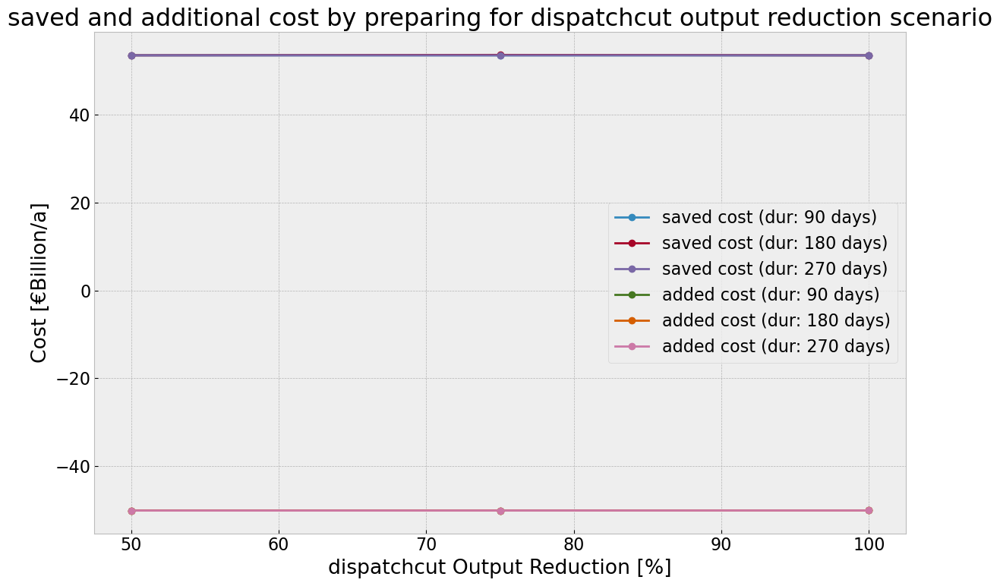

In [387]:
#rename index
cost_df = pd.concat([senscost_df, addcost_df], axis=1)

new_index = [(x - 1) * -100 for x in sens_reductionto]
cost_df.index = new_index


# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Plot each column in the DataFrame
for column in cost_df.columns:
    ax.plot(cost_df.index, cost_df[column], marker='o', label=column)

# Add labels and legend
ax.set_xlabel(f'{contingency} Output Reduction [%]')
ax.set_ylabel('Cost [€Billion/a]')
ax.set_title(f'saved and additional cost by preparing for {contingency} output reduction scenario')
ax.legend()

# Show the plot
plt.xticks()  # Rotate x-axis labels if necessary
plt.tight_layout()  # Adjust layout to make room for labels

# Save plot to the current working directory
filename = f"sens_saved_cost.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()



### Built Generator & Storage Capacities

In [388]:
#create a country based generator capacity df for every investment models 
modname_iteration = []
red_iteration = []
dur_iteration = []

for red in sens_reductionto:
    for dur in sens_duration:
        #senscost_df[f'n_{red_sanitized}_{dur_sanitized}'] = [0]
        
        for mod in models:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 

            
            #model as variable
            model =  globals()[mod_name]

            if mod == 'inv_roll':
                #append modname list
                modname_iteration.append(f'n_{red_sanitized}_{dur_sanitized}_inv_roll')
                red_iteration.append(red)
                dur_iteration.append(dur)

                # cap table
                capacities = model.generators
                capacities['country'] = capacities['bus'].str[:2]
                capacities = capacities.groupby(['country', 'carrier']).p_nom_opt.sum()
                capacities.fillna(0, inplace=True)
                #print(capacities)
                globals()[f'{mod_name}_cap_country'] = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
                globals()[f'{mod_name}_cap_country'].fillna(0, inplace=True)

                #sto table
                storage = n.storage_units
                storage['country'] = storage['bus'].str[:2]

                globals()[f'{mod_name}_sto_country'] = (storage.groupby(['country','carrier']).p_nom_opt.sum().unstack()/1000) #GW
                globals()[f'{mod_name}_sto_country'].fillna(0, inplace=True)


                #create empty df for transmission
                trans_df = {
                    'Country' : cap_base_country.index,
                    'AC': np.zeros(len(cap_base_country.index)),
                    'DC': np.zeros(len(cap_base_country.index))
                }

                trans_df = pd.DataFrame(trans_df)
                trans_df.set_index('Country', inplace=True)
    
                #AC
                ac_df = model.lines
                ac_df['country'] = ac_df['bus0'].str[:2]
                ac_df = ac_df.groupby(['country', 'carrier']).s_nom_opt.sum()
                ac_df.fillna(0, inplace=True)
                ac_df = ac_df.unstack().div(1e3) #GVA
            
                #DC
                dc_df = model.links
                dc_df['country'] = dc_df['bus0'].str[:2]
                dc_df = dc_df.groupby(['country', 'carrier']).p_nom_opt.sum()
                dc_df.fillna(0, inplace=True)
                dc_df = dc_df.unstack().div(1e3) #GW

                #fill empty df with AC Cap
                for index, row in trans_df.iterrows():
                    if index in ac_df.index:
                        try:
                            trans_df.loc[index, 'AC'] = ac_df.loc[index, 'AC']
                        except KeyError: 
                            trans_df.loc[index, 'AC'] = 0

                #fill empty df with DC Cap
                for index, row in trans_df.iterrows():
                    if index in dc_df.index:
                        try:
                            trans_df.loc[index, 'DC'] = dc_df.loc[index, 'DC']
                        except KeyError: 
                            trans_df.loc[index, 'DC'] = 0


                #trans_df = pd.concat([ac_df, dc_df], axis=1)
                #trans_df.fillna(0, inplace=True)
                globals()[f'{mod_name}_trans'] = trans_df
                #globals()[f'{mod_name}_trans_country'] = trans_df
                

#### Bar Plot

In [389]:
# Define a color map using a color palette with 12 contrasting colors
colors = sns.color_palette("tab20", 13)  # 12 contrasting colors

# Mapping countries to colors
country_colors = {
    'AT': colors[0],
    'BE': colors[1],
    'CH': colors[2],
    'CZ': colors[3],
    'DE': colors[4],
    'DK': colors[5],
    'FR': colors[6],
    'GB': colors[7],
    'LU': colors[8],
    'NL': colors[9],
    'NO': colors[10],
    'PL': colors[11],
    'SE': colors[12]  # Reusing the first color for 'SE' to ensure there are 12 colors
}

In [390]:
extendables = ['OCGT', 'solar','onwind', 'offwind-dc', 'offwind-ac']

for e in extendables:

    e_sanitized = sanitize_variable_name(str(e))

    #Cap Sensitivity df
    globals()[f'sens_{e_sanitized}'] = {
        'Scenario' : ['Base Roll'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e_sanitized}_sens_df'] = pd.DataFrame(globals()[f'sens_{e_sanitized}'])

    #add column countries
    for country in cap_base_country.index:
        globals()[f'{e_sanitized}_sens_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e_sanitized}_sens_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in cap_base_country.index:
        globals()[f'{e_sanitized}_sens_df'].loc['Base Roll', i] = cap_base_roll_country.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e_sanitized}_sens_df'].iterrows():
                if index != 'Base Roll':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e_sanitized}_sens_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            cap_df =  globals()[f'{mod_name}_cap_country']

            for index, row in globals()[f'{e_sanitized}_sens_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e_sanitized}_sens_df'].loc[index, i] = cap_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e_sanitized}_pivot_df'] = globals()[f'{e_sanitized}_sens_df'].drop(columns = ['Days', 'Reductionto'])
    

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14540\298830397.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2.8192' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_sens_df'].loc['Base Roll', i] = cap_base_roll_country.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14540\298830397.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '4.5323' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_sens_df'].loc['Base Roll', i] = cap_base_roll_country.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14540\298830397.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.1514492675412664' has dtype incompa

In [391]:
extendables_plot = {'OCGT', 'solar', 'onwind', 'offwind'}
element_to_ax = {element: i for i, element in enumerate(extendables_plot)}

element_to_ax

{'onwind': 0, 'offwind': 1, 'OCGT': 2, 'solar': 3}

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14540\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14540\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14540\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14540\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=

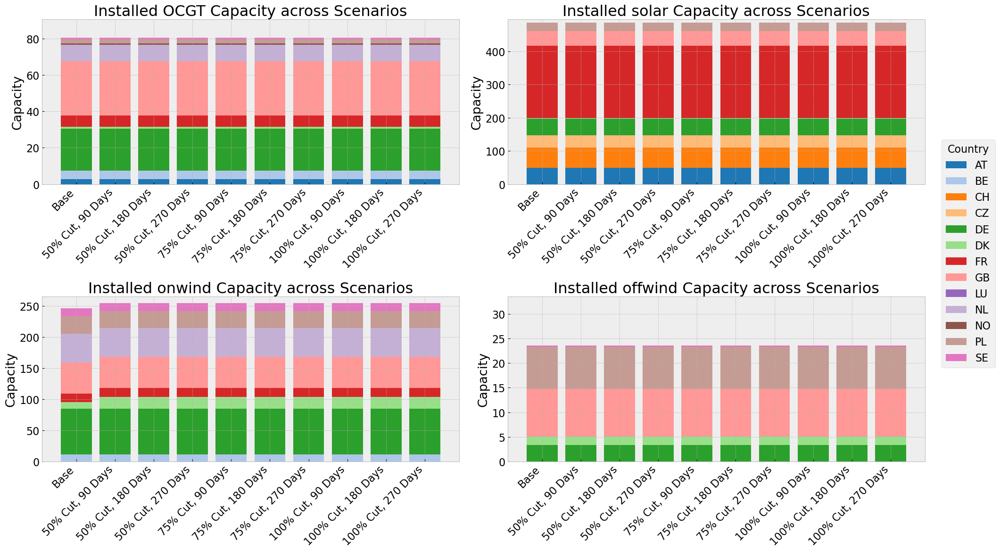

In [392]:
# combine offwind ac and dc
offwind_pivot_df = offwind_ac_pivot_df.select_dtypes(include='number') + offwind_dc_pivot_df.select_dtypes(include='number')
offwind_pivot_df

extendables_plot = ['OCGT', 'solar', 'onwind', 'offwind']

# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20,12))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(extendables_plot)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_cap.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()


### Built Storage Capacities

In [393]:
sto_type = n.storage_units.carrier.unique() 

for e in sto_type:

    #e_sanitized = sanitize_variable_name(str(e))

    #sto Sensitivity df
    globals()[f'sens_{e}'] = {
        'Scenario' : ['Base'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e}_sens_df'] = pd.DataFrame(globals()[f'sens_{e}'])

    #add column countries
    for country in store_base_df.index:
        globals()[f'{e}_sens_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e}_sens_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in store_base_df.index:
        globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e}_sens_df'].iterrows():
                if index != 'Base':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e}_sens_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            sto_df =  globals()[f'{mod_name}_sto_country']

            for index, row in globals()[f'{e}_sens_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e}_sens_df'].loc[index, i] = sto_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e}_pivot_df'] = globals()[f'{e}_sens_df'].drop(columns = ['Days', 'Reductionto'])

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14540\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '5.057300000000001' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14540\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.308' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14540\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '5.089549999999999' has dtype incompatible with int64, please explicitly c

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14540\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14540\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14540\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14540\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=

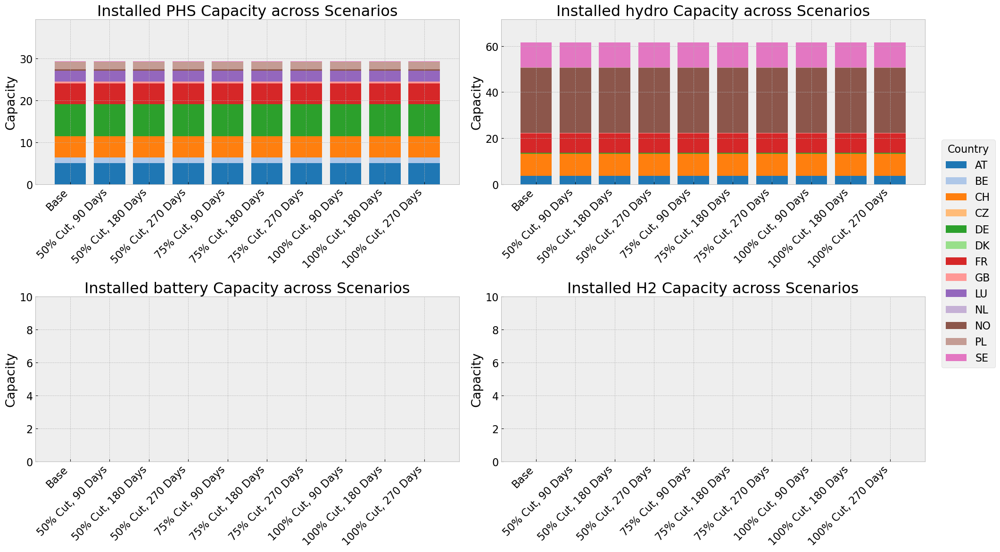

In [394]:
# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20,12))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(sto_type)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_sto.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()

### Transmission Cap

In [395]:
line_type = ['AC', 'DC']

for e in line_type:

    e_sanitized = sanitize_variable_name(str(e))

    #trans Sensitivity df
    globals()[f'trans_{e_sanitized}'] = {
        'Scenario' : ['Base'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e_sanitized}_trans_df'] = pd.DataFrame(globals()[f'trans_{e_sanitized}'])

    #add column countries
    for country in cap_base_country.index:
        globals()[f'{e_sanitized}_trans_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e_sanitized}_trans_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in cap_base_country.index:
        globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_dispatchcut.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e_sanitized}_trans_df'].iterrows():
                if index != 'Base':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e_sanitized}_trans_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            cap_df =  globals()[f'{mod_name}_trans']

            for index, row in globals()[f'{e_sanitized}_trans_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e_sanitized}_trans_df'].loc[index, i] = cap_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e_sanitized}_pivot_df'] = globals()[f'{e_sanitized}_trans_df'].drop(columns = ['Days', 'Reductionto'])

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14540\3880999499.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '27.214328698683715' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_dispatchcut.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14540\3880999499.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '17.249147582416935' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_dispatchcut.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14540\3880999499.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '36.9113883499388

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14540\3519662137.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14540\3519662137.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')


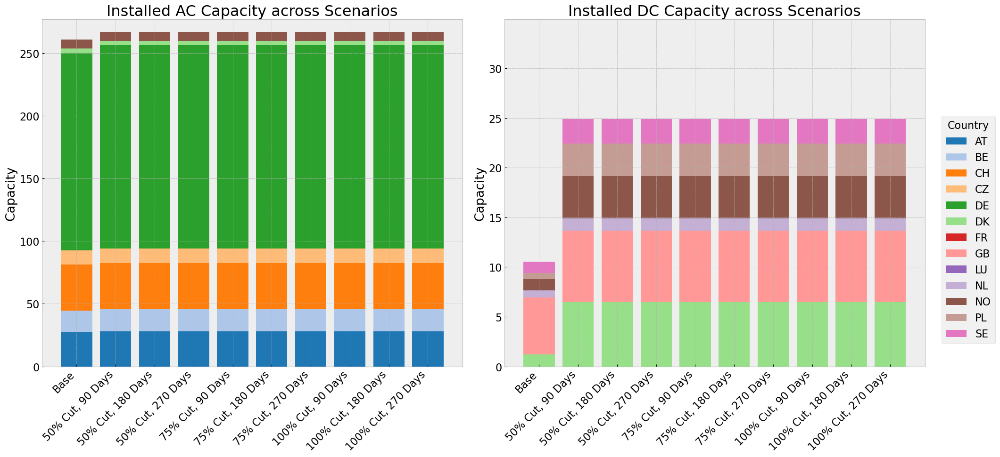

In [396]:
# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20,10))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(line_type)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_sto.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()